# **SAMson: An Automated Brain Extraction Tool for Rodents Using SAM**  
*Accurate and robust rodent brain segmentation for MRI data*

---

### **Authored by**  
**Daniel Panadero Soler**<sup>1</sup>, **Mohamed Kotb Selim**<sup>1</sup>, **Patricia Martínez-Tazo**<sup>1</sup>,  
**Emma Muñoz-Moreno**<sup>2</sup>, **Pedro Ramos-Cabrer**<sup>3,4</sup>, **Pilar López-Larrubia**<sup>5</sup>,  
**Silvia De Santis**<sup>1</sup>, **Santiago Canals**<sup>1</sup>, and **Antonio Pertusa**<sup>6</sup>  

<sup>1</sup>Instituto de Neurociencias, CSIC-UMH, Sant Joan d’Alacant, Spain  
<sup>2</sup>IDIBAPS, Barcelona, Spain  
<sup>3</sup>CIC biomaGUNE, BRTA, Donostia–San Sebastián, Spain  
<sup>4</sup>Ikerbasque, Basque Foundation for Science, Bilbao, Spain  
<sup>5</sup>Instituto de Investigaciones Biomédicas Sols-Morreale, CSIC-UAM, Madrid, Spain  
<sup>6</sup>University Institute for Computer Research, University of Alicante, Alicante, Spain  

📧 **Contact**: [pertusa@ua.es](mailto:pertusa@ua.es)  

---

### **Abstract**  
Accurate brain extraction is a critical step in the analysis of rodent head magnetic resonance imaging (MRI) data. However, current methods often encounter difficulties in handling the diverse range of imaging setups, resolutions, and experimental conditions commonly found in this field.
SAMson (*SAM for Segmentation Of Neuroimages*) is an automated tool based on the Segment Anything Model (SAM), designed for robust rodent brain extraction. It integrates a bounding box generator and a mask prediction pipeline, offering fully automated and semi-automated modes to address varying experimental complexities.
SAMson has been evaluated using three multi-centre rodent MRI datasets annotated at the pixel level, differing in acquisition parameters, resolution, and animal age groups. The tool demonstrates superior performance to existing methods (BET, RBM, BEN) in terms of segmentation accuracy, with Jaccard indices exceeding 90% across datasets. Its semi-automated mode is particularly effective in challenging scenarios such as low-resolution images and cases requiring refined mask precision.
By identifying errors at the individual slice level, SAMson enables rapid and targeted corrections, advancing translational neuroscience by supporting large-scale research workflows.  

---

### **Contents**  
This notebook is the first in a series of four, comprising the complete set of experiments and analyses that underpin the evaluations presented in the SAMson article. Within this notebook, you will find the accuracy assessments conducted across three distinct datasets, encompassing evaluations of:  
1. The Full-Auto mode of SAMson.  
2. The Semi-Auto mode of SAMson.  
3. The object detection component of SAMson.  
4. The oracle performance of SAMson.  

Due to GitHub's file size limitations, we present results only for the first subject in all cases. To access results for all subjects, simply remove the `[:1]` restriction in the `for file in files[:1]` loop.

## Setup

In [1]:
import os                                                                       # files
import time                                                                     # progress
import cv2                                                                      # images
import matplotlib.pyplot as plt                                                 # plots
import seaborn as sns                                                           # shade plots
import numpy as np                                                              # arrays
import pandas as pd                                                             # dataframes
import nibabel as nib                                                           # nifti
from os.path import join as pjoin                                               # join paths
from segment_anything import sam_model_registry, SamPredictor                   # SAM
from skimage.morphology import binary_closing, binary_erosion, binary_dilation  # mask processing
from scipy import ndimage                                                       # image processing
from dipy.segment.mask import median_otsu                                       # Otsu method

"""""  INPUTS  (ADAPT  FOLLOWING  LINES)  """""

# ------------------           PATHS           ------------------ #
template_path       = r"/home/dpanadero/Documents/data/anat_template_FP.nii"
subjects_path_3     = r"/home/dpanadero/Documents/data/d1/3_months"
subjects_path_4_5   = r"/home/dpanadero/Documents/data/d1/4_5_months"
subjects_path_6     = r"/home/dpanadero/Documents/data/d1/6_months"
subjects_path_12    = r"/home/dpanadero/Documents/data/d1/12_months"
subjects_path_d2    = r"/home/dpanadero/Documents/data/d2"
subjects_path_d3    = r"/home/dpanadero/Documents/data/d3"
output_path_base    = r"/home/dpanadero/Documents/output/"

group_tag = {"3_months":"3","5_months":"4_5","6_months":"6","2_months":"12","/data/d2":"d2","/data/d3":"d3"}


In [2]:
import torch
torch.cuda.empty_cache()
"""""""""   SEGMENT  ANYTHING  MODEL   """""""""

sam_checkpoint = "sam_vit_h_4b8939.pth"
model_type     = "vit_h"
device         = "cuda"
sam            = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device  = device)
predictor      = SamPredictor(sam)


/opt/apps/conda/dpanadero/envs/samson_test3/lib/python3.10/site-packages/segment_anything/build_sam.py:105: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.

In [3]:


"""""""""       SIMPLE  FUNCTIONS       """""""""

# Plot SAM's input box
def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h   = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))

# Plot SAMson and reference masks (different colors)
def show_mask(mask, ax, manual=False):
    if manual:
        color = np.array([255/255, 234/255,   0/255, 0.6])  # Yellow for reference masks
    else:
        color = np.array([ 30/255, 144/255, 255/255, 0.6])  # Blue for SAMson-generated masks
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def print_percent_done(index, total, bar_len=20):
    """
    Display a dynamic progress bar in the console.

    Parameters:
    index (int): The current iteration index (0-based).
    total (int): The total number of iterations or steps.
    bar_len (int): The length of the progress bar (default is 20 characters).

    Notes:
    - The function calculates the percentage of completion based on the current index and total.
    - The progress bar dynamically updates on the same line using the carriage return ('\r').
    - A completion symbol ('✅') is displayed when 100% is reached.
    """
    # Calculate percentage done
    percent_done = (index + 1) / total * 100
    percent_done = round(percent_done, 1)  # Round to 1 decimal place

    # Determine the number of completed and remaining segments in the bar
    done = round(percent_done / (100 / bar_len))
    togo = bar_len - done

    # Construct the progress bar string
    done_str = '◼' * int(done)  # Filled part of the bar
    togo_str = ' ' * int(togo)  # Empty part of the bar

    if percent_done < 100:
        # Print the progress bar with percentage, overwriting the same line
        print(f'\u23F3  [{done_str}{togo_str}] {percent_done}%', end='\r')
    else:  # If the process is complete, print the completion symbol
        print(f'✅  [{done_str}{togo_str}] {percent_done}%', end=' ')

def evaluate(mask_sam, mask_image, slice_index, accuracies, jaccards, dices, sam_list=False):
    """
    Compute performance metrics for generated masks compared to reference masks.

    Parameters:
    mask_sam (np.ndarray): The binary mask generated by SAM.
    mask_image (np.ndarray): The binary reference mask for comparison.
    slice_index (int): The index of the current slice being evaluated.
    accuracies (list): A list to store accuracy metrics for each slice.
    jaccards (list): A list to store Jaccard index metrics for each slice.
    dices (list): A list to store Dice coefficient metrics for each slice.
    sam_list (bool): If True, print a summary for slices in a single line; if False, print detailed accuracy per slice.

    Notes:
    - Accuracy is calculated as the percentage of correctly segmented pixels.
    - Jaccard Index measures overlap between SAM and reference masks.
    - Dice Coefficient is another measure of overlap but emphasizes agreement.
    - If the reference mask or SAM mask is empty, metrics default to 0.
    """
    # Convert masks to integer format for computation
    sam_int = mask_sam.astype(int)
    ref_int = mask_image.astype(int)

    # Compute difference and total sum between SAM and reference masks
    diff = ref_int - sam_int
    total = ref_int + sam_int

    # Calculate metrics if reference mask or SAM mask is not empty
    if np.any(ref_int) and np.any(total):
        acc = 100 - round((np.count_nonzero(diff) / np.count_nonzero(ref_int)) * 100, 2)
        jaccard = round((np.count_nonzero(total == 2) / np.count_nonzero(total)), 4)
        dice = round(2 * (np.count_nonzero(total == 2) / (np.count_nonzero(sam_int) + np.count_nonzero(ref_int))), 4)
    else:
        acc, jaccard, dice = 0, 0, 0

    # Print metrics based on the sam_list flag
    if not sam_list:
        print(f"Accuracy of slice #{slice_index + 1}: {acc}%")
    else:
        print(f"\t{slice_index + 1}: {acc}%", end="\t")

    # Append metrics to their respective lists
    accuracies.append(acc)
    jaccards.append(jaccard)
    dices.append(dice)

def remove_separate_pixels(mask):
    """
    Remove all disconnected pixel groups in the mask except the largest connected component.

    Parameters:
    mask (np.ndarray): A binary mask (2D array) with disconnected regions.

    Returns:
    mask (np.ndarray): A binary mask containing only the largest connected component.

    Notes:
    - Uses labeling to identify distinct regions in the mask.
    - Retains the region with the largest size and removes all others.
    """
    # Label and count disconnected regions in the mask
    labeled_array, num_features = ndimage.label(mask)

    # Find the size of each region and identify the largest region
    region_sizes = np.bincount(labeled_array.ravel())
    largest_label = np.argmax(region_sizes[1:]) + 1

    # Generate a mask for the largest connected component
    largest_component_mask = labeled_array == largest_label

    # Return the updated mask containing only the largest component
    return np.where(largest_component_mask, 1, 0)

def remove_lobes_and_separate_pixels(mask, otsu=False):
    """
    Remove lobes and isolated pixel groups from a binary mask.

    Parameters:
    mask (np.ndarray): A binary mask (2D array) with lobes and disconnected regions.
    otsu (bool): If True, use larger footprints for erosion; otherwise, use smaller footprints.

    Returns:
    mask (np.ndarray): A cleaned binary mask with lobes removed and only the largest connected component retained.

    Notes:
    - Lobes are identified by iterative erosion and dilation processes.
    - After removing lobes, the mask is processed to retain only the largest connected component.
    """
    if np.any(mask):
        if otsu:
            footprint_size_range = [2,5,20]
        else:
            footprint_size_range = [1,2,3]
        for i in footprint_size_range:
            mask_erd = binary_erosion(mask, footprint = np.ones((i, i))) # Mask erosion
            if np.any(mask_erd):     
                
                # Turn to 0 all pixels in biggest group of eroded mask
                labeled_array, num_features = ndimage.label(mask_erd)
                region_sizes  = np.bincount(labeled_array.ravel())
                largest_label = np.argmax(region_sizes[1:]) + 1
                largest_component_mask = labeled_array == largest_label
                result_array  = mask_erd.copy()
                result_array[largest_component_mask] = 0
                
                # Dilate detected lobes
                result_array_dil = binary_dilation(result_array, footprint = np.ones((i, i)))
                
                # Subtract lobes from original mask
                mask = np.where(mask == True, 1, 0)
                result_array_dil = np.where(result_array_dil == True, 1, 0)
                mask_final = mask - result_array_dil
            else:
                mask_final = mask
            mask = remove_separate_pixels(mask_final)
    return mask

def find_best_mask_indexes(accuracy_list, m, n):
    """
    Find the best mask for each slice in each volumetric image.

    Parameters:
    accuracy_list (list): A flat list of accuracies (size: m * n * 3).
    m (int): Number of volumetric images.
    n (int): Number of slices per volumetric image.

    Returns:
    best_mask_indexes (list of lists): Each inner list represents a volumetric image, containing
                                       the index of the best mask (0, 1, or 2) for each slice.
    """
    # Initialize the output list for m volumetric images
    best_mask_indexes = []

    # Iterate over each volumetric image
    for i in range(m):
        # Initialize the list for the current volumetric image
        image_best_masks = []

        # Iterate over each slice in the current volumetric image
        for j in range(n):
            # Calculate the starting index for the 3 accuracies of the current slice
            slice_start_index = (i * n + j) * 3

            # Get the accuracies for the three masks of this slice
            slice_accuracies = accuracy_list[slice_start_index:slice_start_index + 3]

            # Find the index of the best accuracy (0, 1, or 2)
            best_mask_index = slice_accuracies.index(max(slice_accuracies))

            # Append the best mask index to the list for this image
            image_best_masks.append(best_mask_index)

        # Append the list for the current image to the overall result
        best_mask_indexes.append(image_best_masks)

    return best_mask_indexes


"""""""""       COMPLEX  FUNCTIONS       """""""""

def create_sam_candidates_list(file, semi_auto=False, reference_mask=True, other_lab=False, oracle=False):
    """
    Generate a list of SAMson outputs for a given rodent brain subject.

    Parameters:
    - file (str): Filename of the subject's NIfTI image.
    - semi_auto (bool): If True, enables generating 3 predictions per slice (semi-automatic).
    - reference_mask (bool): If True, compares results against a reference mask for performance evaluation.
    - other_lab (bool): If True, uses alternate configurations and paths for reference masks (D2 and D3 images).
    - bet_mask (bool): True if mask to evaluate was extracted using one of the other existing methods.
    - oracle (bool): True if mask is to be extracted using reference mask to generate input prompts.
    
    Returns:
    sam_mask_list (list): List of SAM-generated binary masks for each slice.

    Notes:
    - Generates initial input boxes using Otsu thresholding.
    - The process includes performance evaluation if a reference mask is provided.
    - Visualization of segmentation results is done at the end.
    """
    # Load subject image
    subject = nib.load(pjoin(subjects_path, file)).get_fdata()

    start_time = time.time()

    print(f'✅ Automatic generation of input boxes completed in {round((time.time() - start_time) / 60, 2)} minutes')
    if oracle:
        boxes = generate_boxes_oracle(file, other_lab=other_lab)
    else:
        median_radius, numpass = (1, 3) if other_lab else (2, 5)
        boxes, mask_otsu = generate_boxes(file, median_radius, numpass)

    sam_mask_list = []
    start_time = time.time()

    # Process each slice for SAM model predictions
    for slice_index in range(subject.shape[2]):
        print_percent_done(slice_index, subject.shape[2])  # Show progress
        time.sleep(0.02)  # Avoid overloading the console

        # Extract the current slice and preprocess it
        box = np.array(boxes[slice_index])
        image = np.rot90(subject[:, :, slice_index]).astype(np.float32)  # Rotate and cast to float32 for processing
        image_norm = (image / np.max(image)) * 255  # Normalize image to 0-255 for SAM model input
        image = cv2.cvtColor(image_norm.astype(np.uint8), cv2.COLOR_GRAY2RGB)  # Convert to RGB for SAM

        # Predict segmentation masks using SAM model
        predictor.set_image(image)
        masks, scores, logits = predictor.predict(
            point_coords=None, point_labels=None, box=box[None, :], multimask_output=semi_auto
        )

        # Post-process and store the masks
        for mask, score in zip(masks, scores):
            mask = remove_lobes_and_separate_pixels(mask)  # Remove irrelevant regions and split connected areas
            mask = binary_closing(mask, footprint=np.ones((2, 2)))  # Apply closing operation to smooth masks
            sam_mask_list.append(mask)

    # Print time taken for extraction
    print(f" - extraction completed in {round((time.time() - start_time) / 60, 2)} minutes")

    # Plot results (optional reference mask evaluation)
    plot_results(file, semi_auto=semi_auto, other_lab=other_lab, sam_mask=False, reference_mask=reference_mask, sam_list=sam_mask_list, oracle=oracle)

    return sam_mask_list

def create_sam_masks_nifti(file, sam_mask_list, best_mask_index=False, reference_mask=True, other_lab=False):
    """
    Select the best SAM mask for each slice and save the results as a NIfTI file.

    Parameters:
    - file (str): Filename of the subject's NIfTI image.
    - sam_mask_list (list): List containing SAM-generated binary masks for each slice.
    - best_mask_index (list or bool): If provided, selects the best mask for each slice based on index.
    - reference_mask (bool): If True, compares results against a reference mask for performance evaluation.
    - other_lab (bool): If True, uses alternate configurations and paths for reference masks (D2 and D3 images).
    
    Returns:
    None: Saves the generated masks as a NIfTI file in the specified output path.

    Notes:
    - The selected masks are geometrically aligned with the original subject image.
    - The function visualizes results and saves the final mask as a NIfTI file.
    """
    # Load the subject's NIfTI image and extract data
    subject_nifti = nib.load(pjoin(subjects_path, file))  # Subject image
    subject = subject_nifti.get_fdata()

    # List to store selected SAM masks for each slice
    sam_mask_list_selection = []

    # Loop through each slice and select the best mask
    for slice_index in range(subject.shape[2]):
        if best_mask_index:  # If best_mask_index is provided, select the specified mask
            mask = sam_mask_list[slice_index * 3 + best_mask_index[slice_index]]
        else:  # Otherwise, take the first available mask for this slice
            mask = sam_mask_list[slice_index]
        sam_mask_list_selection.append(mask)

    # Convert selected masks list into a geometrically consistent NIfTI object
    array = np.array(sam_mask_list_selection)
    array = np.transpose(array, (2, 1, 0))  # Transpose to match the subject's original shape (108, 90, 16)
    array = np.rot90(array, k=2)  # Rotate 180 degrees to ensure correct orientation
    array = np.flip(array, axis=0)  # Flip along the vertical axis to align with subject's orientation
    array = array.astype('float64')  # Convert to float64 for NIfTI storage compatibility

    # Create the NIfTI image object
    masks_nifti = nib.Nifti1Image(array, affine=subject_nifti.affine)  # Using subject's affine matrix

    # Save the generated masks as a NIfTI file in the specified output path
    suffix = f'{file[:-16]}_mask.nii.gz' if other_lab and subjects_path == subjects_path_d2 else \
             f'{file[:-18]}_mask.nii.gz' if other_lab else f'{file[:-5]}_mask.nii.gz'
    nib.save(masks_nifti, pjoin(output_path, suffix))  # SAMson mask image output

    # Visualize the results (optional reference mask evaluation)
    plot_results(file, semi_auto=best_mask_index, other_lab=other_lab, reference_mask=reference_mask)

def plot_results(file, semi_auto=False, sam_mask=True, reference_mask=True, show_boxes=True, sam_list=False, other_lab=False, bet_mask=False, oracle=False):
    """
    Plot SAM masks, reference masks, input boxes, and compute evaluation metrics.

    Parameters:
    - file (str): Subject's NIfTI image filename.
    - semi_auto (bool): Display 3 predictions per slice.
    - sam_mask (bool): Plot SAM-generated mask.
    - reference_mask (bool): Plot reference mask.
    - show_boxes (bool): Display bounding boxes for each slice.
    - sam_list (bool): Plot all SAM outputs (if True).
    - other_lab (bool): If True, uses alternate configurations and paths for reference masks (D2 and D3 images).
    - bet_mask (bool): True if mask to evaluate was extracted using one of the other existing methods.
    - oracle (bool): True if mask is to be extracted using reference mask to generate input prompts.

    Returns:
    - None (Displays the plots and optionally computes evaluation metrics).
    """
    # Load subject and reference mask
    subject = nib.load(pjoin(subjects_path, file)).get_fdata()
    # Load reference mask if required
    if reference_mask:
        if other_lab:
            ref_path = (f'manual_masks/{file[:-7]}_mask.nii.gz' if subjects_path == subjects_path_d2
                        else f'manual_masks/{file[:-16]}_mask.nii')
        else:
            ref_path = f'manual_masks/{file[:7]}_mask_{file[17:-4]}.nii'
        ref_mask = nib.load(pjoin(subjects_path, ref_path)).get_fdata()
        if len(ref_mask.shape) > 3:
            ref_mask = np.squeeze(ref_mask, axis=-1)
    # Generate boxes if required
    if show_boxes:
        if oracle:
            boxes = generate_boxes_oracle(file, other_lab=other_lab)
        else:
            median_radius, numpass = (1, 3) if other_lab else (2, 5)
            boxes, mask_otsu = generate_boxes(file, median_radius, numpass)
    # Load SAM or BET (BET, BEN, RBM, SHERM or deepbet) mask
    if sam_mask or bet_mask:
        mask_suffix = "_mask.nii.gz" if sam_mask else "_bet_mask.nii.gz"
        if other_lab:
            if sam_mask:
                mask_path = f'{file[:-16]}{mask_suffix}' if subjects_path == subjects_path_d2 else f'{file[:-18]}{mask_suffix}'
            else:  # bet_mask
                mask_path = f'{file[:7]}{mask_suffix}' if subjects_path == subjects_path_d2 else f'{file[:-16]}{mask_suffix}'
        else:
            mask_path = f'{file[:-5]}{mask_suffix}' if sam_mask else f'{file[:-4]}{mask_suffix}'
        mask = nib.load(pjoin(output_path, mask_path)).get_fdata()
        if len(mask.shape) > 3:
            mask = np.squeeze(mask, axis=-1)
    # Initialize evaluation metrics if masks are available
    evaluation = any([sam_mask, sam_list, bet_mask]) and reference_mask
    accuracies, jaccards, dices = [], [], [] if evaluation else [None] * 3

    # Loop over slices
    for slice_index in range(subject.shape[2]):
        image = np.rot90(subject[:, :, slice_index]).astype(np.float32)
        image = cv2.cvtColor(((image / np.max(image)) * 255).astype(np.uint8), cv2.COLOR_GRAY2RGB)

        # Get current slice masks and boxes
        mask_image = np.rot90(mask[:, :, slice_index]) if sam_mask or bet_mask else None
        ref_mask_image = np.rot90(ref_mask[:, :, slice_index]) if reference_mask else None
        box = np.array(boxes[slice_index]) if show_boxes else None
        
        # Plot SAMson outputs in files and/or BET masks and/or reference masks and/or generated bounding boxes
        if sam_mask or bet_mask or (reference_mask and not sam_list) or (show_boxes and not sam_list) or not any([sam_mask, reference_mask, show_boxes]):
            # Perform evaluation if needed
            if evaluation and (
                (other_lab and (
                    (subjects_path == subjects_path_d2 and 1 <= slice_index < 20) or 
                    (subjects_path == subjects_path_d3 and 4 <= slice_index < 46)
                )) or not other_lab
            ):
                evaluate(mask_image, ref_mask_image, slice_index, accuracies, jaccards, dices)

            # Create the plot
            plt.figure(dpi=70)
            plt.title(f"Slice #{slice_index+1}")
            plt.imshow(image)
            plt.axis('off')
    
            # Overlay masks and boxes
            if reference_mask: show_mask(ref_mask_image, plt.gca(), manual=True)
            if sam_mask or bet_mask: show_mask(mask_image, plt.gca())
            if show_boxes: show_box(box, plt.gca())
    
            # Show the plot for each slice
            plt.show()

        # Plot all SAMson outputs in list
        if sam_list:
            fig, ax = plt.subplots(1, 3, figsize=(7, 11)) if semi_auto else plt.subplots(dpi=50)
            for i in range(3 if semi_auto else 1):
                sam_img = sam_list[slice_index * 3 + i] if semi_auto else sam_list[slice_index]
                # Perform evaluation if needed
                if evaluation and ((
                    (other_lab and (
                        (subjects_path == subjects_path_d2 and 1 <= slice_index < 20) or 
                        (subjects_path == subjects_path_d3 and 4 <= slice_index < 46)
                    )) or not other_lab
                ) or semi_auto):
                    evaluate(sam_img, ref_mask_image, slice_index, accuracies, jaccards, dices, sam_list=True) 
                
                ax[i].imshow(image) if semi_auto else ax.imshow(image)
                ax[i].set_title(f"Slice #{slice_index+1} - {i+1}", fontsize=10) if semi_auto else ax.set_title(f"Slice #{slice_index+1}", fontsize=10)
                ax[i].axis('off') if semi_auto else ax.axis('off')
                if reference_mask: show_mask(ref_mask_image, ax[i], manual=True) if semi_auto else show_mask(ref_mask_image, plt.gca(), manual=True)
                show_mask(sam_img, ax[i]) if semi_auto else show_mask(sam_img, plt.gca())
                if show_boxes: show_box(box, ax[i]) if semi_auto else show_box(box, plt.gca())
            if semi_auto: plt.tight_layout()
            plt.show()

    # Compute and print evaluation metrics if applicable
    if evaluation:
        print("Subject mean performance metrics:")
        print(f"Accuracy:\t\t {round(sum(accuracies) / len(accuracies), 2)}%")
        print(f"Jaccard index:\t\t {round(sum(jaccards) / len(jaccards), 4)}")
        print(f"Dice coefficient:\t {round(sum(dices) / len(dices), 4)}")

        # Store per-slice metrics
        for i in range(len(accuracies)):
            accuracies_per_slice.append(accuracies[i])
            jaccards_per_slice.append(jaccards[i])
            dices_per_slice.append(dices[i])

        # Store mean metrics across slices
        mean_accuracies.append(round(sum(accuracies) / len(accuracies), 2))
        mean_jaccards.append(round(sum(jaccards) / len(jaccards), 4))
        mean_dices.append(round(sum(dices) / len(dices), 4))


"""""""""      PLOTTING  FUNCTIONS      """""""""

def redistribute_to_avoid_overlap(y_values, group_centers, min_separation=0.02):
    """
    Redistribute y-values into separate vertical groups to avoid overlap.
    """
    sorted_indices = np.argsort(y_values)
    sorted_y = np.array(y_values)[sorted_indices]
    assigned_positions = []

    for y in sorted_y:
        best_group = None
        min_overlap = float('inf')

        for x in group_centers:
            overlap = sum(
                abs(y - other_y) < min_separation
                for assigned_x, other_y in assigned_positions if assigned_x == x
            )
            if overlap < min_overlap:
                min_overlap = overlap
                best_group = x
        assigned_positions.append((best_group, y))

    unsorted_positions = [None] * len(y_values)
    for original_idx, sorted_idx in enumerate(sorted_indices):
        unsorted_positions[sorted_idx] = assigned_positions[original_idx]

    return unsorted_positions
        
def plot_mean_per_subject(jaccard_values_3, jaccard_values_4_5, jaccard_values_6, jaccard_values_12, jaccard_values_d2, jaccard_values_d3, y_under_lim=0.6,stats=False):

    # Define groups for redistribution
    group_centers_3 = [0, 0.15, -0.15]
    group_centers_4_5 = [1, 1.15, 0.85]
    group_centers_6 = [2, 2.15, 1.85]
    group_centers_12 = [3, 3.15, 2.85]
    group_centers_d2 = [0, 0.15, -0.15]
    group_centers_d3 = [1, 1.15, 0.85]

    # Redistribute points
    positions_3   = redistribute_to_avoid_overlap(jaccard_values_3, group_centers_3, min_separation=0.02)
    positions_4_5 = redistribute_to_avoid_overlap(jaccard_values_4_5, group_centers_4_5, min_separation=0.02)
    positions_6   = redistribute_to_avoid_overlap(jaccard_values_6, group_centers_6, min_separation=0.02)
    positions_12  = redistribute_to_avoid_overlap(jaccard_values_12, group_centers_12, min_separation=0.02)
    positions_d2  = redistribute_to_avoid_overlap(jaccard_values_d2, group_centers_d2, min_separation=0.02)
    positions_d3  = redistribute_to_avoid_overlap(jaccard_values_d3, group_centers_d3, min_separation=0.02)

    # Plotting
    fig, ax = plt.subplots(1, 2, gridspec_kw={'width_ratios': [2, 1]}, figsize=(9, 6), sharey=True, dpi=300)
    plt.subplots_adjust(wspace=0.2)
    alphas = 0.75
    dotsize = 50

    def plot_positions(ax, positions, group_label=None,color="tab:blue"):
        x_coords, y_coords = zip(*positions)
        ax.scatter(x_coords, y_coords, s=dotsize, c=color, edgecolor='none', alpha=alphas, label=group_label)

    # Plot each group
    plot_positions(ax[0], positions_3)
    plot_positions(ax[0], positions_4_5)
    plot_positions(ax[0], positions_6)
    plot_positions(ax[0], positions_12)
    plot_positions(ax[1], positions_d2)
    plot_positions(ax[1], positions_d3)

    # Mean and standard deviation bars
    d1_mean_jac = np.mean(np.concatenate([jaccard_values_3, jaccard_values_4_5, jaccard_values_6, jaccard_values_12]))
    d1_std_jac  = np.std(np.concatenate([jaccard_values_3, jaccard_values_4_5, jaccard_values_6, jaccard_values_12]))
    mean_jac    = [np.mean(jaccard_values_3), np.mean(jaccard_values_4_5), np.mean(jaccard_values_6), np.mean(jaccard_values_12),
                   np.mean(jaccard_values_d2), np.mean(jaccard_values_d3)]
    std_jac     = [np.std(jaccard_values_3), np.std(jaccard_values_4_5), np.std(jaccard_values_6), np.std(jaccard_values_12),
                   np.std(jaccard_values_d2), np.std(jaccard_values_d3)]

    ax[0].axhline(d1_mean_jac, color='r', linestyle='--', label='Mean')
    ax[0].axhspan(d1_mean_jac - d1_std_jac, d1_mean_jac + d1_std_jac, facecolor='r', alpha=0.05, label='SD')
    ax[0].errorbar([0, 1, 2, 3], mean_jac[:-2], std_jac[:-2], marker="_", markersize=8, capsize=10, capthick=2, elinewidth=2, linestyle="None", color="tab:orange")
    if stats=="full":
      # Plot significance stars
      ax[0].text(1,0.96,"***",fontsize=20,horizontalalignment='center',verticalalignment='center')  # Between 4.5 months and 12 months
      ax[0].text(2,0.96,"**",fontsize=20,horizontalalignment='center',verticalalignment='center')  # Between 6 months and 12 months

    elif stats=="semi":
      # Plot significance stars
      ax[0].text(0,0.965,"*",fontsize=20,horizontalalignment='center',verticalalignment='center')  # Between 6 months and 12 months
      ax[0].text(1,0.965,"***",fontsize=20,horizontalalignment='center',verticalalignment='center')  # Between 4.5 months and 12 months
      ax[0].text(2,0.965,"*",fontsize=20,horizontalalignment='center',verticalalignment='center')  # Between 6 months and 12 months

    ax[0].set_ylim(y_under_lim, 1)
    ax[1].set_ylim(y_under_lim, 1)
    ax[1].errorbar([0, 1], mean_jac[-2:], std_jac[-2:], marker="_", markersize=8, capsize=10, capthick=2,  elinewidth=2, linestyle="None", color="tab:orange")

    # Adding horizontal lines to make errorbar markers thicker
    for i, mean in enumerate(mean_jac[:-2]):
        ax[0].hlines(mean, -0.06 + i, 0.06 + i, color="tab:orange", linewidth=2)  # Horizontal lines to thick marker
    # Adding horizontal lines to make errorbar markers thicker for D2/D3
    for i, mean in enumerate(mean_jac[-2:]):
        ax[1].hlines(mean, -0.06 + i, 0.06 + i, color="tab:orange", linewidth=2)  # Horizontal lines to thick marker

    ax[0].set_ylabel('Jaccard index', fontsize=20)
    ax[0].set_xlabel('D1 (m.o.a)', fontsize=20)

    ax[0].set_xticks((-1, 0, 1, 2, 3, 4))
    ax[0].set_xticklabels(("", "3", "4.5", "6", "12", ""), fontsize=20)
    ax[0].tick_params(axis='both', which='major', labelsize=20)

    ax[0].set_yticks(np.arange(y_under_lim, 1.01, 0.05))
    y_ticks = ax[0].get_yticks()
    new_labels = ['' if i % 2 != 0 else f'{tick:.1f}' for i, tick in enumerate(y_ticks)]
    ax[0].set_yticklabels(new_labels)

    ax[1].set_xticks((-1, 0, 1, 2))
    ax[1].set_xticklabels(("", "D2", "D3", ""), fontsize=20)
    ax[1].tick_params(axis='both', which='major', labelsize=20)
    ax[1].tick_params(axis='x', which='major', pad=15)

    ax[0].legend(framealpha=1, fontsize=20, loc="lower left")
    ax[0].tick_params(which='major', length=5, direction="in", right=True, top=True)
    ax[1].tick_params(which='major', length=5, direction="in", right=True, top=True)
    ax[0].grid(axis='y')
    ax[0].tick_params(axis='y', pad=10)  # Add extra padding
    ax[1].grid(axis='y')
    plt.tight_layout()
    plt.show()



### Input prompt generation

In [4]:
def generate_boxes_from_template(template_path):
    """
    Generates bounding boxes for each slice of a template NIfTI image.

    Parameters:
    - template_path (str): Path to the template NIfTI file.

    Returns:
    - template_boxes_edges (list of lists): Bounding boxes for each slice of the template.
    - relative_coordinates (list of lists): Relative coordinates of boxes in all templates slices with 
                                            respect to the box in the template central slice.
    """
    # Load the NIfTI file and extract image data and dimensions
    template_nifti = nib.load(template_path)
    template_data = template_nifti.get_fdata()
    num_slices = template_nifti.header.get_data_shape()[2]

    # Store bounding box edges for each slice
    template_boxes_edges = []

    for i in range(num_slices):
        # Rotate the slice for consistent orientation
        slice_data = np.rot90(template_data[:, :, i])
        output_array = np.zeros_like(slice_data)

        # Identify non-zero indices in the slice (values > 0.5)
        non_zero_indices = np.argwhere(slice_data > 0.5)
        if len(non_zero_indices):
            # Compute bounding box around non-zero regions
            min_row, min_col = np.min(non_zero_indices, axis=0)
            max_row, max_col = np.max(non_zero_indices, axis=0)
            output_array[min_row:max_row + 1, min_col:max_col + 1] = 1
            output_array = output_array.astype(int)

        # Calculate bounding box edges coordinates
        bbox_indices = np.argwhere(output_array != 0)
        if np.any(bbox_indices):
            yu, xl = np.min(bbox_indices, axis=0)
            yd, xr = np.max(bbox_indices, axis=0)
            template_boxes_edges.append([xl, yu, xr, yd])
        else:
            # Default box if no region found
            template_boxes_edges.append([0, 0, 0, 0])

    # Compute central slice index
    central_slice_index = round(num_slices/2)

    # Dimensions of the bounding box on the central slice of the template
    central_box = template_boxes_edges[central_slice_index]
    width_x   = central_box[2] - central_box[0]
    width_y   = central_box[3] - central_box[1]
    central_x = central_box[0] + width_x / 2
    central_y = central_box[1] + width_y / 2

    # Compute relative coordinates for each slice of the template
    relative_coordinates = []
    for bbox in template_boxes_edges:
        p_x_left  = (central_x - bbox[0]) / width_x
        p_x_right = (bbox[2] - central_x) / width_x
        p_y_up    = (central_y - bbox[1]) / width_y
        p_y_down  = (bbox[3] - central_y) / width_y
        relative_coordinates.append([p_x_left, p_y_up, p_x_right, p_y_down])

    return template_boxes_edges, relative_coordinates

template_boxes_edges, relative_coordinates = generate_boxes_from_template(template_path)

def generate_boxes(file, median_radius, numpass):
    """
    Generates bounding boxes for each slice of a subject image using interpolation of 
    template-based bounding box coordinates and a central slice box derived from the Otsu mask.

    Parameters:
    - file (str): File name of the subject NIfTI image.
    - median_radius (int): Radius for median filter in median_otsu function.
    - numpass (int): Number of passes for median_otsu function.

    Returns:
    - boxes_edges (list of lists): Bounding box edges for each slice in the format [x_left, y_up, x_right, y_down].
    - mask (np.ndarray): Binary mask of the subject after applying median_otsu.
    """
    boxes_edges = []

    # Load the subject NIfTI file and extract data
    subject = nib.load(pjoin(subjects_path, file)).get_fdata()
    subject_number_of_slices = subject.shape[2]
    template_nifti = nib.load(template_path)
    template_number_of_slices = template_nifti.header.get_data_shape()[2]

    # Handle 4D data by squeezing out singleton dimensions
    if len(subject.shape) > 3:
        subject = np.squeeze(subject, axis=-1)

    # Generate z-coordinates for subject and template slices
    z_template = np.linspace(0, 1, template_number_of_slices)
    z_subject = np.linspace(z_template[initial_slice], z_template[final_slice], subject_number_of_slices)

    # Find the central slice index for the subject
    central_slice_index_subject = np.abs(z_subject - 0.5).argmin()

    # Interpolate bounding box coordinates for the subject
    interpolated_coordinates = []
    for z in z_subject:
        previous_index = np.searchsorted(z_template, z, side='right') - 1
        next_index     = np.searchsorted(z_template, z, side='left')

        if previous_index == next_index:
            # Use nearest template slice if z aligns exactly
            interpolated_coordinates.append(relative_coordinates[np.abs(z_template - z).argmin()])
        else:
            # Linearly interpolate between the two nearest template slices
            prev_weights = np.array(relative_coordinates[previous_index])
            next_weights = np.array(relative_coordinates[next_index])
            interpolated_coordinates.append(list(prev_weights + (z - z_template[previous_index]) * (
                (next_weights - prev_weights) / (z_template[next_index] - z_template[previous_index]))))

    # Apply median_otsu to obtain the binary mask
    _, mask = median_otsu(subject, median_radius=median_radius, numpass=numpass)

    # Process the central slice to calculate its bounding box
    central_slice_mask = np.rot90(mask[:, :, central_slice_index_subject])
    central_slice_mask = remove_lobes_and_separate_pixels(central_slice_mask, otsu=True)
    indices = np.argwhere(central_slice_mask != 0)

    if np.any(indices):
        # Compute bounding box edges for the central slice of the subject
        yu, xl = np.min(indices, axis=0)
        yd, xr = np.max(indices, axis=0)
        central_slice_box_edges = [xl, yu, xr, yd]
    else:
        # Default to an empty bounding box if no valid region is found
        central_slice_box_edges = [0, 0, 0, 0]

    # Calculate dimensions and center of the central slice bounding box of the subject
    width_x   = central_slice_box_edges[2] - central_slice_box_edges[0]
    width_y   = central_slice_box_edges[3] - central_slice_box_edges[1]
    central_x = central_slice_box_edges[0] + width_x / 2
    central_y = central_slice_box_edges[1] + width_y / 2

    # Generate bounding boxes for all subject slices based on interpolated coordinates
    for i in range(subject_number_of_slices):
        xl = central_x - width_x * interpolated_coordinates[i][0]
        xr = central_x + width_x * interpolated_coordinates[i][2]
        yu = central_y - width_y * interpolated_coordinates[i][1]
        yd = central_y + width_y * interpolated_coordinates[i][3]
        box_edges = [xl, yu, xr, yd]
        boxes_edges.append(box_edges)

    return boxes_edges, mask

# 1. Full-Auto

## Results

#### 3 months

T2Wmice_first_im_A110123_3mo_.nii
T2Wmice_first_im_A120123_3mo_.nii
T2Wmice_first_im_A130123_3mo_.nii
T2Wmice_first_im_A160123_3mo_.nii
T2Wmice_first_im_A170123_3mo_.nii
T2Wmice_first_im_B110123_3mo_.nii
T2Wmice_first_im_B120123_3mo_.nii
T2Wmice_first_im_B130123_3mo_.nii
T2Wmice_first_im_B160123_3mo_.nii
T2Wmice_first_im_B170123_3mo_.nii
T2Wmice_first_im_C110123_3mo_.nii
T2Wmice_first_im_C120123_3mo_.nii
T2Wmice_first_im_C130123_3mo_.nii
T2Wmice_first_im_C160123_3mo_.nii
T2Wmice_first_im_D120123_3mo_.nii
T2Wmice_first_im_D160123_3mo_.nii
-------------------------------------------------
T2Wmice_first_im_A110123_3mo_.nii
✅ Automatic generation of input boxes completed in 0.0 minutes
✅  [◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼] 100.0%  - extraction completed in 0.13 minutes
	1: 61.28%	

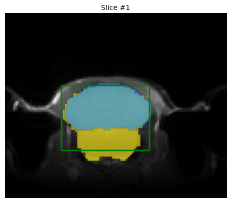

	2: 69.66%	

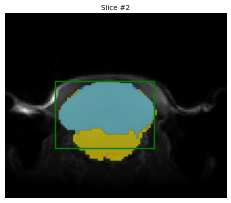

	3: 96.36%	

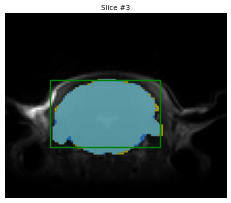

	4: 93.6%	

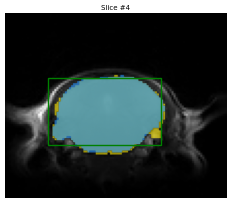

	5: 96.43%	

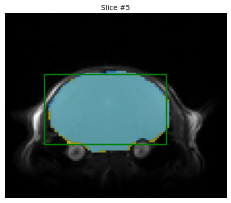

	6: 96.93%	

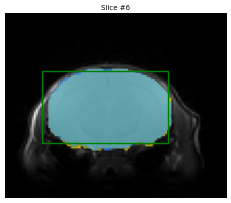

	7: 95.28%	

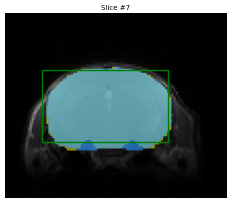

	8: 96.16%	

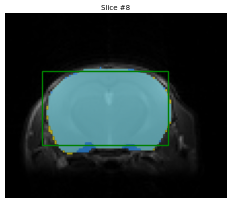

	9: 96.65%	

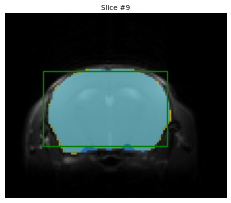

	10: 96.33%	

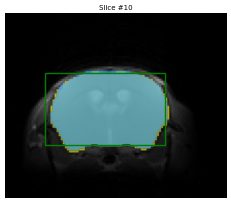

	11: 96.83%	

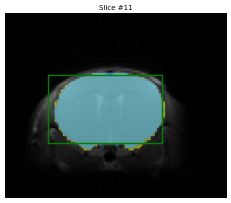

	12: 97.3%	

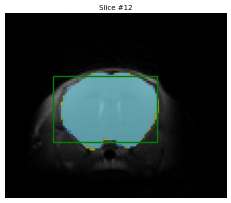

	13: 93.18%	

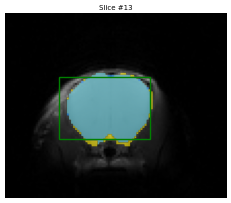

	14: 89.97%	

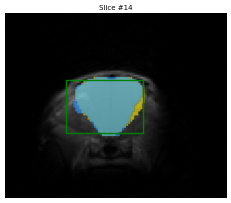

	15: 89.63%	

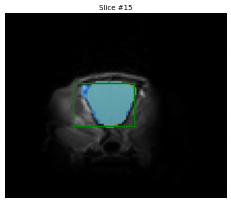

	16: 90.59%	

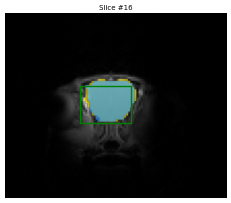

Subject mean performance metrics:
Accuracy:		 91.01%
Jaccard index:		 0.912
Dice coefficient:	 0.9508
accuracy_values_3 = np.array([91.01])
jaccard_values_3 = np.array([0.912])
dice_values_3 = np.array([0.9508])
accur_values_3 = np.array([61.28, 69.66, 96.36, 93.6, 96.43, 96.93, 95.28, 96.16, 96.65, 96.33, 96.83, 97.3, 93.18, 89.97, 89.63, 90.59])
jacc_values_3 = np.array([0.622, 0.6975, 0.9641, 0.937, 0.9648, 0.9697, 0.9544, 0.9625, 0.9671, 0.9636, 0.9685, 0.9732, 0.9323, 0.9037, 0.905, 0.9072])
dic_values_3 = np.array([0.767, 0.8218, 0.9817, 0.9675, 0.9821, 0.9846, 0.9767, 0.9809, 0.9833, 0.9815, 0.984, 0.9864, 0.9649, 0.9494, 0.9501, 0.9513])


In [6]:
files = []
subjects_path, output_path = subjects_path_3, pjoin(output_path_base,"full_auto/3_months")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.startswith("T2Wmice_first_im") and file.endswith("nii"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

initial_slice = 4
final_slice   = 33

list_of_sam_mask_lists = []
for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    sam_mask_list = create_sam_candidates_list(file, reference_mask=True)
    list_of_sam_mask_lists.append(sam_mask_list)

print(f"accuracy_values_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

#### 4.5 months

T2Wmice_first_im_A080323_4.5mo_.nii
T2Wmice_first_im_A090323_4.5mo_.nii
T2Wmice_first_im_A100323_4.5mo_.nii
T2Wmice_first_im_A130323_4.5mo_.nii
T2Wmice_first_im_A140323_4.5mo_.nii
T2Wmice_first_im_B090323_4.5mo_.nii
T2Wmice_first_im_B100323_4.5mo_.nii
T2Wmice_first_im_B130323_4.5mo_.nii
T2Wmice_first_im_C080323_4.5mo_.nii
T2Wmice_first_im_C090323_4.5mo_.nii
T2Wmice_first_im_C100323_4.5mo_.nii
-------------------------------------------------
T2Wmice_first_im_A080323_4.5mo_.nii
✅ Automatic generation of input boxes completed in 0.0 minutes
✅  [◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼] 100.0%  - extraction completed in 0.12 minutes
	1: 77.5%	

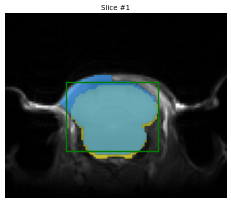

	2: 91.82%	

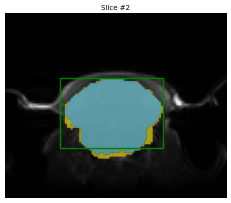

	3: 95.67%	

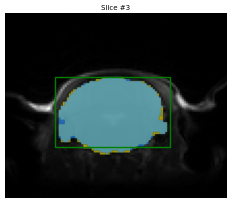

	4: 92.79%	

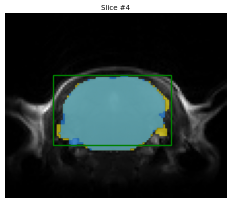

	5: 97.1%	

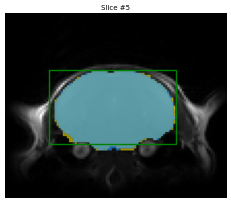

	6: 93.34%	

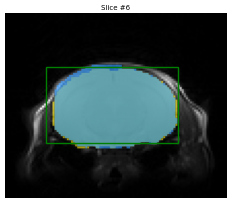

	7: 90.38%	

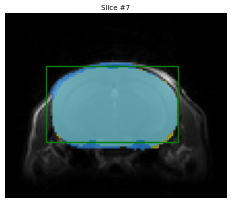

	8: 95.41%	

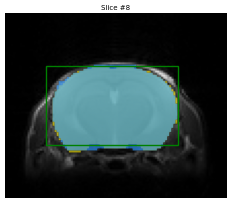

	9: 96.66%	

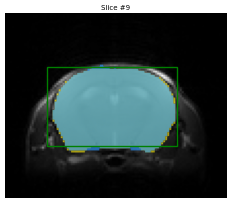

	10: 96.66%	

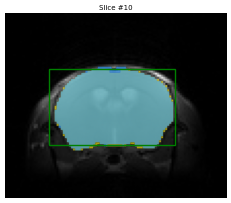

	11: 96.35%	

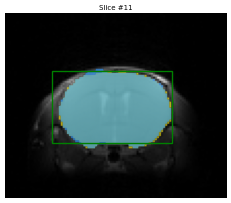

	12: 96.0%	

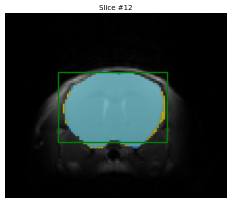

	13: 93.6%	

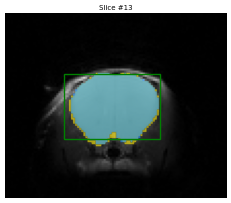

	14: 89.86%	

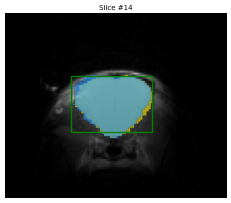

	15: 91.58%	

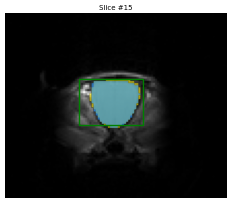

	16: 93.6%	

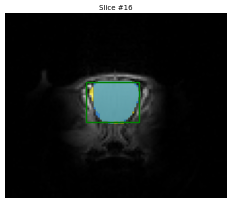

Subject mean performance metrics:
Accuracy:		 93.02%
Jaccard index:		 0.9338
Dice coefficient:	 0.9654
accuracy_values_4_5 = np.array([93.02])
jaccard_values_4_5 = np.array([0.9338])
dice_values_4_5 = np.array([0.9654])
accur_values_4_5 = np.array([77.5, 91.82, 95.67, 92.79, 97.1, 93.34, 90.38, 95.41, 96.66, 96.66, 96.35, 96.0, 93.6, 89.86, 91.58, 93.6])
jacc_values_4_5 = np.array([0.8076, 0.9182, 0.9573, 0.9299, 0.9712, 0.9365, 0.9116, 0.9556, 0.9671, 0.967, 0.9642, 0.9603, 0.9362, 0.9039, 0.917, 0.9376])
dic_values_4_5 = np.array([0.8935, 0.9574, 0.9782, 0.9637, 0.9854, 0.9672, 0.9538, 0.9773, 0.9833, 0.9832, 0.9818, 0.9798, 0.9671, 0.9495, 0.9567, 0.9678])


In [7]:
files = []
subjects_path, output_path = subjects_path_4_5, pjoin(output_path_base,"full_auto/4_5_months")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.startswith("T2Wmice_first_im") and file.endswith("nii"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

initial_slice = 4
final_slice   = 33

list_of_sam_mask_lists = []
for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    sam_mask_list = create_sam_candidates_list(file, reference_mask=True)
    list_of_sam_mask_lists.append(sam_mask_list)

print(f"accuracy_values_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

#### 6 months

T2Wmice_first_im_A250423_6mo_.nii
T2Wmice_first_im_A260423_6mo_.nii
T2Wmice_first_im_A270423_6mo_.nii
T2Wmice_first_im_A280423_6mo_.nii
T2Wmice_first_im_B250423_6mo_.nii
T2Wmice_first_im_B260423_6mo_.nii
T2Wmice_first_im_B270423_6mo_.nii
T2Wmice_first_im_B280423_6mo_.nii
T2Wmice_first_im_C250423_6mo_.nii
T2Wmice_first_im_C260423_6mo_.nii
T2Wmice_first_im_C270423_6mo_.nii
-------------------------------------------------
T2Wmice_first_im_A250423_6mo_.nii
✅ Automatic generation of input boxes completed in 0.0 minutes
✅  [◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼] 100.0%  - extraction completed in 0.12 minutes
	1: 76.67%	

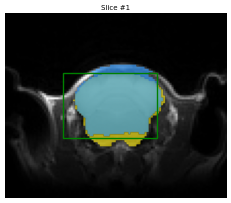

	2: 92.15%	

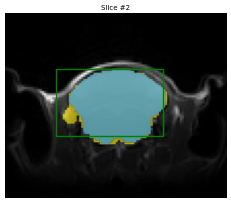

	3: 94.69%	

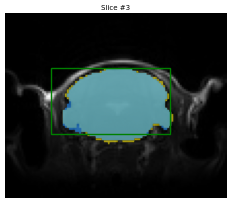

	4: 90.59%	

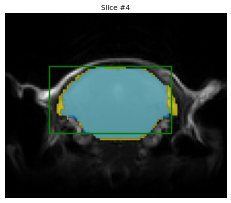

	5: 95.23%	

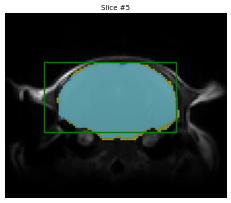

	6: 95.85%	

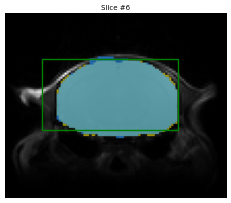

	7: 92.27%	

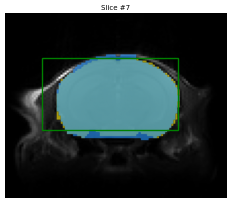

	8: 92.19%	

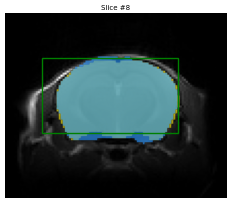

	9: 94.36%	

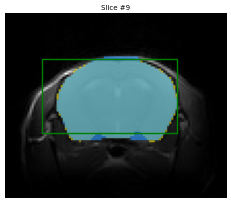

	10: 95.38%	

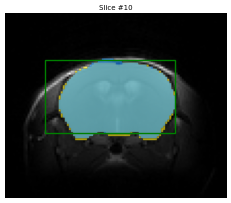

	11: 95.61%	

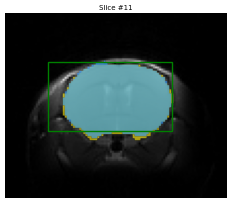

	12: 95.4%	

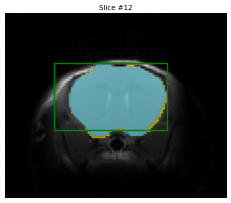

	13: 93.94%	

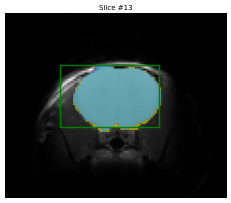

	14: 86.32%	

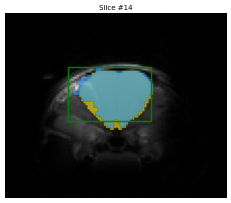

	15: 80.89%	

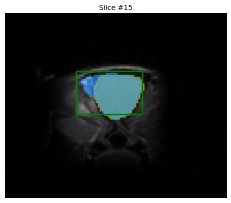

	16: 94.28%	

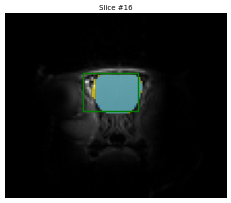

Subject mean performance metrics:
Accuracy:		 91.61%
Jaccard index:		 0.9205
Dice coefficient:	 0.9579
accuracy_values_6 = np.array([91.61])
jaccard_values_6 = np.array([0.9205])
dice_values_6 = np.array([0.9579])
accur_values_6 = np.array([76.67, 92.15, 94.69, 90.59, 95.23, 95.85, 92.27, 92.19, 94.36, 95.38, 95.61, 95.4, 93.94, 86.32, 80.89, 94.28])
jacc_values_6 = np.array([0.7884, 0.9217, 0.9477, 0.9066, 0.9525, 0.9595, 0.927, 0.9265, 0.9458, 0.9544, 0.9565, 0.9543, 0.9401, 0.8698, 0.8333, 0.9432])
dic_values_6 = np.array([0.8817, 0.9593, 0.9732, 0.951, 0.9757, 0.9793, 0.9621, 0.9618, 0.9721, 0.9767, 0.9778, 0.9766, 0.9691, 0.9304, 0.9091, 0.9708])


In [8]:
files = []
subjects_path, output_path = subjects_path_6, pjoin(output_path_base,"full_auto/6_months")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.startswith("T2Wmice_first_im") and file.endswith("nii"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

initial_slice = 4
final_slice   = 33

list_of_sam_mask_lists = []
for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    sam_mask_list = create_sam_candidates_list(file, reference_mask=True)
    list_of_sam_mask_lists.append(sam_mask_list)

print(f"accuracy_values_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

#### 12 months

T2Wmice_first_im_A030222_12mo_.nii
T2Wmice_first_im_A070222_12mo_.nii
T2Wmice_first_im_A080222_12mo_.nii
T2Wmice_first_im_A090222_12mo_.nii
T2Wmice_first_im_A100222_12mo_.nii
T2Wmice_first_im_A250222_12mo_.nii
T2Wmice_first_im_B030222_12mo_.nii
T2Wmice_first_im_B070222_12mo_.nii
T2Wmice_first_im_B080222_12mo_.nii
T2Wmice_first_im_B090222_12mo_.nii
T2Wmice_first_im_B100222_12mo_.nii
T2Wmice_first_im_C070222_12mo_.nii
T2Wmice_first_im_C080222_12mo_.nii
T2Wmice_first_im_C090222_12mo_.nii
T2Wmice_first_im_C100222_12mo_.nii
-------------------------------------------------
T2Wmice_first_im_A030222_12mo_.nii
✅ Automatic generation of input boxes completed in 0.0 minutes
✅  [◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼] 100.0%  - extraction completed in 0.13 minutes
	1: 83.6%	

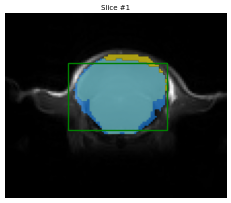

	2: 88.01%	

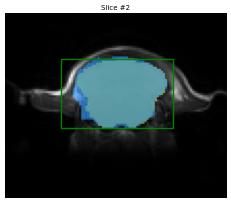

	3: 87.59%	

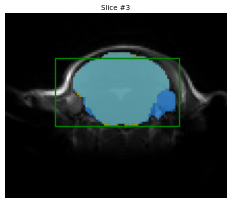

	4: 83.32%	

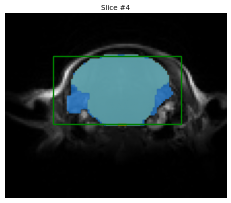

	5: 96.43%	

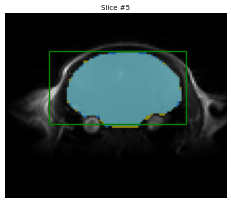

	6: 95.78%	

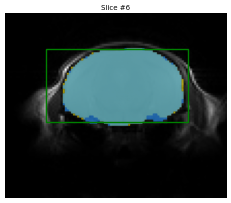

	7: 93.37%	

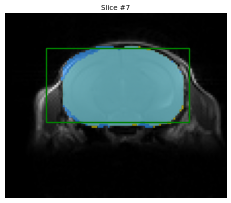

	8: 93.8%	

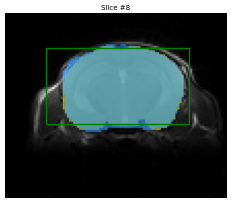

	9: 96.38%	

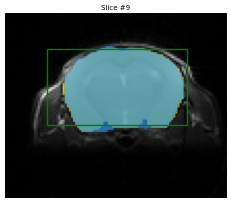

	10: 97.26%	

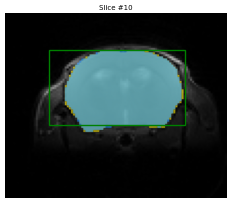

	11: 92.5%	

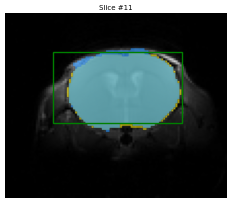

	12: 94.99%	

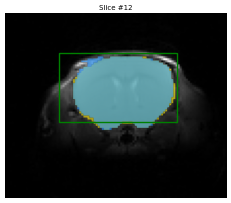

	13: 95.42%	

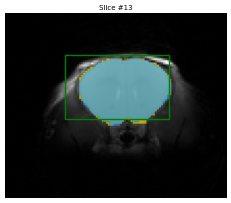

	14: 83.43%	

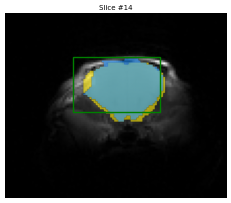

	15: 78.75%	

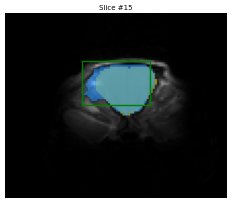

	16: 51.44%	

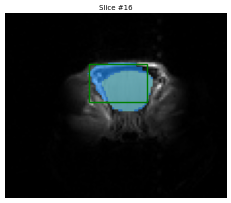

Subject mean performance metrics:
Accuracy:		 88.25%
Jaccard index:		 0.8999
Dice coefficient:	 0.9455
accuracy_values_12 = np.array([88.25])
jaccard_values_12 = np.array([0.8999])
dice_values_12 = np.array([0.9455])
accur_values_12 = np.array([83.6, 88.01, 87.59, 83.32, 96.43, 95.78, 93.37, 93.8, 96.38, 97.26, 92.5, 94.99, 95.42, 83.43, 78.75, 51.44])
jacc_values_12 = np.array([0.8509, 0.8927, 0.8886, 0.8566, 0.9649, 0.9591, 0.9373, 0.941, 0.9648, 0.9728, 0.9282, 0.951, 0.9545, 0.8405, 0.8228, 0.6731])
dic_values_12 = np.array([0.9194, 0.9433, 0.941, 0.9228, 0.9821, 0.9791, 0.9677, 0.9696, 0.9821, 0.9862, 0.9628, 0.9749, 0.9767, 0.9133, 0.9028, 0.8046])


In [9]:
files = []
subjects_path, output_path = subjects_path_12, pjoin(output_path_base,"full_auto/12_months")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.startswith("T2Wmice_first_im") and file.endswith("nii"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

initial_slice = 4
final_slice   = 33

list_of_sam_mask_lists = []
for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    sam_mask_list = create_sam_candidates_list(file, reference_mask=True)
    list_of_sam_mask_lists.append(sam_mask_list)

print(f"accuracy_values_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

#### D2

5463_t2.nii_flip.nii.gz
5471_t2.nii_flip.nii.gz
5472_t2.nii_flip.nii.gz
6085_t2.nii_flip.nii.gz
6087_t2.nii_flip.nii.gz
6088_t2.nii_flip.nii.gz
6092_t2.nii_flip.nii.gz
6093_t2.nii_flip.nii.gz
6287_t2.nii_flip.nii.gz
6289_t2.nii_flip.nii.gz
-------------------------------------------------
5463_t2.nii_flip.nii.gz
✅ Automatic generation of input boxes completed in 0.0 minutes
✅  [◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼] 100.0%  - extraction completed in 0.18 minutes


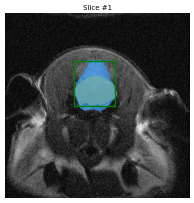

	2: 92.05%	

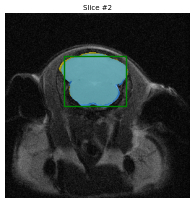

	3: 97.48%	

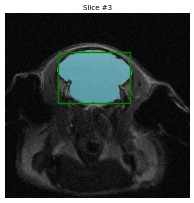

	4: 91.11%	

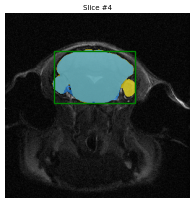

	5: 88.07%	

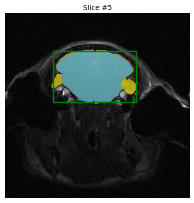

	6: 95.95%	

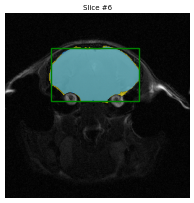

	7: 97.91%	

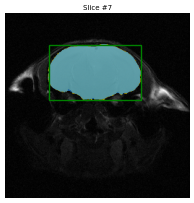

	8: 97.17%	

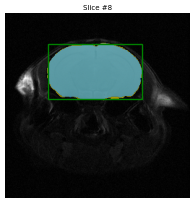

	9: 97.9%	

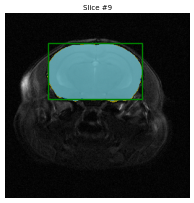

	10: 98.0%	

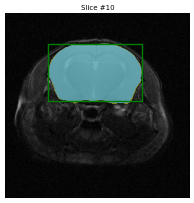

	11: 96.95%	

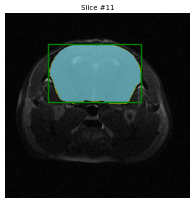

	12: 95.4%	

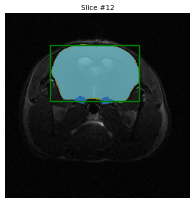

	13: 96.69%	

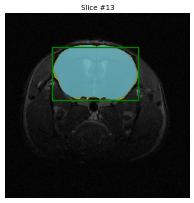

	14: 98.13%	

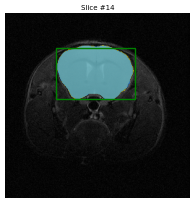

	15: 95.41%	

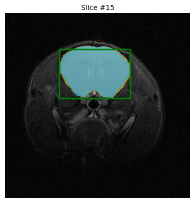

	16: 93.06%	

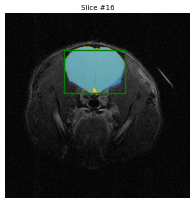

	17: 96.02%	

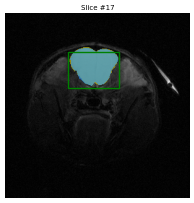

	18: 94.29%	

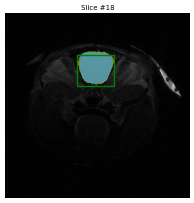

	19: 94.66%	

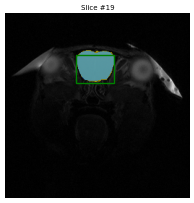

	20: 92.88%	

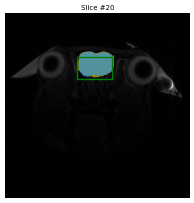

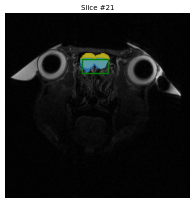

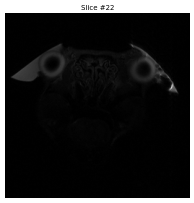

Subject mean performance metrics:
Accuracy:		 95.22%
Jaccard index:		 0.9528
Dice coefficient:	 0.9756
accuracy_values_d2 = np.array([95.22])
jaccard_values_d2 = np.array([0.9528])
dice_values_d2 = np.array([0.9756])
accur_values_d2 = np.array([92.05, 97.48, 91.11, 88.07, 95.95, 97.91, 97.17, 97.9, 98.0, 96.95, 95.4, 96.69, 98.13, 95.41, 93.06, 96.02, 94.29, 94.66, 92.88])
jacc_values_d2 = np.array([0.9245, 0.975, 0.9127, 0.8812, 0.9595, 0.9792, 0.9717, 0.979, 0.98, 0.9695, 0.9553, 0.9669, 0.9814, 0.9542, 0.9327, 0.9605, 0.9429, 0.9467, 0.9294])
dic_values_d2 = np.array([0.9607, 0.9874, 0.9544, 0.9368, 0.9794, 0.9895, 0.9857, 0.9894, 0.9899, 0.9845, 0.9772, 0.9832, 0.9906, 0.9766, 0.9652, 0.9798, 0.9706, 0.9726, 0.9634])


In [10]:
files = []
subjects_path, output_path = subjects_path_d2, pjoin(output_path_base,"full_auto/d2")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.endswith("flip.nii.gz"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

initial_slice = 2
final_slice   = 39

list_of_sam_mask_lists = []
for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    sam_mask_list = create_sam_candidates_list(file, other_lab=True, reference_mask=True)
    list_of_sam_mask_lists.append(sam_mask_list)
    
print(f"accuracy_values_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

#### D3

20190227_105648_AE0818_rs_Control_11_1_1_T2w.nii_flip.nii.gz
20190227_120644_AE0818_rs_Control_12_1_1_T2w.nii_flip.nii.gz
20190227_125730_AE0818_rs_Control_13_1_1_T2w.nii_flip.nii.gz
20190228_081325_AE0818_rs_Control_14_1_1_T2w.nii_flip.nii.gz
20190228_093749_AE0818_rs_Control_21_1_1_T2w.nii_flip.nii.gz
20190228_103014_AE0818_rs_Control_15_1_1_T2w.nii_flip.nii.gz
20190311_083410_AE0818_rs_Control_11_1_2_T2w.nii_flip.nii.gz
20190311_095840_AE0818_rs_Control_12_1_2_T2w.nii_flip.nii.gz
20190311_105918_AE0818_rs_Control_13_1_2_T2w.nii_flip.nii.gz
20190311_115813_AE0818_rs_Control_14_1_2_T2w.nii_flip.nii.gz
20190311_125036_AE0818_rs_Control_15_1_2_T2w.nii_flip.nii.gz
20190311_143920_AE0818_rs_Control_21_1_2_T2w.nii_flip.nii.gz
-------------------------------------------------
20190227_105648_AE0818_rs_Control_11_1_1_T2w.nii_flip.nii.gz
✅ Automatic generation of input boxes completed in 0.0 minutes
✅  [◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼] 100.0%  - extraction completed in 0.38 minutes


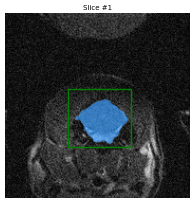

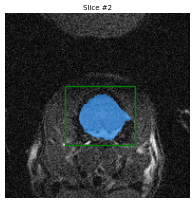

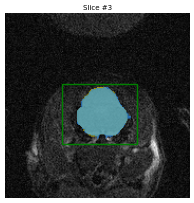

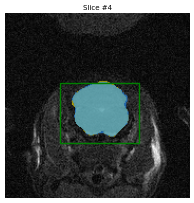

	5: 96.84%	

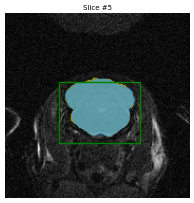

	6: 97.07%	

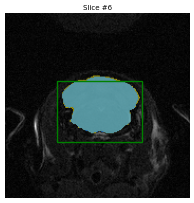

	7: 92.48%	

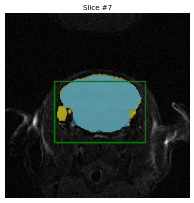

	8: 93.13%	

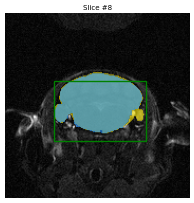

	9: 90.67%	

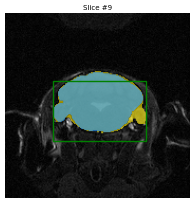

	10: 95.1%	

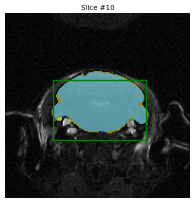

	11: 92.26%	

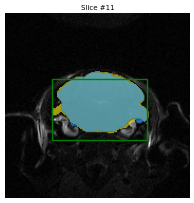

	12: 90.45%	

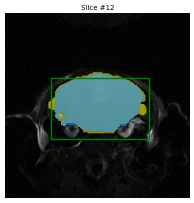

	13: 95.14%	

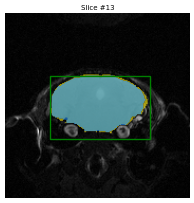

	14: 93.1%	

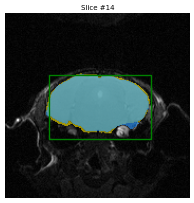

	15: 95.07%	

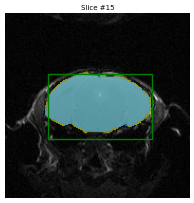

	16: 94.18%	

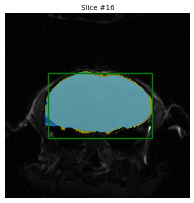

	17: 95.32%	

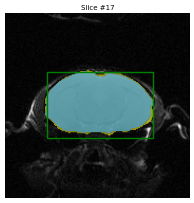

	18: 95.17%	

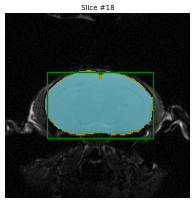

	19: 93.99%	

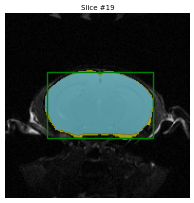

	20: 94.83%	

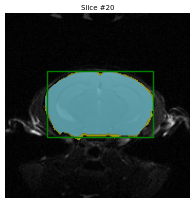

	21: 96.13%	

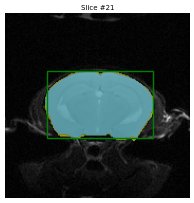

	22: 94.34%	

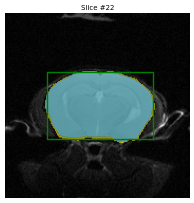

	23: 96.15%	

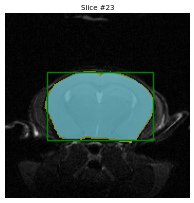

	24: 95.47%	

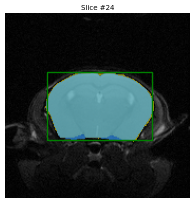

	25: 96.31%	

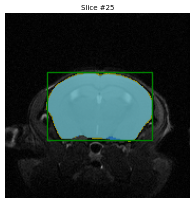

	26: 93.92%	

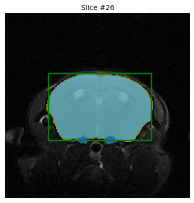

	27: 95.9%	

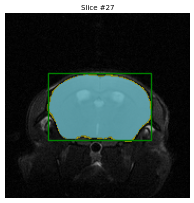

	28: 95.38%	

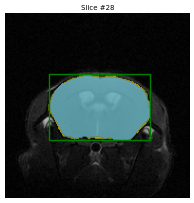

	29: 95.69%	

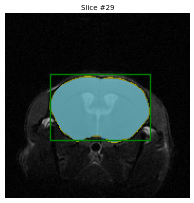

	30: 96.2%	

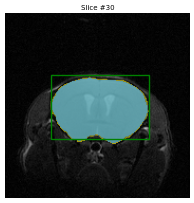

	31: 95.37%	

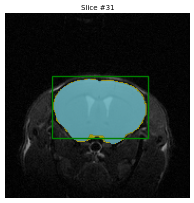

	32: 94.86%	

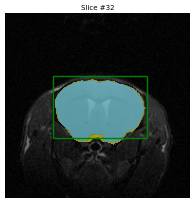

	33: 93.8%	

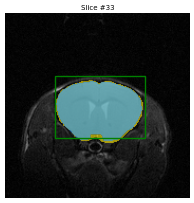

	34: 95.67%	

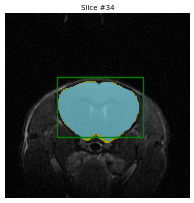

	35: 95.65%	

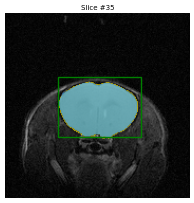

	36: 95.46%	

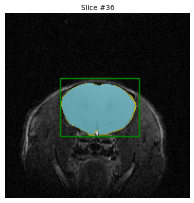

	37: 97.11%	

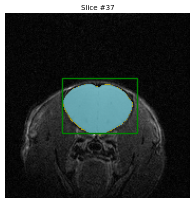

	38: 96.07%	

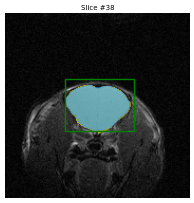

	39: 96.66%	

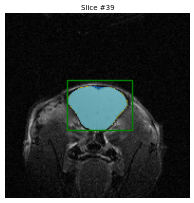

	40: 96.29%	

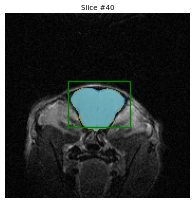

	41: 86.58%	

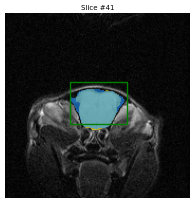

	42: 94.28%	

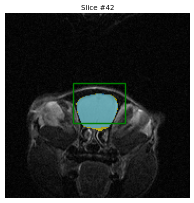

	43: 92.86%	

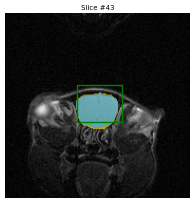

	44: 92.58%	

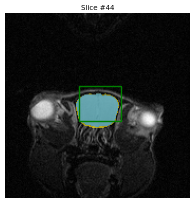

	45: 94.07%	

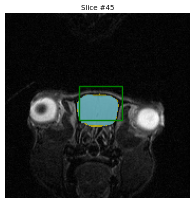

	46: 91.68%	

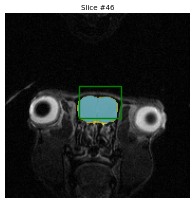

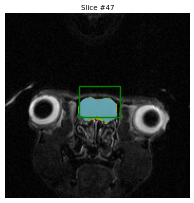

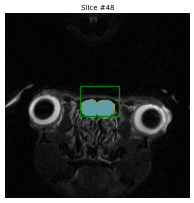

Subject mean performance metrics:
Accuracy:		 94.51%
Jaccard index:		 0.9456
Dice coefficient:	 0.972
accuracy_values_d3 = np.array([94.51])
jaccard_values_d3 = np.array([0.9456])
dice_values_d3 = np.array([0.972])
accur_values_d3 = np.array([96.84, 97.07, 92.48, 93.13, 90.67, 95.1, 92.26, 90.45, 95.14, 93.1, 95.07, 94.18, 95.32, 95.17, 93.99, 94.83, 96.13, 94.34, 96.15, 95.47, 96.31, 93.92, 95.9, 95.38, 95.69, 96.2, 95.37, 94.86, 93.8, 95.67, 95.65, 95.46, 97.11, 96.07, 96.66, 96.29, 86.58, 94.28, 92.86, 92.58, 94.07, 91.68])
jacc_values_d3 = np.array([0.9686, 0.9707, 0.9254, 0.9318, 0.9069, 0.951, 0.9233, 0.9055, 0.9516, 0.9321, 0.9508, 0.9426, 0.9532, 0.9517, 0.9399, 0.9483, 0.9613, 0.9434, 0.9615, 0.9555, 0.9633, 0.9405, 0.959, 0.9538, 0.957, 0.962, 0.9537, 0.9486, 0.9381, 0.9567, 0.9565, 0.9547, 0.9711, 0.9608, 0.9669, 0.9632, 0.8799, 0.9431, 0.9286, 0.9258, 0.9407, 0.9168])
dic_values_d3 = np.array([0.9841, 0.9851, 0.9613, 0.9647, 0.9512, 0.9749, 0.9601, 0.9504, 0.9752, 0.9648, 0

In [11]:
files = []
subjects_path, output_path = subjects_path_d3, pjoin(output_path_base,"full_auto/d3")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.endswith("flip.nii.gz"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

initial_slice = 3
final_slice   = 35

list_of_sam_mask_lists = []
for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    sam_mask_list = create_sam_candidates_list(file, other_lab=True, reference_mask=True)
    list_of_sam_mask_lists.append(sam_mask_list)

print(f"accuracy_values_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

## Evaluation metrics

In [12]:
accuracy_values_3 = np.array([91.01, 85.19, 94.54, 87.7, 86.08, 89.68, 84.88, 86.61, 88.63, 93.41, 87.38, 88.58, 88.2, 90.94, 88.89, 93.07])
jaccard_values_3 = np.array([0.912, 0.8754, 0.9475, 0.8876, 0.8696, 0.9006, 0.8662, 0.8891, 0.8975, 0.9357, 0.8772, 0.8928, 0.8931, 0.9124, 0.8974, 0.9347])
dice_values_3 = np.array([0.9508, 0.9289, 0.9729, 0.9371, 0.922, 0.9462, 0.9246, 0.9385, 0.944, 0.9665, 0.9284, 0.9423, 0.9403, 0.952, 0.9428, 0.9659])
accur_values_3 = np.array([61.28, 69.66, 96.36, 93.6, 96.43, 96.93, 95.28, 96.16, 96.65, 96.33, 96.83, 97.3, 93.18, 89.97, 89.63, 90.59, 69.48, 66.32, 93.39, 94.12, 96.36, 92.36, 93.14, 94.56, 94.54, 95.44, 95.32, 94.43, 32.370000000000005, 87.35, 94.13, 69.71000000000001, 92.04, 92.74, 94.76, 94.89, 97.37, 96.29, 96.0, 97.93, 96.49, 96.83, 96.46, 95.11, 91.7, 86.69, 93.8, 93.52, 58.65, 91.71000000000001, 94.79, 86.03, 88.57, 85.96000000000001, 95.27, 95.88, 97.78, 96.65, 96.56, 94.44, 88.8, 70.56, 94.06, 67.57, 60.41, 87.09, 89.43, 96.3, 98.28, 95.98, 95.27, 98.24, 97.49, 96.17, 94.1, 43.56, 58.61, 90.8, 89.58, 85.93, 70.36, 85.43, 91.12, 86.83, 92.83, 95.7, 94.69, 97.51, 96.7, 95.92, 96.86, 91.76, 83.92, 82.75, 92.87, 79.61, 66.97, 70.62, 87.02, 86.48, 95.26, 94.72, 96.2, 96.87, 96.0, 92.27, 90.95, 89.19, 82.36, 40.14, 91.65, 81.43, 89.41, 92.21, 96.78, 97.22, 94.15, 94.57, 95.28, 94.13, 94.59, 87.86, 90.7, 90.61, 78.32, 64.41, 41.9, 83.55, 73.24, 79.37, 93.73, 96.35, 93.82, 92.56, 94.65, 95.7, 93.34, 96.03, 94.97, 90.99, 73.78999999999999, 63.08, 93.19, 93.33, 93.49, 86.56, 94.82, 94.46, 97.16, 95.4, 96.33, 95.92, 97.29, 95.77, 96.75, 93.55, 90.52, 86.85, 88.63, 91.13, 64.99000000000001, 93.51, 95.38, 89.25, 95.5, 90.95, 94.47, 94.11, 94.24, 95.31, 94.76, 46.02, 91.16, 77.57, 90.5, 90.39, 79.28999999999999, 87.02, 91.01, 80.82, 88.73, 94.33, 95.84, 95.74, 95.16, 95.44, 95.14, 90.81, 90.59, 72.37, 86.24, 78.68, 65.22999999999999, 63.9, 94.09, 94.07, 94.45, 95.58, 93.55, 95.57, 95.89, 96.18, 94.48, 94.26, 89.77, 61.87, 90.76, 91.6, 61.8, 92.34, 92.2, 96.23, 96.57, 89.93, 95.11, 96.31, 96.63, 97.64, 95.55, 92.55, 82.69, 87.91, 91.44, 90.16, 59.04, 87.86, 93.64, 94.05, 94.94, 92.76, 93.62, 95.13, 94.23, 92.88, 96.53, 94.2, 88.15, 61.37, 94.26, 89.52, 91.9, 91.64, 91.28, 96.74, 95.32, 95.5, 95.91, 95.81, 96.73, 94.27, 95.01, 93.84, 77.52, 89.05, 95.18, 93.43])
jacc_values_3 = np.array([0.622, 0.6975, 0.9641, 0.937, 0.9648, 0.9697, 0.9544, 0.9625, 0.9671, 0.9636, 0.9685, 0.9732, 0.9323, 0.9037, 0.905, 0.9072, 0.697, 0.6657, 0.9375, 0.9435, 0.9639, 0.9284, 0.9349, 0.9477, 0.9469, 0.955, 0.9535, 0.9448, 0.5934, 0.8877, 0.9427, 0.7638, 0.9252, 0.9283, 0.9494, 0.9494, 0.974, 0.9638, 0.9612, 0.9796, 0.9651, 0.9684, 0.9649, 0.9512, 0.9209, 0.8826, 0.9396, 0.9359, 0.5874, 0.9174, 0.9492, 0.8606, 0.8869, 0.8654, 0.954, 0.9598, 0.9781, 0.9666, 0.9662, 0.9452, 0.8976, 0.7721, 0.9423, 0.7526, 0.6063, 0.8711, 0.8948, 0.9632, 0.983, 0.9605, 0.9529, 0.9825, 0.975, 0.9619, 0.9411, 0.436, 0.7051, 0.9122, 0.8963, 0.8712, 0.7038, 0.8546, 0.9115, 0.8687, 0.9286, 0.9582, 0.9471, 0.9755, 0.9676, 0.9595, 0.9688, 0.9178, 0.8405, 0.8517, 0.9301, 0.8254, 0.6697, 0.7066, 0.8724, 0.865, 0.9531, 0.9485, 0.9627, 0.969, 0.9602, 0.9229, 0.9103, 0.8945, 0.8486, 0.6216, 0.9175, 0.8362, 0.8945, 0.9226, 0.9683, 0.9726, 0.9436, 0.948, 0.9544, 0.9436, 0.9482, 0.8914, 0.9128, 0.9106, 0.8154, 0.7264, 0.6248, 0.8484, 0.7374, 0.7955, 0.9392, 0.9643, 0.9402, 0.9297, 0.948, 0.9576, 0.9357, 0.9605, 0.9502, 0.9118, 0.7911, 0.7304, 0.9343, 0.9348, 0.9354, 0.8662, 0.9487, 0.945, 0.9721, 0.9551, 0.964, 0.9596, 0.9731, 0.9578, 0.9677, 0.9355, 0.9061, 0.8824, 0.8891, 0.9134, 0.651, 0.9353, 0.9541, 0.8935, 0.9553, 0.9142, 0.9465, 0.9436, 0.9448, 0.9546, 0.9482, 0.4611, 0.9143, 0.8063, 0.9076, 0.9051, 0.793, 0.8705, 0.9106, 0.8088, 0.8875, 0.9449, 0.959, 0.9582, 0.9528, 0.956, 0.952, 0.9084, 0.9096, 0.7831, 0.8733, 0.8179, 0.707, 0.6415, 0.9416, 0.9433, 0.9451, 0.9567, 0.938, 0.9568, 0.9598, 0.9619, 0.9453, 0.9428, 0.899, 0.7235, 0.9095, 0.9171, 0.6198, 0.9243, 0.9223, 0.9626, 0.9662, 0.9015, 0.9523, 0.9638, 0.9671, 0.9765, 0.9557, 0.9256, 0.8511, 0.8899, 0.9167, 0.9036, 0.5922, 0.8792, 0.9366, 0.9412, 0.9495, 0.9315, 0.9385, 0.9527, 0.9441, 0.932, 0.9659, 0.9434, 0.8906, 0.7213, 0.943, 0.8963, 0.9196, 0.917, 0.9162, 0.9676, 0.9544, 0.9563, 0.9598, 0.9587, 0.968, 0.9453, 0.9511, 0.9388, 0.8145, 0.8994, 0.9523, 0.9366])
dic_values_3 = np.array([0.767, 0.8218, 0.9817, 0.9675, 0.9821, 0.9846, 0.9767, 0.9809, 0.9833, 0.9815, 0.984, 0.9864, 0.9649, 0.9494, 0.9501, 0.9513, 0.8214, 0.7993, 0.9677, 0.9709, 0.9816, 0.9629, 0.9664, 0.9731, 0.9727, 0.977, 0.9762, 0.9716, 0.7448, 0.9405, 0.9705, 0.8661, 0.9612, 0.9628, 0.974, 0.9741, 0.9868, 0.9816, 0.9802, 0.9897, 0.9823, 0.984, 0.9822, 0.975, 0.9588, 0.9376, 0.9689, 0.9669, 0.7401, 0.9569, 0.974, 0.9251, 0.94, 0.9278, 0.9764, 0.9795, 0.9889, 0.983, 0.9828, 0.9718, 0.9461, 0.8714, 0.9703, 0.8588, 0.7549, 0.9311, 0.9445, 0.9812, 0.9914, 0.9799, 0.9759, 0.9912, 0.9873, 0.9806, 0.9696, 0.6073, 0.827, 0.9541, 0.9453, 0.9312, 0.8262, 0.9216, 0.9537, 0.9297, 0.963, 0.9786, 0.9728, 0.9876, 0.9835, 0.9793, 0.9841, 0.9572, 0.9133, 0.9199, 0.9638, 0.9043, 0.8022, 0.8281, 0.9318, 0.9276, 0.976, 0.9735, 0.981, 0.9843, 0.9797, 0.9599, 0.953, 0.9443, 0.9181, 0.7666, 0.957, 0.9108, 0.9443, 0.9598, 0.9839, 0.9861, 0.971, 0.9733, 0.9767, 0.971, 0.9734, 0.9426, 0.9544, 0.9532, 0.8983, 0.8415, 0.7691, 0.918, 0.8488, 0.8861, 0.9686, 0.9818, 0.9692, 0.9636, 0.9733, 0.9784, 0.9668, 0.9798, 0.9745, 0.9539, 0.8834, 0.8442, 0.966, 0.9663, 0.9666, 0.9283, 0.9737, 0.9717, 0.9858, 0.9771, 0.9817, 0.9794, 0.9864, 0.9784, 0.9836, 0.9667, 0.9507, 0.9375, 0.9413, 0.9547, 0.7886, 0.9666, 0.9765, 0.9437, 0.9771, 0.9552, 0.9725, 0.971, 0.9716, 0.9768, 0.9734, 0.6312, 0.9552, 0.8928, 0.9516, 0.9502, 0.8846, 0.9308, 0.9532, 0.8943, 0.9404, 0.9717, 0.9791, 0.9787, 0.9758, 0.9775, 0.9754, 0.952, 0.9526, 0.8784, 0.9324, 0.8999, 0.8283, 0.7816, 0.9699, 0.9708, 0.9718, 0.9779, 0.968, 0.9779, 0.9795, 0.9806, 0.9719, 0.9705, 0.9468, 0.8396, 0.9526, 0.9568, 0.7653, 0.9606, 0.9596, 0.9809, 0.9828, 0.9482, 0.9755, 0.9816, 0.9833, 0.9881, 0.9774, 0.9614, 0.9196, 0.9418, 0.9565, 0.9494, 0.7439, 0.9357, 0.9673, 0.9697, 0.9741, 0.9646, 0.9683, 0.9758, 0.9713, 0.9648, 0.9826, 0.9709, 0.9421, 0.8381, 0.9707, 0.9453, 0.9581, 0.9567, 0.9563, 0.9835, 0.9767, 0.9776, 0.9795, 0.9789, 0.9837, 0.9719, 0.9749, 0.9684, 0.8978, 0.947, 0.9756, 0.9673])

accuracy_values_4_5 = np.array([93.02, 88.04, 88.59, 88.94, 90.84, 93.5, 92.41, 91.23, 93.55, 91.52, 94.25])
jaccard_values_4_5 = np.array([0.9338, 0.8894, 0.8983, 0.897, 0.9146, 0.9369, 0.9297, 0.9175, 0.9378, 0.9231, 0.9445])
dice_values_4_5 = np.array([0.9654, 0.9385, 0.9439, 0.9433, 0.9545, 0.967, 0.963, 0.9564, 0.9677, 0.9591, 0.9713])
accur_values_4_5 = np.array([77.5, 91.82, 95.67, 92.79, 97.1, 93.34, 90.38, 95.41, 96.66, 96.66, 96.35, 96.0, 93.6, 89.86, 91.58, 93.6, 58.92, 82.66, 91.95, 89.02, 97.29, 89.67, 94.26, 93.78, 93.24, 92.76, 96.47, 91.42, 72.31, 74.76, 95.71, 94.4, 73.49, 66.49000000000001, 91.61, 96.52, 94.38, 96.65, 91.16, 94.22, 96.17, 95.14, 92.67, 95.34, 92.31, 61.68, 85.32, 94.34, 72.84, 70.55, 82.38, 92.77, 95.44, 95.83, 95.17, 94.64, 94.66, 94.45, 96.82, 95.66, 92.34, 63.7, 93.67, 92.18, 93.97, 85.53999999999999, 89.19, 95.68, 94.91, 95.78, 90.85, 95.4, 96.16, 91.56, 95.43, 92.88, 88.89, 82.82, 70.1, 94.29, 88.03999999999999, 93.24, 92.9, 96.72, 96.41, 96.7, 96.09, 96.47, 96.85, 96.97, 95.54, 93.16, 90.69, 82.6, 96.12, 87.46000000000001, 90.08, 90.6, 94.57, 96.84, 96.62, 93.75, 94.25, 95.14, 94.36, 95.23, 96.13, 95.86, 94.09, 80.94, 77.65, 92.45, 93.48, 85.17, 95.53, 93.64, 95.03, 93.25, 94.25, 95.53, 94.83, 93.42, 93.52, 93.7, 88.03, 86.78, 85.22, 78.34, 85.92, 94.0, 91.76, 95.28, 97.11, 96.62, 90.53999999999999, 94.09, 95.92, 96.21, 93.63, 97.01, 96.16, 91.0, 88.7, 92.79, 93.77, 94.75, 94.74, 92.46, 96.05, 96.33, 92.43, 92.82, 95.84, 95.62, 95.9, 95.1, 91.42, 76.28, 68.94, 91.83, 93.91, 96.79, 94.52, 97.02, 97.69, 92.97, 91.85, 96.2, 96.72, 97.1, 90.97, 95.5, 90.63, 89.71000000000001, 93.01, 93.37])
jacc_values_4_5 = np.array([0.8076, 0.9182, 0.9573, 0.9299, 0.9712, 0.9365, 0.9116, 0.9556, 0.9671, 0.967, 0.9642, 0.9603, 0.9362, 0.9039, 0.917, 0.9376, 0.5948, 0.8275, 0.9241, 0.8927, 0.9732, 0.8998, 0.9451, 0.9408, 0.9361, 0.9321, 0.9657, 0.9187, 0.7803, 0.7962, 0.9579, 0.9455, 0.7839, 0.6694, 0.9177, 0.9656, 0.9448, 0.9667, 0.9137, 0.9448, 0.9626, 0.9519, 0.9309, 0.9537, 0.9275, 0.7222, 0.872, 0.9447, 0.7415, 0.7061, 0.8243, 0.9279, 0.9545, 0.9585, 0.9528, 0.9475, 0.9483, 0.9463, 0.9685, 0.9571, 0.9256, 0.7327, 0.9374, 0.9235, 0.9412, 0.8555, 0.8924, 0.957, 0.9494, 0.9586, 0.915, 0.9553, 0.9623, 0.921, 0.9551, 0.9314, 0.8929, 0.8387, 0.7642, 0.943, 0.8804, 0.933, 0.9296, 0.9674, 0.9641, 0.9676, 0.9615, 0.9652, 0.9686, 0.9698, 0.9555, 0.9318, 0.908, 0.8499, 0.9614, 0.8771, 0.9084, 0.9072, 0.948, 0.9686, 0.9666, 0.9403, 0.9444, 0.9528, 0.9458, 0.9535, 0.9619, 0.9595, 0.9438, 0.838, 0.8108, 0.9258, 0.9363, 0.8523, 0.9559, 0.9379, 0.9517, 0.9358, 0.9452, 0.9564, 0.9503, 0.9376, 0.937, 0.9387, 0.8901, 0.8769, 0.8678, 0.8093, 0.8704, 0.9418, 0.9183, 0.954, 0.9714, 0.9666, 0.9078, 0.944, 0.9605, 0.963, 0.9392, 0.9706, 0.9621, 0.9143, 0.8923, 0.9286, 0.9379, 0.9475, 0.9486, 0.9256, 0.9606, 0.964, 0.9281, 0.932, 0.9597, 0.9569, 0.9597, 0.9514, 0.9167, 0.8032, 0.7593, 0.9183, 0.9421, 0.9681, 0.9477, 0.9705, 0.9771, 0.933, 0.924, 0.9631, 0.9677, 0.9715, 0.9163, 0.9559, 0.9089, 0.8989, 0.9315, 0.9362])
dic_values_4_5 = np.array([0.8935, 0.9574, 0.9782, 0.9637, 0.9854, 0.9672, 0.9538, 0.9773, 0.9833, 0.9832, 0.9818, 0.9798, 0.9671, 0.9495, 0.9567, 0.9678, 0.7459, 0.9056, 0.9606, 0.9433, 0.9864, 0.9473, 0.9718, 0.9695, 0.967, 0.9649, 0.9826, 0.9576, 0.8766, 0.8865, 0.9785, 0.972, 0.8789, 0.8019, 0.9571, 0.9825, 0.9716, 0.9831, 0.9549, 0.9716, 0.9809, 0.9753, 0.9642, 0.9763, 0.9624, 0.8387, 0.9316, 0.9716, 0.8516, 0.8277, 0.9037, 0.9626, 0.9767, 0.9788, 0.9758, 0.973, 0.9734, 0.9724, 0.984, 0.9781, 0.9614, 0.8457, 0.9677, 0.9602, 0.9697, 0.9221, 0.9431, 0.978, 0.9741, 0.9789, 0.9556, 0.9771, 0.9808, 0.9589, 0.977, 0.9645, 0.9434, 0.9123, 0.8663, 0.9707, 0.9364, 0.9653, 0.9635, 0.9834, 0.9817, 0.9836, 0.9804, 0.9823, 0.984, 0.9847, 0.9772, 0.9647, 0.9518, 0.9189, 0.9803, 0.9345, 0.952, 0.9514, 0.9733, 0.9841, 0.983, 0.9692, 0.9714, 0.9758, 0.9722, 0.9762, 0.9806, 0.9793, 0.9711, 0.9119, 0.8955, 0.9615, 0.9671, 0.9203, 0.9775, 0.9679, 0.9753, 0.9668, 0.9719, 0.9777, 0.9745, 0.9678, 0.9675, 0.9684, 0.9419, 0.9344, 0.9292, 0.8946, 0.9307, 0.97, 0.9574, 0.9765, 0.9855, 0.983, 0.9517, 0.9712, 0.9798, 0.9812, 0.9686, 0.9851, 0.9807, 0.9552, 0.9431, 0.963, 0.9679, 0.973, 0.9736, 0.9614, 0.9799, 0.9817, 0.9627, 0.9648, 0.9794, 0.978, 0.9794, 0.9751, 0.9566, 0.8908, 0.8632, 0.9574, 0.9702, 0.9838, 0.9731, 0.9851, 0.9884, 0.9654, 0.9605, 0.9812, 0.9836, 0.9855, 0.9563, 0.9774, 0.9523, 0.9468, 0.9645, 0.9671])

accuracy_values_6 = np.array([91.61, 90.75, 91.91, 89.63, 93.44, 90.3, 87.94, 92.47, 91.53, 82.68, 91.06])
jaccard_values_6 = np.array([0.9205, 0.9149, 0.9249, 0.9052, 0.9381, 0.9155, 0.8948, 0.927, 0.9211, 0.8647, 0.9183])
dice_values_6 = np.array([0.9579, 0.9545, 0.9604, 0.9492, 0.9676, 0.9543, 0.943, 0.9617, 0.9581, 0.9233, 0.9565])
accur_values_6 = np.array([76.67, 92.15, 94.69, 90.59, 95.23, 95.85, 92.27, 92.19, 94.36, 95.38, 95.61, 95.4, 93.94, 86.32, 80.89, 94.28, 82.76, 88.21000000000001, 91.77, 95.78, 96.24, 91.07, 91.56, 95.44, 96.54, 96.85, 95.57, 94.52, 86.24, 66.81, 89.47, 93.21, 90.19, 89.87, 93.93, 96.49, 96.35, 92.53, 93.88, 94.77, 95.9, 95.15, 97.17, 94.36, 85.81, 75.26, 87.1, 91.88, 88.65, 85.3, 94.44, 95.74, 97.92, 95.54, 92.91, 92.75, 93.65, 92.42, 95.39, 89.67, 88.49, 84.83, 69.2, 77.17, 90.03999999999999, 93.45, 96.38, 94.94, 97.68, 96.38, 94.9, 95.0, 95.14, 97.62, 96.05, 96.81, 93.33, 83.39, 83.16, 90.7, 96.6, 91.81, 96.64, 96.32, 96.73, 92.06, 89.89, 94.19, 95.57, 96.18, 95.04, 97.05, 87.14, 71.06, 60.61, 87.93, 86.36, 89.14, 93.56, 94.18, 95.1, 92.88, 94.04, 95.37, 93.22, 92.86, 91.26, 92.23, 85.47, 59.3, 81.78, 70.25, 86.58, 86.51, 95.97, 94.96, 96.35, 96.47, 92.3, 93.95, 95.36, 96.63, 95.93, 94.49, 88.6, 85.68, 91.32, 88.36, 82.2, 88.46000000000001, 96.96, 95.98, 95.25, 94.68, 94.26, 94.33, 94.48, 95.09, 92.55, 95.96, 93.56, 84.59, 73.5, 92.56, 79.67, 87.28999999999999, 95.0, 96.82, 92.43, 92.66, 93.72, 92.7, 95.41, 92.55, 92.82, 94.44, 39.63, 52.45, 61.5, 63.74, 95.1, 94.81, 93.98, 94.11, 95.8, 94.81, 95.35, 96.21, 96.58, 93.73, 94.3, 92.24, 77.11, 79.6, 75.49, 87.78999999999999])
jacc_values_6 = np.array([0.7884, 0.9217, 0.9477, 0.9066, 0.9525, 0.9595, 0.927, 0.9265, 0.9458, 0.9544, 0.9565, 0.9543, 0.9401, 0.8698, 0.8333, 0.9432, 0.8291, 0.8831, 0.918, 0.9588, 0.9628, 0.9126, 0.9211, 0.9561, 0.9659, 0.9689, 0.9564, 0.9467, 0.8725, 0.7492, 0.903, 0.9337, 0.905, 0.8994, 0.9419, 0.9651, 0.9641, 0.93, 0.9417, 0.9498, 0.96, 0.9527, 0.9719, 0.9438, 0.8741, 0.7969, 0.883, 0.9194, 0.8889, 0.8532, 0.9449, 0.9575, 0.9793, 0.9567, 0.9325, 0.9306, 0.9388, 0.927, 0.9551, 0.8986, 0.8909, 0.8624, 0.7572, 0.8091, 0.9085, 0.9352, 0.9645, 0.951, 0.977, 0.9646, 0.9509, 0.9519, 0.9528, 0.9764, 0.9612, 0.9684, 0.9337, 0.8558, 0.8464, 0.9105, 0.9663, 0.919, 0.9667, 0.9638, 0.9681, 0.9258, 0.9075, 0.9445, 0.9569, 0.9621, 0.9515, 0.9708, 0.8734, 0.7752, 0.7116, 0.8843, 0.8713, 0.8919, 0.9377, 0.9418, 0.9512, 0.933, 0.9427, 0.955, 0.9356, 0.9324, 0.9158, 0.9248, 0.8694, 0.7063, 0.8384, 0.7692, 0.872, 0.8666, 0.9607, 0.9507, 0.9637, 0.9652, 0.9273, 0.9418, 0.9551, 0.9671, 0.9596, 0.9457, 0.888, 0.8614, 0.9143, 0.8923, 0.8318, 0.8852, 0.9701, 0.9603, 0.9534, 0.9482, 0.9452, 0.9455, 0.947, 0.9524, 0.9299, 0.9604, 0.9377, 0.8602, 0.7828, 0.927, 0.7973, 0.8804, 0.9505, 0.9685, 0.9284, 0.9313, 0.9403, 0.9312, 0.9556, 0.9297, 0.9316, 0.9467, 0.6235, 0.6763, 0.7201, 0.7238, 0.9513, 0.9496, 0.9399, 0.9412, 0.959, 0.9493, 0.9545, 0.9628, 0.9659, 0.9389, 0.9431, 0.9235, 0.8004, 0.829, 0.8024, 0.8813])
dic_values_6 = np.array([0.8817, 0.9593, 0.9732, 0.951, 0.9757, 0.9793, 0.9621, 0.9618, 0.9721, 0.9767, 0.9778, 0.9766, 0.9691, 0.9304, 0.9091, 0.9708, 0.9065, 0.9379, 0.9572, 0.979, 0.981, 0.9543, 0.9589, 0.9775, 0.9826, 0.9842, 0.9777, 0.9726, 0.9319, 0.8566, 0.949, 0.9657, 0.9501, 0.947, 0.9701, 0.9822, 0.9817, 0.9637, 0.97, 0.9742, 0.9796, 0.9758, 0.9857, 0.9711, 0.9328, 0.8869, 0.9379, 0.958, 0.9412, 0.9208, 0.9717, 0.9783, 0.9896, 0.9779, 0.9651, 0.964, 0.9685, 0.9621, 0.977, 0.9466, 0.9423, 0.9261, 0.8619, 0.8945, 0.9521, 0.9665, 0.982, 0.9749, 0.9884, 0.982, 0.9748, 0.9754, 0.9758, 0.9881, 0.9802, 0.984, 0.9657, 0.9223, 0.9168, 0.9531, 0.9829, 0.9578, 0.9831, 0.9816, 0.9838, 0.9615, 0.9515, 0.9714, 0.978, 0.9807, 0.9751, 0.9852, 0.9324, 0.8734, 0.8315, 0.9386, 0.9312, 0.9429, 0.9679, 0.97, 0.975, 0.9653, 0.9705, 0.977, 0.9667, 0.965, 0.956, 0.9609, 0.9302, 0.8279, 0.9121, 0.8696, 0.9316, 0.9285, 0.98, 0.9747, 0.9815, 0.9823, 0.9623, 0.97, 0.977, 0.9833, 0.9794, 0.9721, 0.9407, 0.9256, 0.9553, 0.9431, 0.9082, 0.9391, 0.9848, 0.9797, 0.9761, 0.9734, 0.9718, 0.972, 0.9728, 0.9756, 0.9637, 0.9798, 0.9678, 0.9248, 0.8782, 0.9621, 0.8873, 0.9364, 0.9746, 0.984, 0.9629, 0.9644, 0.9692, 0.9644, 0.9773, 0.9635, 0.9646, 0.9726, 0.7681, 0.8069, 0.8373, 0.8398, 0.975, 0.9742, 0.969, 0.9697, 0.9791, 0.974, 0.9767, 0.9811, 0.9826, 0.9685, 0.9707, 0.9602, 0.8891, 0.9065, 0.8904, 0.9369])

accuracy_values_12 = np.array([88.25, 85.47, 87.44, 84.91, 81.78, 88.82, 85.12, 85.1, 89.03, 88.65, 84.27, 80.65, 84.75, 83.54, 82.71])
jaccard_values_12 = np.array([0.8999, 0.8737, 0.8946, 0.8719, 0.8618, 0.9053, 0.8758, 0.8813, 0.9023, 0.9036, 0.8823, 0.8513, 0.8752, 0.8638, 0.8629])
dice_values_12 = np.array([0.9455, 0.9283, 0.9423, 0.9288, 0.9218, 0.9486, 0.9321, 0.9324, 0.948, 0.9478, 0.9332, 0.916, 0.9304, 0.9156, 0.9232])
accur_values_12 = np.array([83.6, 88.01, 87.59, 83.32, 96.43, 95.78, 93.37, 93.8, 96.38, 97.26, 92.5, 94.99, 95.42, 83.43, 78.75, 51.44, 35.45, 73.43, 92.24, 80.24, 92.11, 96.09, 92.19, 87.86, 86.94, 89.55, 95.64, 94.35, 92.06, 79.57, 87.95, 91.9, 76.75, 85.37, 87.38, 90.71000000000001, 95.36, 93.87, 91.03, 89.42, 94.83, 95.75, 94.04, 96.67, 93.5, 72.77, 48.67, 92.87, 65.83, 80.91, 75.3, 93.86, 94.84, 91.25, 91.19, 87.64, 91.45, 94.68, 94.62, 89.48, 89.9, 45.31, 83.03999999999999, 89.32, 88.46000000000001, 78.53999999999999, 79.81, 91.14, 95.95, 93.0, 85.17, 94.78, 96.0, 95.6, 95.36, 90.33, 29.730000000000004, 48.32, 68.06, 78.19, 89.8, 95.19, 81.02, 92.9, 96.79, 89.03, 89.77, 90.65, 96.75, 97.78, 95.98, 96.84, 90.12, 67.61, 59.16, 91.76, 78.64, 86.07, 72.09, 71.82, 93.25, 91.46000000000001, 89.57, 90.0, 94.09, 95.03, 96.44, 94.12, 90.38, 82.16, 57.67, 79.2, 90.14, 63.64, 89.34, 78.97, 93.06, 95.54, 94.78, 93.23, 96.81, 94.67, 92.65, 95.91, 87.34, 18.33, 83.33, 93.86, 88.03, 94.09, 78.33, 76.27, 91.91, 92.74, 90.63, 90.77, 93.42, 96.49, 95.65, 94.59, 89.28, 85.69, 82.16, 84.5, 90.35, 90.89, 77.59, 89.44, 95.52, 92.14, 89.4, 94.38, 94.81, 95.78, 95.51, 95.62, 89.12, 90.92, 51.2, 85.78, 92.72, 85.59, 89.23, 95.37, 95.88, 92.47, 92.1, 92.99, 94.82, 95.47, 94.98, 94.86, 60.15, 64.15, 18.620000000000005, 88.92, 77.9, 92.82, 76.21000000000001, 76.47, 91.25, 96.37, 90.27, 80.88, 89.34, 92.53, 95.31, 94.89, 89.12, 47.05, 43.98, 56.06, 87.14, 93.8, 75.53999999999999, 83.95, 94.43, 94.55, 90.69, 90.03999999999999, 92.54, 90.91, 94.53, 92.86, 87.28999999999999, 67.5, 34.129999999999995, 86.05, 84.96000000000001, 94.29, 78.28999999999999, 90.16, 95.6, 95.63, 90.27, 94.12, 94.95, 96.49, 93.2, 95.62, 87.43, 81.86, 61.45, 2.3900000000000006, 83.42, 90.28, 84.34, 94.53, 94.93, 91.22, 90.78, 89.23, 93.29, 90.17, 93.45, 94.36, 62.69, 67.97, 41.06, 61.65])
jacc_values_12 = np.array([0.8509, 0.8927, 0.8886, 0.8566, 0.9649, 0.9591, 0.9373, 0.941, 0.9648, 0.9728, 0.9282, 0.951, 0.9545, 0.8405, 0.8228, 0.6731, 0.5073, 0.7396, 0.9274, 0.8346, 0.9267, 0.9617, 0.9274, 0.8917, 0.8844, 0.9051, 0.9578, 0.9462, 0.9248, 0.8296, 0.8906, 0.9243, 0.7868, 0.8708, 0.8871, 0.9142, 0.9553, 0.9422, 0.9173, 0.9041, 0.9506, 0.9588, 0.9429, 0.9674, 0.9381, 0.786, 0.6603, 0.9318, 0.6621, 0.8393, 0.8016, 0.9417, 0.9498, 0.9194, 0.9188, 0.89, 0.9212, 0.9489, 0.9485, 0.9045, 0.9064, 0.6465, 0.855, 0.897, 0.8953, 0.8222, 0.8315, 0.9181, 0.9607, 0.9341, 0.8707, 0.9503, 0.9611, 0.9572, 0.9552, 0.91, 0.587, 0.6593, 0.7575, 0.8192, 0.9062, 0.9534, 0.8398, 0.933, 0.9686, 0.901, 0.907, 0.9145, 0.9684, 0.9782, 0.9607, 0.9691, 0.9024, 0.7544, 0.7076, 0.9212, 0.824, 0.875, 0.7814, 0.7802, 0.9367, 0.9213, 0.9055, 0.909, 0.9442, 0.9524, 0.965, 0.9437, 0.9065, 0.84, 0.7015, 0.8259, 0.9096, 0.6441, 0.9032, 0.8261, 0.9348, 0.9568, 0.9495, 0.9362, 0.9687, 0.9492, 0.9311, 0.9597, 0.8842, 0.5504, 0.8557, 0.9419, 0.8908, 0.9434, 0.8218, 0.8082, 0.923, 0.9323, 0.9143, 0.9155, 0.9381, 0.966, 0.9576, 0.9479, 0.8964, 0.8748, 0.8474, 0.8594, 0.9115, 0.9158, 0.8167, 0.9041, 0.9569, 0.9269, 0.9039, 0.9468, 0.9504, 0.9592, 0.956, 0.9572, 0.8928, 0.9136, 0.6715, 0.8747, 0.9305, 0.8724, 0.9021, 0.9554, 0.9598, 0.929, 0.9265, 0.9342, 0.9503, 0.9559, 0.9516, 0.9505, 0.7125, 0.7361, 0.5513, 0.8983, 0.819, 0.9322, 0.8076, 0.8095, 0.9192, 0.9649, 0.911, 0.8395, 0.9036, 0.9303, 0.9545, 0.9508, 0.8947, 0.6478, 0.6409, 0.6947, 0.8851, 0.9401, 0.8029, 0.861, 0.9464, 0.9482, 0.9148, 0.9094, 0.9306, 0.9166, 0.9479, 0.933, 0.8805, 0.7311, 0.5836, 0.8715, 0.8515, 0.9448, 0.8215, 0.9088, 0.9574, 0.958, 0.9103, 0.9441, 0.9518, 0.9656, 0.9348, 0.9569, 0.8789, 0.8349, 0.7213, 0.2799, 0.8491, 0.9109, 0.8645, 0.9479, 0.9513, 0.9192, 0.9154, 0.9026, 0.9364, 0.9098, 0.938, 0.9452, 0.717, 0.7539, 0.6256, 0.7193])
dic_values_12 = np.array([0.9194, 0.9433, 0.941, 0.9228, 0.9821, 0.9791, 0.9677, 0.9696, 0.9821, 0.9862, 0.9628, 0.9749, 0.9767, 0.9133, 0.9028, 0.8046, 0.6731, 0.8503, 0.9623, 0.9098, 0.9619, 0.9805, 0.9623, 0.9428, 0.9386, 0.9502, 0.9785, 0.9724, 0.9609, 0.9069, 0.9421, 0.9607, 0.8807, 0.9309, 0.9402, 0.9552, 0.9771, 0.9702, 0.9569, 0.9496, 0.9747, 0.979, 0.9706, 0.9834, 0.9681, 0.8801, 0.7954, 0.9647, 0.7967, 0.9126, 0.8899, 0.97, 0.9743, 0.958, 0.9577, 0.9418, 0.959, 0.9738, 0.9736, 0.9498, 0.9509, 0.7853, 0.9218, 0.9457, 0.9448, 0.9025, 0.908, 0.9573, 0.98, 0.966, 0.9309, 0.9745, 0.9802, 0.9782, 0.9771, 0.9529, 0.7397, 0.7947, 0.862, 0.9006, 0.9508, 0.9761, 0.9129, 0.9654, 0.9841, 0.9479, 0.9512, 0.9553, 0.9839, 0.989, 0.98, 0.9843, 0.9487, 0.86, 0.8288, 0.959, 0.9035, 0.9333, 0.8773, 0.8765, 0.9673, 0.959, 0.9504, 0.9524, 0.9713, 0.9756, 0.9822, 0.971, 0.9509, 0.913, 0.8246, 0.9046, 0.9527, 0.7835, 0.9491, 0.9048, 0.9663, 0.9779, 0.9741, 0.967, 0.9841, 0.974, 0.9643, 0.9794, 0.9385, 0.71, 0.9222, 0.9701, 0.9422, 0.9709, 0.9022, 0.8939, 0.96, 0.965, 0.9552, 0.9559, 0.9681, 0.9827, 0.9784, 0.9733, 0.9454, 0.9332, 0.9174, 0.9244, 0.9537, 0.956, 0.8991, 0.9497, 0.978, 0.9621, 0.9495, 0.9727, 0.9746, 0.9792, 0.9775, 0.9781, 0.9433, 0.9548, 0.8035, 0.9332, 0.964, 0.9319, 0.9485, 0.9772, 0.9795, 0.9632, 0.9618, 0.966, 0.9745, 0.9775, 0.9752, 0.9746, 0.8321, 0.848, 0.7108, 0.9464, 0.9005, 0.9649, 0.8935, 0.8947, 0.9579, 0.9821, 0.9534, 0.9127, 0.9494, 0.9639, 0.9767, 0.9748, 0.9444, 0.7863, 0.7812, 0.8199, 0.939, 0.9691, 0.8907, 0.9253, 0.9725, 0.9734, 0.9555, 0.9525, 0.964, 0.9565, 0.9732, 0.9653, 0.9364, 0.8447, 0.737, 0.9313, 0.9198, 0.9716, 0.902, 0.9522, 0.9782, 0.9786, 0.953, 0.9713, 0.9753, 0.9825, 0.9663, 0.978, 0.9356, 0.91, 0.8381, 0.4374, 0.9184, 0.9534, 0.9273, 0.9732, 0.9751, 0.9579, 0.9558, 0.9488, 0.9672, 0.9528, 0.968, 0.9718, 0.8352, 0.8597, 0.7697, 0.8368])

accuracy_values_d2 = np.array([95.22, 93.87, 95.34, 95.7, 95.17, 94.81, 94.78, 96.02, 96.25, 93.98])
jaccard_values_d2 = np.array([0.9528, 0.9395, 0.9541, 0.9576, 0.9526, 0.9492, 0.9495, 0.9613, 0.9629, 0.9406])
dice_values_d2 = np.array([0.9756, 0.9664, 0.9763, 0.9783, 0.9755, 0.9736, 0.9738, 0.9801, 0.981, 0.9673])
accur_values_d2 = np.array([92.05, 97.48, 91.11, 88.07, 95.95, 97.91, 97.17, 97.9, 98.0, 96.95, 95.4, 96.69, 98.13, 95.41, 93.06, 96.02, 94.29, 94.66, 92.88, 93.2, 96.58, 88.96000000000001, 96.77, 95.33, 96.05, 97.82, 97.58, 98.58, 98.82, 96.26, 97.61, 96.15, 96.81, 94.3, 92.42, 96.67, 95.47, 58.21, 91.59, 95.85, 97.44, 96.43, 94.19, 97.62, 95.15, 95.81, 98.37, 97.95, 95.69, 97.91, 97.13, 96.87, 93.9, 87.23, 95.21, 94.82, 92.23, 92.26, 96.75, 91.85, 94.59, 97.5, 97.21, 97.78, 97.56, 97.08, 97.38, 95.82, 97.63, 96.97, 94.83, 95.91, 94.22, 94.2, 95.62, 93.16, 86.37, 94.54, 88.78999999999999, 95.0, 97.0, 97.78, 98.26, 98.05, 98.17, 97.29, 97.26, 96.52, 95.7, 96.11, 94.34, 94.22, 95.2, 95.68, 92.0, 87.61, 93.53, 86.15, 96.53, 95.57, 97.79, 97.76, 98.46, 98.03, 98.1, 97.49, 93.84, 96.65, 96.15, 93.57, 91.34, 94.47, 94.19, 94.18, 93.39, 96.73, 92.71, 85.86, 94.8, 97.13, 97.63, 97.33, 98.41, 98.13, 97.38, 94.73, 97.77, 93.92, 89.91, 94.14, 96.74, 94.8, 89.27, 90.76, 96.13, 91.15, 94.81, 96.3, 97.98, 97.68, 98.25, 98.15, 97.91, 97.77, 96.07, 96.51, 97.35, 93.39, 95.95, 95.29, 96.32, 96.62, 95.06, 96.43, 89.09, 96.46, 94.21, 97.73, 98.38, 98.59, 98.39, 98.32, 98.19, 97.22, 97.34, 97.22, 93.52, 93.67, 98.01, 96.33, 94.55, 84.39, 62.54, 95.44, 91.87, 95.68, 97.92, 98.22, 98.3, 98.11, 98.87, 96.9, 97.86, 97.67, 97.24, 91.62, 94.55, 95.25, 97.43, 95.71])
jacc_values_d2 = np.array([0.9245, 0.975, 0.9127, 0.8812, 0.9595, 0.9792, 0.9717, 0.979, 0.98, 0.9695, 0.9553, 0.9669, 0.9814, 0.9542, 0.9327, 0.9605, 0.9429, 0.9467, 0.9294, 0.9357, 0.966, 0.89, 0.9679, 0.9546, 0.9613, 0.9785, 0.976, 0.9859, 0.9882, 0.9634, 0.9761, 0.9625, 0.9682, 0.9447, 0.9283, 0.9668, 0.9547, 0.5825, 0.9206, 0.9593, 0.9747, 0.9647, 0.9436, 0.9763, 0.9529, 0.9594, 0.9838, 0.9795, 0.9581, 0.9792, 0.9716, 0.969, 0.9404, 0.8725, 0.9521, 0.9482, 0.9223, 0.9261, 0.9677, 0.9187, 0.9476, 0.9751, 0.9722, 0.9778, 0.9757, 0.9708, 0.9738, 0.959, 0.9764, 0.9698, 0.9494, 0.9591, 0.9438, 0.942, 0.9563, 0.9329, 0.8737, 0.9473, 0.8883, 0.9503, 0.9701, 0.9781, 0.9826, 0.9806, 0.9817, 0.9729, 0.9726, 0.9656, 0.9574, 0.9614, 0.9439, 0.9437, 0.9531, 0.9568, 0.92, 0.8875, 0.9374, 0.8618, 0.9656, 0.9564, 0.9781, 0.9778, 0.9846, 0.9803, 0.981, 0.9749, 0.9387, 0.9668, 0.9622, 0.9381, 0.9141, 0.945, 0.9419, 0.942, 0.9364, 0.9677, 0.9276, 0.8588, 0.9486, 0.9715, 0.9763, 0.9734, 0.9841, 0.9813, 0.974, 0.9495, 0.978, 0.942, 0.9077, 0.9443, 0.968, 0.9498, 0.9007, 0.9145, 0.9623, 0.9136, 0.9486, 0.9641, 0.9799, 0.977, 0.9826, 0.9815, 0.9791, 0.9778, 0.9618, 0.9659, 0.9739, 0.9375, 0.9601, 0.954, 0.9632, 0.9666, 0.9522, 0.9647, 0.8919, 0.9652, 0.9438, 0.9776, 0.984, 0.986, 0.9839, 0.9832, 0.9819, 0.9722, 0.9736, 0.9725, 0.936, 0.9369, 0.9801, 0.9634, 0.9461, 0.8506, 0.6266, 0.9559, 0.9196, 0.958, 0.9794, 0.9824, 0.9831, 0.9813, 0.9887, 0.9694, 0.9787, 0.9768, 0.9725, 0.9175, 0.946, 0.9526, 0.9744, 0.9579])
dic_values_d2 = np.array([0.9607, 0.9874, 0.9544, 0.9368, 0.9794, 0.9895, 0.9857, 0.9894, 0.9899, 0.9845, 0.9772, 0.9832, 0.9906, 0.9766, 0.9652, 0.9798, 0.9706, 0.9726, 0.9634, 0.9668, 0.9827, 0.9418, 0.9837, 0.9768, 0.9803, 0.9891, 0.9879, 0.9929, 0.9941, 0.9814, 0.9879, 0.9809, 0.9839, 0.9716, 0.9628, 0.9831, 0.9768, 0.7362, 0.9586, 0.9792, 0.9872, 0.982, 0.971, 0.988, 0.9759, 0.9793, 0.9918, 0.9896, 0.9786, 0.9895, 0.9856, 0.9843, 0.9693, 0.9319, 0.9755, 0.9734, 0.9596, 0.9616, 0.9836, 0.9576, 0.9731, 0.9874, 0.9859, 0.9888, 0.9877, 0.9852, 0.9867, 0.9791, 0.988, 0.9847, 0.974, 0.9791, 0.9711, 0.9702, 0.9777, 0.9653, 0.9326, 0.9729, 0.9408, 0.9745, 0.9848, 0.9889, 0.9912, 0.9902, 0.9908, 0.9862, 0.9861, 0.9825, 0.9782, 0.9803, 0.9711, 0.971, 0.976, 0.9779, 0.9583, 0.9404, 0.9677, 0.9258, 0.9825, 0.9777, 0.9889, 0.9888, 0.9923, 0.9901, 0.9904, 0.9873, 0.9684, 0.9831, 0.9807, 0.9681, 0.9551, 0.9717, 0.9701, 0.9701, 0.9672, 0.9836, 0.9625, 0.924, 0.9736, 0.9856, 0.988, 0.9865, 0.992, 0.9906, 0.9868, 0.9741, 0.9889, 0.9701, 0.9516, 0.9714, 0.9837, 0.9742, 0.9477, 0.9554, 0.9808, 0.9548, 0.9736, 0.9817, 0.9898, 0.9884, 0.9912, 0.9907, 0.9894, 0.9888, 0.9806, 0.9827, 0.9868, 0.9677, 0.9796, 0.9765, 0.9813, 0.983, 0.9755, 0.982, 0.9429, 0.9823, 0.9711, 0.9887, 0.9919, 0.9929, 0.9919, 0.9915, 0.9909, 0.9859, 0.9866, 0.9861, 0.967, 0.9674, 0.99, 0.9814, 0.9723, 0.9192, 0.7705, 0.9774, 0.9581, 0.9785, 0.9896, 0.9911, 0.9915, 0.9906, 0.9943, 0.9845, 0.9892, 0.9883, 0.986, 0.957, 0.9723, 0.9757, 0.987, 0.9785])

accuracy_values_d3 = np.array([94.51, 95.65, 95.17, 95.74, 95.64, 95.07, 95.66, 95.86, 96.3, 94.69, 95.27, 95.59])
jaccard_values_d3 = np.array([0.9456, 0.9568, 0.9524, 0.958, 0.958, 0.9522, 0.9571, 0.9594, 0.9635, 0.9491, 0.9538, 0.9564])
dice_values_d3 = np.array([0.972, 0.9779, 0.9755, 0.9785, 0.9783, 0.9753, 0.978, 0.9792, 0.9814, 0.9736, 0.9762, 0.9776])
accur_values_d3 = np.array([96.84, 97.07, 92.48, 93.13, 90.67, 95.1, 92.26, 90.45, 95.14, 93.1, 95.07, 94.18, 95.32, 95.17, 93.99, 94.83, 96.13, 94.34, 96.15, 95.47, 96.31, 93.92, 95.9, 95.38, 95.69, 96.2, 95.37, 94.86, 93.8, 95.67, 95.65, 95.46, 97.11, 96.07, 96.66, 96.29, 86.58, 94.28, 92.86, 92.58, 94.07, 91.68, 95.78, 95.04, 87.91, 90.78999999999999, 96.23, 96.5, 94.45, 95.18, 95.72, 95.78, 94.97, 96.08, 95.93, 96.0, 96.37, 96.55, 96.75, 96.04, 95.8, 95.61, 94.9, 96.54, 96.91, 96.82, 96.25, 95.88, 96.5, 97.15, 97.37, 96.25, 96.59, 96.61, 96.23, 97.23, 96.2, 94.96, 96.34, 94.98, 95.57, 96.42, 95.12, 93.04, 95.88, 94.88, 88.21000000000001, 87.81, 96.71, 95.99, 92.4, 94.75, 93.5, 94.37, 94.41, 93.97, 93.82, 94.14, 95.54, 94.78, 95.41, 96.52, 96.31, 97.48, 96.1, 97.53, 97.8, 97.89, 96.86, 96.76, 96.37, 97.22, 97.89, 96.49, 94.37, 97.4, 97.55, 97.12, 94.78, 91.48, 96.99, 96.29, 95.44, 93.47, 94.02, 90.51, 88.24, 95.7, 89.72, 94.43, 96.62, 95.31, 93.3, 94.39, 95.53, 96.49, 96.15, 96.08, 96.71, 96.42, 95.35, 97.5, 96.23, 98.36, 97.04, 97.49, 96.92, 97.57, 96.56, 98.02, 97.34, 96.11, 97.13, 97.39, 96.32, 94.6, 96.11, 97.48, 96.83, 97.31, 96.12, 92.84, 94.55, 92.9, 96.21, 94.6, 96.41, 94.76, 95.62, 96.64, 96.64, 91.71000000000001, 91.7, 96.32, 93.88, 92.63, 93.61, 96.78, 95.61, 97.08, 97.28, 97.38, 96.45, 98.63, 97.85, 97.42, 97.5, 98.04, 96.58, 97.65, 98.24, 98.19, 96.71, 97.02, 96.88, 96.48, 96.61, 96.25, 94.84, 94.73, 96.58, 97.47, 95.61, 90.69, 75.1, 96.59, 97.12, 97.89, 94.21, 96.67, 95.46, 96.67, 95.84, 92.09, 96.36, 97.51, 95.7, 94.18, 93.33, 95.59, 96.83, 95.84, 97.44, 95.45, 95.09, 96.34, 95.48, 96.97, 96.62, 96.48, 95.6, 94.96, 96.65, 97.5, 96.66, 96.49, 96.26, 96.61, 96.41, 96.11, 95.18, 94.69, 96.59, 95.66, 96.07, 92.88, 73.98, 92.95, 95.51, 93.3, 94.96, 92.55, 93.64, 95.71, 91.73, 95.6, 96.59, 94.78, 92.38, 92.63, 94.09, 94.78, 94.13, 93.85, 94.48, 94.87, 95.87, 96.93, 97.04, 97.12, 97.61, 96.72, 96.97, 96.31, 97.72, 96.96, 96.71, 96.6, 97.19, 96.79, 97.61, 96.87, 95.68, 96.6, 95.43, 97.07, 95.76, 91.16, 95.95, 96.02, 94.78, 96.95, 95.78, 96.37, 96.66, 94.54, 89.07, 97.53, 93.71, 95.93, 91.21000000000001, 94.78, 95.17, 96.57, 95.92, 96.11, 96.24, 95.83, 96.71, 97.68, 97.6, 97.6, 97.01, 97.34, 97.8, 97.47, 97.56, 97.25, 96.7, 97.56, 97.93, 96.06, 96.93, 96.03, 95.55, 96.35, 96.9, 96.82, 95.99, 87.28999999999999, 96.51, 97.19, 97.36, 96.12, 96.69, 88.85, 92.78, 94.91, 96.88, 92.78, 93.58, 95.53, 95.08, 94.93, 93.75, 94.8, 96.54, 95.61, 96.64, 96.3, 96.96, 97.52, 95.76, 97.25, 97.69, 97.78, 97.8, 96.73, 98.01, 97.67, 97.59, 96.96, 97.58, 98.23, 98.39, 97.66, 97.88, 96.58, 98.15, 97.87, 97.69, 95.0, 93.05, 96.38, 96.29, 95.23, 95.9, 94.76, 96.09, 97.32, 90.26, 93.69, 95.64, 93.57, 90.67, 92.59, 94.07, 96.17, 95.39, 94.96, 95.98, 96.23, 96.56, 97.45, 97.41, 97.41, 96.9, 97.28, 96.5, 97.24, 96.48, 96.58, 96.85, 96.79, 96.33, 96.68, 94.99, 94.97, 96.13, 95.98, 96.59, 95.81, 93.86, 95.47, 73.31, 94.47, 95.04, 95.61, 94.88, 80.63, 97.56, 94.91, 95.42, 90.42, 96.96, 96.85, 94.28, 93.72, 95.13, 95.82, 96.38, 96.17, 96.34, 96.03, 96.11, 96.71, 96.2, 96.62, 95.91, 96.52, 96.44, 96.38, 97.38, 96.48, 96.47, 97.0, 96.34, 96.45, 96.0, 95.41, 95.45, 95.22, 94.19, 95.61, 89.52, 93.29, 95.73, 95.28, 94.86, 95.23, 94.74, 83.83, 95.95, 94.61, 98.43, 93.53, 97.88, 97.12, 94.53, 92.75, 93.61, 95.88, 96.56, 96.77, 96.75, 97.24, 96.8, 97.79, 97.37, 96.24, 95.72, 96.81, 96.15, 94.73, 97.06, 96.45, 95.76, 95.79, 96.04, 96.49, 96.04, 94.51, 92.59, 95.35, 92.62, 96.54, 93.87, 91.6, 94.35, 96.26, 95.72, 95.55, 93.93, 94.93])
jacc_values_d3 = np.array([0.9686, 0.9707, 0.9254, 0.9318, 0.9069, 0.951, 0.9233, 0.9055, 0.9516, 0.9321, 0.9508, 0.9426, 0.9532, 0.9517, 0.9399, 0.9483, 0.9613, 0.9434, 0.9615, 0.9555, 0.9633, 0.9405, 0.959, 0.9538, 0.957, 0.962, 0.9537, 0.9486, 0.9381, 0.9567, 0.9565, 0.9547, 0.9711, 0.9608, 0.9669, 0.9632, 0.8799, 0.9431, 0.9286, 0.9258, 0.9407, 0.9168, 0.9583, 0.9507, 0.8808, 0.9083, 0.9626, 0.9652, 0.9451, 0.9524, 0.9574, 0.9578, 0.9498, 0.9608, 0.9594, 0.96, 0.9638, 0.9655, 0.9675, 0.9604, 0.958, 0.9561, 0.9503, 0.9654, 0.9691, 0.9682, 0.9625, 0.9588, 0.965, 0.9716, 0.9737, 0.9625, 0.9659, 0.9661, 0.9624, 0.9725, 0.9621, 0.9511, 0.9638, 0.9501, 0.9558, 0.9643, 0.9517, 0.9337, 0.9589, 0.9491, 0.8867, 0.8786, 0.9675, 0.9602, 0.9266, 0.9479, 0.9359, 0.9437, 0.9441, 0.9397, 0.9382, 0.9414, 0.9555, 0.9478, 0.9541, 0.9653, 0.9631, 0.9749, 0.9618, 0.9753, 0.978, 0.979, 0.9686, 0.9676, 0.9637, 0.9722, 0.9789, 0.965, 0.9437, 0.9741, 0.9755, 0.9718, 0.9503, 0.9209, 0.97, 0.9629, 0.9544, 0.9347, 0.9402, 0.9114, 0.8934, 0.9581, 0.9006, 0.9443, 0.9663, 0.9533, 0.9341, 0.9454, 0.9555, 0.9649, 0.9615, 0.9608, 0.9672, 0.9645, 0.9542, 0.9751, 0.9623, 0.9836, 0.9704, 0.9749, 0.9693, 0.9757, 0.9659, 0.9802, 0.9734, 0.9611, 0.9713, 0.974, 0.9632, 0.946, 0.9612, 0.9748, 0.9687, 0.9735, 0.9613, 0.9308, 0.9466, 0.929, 0.9622, 0.9462, 0.9642, 0.9483, 0.9564, 0.967, 0.9666, 0.9172, 0.9171, 0.9638, 0.9396, 0.9285, 0.9385, 0.9679, 0.9562, 0.9708, 0.9728, 0.9738, 0.9646, 0.9863, 0.9786, 0.9742, 0.9751, 0.9805, 0.9661, 0.9767, 0.9824, 0.982, 0.9671, 0.9702, 0.9688, 0.9648, 0.9663, 0.9627, 0.9485, 0.9476, 0.966, 0.975, 0.9576, 0.9139, 0.7994, 0.9661, 0.9712, 0.979, 0.9426, 0.9673, 0.9547, 0.9667, 0.9585, 0.9214, 0.964, 0.9751, 0.9573, 0.943, 0.9352, 0.9559, 0.9683, 0.9584, 0.9745, 0.9545, 0.9509, 0.9634, 0.9548, 0.9697, 0.9662, 0.9648, 0.956, 0.9497, 0.9665, 0.975, 0.9666, 0.965, 0.9626, 0.9662, 0.9641, 0.9611, 0.9519, 0.947, 0.966, 0.9567, 0.9612, 0.932, 0.7916, 0.9295, 0.9551, 0.933, 0.9496, 0.9268, 0.9374, 0.9583, 0.9185, 0.9575, 0.9663, 0.9491, 0.9248, 0.9272, 0.9411, 0.9479, 0.9413, 0.9385, 0.9448, 0.9487, 0.9588, 0.9695, 0.9704, 0.9713, 0.9761, 0.9672, 0.97, 0.9635, 0.9773, 0.9696, 0.9671, 0.9661, 0.9719, 0.968, 0.9761, 0.9688, 0.9569, 0.9661, 0.9545, 0.9712, 0.9587, 0.9169, 0.96, 0.9604, 0.9479, 0.9697, 0.9581, 0.9643, 0.9668, 0.9472, 0.8921, 0.9756, 0.9399, 0.9596, 0.9129, 0.9481, 0.9519, 0.9657, 0.9592, 0.9611, 0.9624, 0.9583, 0.9671, 0.9769, 0.976, 0.976, 0.9701, 0.9734, 0.9781, 0.9747, 0.9756, 0.9725, 0.967, 0.9757, 0.9793, 0.9607, 0.9693, 0.9604, 0.9556, 0.9637, 0.9691, 0.9685, 0.9611, 0.8865, 0.9653, 0.972, 0.9736, 0.9612, 0.9669, 0.8982, 0.9299, 0.9507, 0.9695, 0.9287, 0.9391, 0.9564, 0.9515, 0.9502, 0.9393, 0.948, 0.9655, 0.9562, 0.9665, 0.9632, 0.9696, 0.9753, 0.9583, 0.9725, 0.9769, 0.9779, 0.9781, 0.9677, 0.9801, 0.9767, 0.9759, 0.9696, 0.9758, 0.9824, 0.9839, 0.9766, 0.9788, 0.9658, 0.9816, 0.9788, 0.9773, 0.9522, 0.9349, 0.9639, 0.963, 0.9523, 0.959, 0.9485, 0.9618, 0.9738, 0.9035, 0.9372, 0.9576, 0.9367, 0.9071, 0.926, 0.9407, 0.9619, 0.9539, 0.9496, 0.9598, 0.9623, 0.9657, 0.9746, 0.9741, 0.9743, 0.969, 0.9728, 0.9652, 0.9724, 0.9651, 0.9662, 0.9685, 0.9679, 0.9634, 0.9668, 0.95, 0.9499, 0.9614, 0.9598, 0.9659, 0.9583, 0.9387, 0.9552, 0.787, 0.9448, 0.9506, 0.9561, 0.95, 0.8377, 0.9757, 0.9505, 0.9552, 0.9048, 0.9698, 0.9687, 0.9433, 0.9381, 0.9514, 0.9582, 0.9639, 0.9618, 0.9634, 0.9603, 0.9611, 0.9671, 0.962, 0.9662, 0.9591, 0.9653, 0.9644, 0.9642, 0.9739, 0.965, 0.9647, 0.97, 0.9634, 0.9645, 0.96, 0.9545, 0.9545, 0.9528, 0.944, 0.9572, 0.9046, 0.9357, 0.9573, 0.9528, 0.9486, 0.9526, 0.9474, 0.8606, 0.96, 0.9476, 0.9844, 0.9358, 0.9791, 0.9715, 0.9459, 0.9294, 0.9377, 0.9591, 0.9657, 0.9678, 0.9676, 0.9724, 0.9681, 0.978, 0.9738, 0.9624, 0.9572, 0.9681, 0.9621, 0.9484, 0.9706, 0.9645, 0.958, 0.9579, 0.9605, 0.9649, 0.9604, 0.9451, 0.926, 0.9536, 0.9264, 0.9658, 0.9416, 0.9216, 0.9436, 0.9626, 0.9572, 0.9555, 0.9395, 0.9494])
dic_values_d3 = np.array([0.9841, 0.9851, 0.9613, 0.9647, 0.9512, 0.9749, 0.9601, 0.9504, 0.9752, 0.9648, 0.9748, 0.9704, 0.976, 0.9753, 0.969, 0.9735, 0.9803, 0.9709, 0.9804, 0.9773, 0.9813, 0.9693, 0.9791, 0.9764, 0.978, 0.9807, 0.9763, 0.9736, 0.9681, 0.9779, 0.9778, 0.9768, 0.9853, 0.98, 0.9832, 0.9813, 0.9361, 0.9707, 0.963, 0.9615, 0.9694, 0.9566, 0.9787, 0.9747, 0.9366, 0.9519, 0.9809, 0.9823, 0.9718, 0.9756, 0.9783, 0.9784, 0.9742, 0.98, 0.9793, 0.9796, 0.9816, 0.9824, 0.9835, 0.9798, 0.9785, 0.9776, 0.9745, 0.9824, 0.9843, 0.9838, 0.9809, 0.979, 0.9822, 0.9856, 0.9867, 0.9809, 0.9827, 0.9828, 0.9809, 0.9861, 0.9807, 0.975, 0.9816, 0.9744, 0.9774, 0.9818, 0.9753, 0.9657, 0.979, 0.9739, 0.94, 0.9354, 0.9835, 0.9797, 0.9619, 0.9732, 0.9669, 0.971, 0.9713, 0.9689, 0.9681, 0.9698, 0.9772, 0.9732, 0.9765, 0.9823, 0.9812, 0.9873, 0.9805, 0.9875, 0.9889, 0.9894, 0.9841, 0.9835, 0.9815, 0.9859, 0.9893, 0.9822, 0.971, 0.9869, 0.9876, 0.9857, 0.9745, 0.9588, 0.9848, 0.9811, 0.9767, 0.9663, 0.9692, 0.9536, 0.9437, 0.9786, 0.9477, 0.9714, 0.9829, 0.9761, 0.9659, 0.9719, 0.9773, 0.9821, 0.9804, 0.98, 0.9833, 0.982, 0.9766, 0.9874, 0.9808, 0.9917, 0.985, 0.9873, 0.9844, 0.9877, 0.9827, 0.99, 0.9865, 0.9802, 0.9854, 0.9868, 0.9813, 0.9723, 0.9802, 0.9872, 0.9841, 0.9866, 0.9803, 0.9642, 0.9726, 0.9632, 0.9807, 0.9723, 0.9818, 0.9735, 0.9777, 0.9832, 0.983, 0.9568, 0.9568, 0.9815, 0.9689, 0.9629, 0.9683, 0.9837, 0.9776, 0.9852, 0.9862, 0.9867, 0.982, 0.9931, 0.9892, 0.9869, 0.9874, 0.9901, 0.9828, 0.9882, 0.9911, 0.9909, 0.9833, 0.9849, 0.9842, 0.9821, 0.9828, 0.981, 0.9736, 0.9731, 0.9827, 0.9873, 0.9783, 0.955, 0.8885, 0.9828, 0.9854, 0.9894, 0.9704, 0.9834, 0.9768, 0.9831, 0.9788, 0.9591, 0.9817, 0.9874, 0.9782, 0.9706, 0.9665, 0.9775, 0.9839, 0.9788, 0.9871, 0.9767, 0.9749, 0.9813, 0.9769, 0.9846, 0.9828, 0.9821, 0.9775, 0.9742, 0.983, 0.9873, 0.983, 0.9822, 0.9809, 0.9828, 0.9817, 0.9802, 0.9754, 0.9728, 0.9827, 0.9779, 0.9802, 0.9648, 0.8837, 0.9635, 0.9771, 0.9653, 0.9741, 0.962, 0.9677, 0.9787, 0.9575, 0.9783, 0.9828, 0.9739, 0.9609, 0.9622, 0.9696, 0.9733, 0.9698, 0.9683, 0.9716, 0.9737, 0.979, 0.9845, 0.985, 0.9854, 0.9879, 0.9833, 0.9848, 0.9814, 0.9885, 0.9846, 0.9833, 0.9828, 0.9858, 0.9837, 0.9879, 0.9841, 0.978, 0.9828, 0.9767, 0.9854, 0.9789, 0.9566, 0.9796, 0.9798, 0.9733, 0.9846, 0.9786, 0.9818, 0.9831, 0.9729, 0.943, 0.9877, 0.969, 0.9794, 0.9544, 0.9734, 0.9754, 0.9825, 0.9792, 0.9802, 0.9808, 0.9787, 0.9833, 0.9883, 0.9879, 0.9879, 0.9848, 0.9865, 0.9889, 0.9872, 0.9877, 0.9861, 0.9832, 0.9877, 0.9895, 0.98, 0.9844, 0.9798, 0.9773, 0.9815, 0.9843, 0.984, 0.9802, 0.9398, 0.9823, 0.9858, 0.9866, 0.9802, 0.9832, 0.9464, 0.9637, 0.9747, 0.9845, 0.963, 0.9686, 0.9777, 0.9751, 0.9745, 0.9687, 0.9733, 0.9824, 0.9776, 0.983, 0.9812, 0.9846, 0.9875, 0.9787, 0.9861, 0.9883, 0.9888, 0.9889, 0.9836, 0.9899, 0.9882, 0.9878, 0.9846, 0.9877, 0.9911, 0.9919, 0.9882, 0.9893, 0.9826, 0.9907, 0.9893, 0.9885, 0.9755, 0.9664, 0.9816, 0.9812, 0.9756, 0.9791, 0.9736, 0.9805, 0.9867, 0.9493, 0.9676, 0.9783, 0.9673, 0.9513, 0.9616, 0.9695, 0.9806, 0.9764, 0.9742, 0.9795, 0.9808, 0.9826, 0.9871, 0.9869, 0.987, 0.9842, 0.9862, 0.9823, 0.986, 0.9823, 0.9828, 0.984, 0.9837, 0.9814, 0.9831, 0.9744, 0.9743, 0.9803, 0.9795, 0.9827, 0.9787, 0.9684, 0.9771, 0.8808, 0.9716, 0.9747, 0.9776, 0.9744, 0.9117, 0.9877, 0.9746, 0.9771, 0.95, 0.9847, 0.9841, 0.9708, 0.9681, 0.9751, 0.9787, 0.9816, 0.9805, 0.9814, 0.9798, 0.9802, 0.9833, 0.9806, 0.9828, 0.9791, 0.9823, 0.9819, 0.9818, 0.9868, 0.9822, 0.982, 0.9848, 0.9814, 0.9819, 0.9796, 0.9767, 0.9767, 0.9758, 0.9712, 0.9781, 0.9499, 0.9668, 0.9782, 0.9758, 0.9736, 0.9757, 0.973, 0.9251, 0.9796, 0.9731, 0.9921, 0.9669, 0.9894, 0.9855, 0.9722, 0.9634, 0.9678, 0.9791, 0.9826, 0.9837, 0.9835, 0.986, 0.9838, 0.9889, 0.9867, 0.9808, 0.9781, 0.9838, 0.9807, 0.9735, 0.9851, 0.9819, 0.9785, 0.9785, 0.9799, 0.9821, 0.9798, 0.9718, 0.9616, 0.9762, 0.9618, 0.9826, 0.9699, 0.9592, 0.971, 0.9809, 0.9781, 0.9773, 0.9688, 0.974])

mean_acc = [np.mean(accuracy_values_3),np.mean(accuracy_values_4_5),np.mean(accuracy_values_6),np.mean(accuracy_values_12),np.mean(accuracy_values_d2),np.mean(accuracy_values_d3)]
mean_jac = [np.mean(jaccard_values_3),np.mean(jaccard_values_4_5),np.mean(jaccard_values_6),np.mean(jaccard_values_12),np.mean(jaccard_values_d2),np.mean(jaccard_values_d3)]
mean_dice = [np.mean(dice_values_3),np.mean(dice_values_4_5),np.mean(dice_values_6),np.mean(dice_values_12),np.mean(dice_values_d2),np.mean(dice_values_d3)]
print("MEAN VALUES OF MEAN VALUES PER SUBJECT")
print("Months ----->\t 3\t 4.5\t 6\t 12\t D2\t D3")
print("Accuracy:\t" + "\t".join([str(round(i, 2)) for i in mean_acc]))
print("Jaccard:\t" + "\t".join([str(round(i, 4)) for i in mean_jac]))
print("Dice:\t\t" + "\t".join([str(round(i, 4)) for i in mean_dice]))

std_acc = [np.std(accuracy_values_3),np.std(accuracy_values_4_5),np.std(accuracy_values_6),np.std(accuracy_values_12),np.std(accuracy_values_d2),np.std(accuracy_values_d3)]
std_jac = [np.std(jaccard_values_3),np.std(jaccard_values_4_5),np.std(jaccard_values_6),np.std(jaccard_values_12),np.std(jaccard_values_d2),np.std(jaccard_values_d3)]
std_dice = [np.std(dice_values_3),np.std(dice_values_4_5),np.std(dice_values_6),np.std(dice_values_12),np.std(dice_values_d2),np.std(dice_values_d3)]
print("\nST. DEVIATIONS OF MEAN VALUES PER SUBJECT")
print("Months ----->\t 3\t 4.5\t 6\t 12\t D2\t D3")
print("Accuracy:\t" + "\t".join([str(round(i, 2)) for i in std_acc]))
print("Jaccard:\t" + "\t".join([str(round(i, 4)) for i in std_jac]))
print("Dice:\t\t" + "\t".join([str(round(i, 4)) for i in std_dice]))

d1_mean_acc = np.mean(np.concatenate([accuracy_values_3,accuracy_values_4_5,accuracy_values_6,accuracy_values_12]))
d1_mean_jac = np.mean(np.concatenate([jaccard_values_3,jaccard_values_4_5,jaccard_values_6,jaccard_values_12]))
d1_mean_dice = np.mean(np.concatenate([dice_values_3,dice_values_4_5,dice_values_6,dice_values_12]))
print("\nD1 SUBJECTS MEAN VALUES")
print("Accuracy:\t",d1_mean_acc)
print("Jaccard:\t",d1_mean_jac)
print("Dice:\t\t",d1_mean_dice)

d1_std_acc = np.std(np.concatenate([accuracy_values_3,accuracy_values_4_5,accuracy_values_6,accuracy_values_12]))
d1_std_jac = np.std(np.concatenate([jaccard_values_3,jaccard_values_4_5,jaccard_values_6,jaccard_values_12]))
d1_std_dice = np.std(np.concatenate([dice_values_3,dice_values_4_5,dice_values_6,dice_values_12]))
print("D1 SUBJECTS SD VALUES")
print("Accuracy:\t",d1_std_acc)
print("Jaccard:\t",d1_std_jac)
print("Dice:\t\t",d1_std_dice)

all_mean_acc = np.mean(np.concatenate([accuracy_values_3,accuracy_values_4_5,accuracy_values_6,accuracy_values_12,accuracy_values_d2,accuracy_values_d3]))
all_mean_jac = np.mean(np.concatenate([jaccard_values_3,jaccard_values_4_5,jaccard_values_6,jaccard_values_12,jaccard_values_d2,jaccard_values_d3]))
all_mean_dice = np.mean(np.concatenate([dice_values_3,dice_values_4_5,dice_values_6,dice_values_12,dice_values_d2,dice_values_d3]))
print("\nALL SUBJECTS MEAN VALUES")
print("Accuracy:\t",all_mean_acc)
print("Jaccard:\t",all_mean_jac)
print("Dice:\t\t",all_mean_dice)

all_std_acc = np.std(np.concatenate([accuracy_values_3,accuracy_values_4_5,accuracy_values_6,accuracy_values_12,accuracy_values_d2,accuracy_values_d3]))
all_std_jac = np.std(np.concatenate([jaccard_values_3,jaccard_values_4_5,jaccard_values_6,jaccard_values_12,jaccard_values_d2,jaccard_values_d3]))
all_std_dice = np.std(np.concatenate([dice_values_3,dice_values_4_5,dice_values_6,dice_values_12,dice_values_d2,dice_values_d3]))
print("ALL SUBJECTS SD VALUES")
print("Accuracy:\t",all_std_acc)
print("Jaccard:\t",all_std_jac)
print("Dice:\t\t",all_std_dice)

MEAN VALUES OF MEAN VALUES PER SUBJECT
Months ----->	 3	 4.5	 6	 12	 D2	 D3
Accuracy:	89.05	91.44	90.3	85.37	95.11	95.43
Jaccard:	0.8993	0.9202	0.9132	0.8804	0.952	0.9552
Dice:		0.944	0.9573	0.9533	0.9329	0.9748	0.977

ST. DEVIATIONS OF MEAN VALUES PER SUBJECT
Months ----->	 3	 4.5	 6	 12	 D2	 D3
Accuracy:	2.81	2.05	2.78	2.53	0.75	0.49
Jaccard:	0.0232	0.0178	0.0187	0.0167	0.0074	0.0046
Dice:		0.0145	0.0106	0.0113	0.0109	0.0046	0.0025

D1 SUBJECTS MEAN VALUES
Accuracy:	 88.76396226415093
Jaccard:	 0.9011716981132075
Dice:		 0.945543396226415
D1 SUBJECTS SD VALUES
Accuracy:	 3.4567251049810412
Jaccard:	 0.0246526693212638
Dice:		 0.015298076207009086

ALL SUBJECTS MEAN VALUES
Accuracy:	 90.67706666666666
Jaccard:	 0.9165933333333334
Dice:		 0.9544693333333335
ALL SUBJECTS SD VALUES
Accuracy:	 4.168947356614403
Jaccard:	 0.031840755155757364
Dice:		 0.0190118136840112


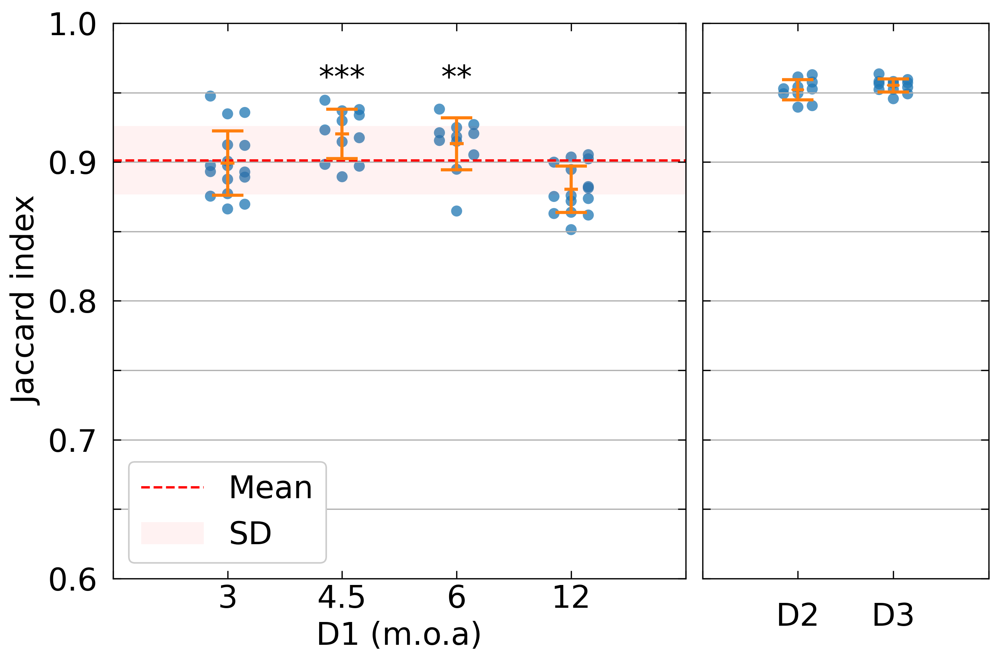

In [13]:

plot_mean_per_subject(jaccard_values_3,jaccard_values_4_5,jaccard_values_6,jaccard_values_12,
                      jaccard_values_d2,jaccard_values_d3,y_under_lim=0.6,stats="full")


# 2. Semi-Auto

## Results

#### 3 months

T2Wmice_first_im_A110123_3mo_.nii
T2Wmice_first_im_A120123_3mo_.nii
T2Wmice_first_im_A130123_3mo_.nii
T2Wmice_first_im_A160123_3mo_.nii
T2Wmice_first_im_A170123_3mo_.nii
T2Wmice_first_im_B110123_3mo_.nii
T2Wmice_first_im_B120123_3mo_.nii
T2Wmice_first_im_B130123_3mo_.nii
T2Wmice_first_im_B160123_3mo_.nii
T2Wmice_first_im_B170123_3mo_.nii
T2Wmice_first_im_C110123_3mo_.nii
T2Wmice_first_im_C120123_3mo_.nii
T2Wmice_first_im_C130123_3mo_.nii
T2Wmice_first_im_C160123_3mo_.nii
T2Wmice_first_im_D120123_3mo_.nii
T2Wmice_first_im_D160123_3mo_.nii
-------------------------------------------------
T2Wmice_first_im_A110123_3mo_.nii
✅ Automatic generation of input boxes completed in 0.0 minutes
✅  [◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼] 100.0%  - extraction completed in 0.13 minutes
	1: 60.19%		1: 93.43%		1: 95.45%	

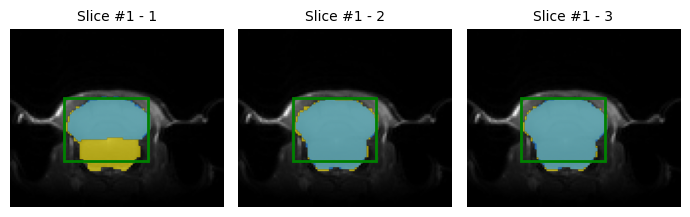

	2: 63.9%		2: 81.99%		2: 95.74%	

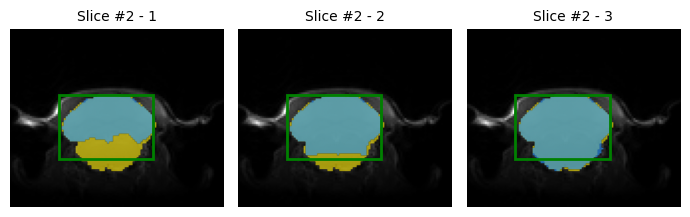

	3: 79.97%		3: 96.29%		3: 94.88%	

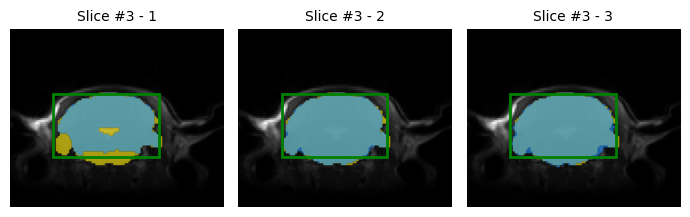

	4: 91.14%		4: 93.23%		4: 91.88%	

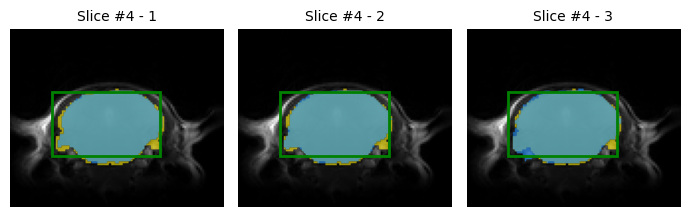

	5: 95.83%		5: 96.43%		5: 95.77%	

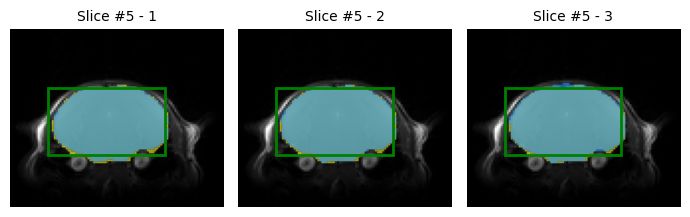

	6: 96.33%		6: 97.23%		6: 95.57%	

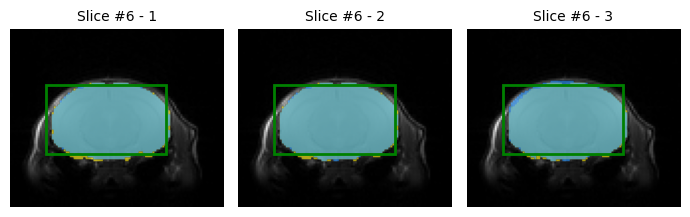

	7: 90.91%		7: 95.28%		7: 95.19%	

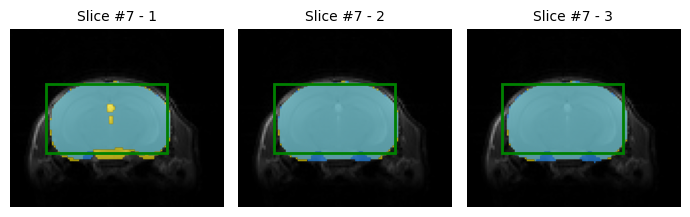

	8: 96.01%		8: 96.11%		8: 95.58%	

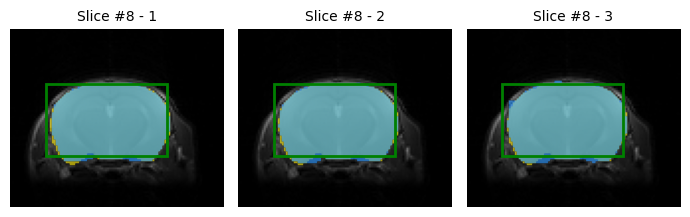

	9: 95.81%		9: 96.7%		9: 96.35%	

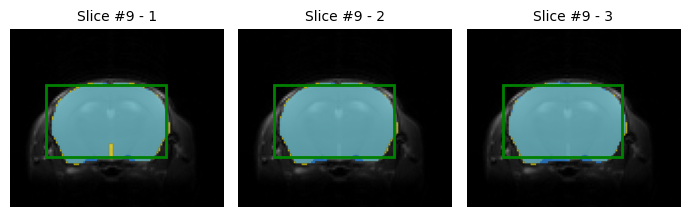

	10: 96.11%		10: 96.33%		10: 96.27%	

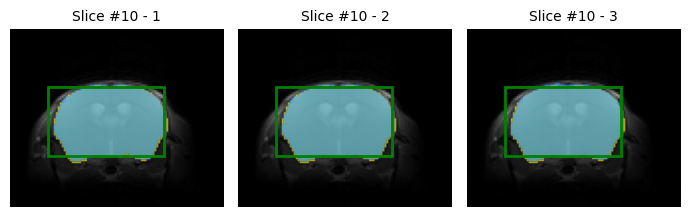

	11: 96.28%		11: 96.59%		11: 96.77%	

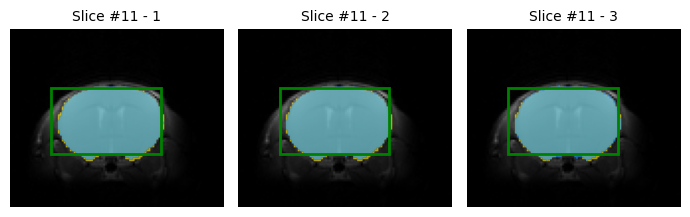

	12: 95.38%		12: 96.8%		12: 97.23%	

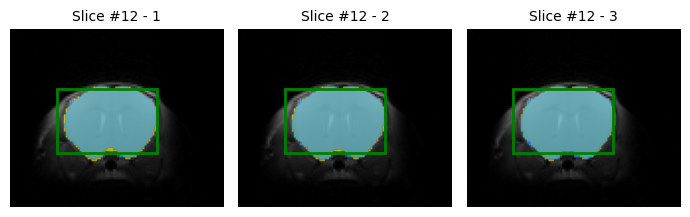

	13: 43.39%		13: 93.01%		13: 95.65%	

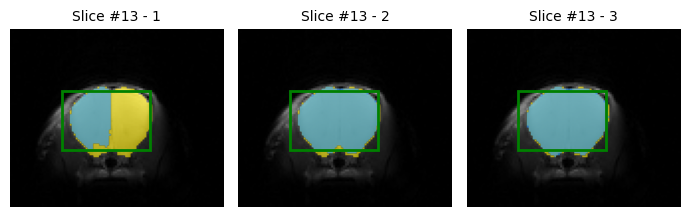

	14: 87.36%		14: 90.66%		14: 87.09%	

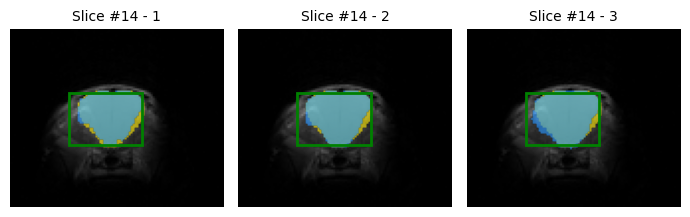

	15: 93.58%		15: 89.38%		15: 84.44%	

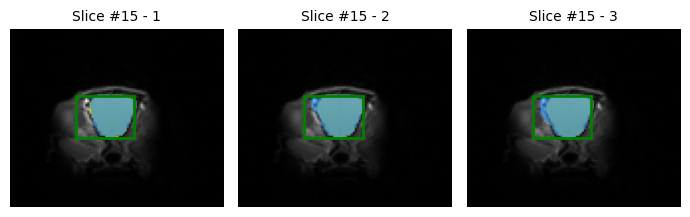

	16: 89.88%		16: 90.35%		16: 90.59%	

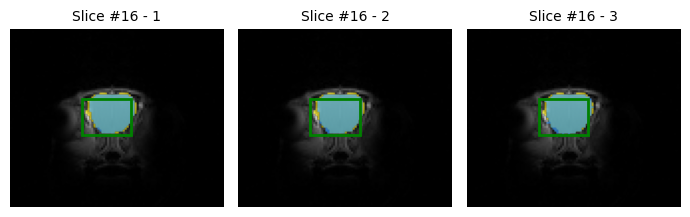

Subject mean performance metrics:
Accuracy:		 91.17%
Jaccard index:		 0.9135
Dice coefficient:	 0.9512


In [14]:
files = []
subjects_path, output_path = subjects_path_3, pjoin(output_path_base,"semi_auto/3_months")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.startswith("T2Wmice_first_im") and file.endswith("nii"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

initial_slice = 4
final_slice   = 33

list_of_sam_mask_lists = []

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    sam_mask_list = create_sam_candidates_list(file, semi_auto=True, reference_mask=True)
    list_of_sam_mask_lists.append(sam_mask_list)
    

In [15]:
best_mask_indexes = find_best_mask_indexes(jaccards_per_slice, len(files[:1]), 16)
best_mask_indexes

[[2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 1, 0, 2]]

-------------------------------------------------
T2Wmice_first_im_A110123_3mo_.nii
Accuracy of slice #1: 95.45%


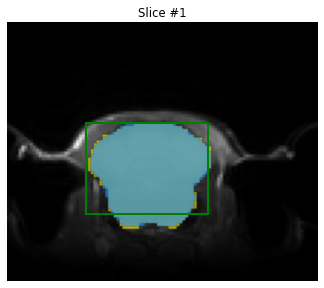

Accuracy of slice #2: 95.74%


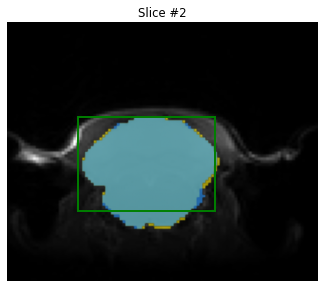

Accuracy of slice #3: 96.29%


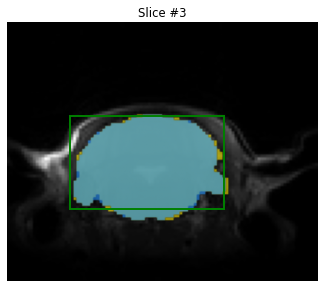

Accuracy of slice #4: 93.23%


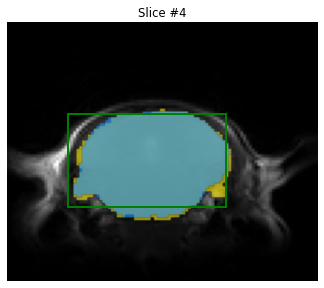

Accuracy of slice #5: 96.43%


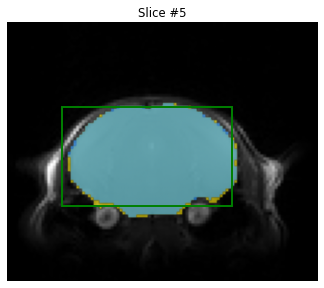

Accuracy of slice #6: 97.23%


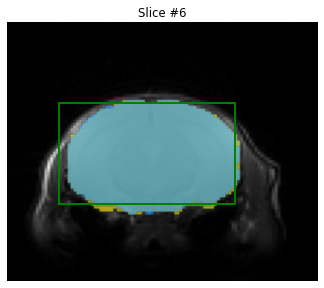

Accuracy of slice #7: 95.28%


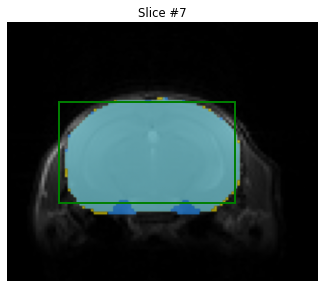

Accuracy of slice #8: 96.11%


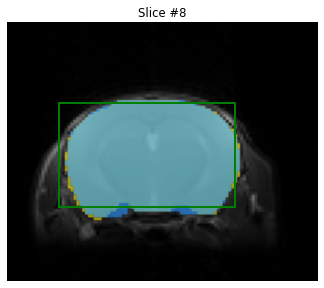

Accuracy of slice #9: 96.7%


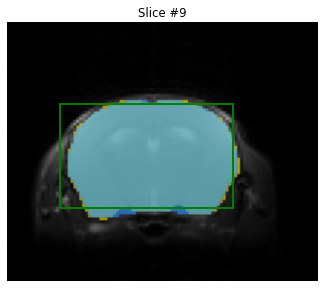

Accuracy of slice #10: 96.33%


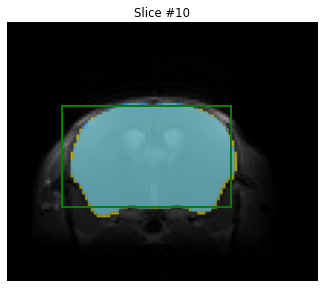

Accuracy of slice #11: 96.77%


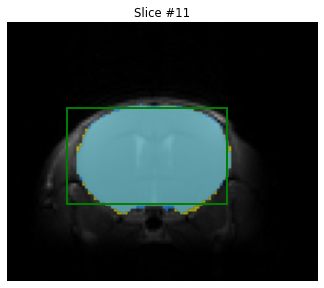

Accuracy of slice #12: 97.23%


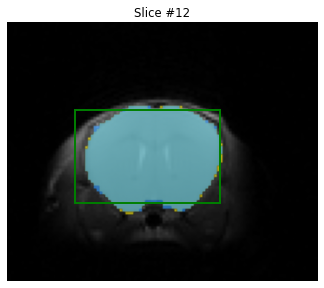

Accuracy of slice #13: 95.65%


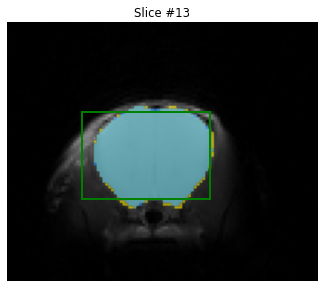

Accuracy of slice #14: 90.66%


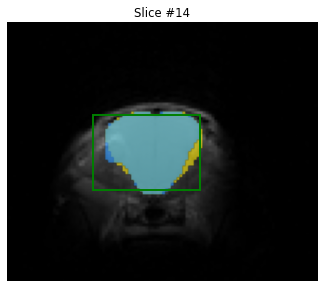

Accuracy of slice #15: 93.58%


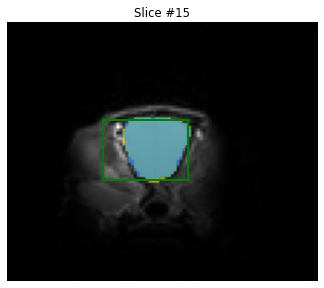

Accuracy of slice #16: 90.59%


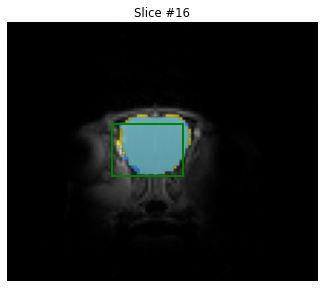

Subject mean performance metrics:
Accuracy:		 95.2%
Jaccard index:		 0.9529
Dice coefficient:	 0.9758
accuracy_values_3 = np.array([95.2])
jaccard_values_3 = np.array([0.9529])
dice_values_3 = np.array([0.9758])
accur_values_3 = np.array([95.45, 95.74, 96.29, 93.23, 96.43, 97.23, 95.28, 96.11, 96.7, 96.33, 96.77, 97.23, 95.65, 90.66, 93.58, 90.59])
jacc_values_3 = np.array([0.9553, 0.9581, 0.9633, 0.933, 0.9645, 0.9725, 0.9544, 0.962, 0.9674, 0.9635, 0.9682, 0.9727, 0.9569, 0.909, 0.9378, 0.9085])
dic_values_3 = np.array([0.9771, 0.9786, 0.9813, 0.9653, 0.9819, 0.986, 0.9767, 0.9806, 0.9835, 0.9814, 0.9839, 0.9862, 0.978, 0.9523, 0.9679, 0.952])


In [16]:
accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    create_sam_masks_nifti(file,list_of_sam_mask_lists[files.index(file)],best_mask_index=best_mask_indexes[files.index(file)])

print(f"accuracy_values_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")


#### 4.5 months

T2Wmice_first_im_A080323_4.5mo_.nii
T2Wmice_first_im_A090323_4.5mo_.nii
T2Wmice_first_im_A100323_4.5mo_.nii
T2Wmice_first_im_A130323_4.5mo_.nii
T2Wmice_first_im_A140323_4.5mo_.nii
T2Wmice_first_im_B090323_4.5mo_.nii
T2Wmice_first_im_B100323_4.5mo_.nii
T2Wmice_first_im_B130323_4.5mo_.nii
T2Wmice_first_im_C080323_4.5mo_.nii
T2Wmice_first_im_C090323_4.5mo_.nii
T2Wmice_first_im_C100323_4.5mo_.nii
-------------------------------------------------
T2Wmice_first_im_A080323_4.5mo_.nii
✅ Automatic generation of input boxes completed in 0.0 minutes
✅  [◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼] 100.0%  - extraction completed in 0.13 minutes
	1: 35.56999999999999%		1: 93.38%		1: 86.5%	

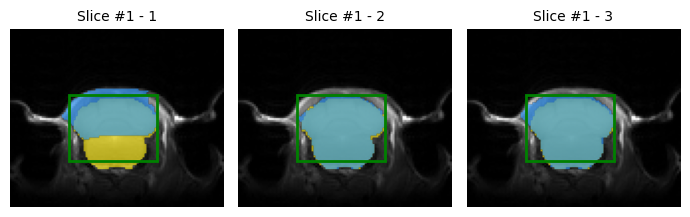

	2: 60.1%		2: 92.61%		2: 95.58%	

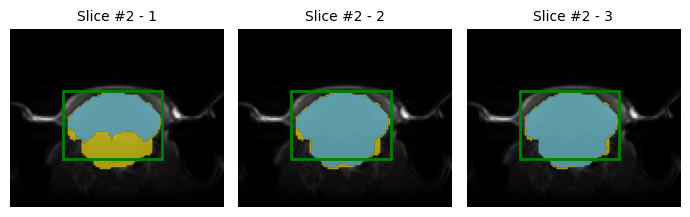

	3: 92.66%		3: 94.16%		3: 95.93%	

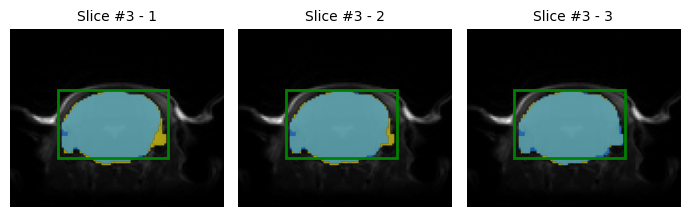

	4: 91.06%		4: 93.11%		4: 93.37%	

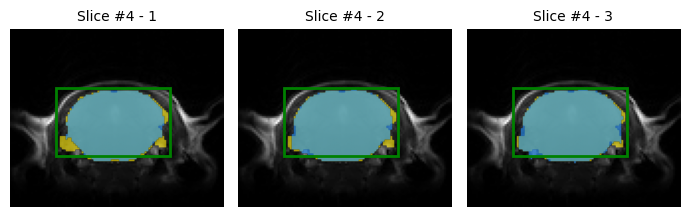

	5: 96.05%		5: 97.1%		5: 96.99%	

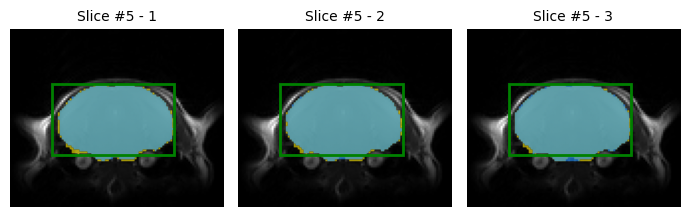

	6: 96.19%		6: 94.87%		6: 91.77%	

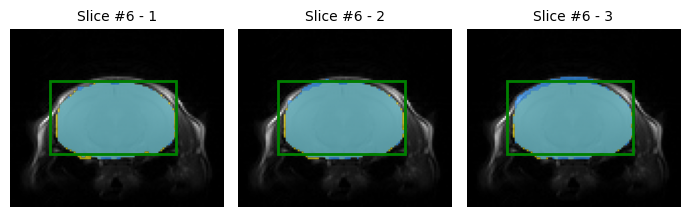

	7: 87.97%		7: 91.96000000000001%		7: 88.71000000000001%	

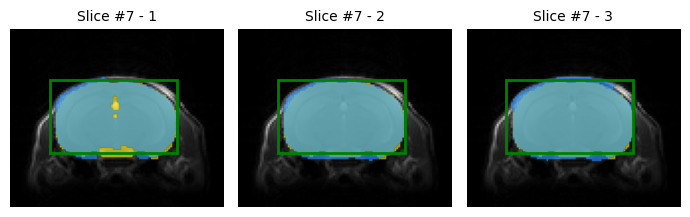

	8: 95.55%		8: 95.87%		8: 91.84%	

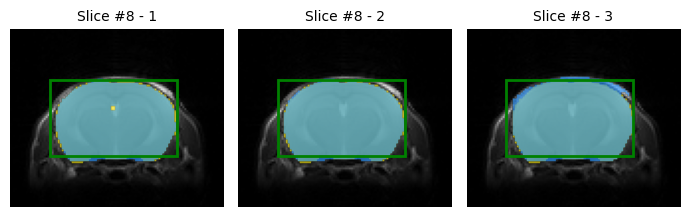

	9: 96.51%		9: 96.66%		9: 95.83%	

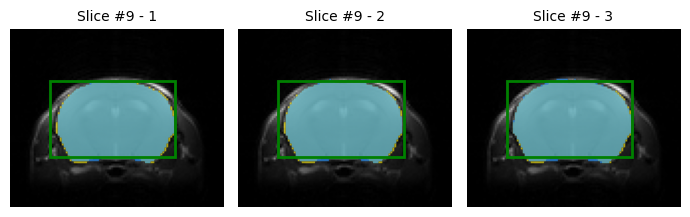

	10: 96.77%		10: 96.66%		10: 96.34%	

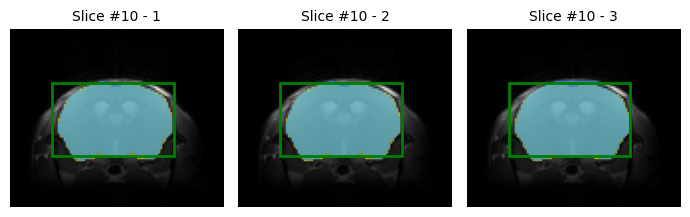

	11: 92.89%		11: 96.65%		11: 93.13%	

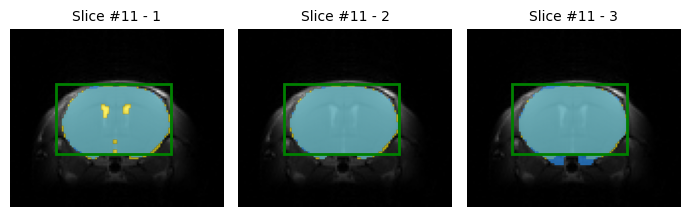

	12: 95.19%		12: 95.53%		12: 95.59%	

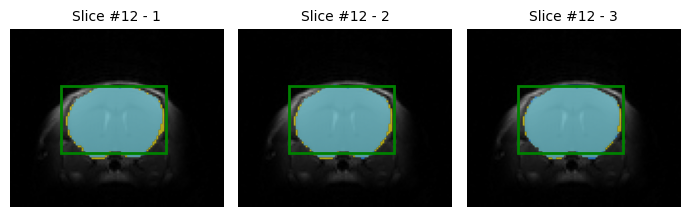

	13: 86.28999999999999%		13: 93.84%		13: 94.99%	

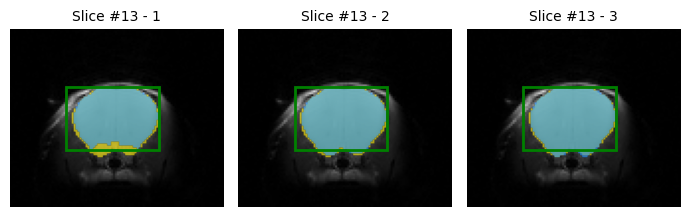

	14: 87.92%		14: 91.67%		14: 88.77%	

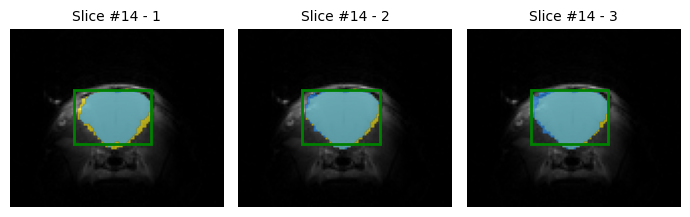

	15: 90.28%		15: 92.22%		15: 88.12%	

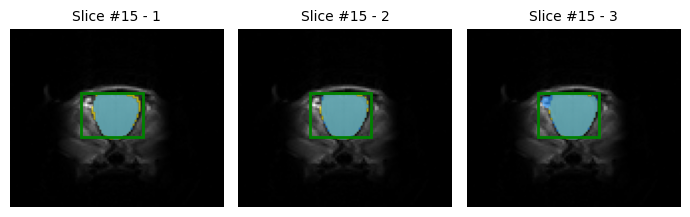

	16: 93.35%		16: 93.6%		16: 94.09%	

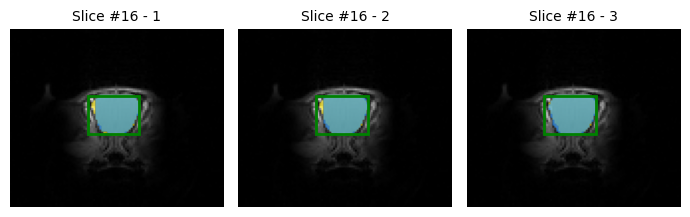

Subject mean performance metrics:
Accuracy:		 91.5%
Jaccard index:		 0.9196
Dice coefficient:	 0.9556


In [17]:
files = []
subjects_path, output_path = subjects_path_4_5, pjoin(output_path_base,"semi_auto/4_5_months")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.startswith("T2Wmice_first_im") and file.endswith("nii"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

initial_slice = 4
final_slice   = 33

list_of_sam_mask_lists = []

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    sam_mask_list = create_sam_candidates_list(file, semi_auto=True, reference_mask=True)
    list_of_sam_mask_lists.append(sam_mask_list)

-------------------------------------------------
T2Wmice_first_im_A080323_4.5mo_.nii
Accuracy of slice #1: 93.38%


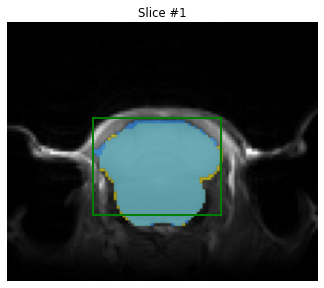

Accuracy of slice #2: 95.58%


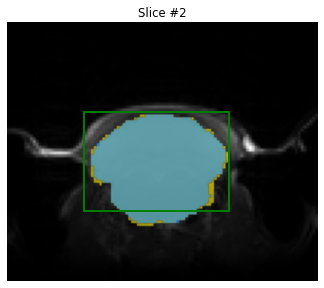

Accuracy of slice #3: 95.93%


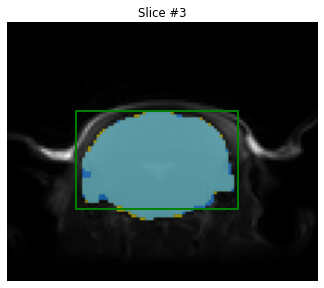

Accuracy of slice #4: 93.37%


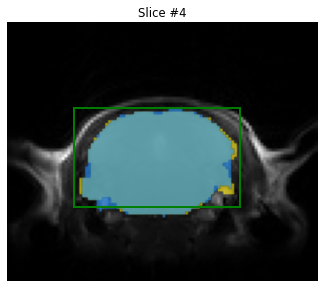

Accuracy of slice #5: 97.1%


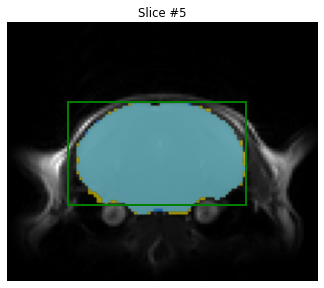

Accuracy of slice #6: 96.19%


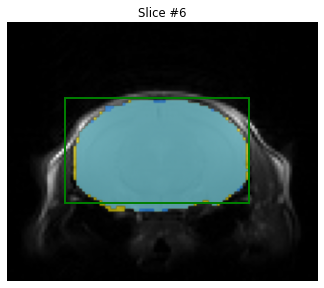

Accuracy of slice #7: 91.96000000000001%


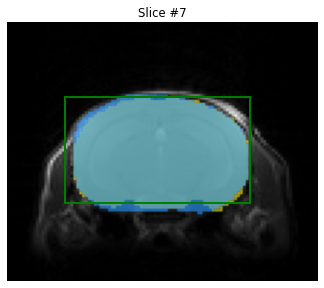

Accuracy of slice #8: 95.87%


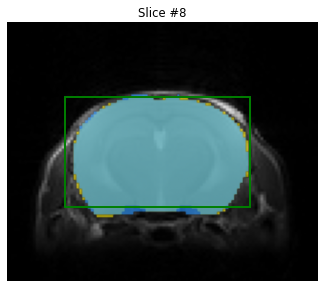

Accuracy of slice #9: 96.66%


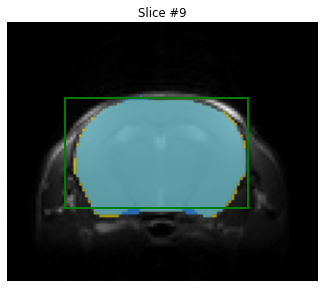

Accuracy of slice #10: 96.77%


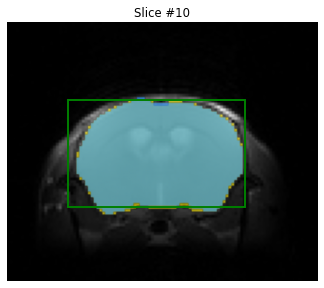

Accuracy of slice #11: 96.65%


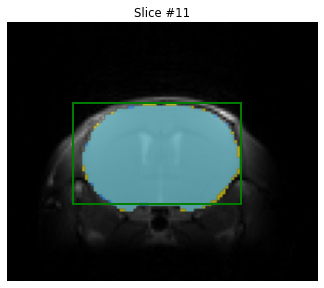

Accuracy of slice #12: 95.59%


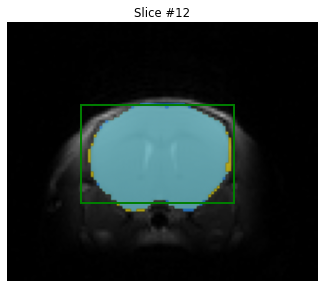

Accuracy of slice #13: 94.99%


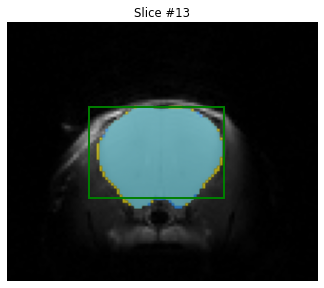

Accuracy of slice #14: 91.67%


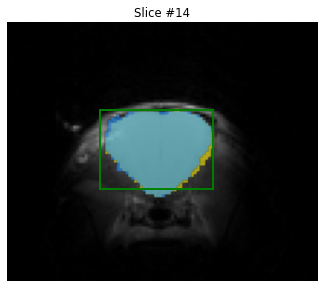

Accuracy of slice #15: 92.22%


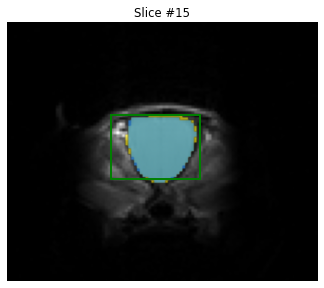

Accuracy of slice #16: 94.09%


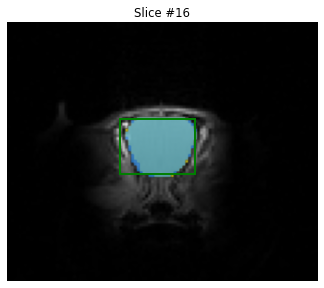

Subject mean performance metrics:
Accuracy:		 94.88%
Jaccard index:		 0.9501
Dice coefficient:	 0.9744
accuracy_values_4_5 = np.array([94.88])
jaccard_values_4_5 = np.array([0.9501])
dice_values_4_5 = np.array([0.9744])
accur_values_4_5 = np.array([93.38, 95.58, 95.93, 93.37, 97.1, 96.19, 91.96000000000001, 95.87, 96.66, 96.77, 96.65, 95.59, 94.99, 91.67, 92.22, 94.09])
jacc_values_4_5 = np.array([0.9362, 0.9559, 0.9602, 0.9362, 0.9711, 0.9623, 0.9249, 0.9597, 0.967, 0.9678, 0.9668, 0.9568, 0.9505, 0.9197, 0.9234, 0.9438])
dic_values_4_5 = np.array([0.9671, 0.9774, 0.9797, 0.967, 0.9853, 0.9808, 0.961, 0.9794, 0.9832, 0.9836, 0.9831, 0.9779, 0.9746, 0.9582, 0.9602, 0.9711])


In [18]:
best_mask_indexes = find_best_mask_indexes(jaccards_per_slice, len(files[:1]), 16)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    create_sam_masks_nifti(file,list_of_sam_mask_lists[files.index(file)],best_mask_index=best_mask_indexes[files.index(file)])

print(f"accuracy_values_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

#### 6 months

T2Wmice_first_im_A250423_6mo_.nii
T2Wmice_first_im_A260423_6mo_.nii
T2Wmice_first_im_A270423_6mo_.nii
T2Wmice_first_im_A280423_6mo_.nii
T2Wmice_first_im_B250423_6mo_.nii
T2Wmice_first_im_B260423_6mo_.nii
T2Wmice_first_im_B270423_6mo_.nii
T2Wmice_first_im_B280423_6mo_.nii
T2Wmice_first_im_C250423_6mo_.nii
T2Wmice_first_im_C260423_6mo_.nii
T2Wmice_first_im_C270423_6mo_.nii
-------------------------------------------------
T2Wmice_first_im_A250423_6mo_.nii
✅ Automatic generation of input boxes completed in 0.0 minutes
✅  [◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼] 100.0%  - extraction completed in 0.13 minutes
	1: 38.75%		1: 92.67%		1: 92.17%	

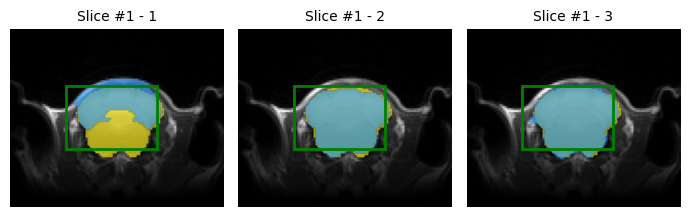

	2: 60.09%		2: 92.52%		2: 93.03%	

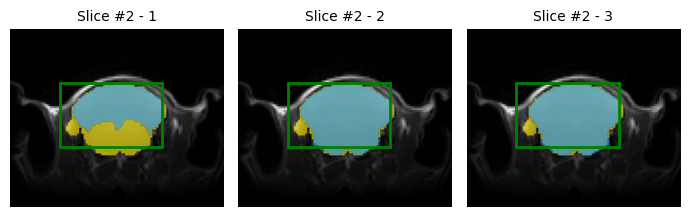

	3: 94.08%		3: 94.96%		3: 93.68%	

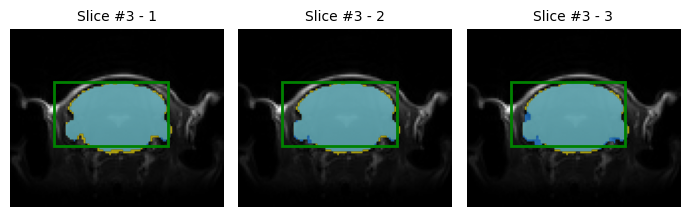

	4: 83.16%		4: 89.95%		4: 83.8%	

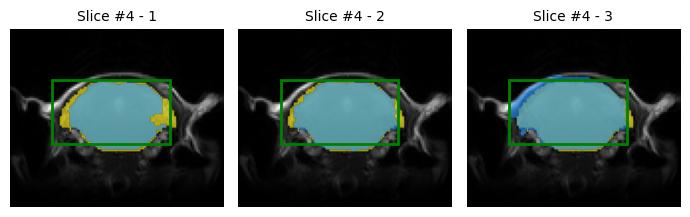

	5: 93.36%		5: 94.32%		5: 93.02%	

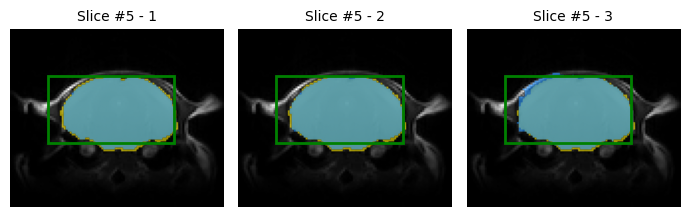

	6: 96.54%		6: 97.13%		6: 87.6%	

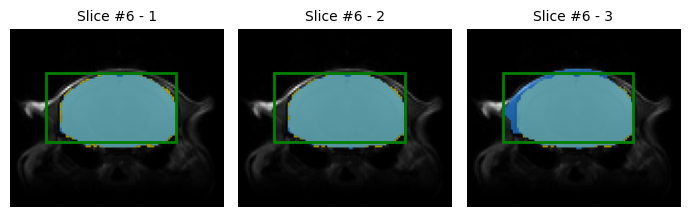

	7: 90.37%		7: 93.09%		7: 91.5%	

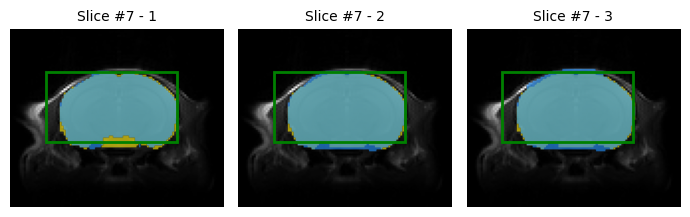

	8: 92.45%		8: 92.7%		8: 90.6%	

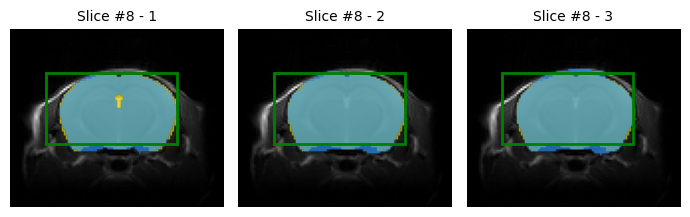

	9: 94.57%		9: 95.29%		9: 94.72%	

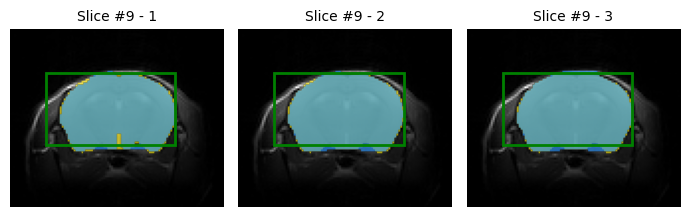

	10: 94.87%		10: 95.72%		10: 94.36%	

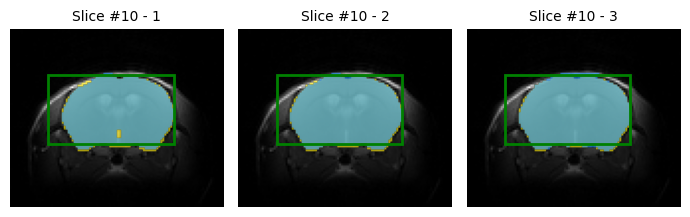

	11: 85.7%		11: 95.55%		11: 93.48%	

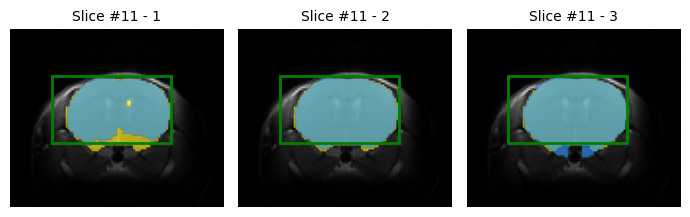

	12: 94.37%		12: 95.26%		12: 95.26%	

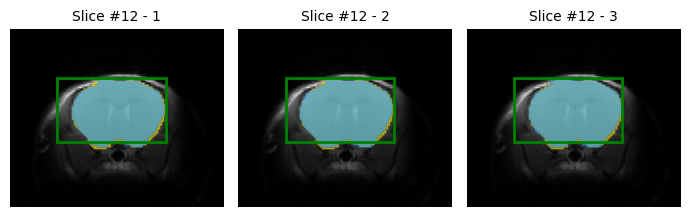

	13: 91.52%		13: 94.04%		13: 95.43%	

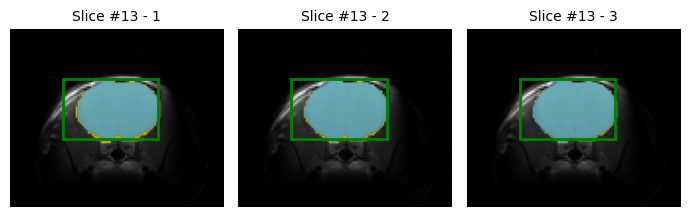

	14: 39.61%		14: 87.63%		14: 75.26%	

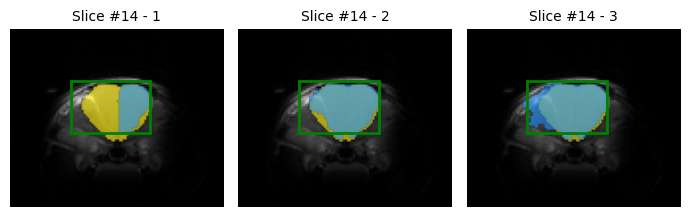

	15: 90.68%		15: 86.01%		15: 77.39%	

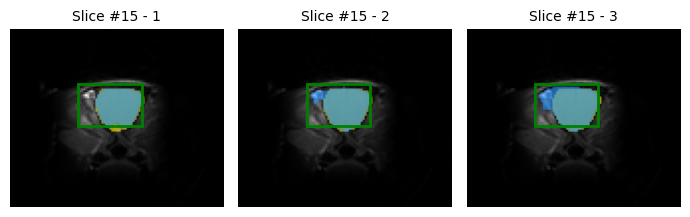

	16: 93.03%		16: 94.28%		16: 95.27%	

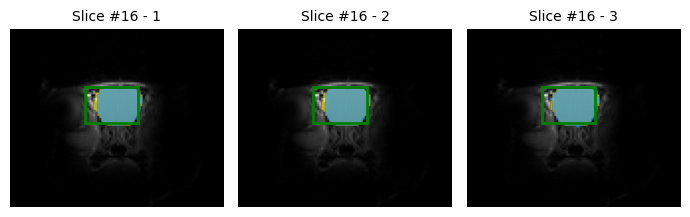

Subject mean performance metrics:
Accuracy:		 88.98%
Jaccard index:		 0.895
Dice coefficient:	 0.9398


In [19]:
files = []
subjects_path, output_path = subjects_path_6, pjoin(output_path_base,"semi_auto/6_months")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.startswith("T2Wmice_first_im") and file.endswith("nii"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

initial_slice = 4
final_slice   = 33

list_of_sam_mask_lists = []

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    sam_mask_list = create_sam_candidates_list(file, semi_auto=True, reference_mask=True)
    list_of_sam_mask_lists.append(sam_mask_list)

-------------------------------------------------
T2Wmice_first_im_A250423_6mo_.nii
Accuracy of slice #1: 92.67%


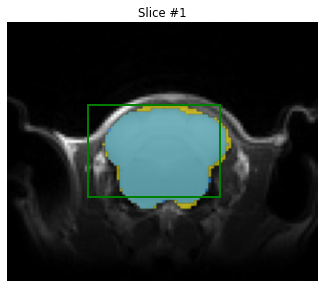

Accuracy of slice #2: 93.03%


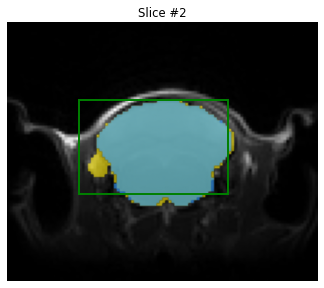

Accuracy of slice #3: 94.96%


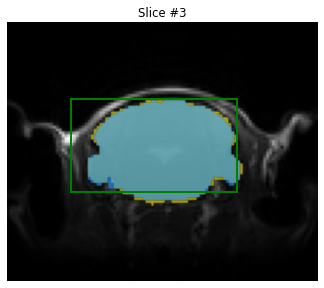

Accuracy of slice #4: 89.95%


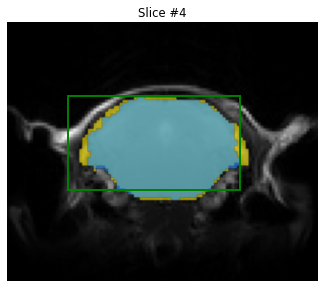

Accuracy of slice #5: 94.32%


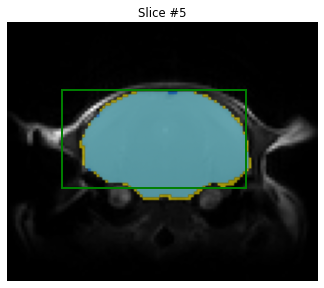

Accuracy of slice #6: 97.13%


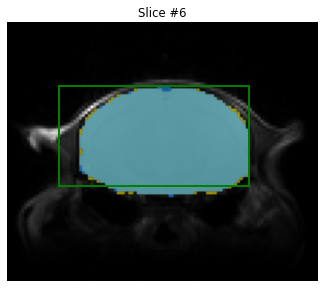

Accuracy of slice #7: 93.09%


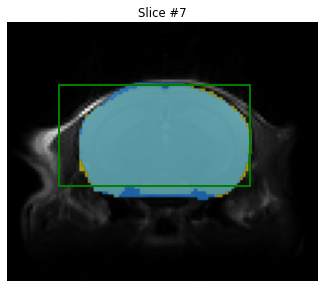

Accuracy of slice #8: 92.7%


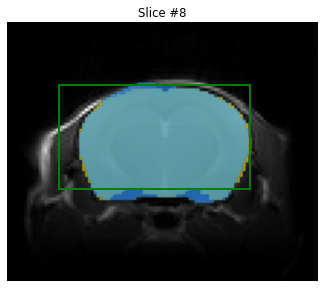

Accuracy of slice #9: 95.29%


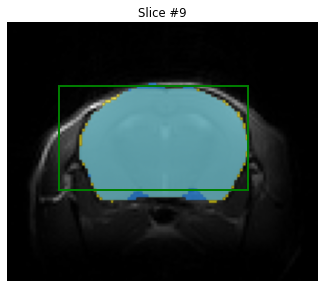

Accuracy of slice #10: 95.72%


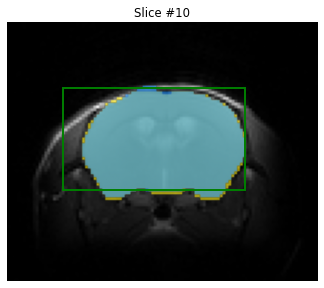

Accuracy of slice #11: 95.55%


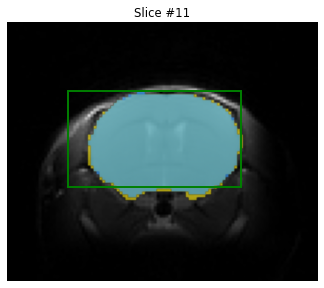

Accuracy of slice #12: 95.26%


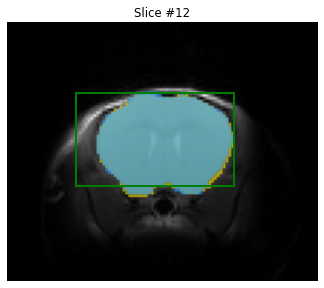

Accuracy of slice #13: 95.43%


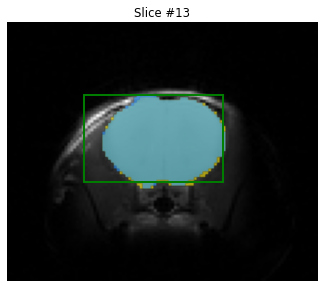

Accuracy of slice #14: 87.63%


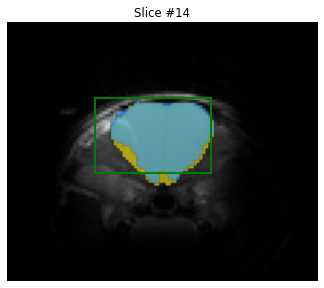

Accuracy of slice #15: 90.68%


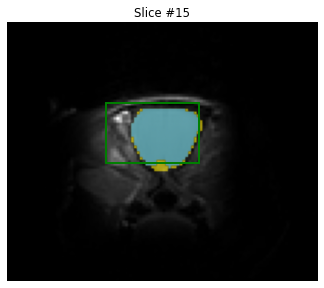

Accuracy of slice #16: 95.27%


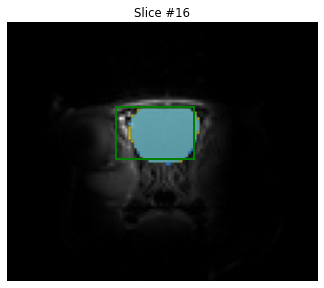

Subject mean performance metrics:
Accuracy:		 93.67%
Jaccard index:		 0.9377
Dice coefficient:	 0.9677
accuracy_values_6 = np.array([93.67])
jaccard_values_6 = np.array([0.9377])
dice_values_6 = np.array([0.9677])
accur_values_6 = np.array([92.67, 93.03, 94.96, 89.95, 94.32, 97.13, 93.09, 92.7, 95.29, 95.72, 95.55, 95.26, 95.43, 87.63, 90.68, 95.27])
jacc_values_6 = np.array([0.927, 0.931, 0.9501, 0.9004, 0.9434, 0.9715, 0.9342, 0.9309, 0.9542, 0.9576, 0.9557, 0.9532, 0.955, 0.8793, 0.9068, 0.9535])
dic_values_6 = np.array([0.9621, 0.9642, 0.9744, 0.9476, 0.9709, 0.9855, 0.966, 0.9642, 0.9765, 0.9783, 0.9773, 0.976, 0.977, 0.9358, 0.9511, 0.9762])


In [20]:
best_mask_indexes = find_best_mask_indexes(jaccards_per_slice, len(files[:1]), 16)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    create_sam_masks_nifti(file,list_of_sam_mask_lists[files.index(file)],best_mask_index=best_mask_indexes[files.index(file)])

print(f"accuracy_values_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

#### 12 months

T2Wmice_first_im_A030222_12mo_.nii
T2Wmice_first_im_A070222_12mo_.nii
T2Wmice_first_im_A080222_12mo_.nii
T2Wmice_first_im_A090222_12mo_.nii
T2Wmice_first_im_A100222_12mo_.nii
T2Wmice_first_im_A250222_12mo_.nii
T2Wmice_first_im_B030222_12mo_.nii
T2Wmice_first_im_B070222_12mo_.nii
T2Wmice_first_im_B080222_12mo_.nii
T2Wmice_first_im_B090222_12mo_.nii
T2Wmice_first_im_B100222_12mo_.nii
T2Wmice_first_im_C070222_12mo_.nii
T2Wmice_first_im_C080222_12mo_.nii
T2Wmice_first_im_C090222_12mo_.nii
T2Wmice_first_im_C100222_12mo_.nii
-------------------------------------------------
T2Wmice_first_im_A030222_12mo_.nii
✅ Automatic generation of input boxes completed in 0.0 minutes
✅  [◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼] 100.0%  - extraction completed in 0.13 minutes
	1: 74.03999999999999%		1: 70.9%		1: 78.53999999999999%	

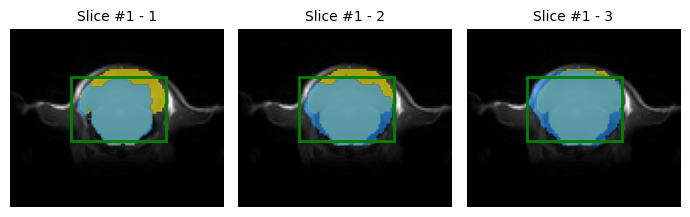

	2: 92.63%		2: 88.9%		2: 84.55%	

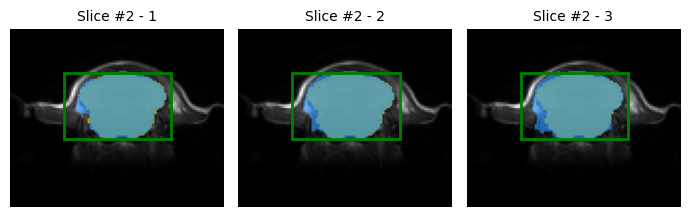

	3: 90.12%		3: 87.35%		3: 79.43%	

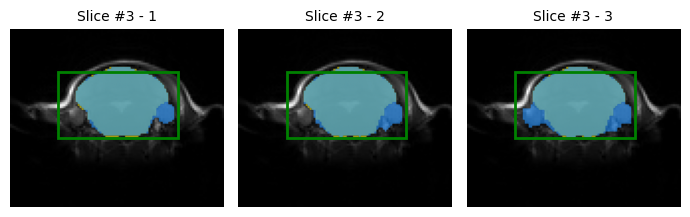

	4: 87.97%		4: 83.15%		4: 77.1%	

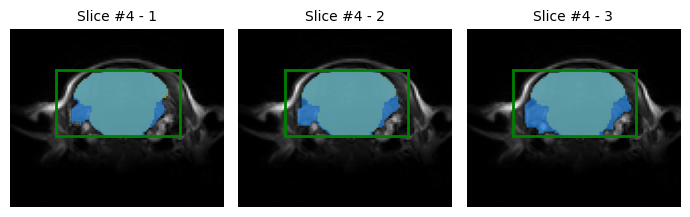

	5: 95.67%		5: 96.69%		5: 96.24%	

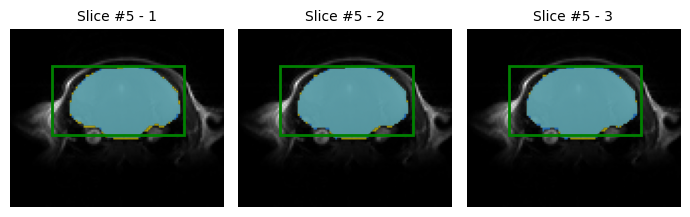

	6: 96.68%		6: 95.28%		6: 94.09%	

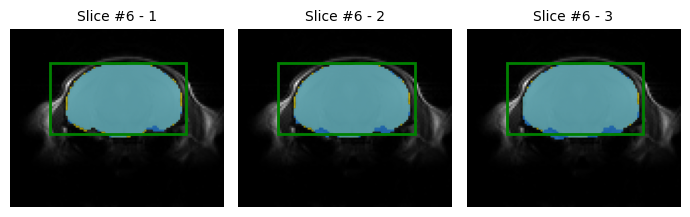

	7: 94.14%		7: 93.42%		7: 91.68%	

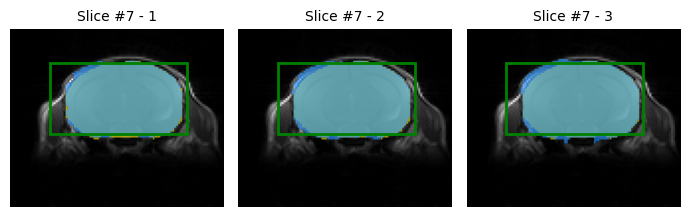

	8: 95.68%		8: 94.44%		8: 91.71000000000001%	

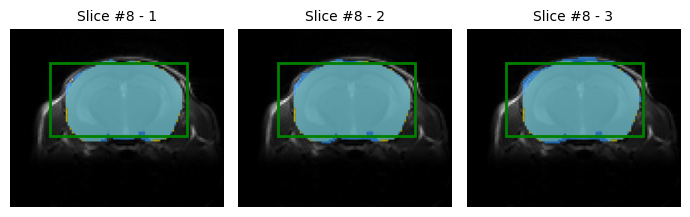

	9: 95.77%		9: 96.48%		9: 93.73%	

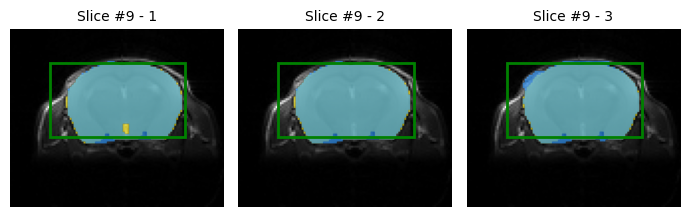

	10: 96.73%		10: 97.1%		10: 97.32%	

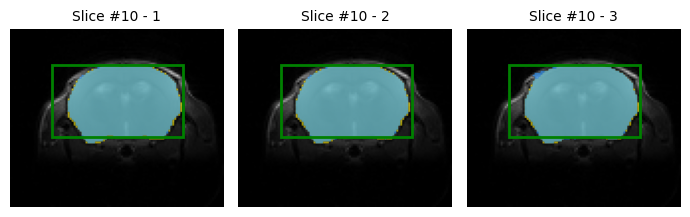

	11: 90.61%		11: 92.97%		11: 91.73%	

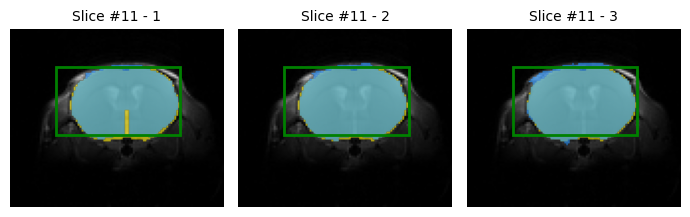

	12: 94.85%		12: 95.19%		12: 89.76%	

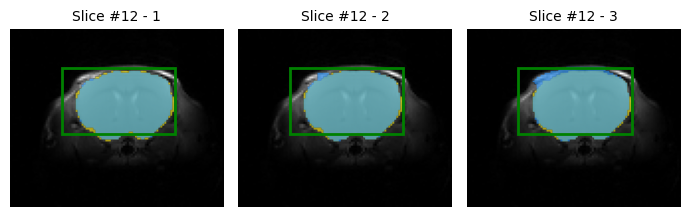

	13: 91.87%		13: 95.07%		13: 95.42%	

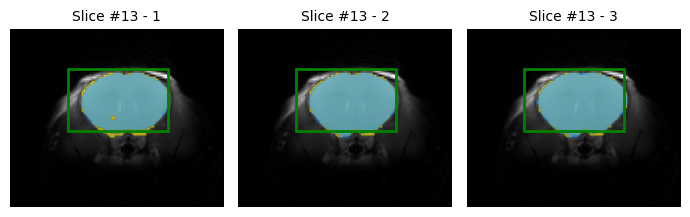

	14: 80.18%		14: 84.99%		14: 65.96000000000001%	

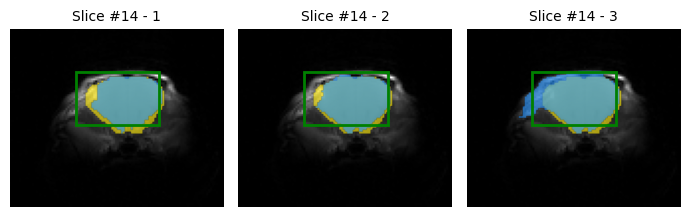

	15: 84.44%		15: 80.08%		15: 71.53999999999999%	

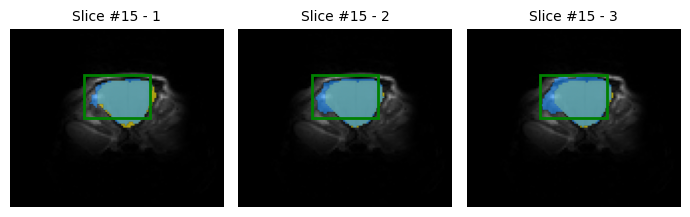

	16: -39.16%		16: 90.86%		16: 66.58%	

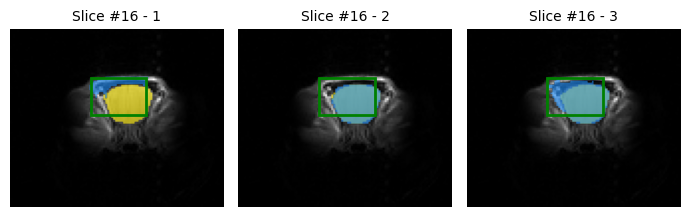

Subject mean performance metrics:
Accuracy:		 86.05%
Jaccard index:		 0.8804
Dice coefficient:	 0.9259


In [21]:
files = []
subjects_path, output_path = subjects_path_12, pjoin(output_path_base,"semi_auto/12_months")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.startswith("T2Wmice_first_im") and file.endswith("nii"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

initial_slice = 4
final_slice   = 33

list_of_sam_mask_lists = []

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    sam_mask_list = create_sam_candidates_list(file, semi_auto=True, reference_mask=True)
    list_of_sam_mask_lists.append(sam_mask_list)

-------------------------------------------------
T2Wmice_first_im_A030222_12mo_.nii
Accuracy of slice #1: 78.53999999999999%


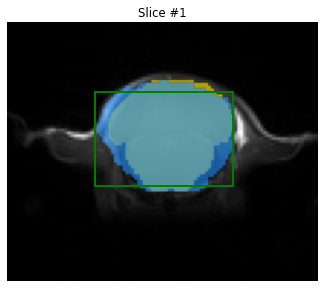

Accuracy of slice #2: 92.63%


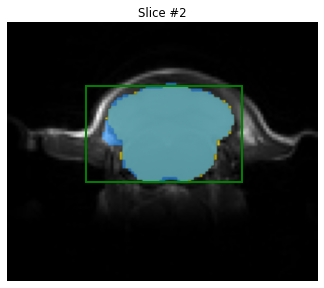

Accuracy of slice #3: 90.12%


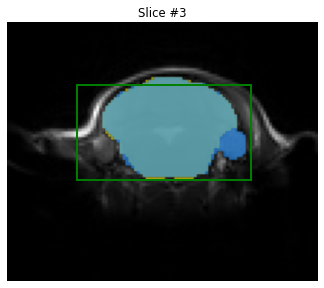

Accuracy of slice #4: 87.97%


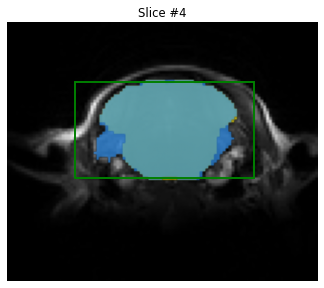

Accuracy of slice #5: 96.69%


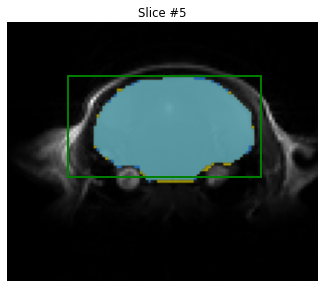

Accuracy of slice #6: 96.68%


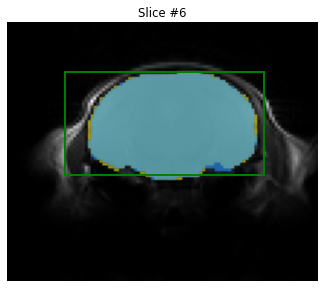

Accuracy of slice #7: 94.14%


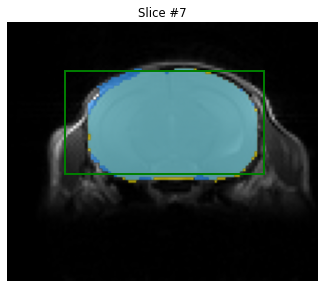

Accuracy of slice #8: 95.68%


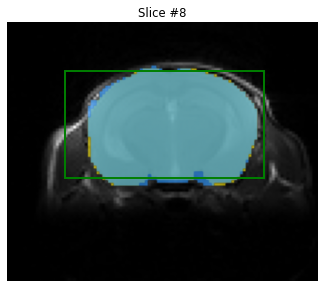

Accuracy of slice #9: 96.48%


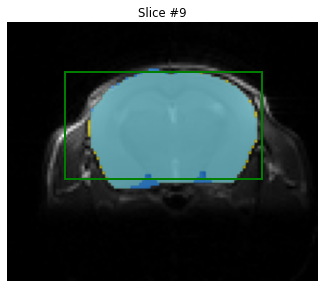

Accuracy of slice #10: 97.32%


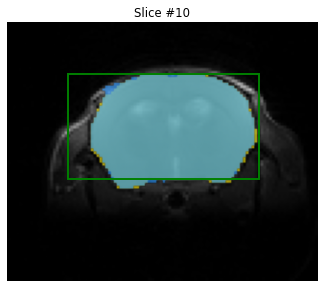

Accuracy of slice #11: 92.97%


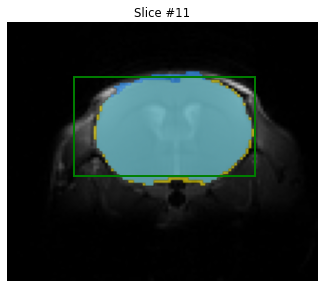

Accuracy of slice #12: 95.19%


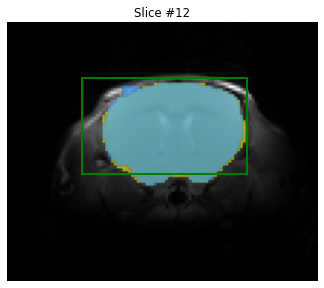

Accuracy of slice #13: 95.42%


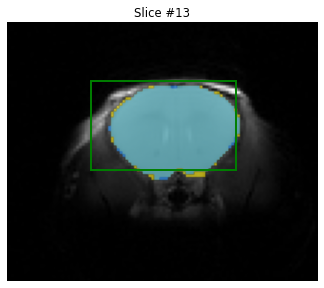

Accuracy of slice #14: 84.99%


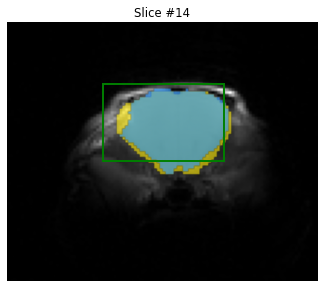

Accuracy of slice #15: 84.44%


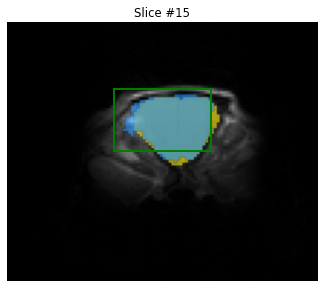

Accuracy of slice #16: 90.86%


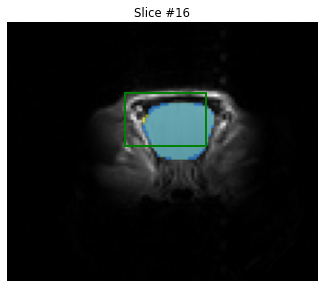

Subject mean performance metrics:
Accuracy:		 91.88%
Jaccard index:		 0.9244
Dice coefficient:	 0.9601
accuracy_values_12 = np.array([91.88])
jaccard_values_12 = np.array([0.9244])
dice_values_12 = np.array([0.9601])
accur_values_12 = np.array([78.53999999999999, 92.63, 90.12, 87.97, 96.69, 96.68, 94.14, 95.68, 96.48, 97.32, 92.97, 95.19, 95.42, 84.99, 84.44, 90.86])
jacc_values_12 = np.array([0.8197, 0.9305, 0.9087, 0.892, 0.9673, 0.9672, 0.9437, 0.9581, 0.9657, 0.9735, 0.932, 0.9527, 0.9547, 0.8523, 0.8564, 0.9157])
dic_values_12 = np.array([0.9009, 0.964, 0.9522, 0.9429, 0.9834, 0.9833, 0.971, 0.9786, 0.9825, 0.9866, 0.9648, 0.9758, 0.9768, 0.9202, 0.9226, 0.956])


In [22]:
best_mask_indexes = find_best_mask_indexes(jaccards_per_slice, len(files[:1]), 16)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    create_sam_masks_nifti(file,list_of_sam_mask_lists[files.index(file)],best_mask_index=best_mask_indexes[files.index(file)])

print(f"accuracy_values_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

#### D2

5463_t2.nii_flip.nii.gz
5471_t2.nii_flip.nii.gz
5472_t2.nii_flip.nii.gz
6085_t2.nii_flip.nii.gz
6087_t2.nii_flip.nii.gz
6088_t2.nii_flip.nii.gz
6092_t2.nii_flip.nii.gz
6093_t2.nii_flip.nii.gz
6287_t2.nii_flip.nii.gz
6289_t2.nii_flip.nii.gz
-------------------------------------------------
5463_t2.nii_flip.nii.gz
✅ Automatic generation of input boxes completed in 0.0 minutes
✅  [◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼] 100.0%  - extraction completed in 0.18 minutes
	1: 56.6%		1: 39.86%		1: 32.78%	

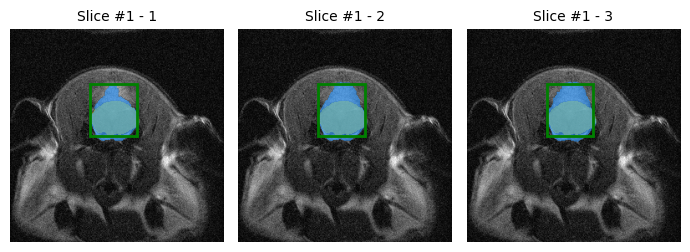

	2: 62.59%		2: 92.31%		2: 91.57%	

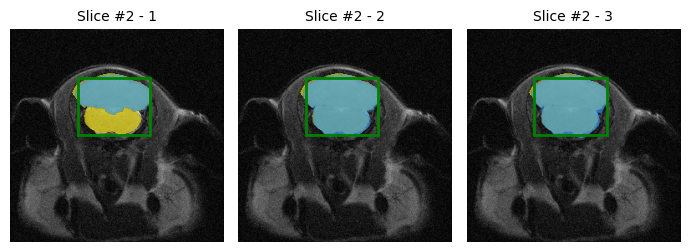

	3: 61.45%		3: 97.32%		3: 89.57%	

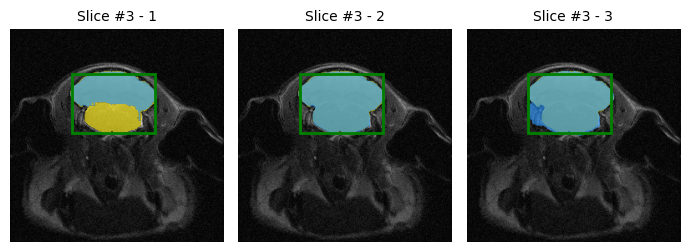

	4: 85.31%		4: 89.86%		4: 93.21%	

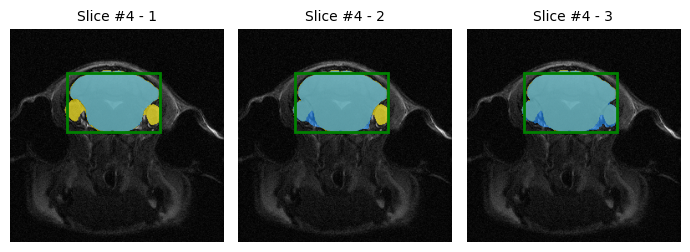

	5: 86.95%		5: 88.21000000000001%		5: 90.39%	

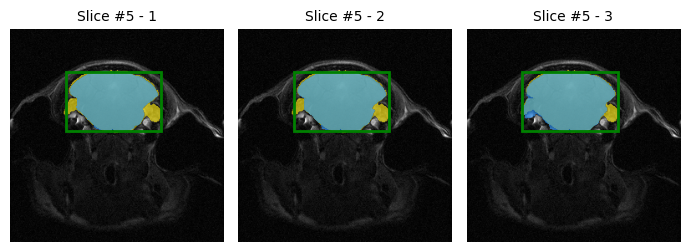

	6: 94.05%		6: 95.87%		6: 96.54%	

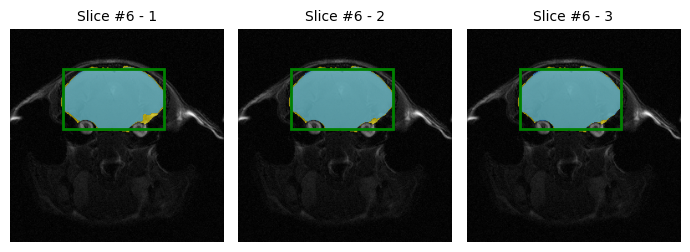

	7: 97.06%		7: 97.67%		7: 98.19%	

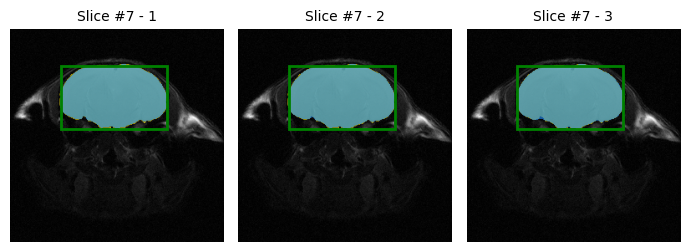

	8: 77.75%		8: 96.79%		8: 97.45%	

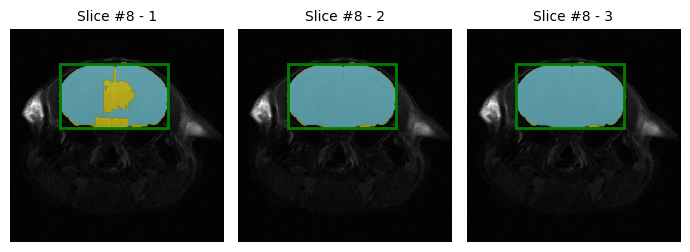

	9: 95.49%		9: 97.6%		9: 98.03%	

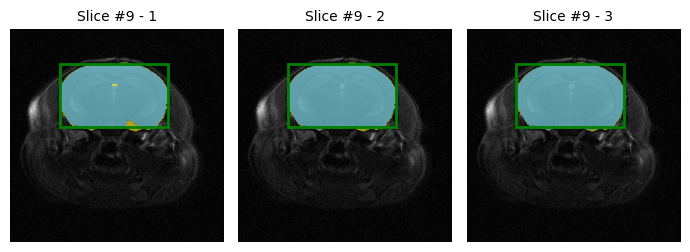

	10: 95.12%		10: 97.77%		10: 98.4%	

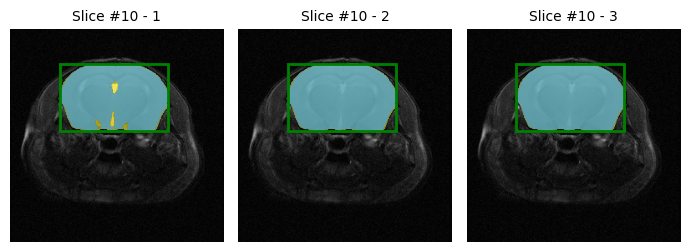

	11: 95.22%		11: 96.65%		11: 97.31%	

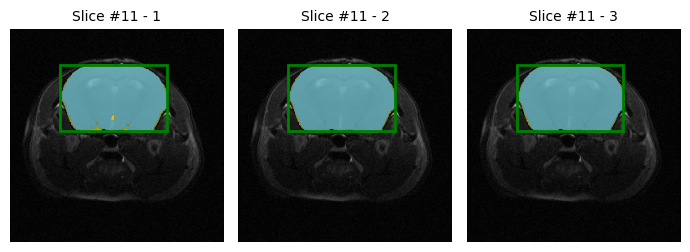

	12: 60.62%		12: 95.29%		12: 95.61%	

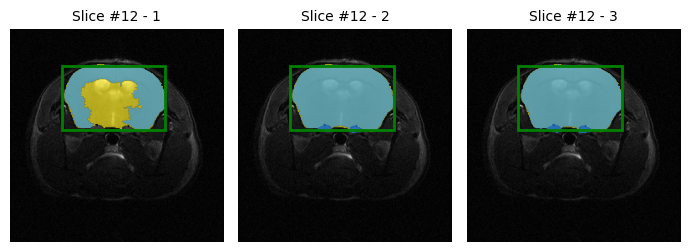

	13: 94.43%		13: 96.62%		13: 95.91%	

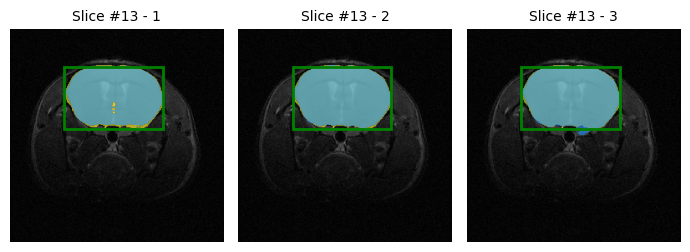

	14: 97.74%		14: 98.09%		14: 97.45%	

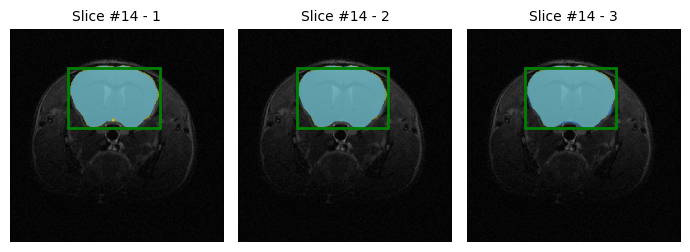

	15: 94.24%		15: 94.95%		15: 94.34%	

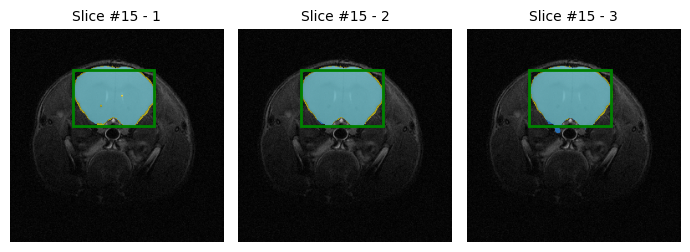

	16: 91.14%		16: 92.89%		16: 93.37%	

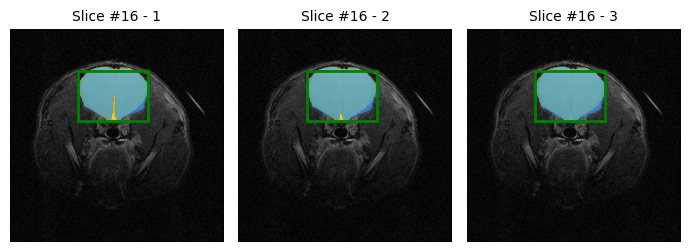

	17: 51.65%		17: 95.83%		17: 96.32%	

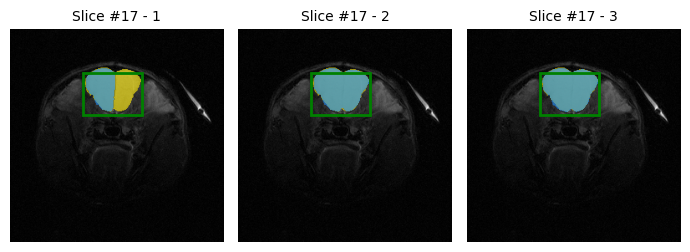

	18: 92.77%		18: 94.24%		18: 95.98%	

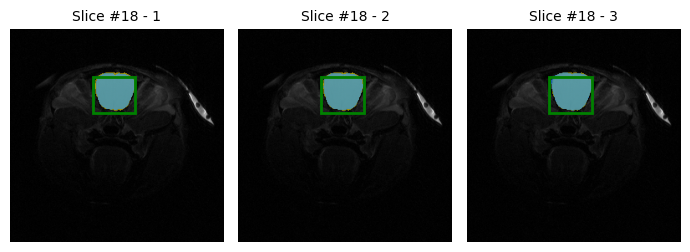

	19: 93.1%		19: 94.61%		19: 95.64%	

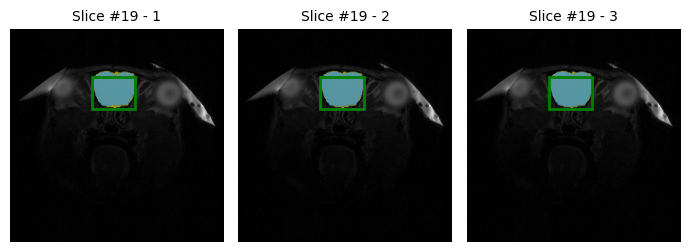

	20: 90.61%		20: 92.62%		20: 94.5%	

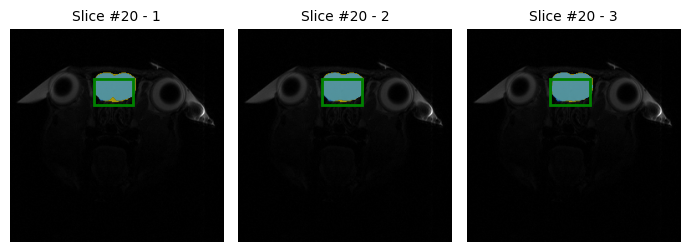

	21: 39.01%		21: 32.91%		21: 44.96%	

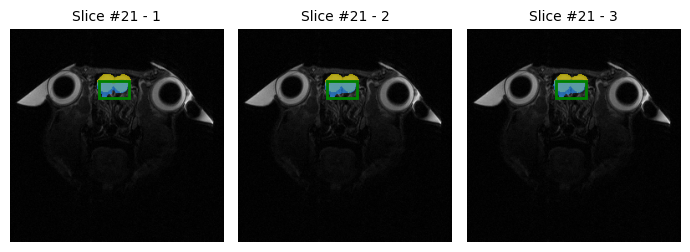

	22: 0%		22: 0%		22: 0%	

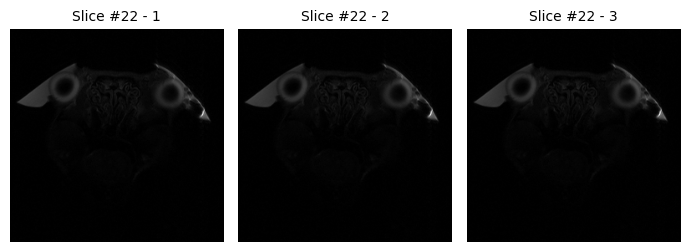

Subject mean performance metrics:
Accuracy:		 83.01%
Jaccard index:		 0.8452
Dice coefficient:	 0.8899


In [23]:
files = []
subjects_path, output_path = subjects_path_d2, pjoin(output_path_base,"semi_auto/d2")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.endswith("flip.nii.gz"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

initial_slice = 2
final_slice   = 39

list_of_sam_mask_lists = []

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    sam_mask_list = create_sam_candidates_list(file, semi_auto=True, other_lab=True, reference_mask=True)
    list_of_sam_mask_lists.append(sam_mask_list)

-------------------------------------------------
5463_t2.nii_flip.nii.gz


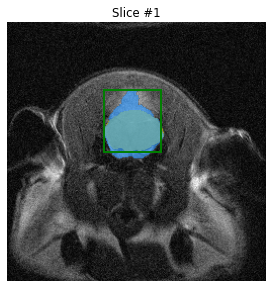

Accuracy of slice #2: 92.31%


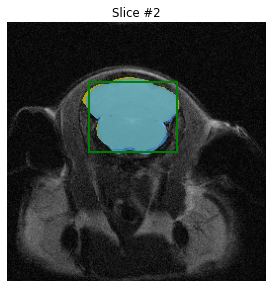

Accuracy of slice #3: 97.32%


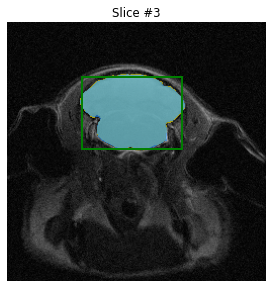

Accuracy of slice #4: 93.21%


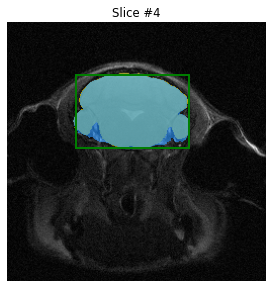

Accuracy of slice #5: 90.39%


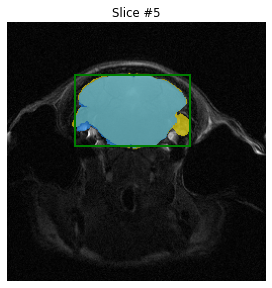

Accuracy of slice #6: 96.54%


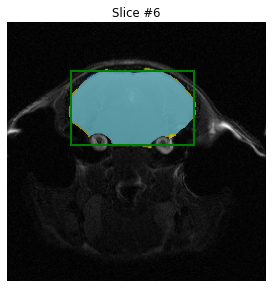

Accuracy of slice #7: 98.19%


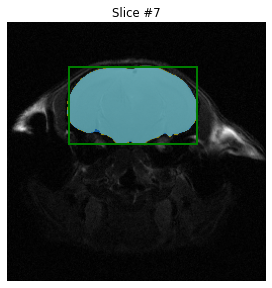

Accuracy of slice #8: 97.45%


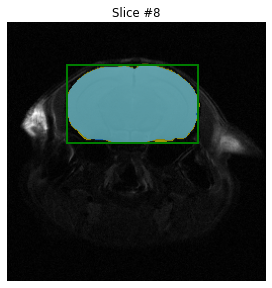

Accuracy of slice #9: 98.03%


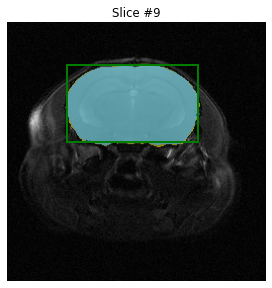

Accuracy of slice #10: 98.4%


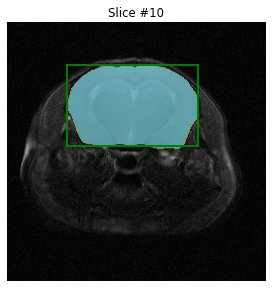

Accuracy of slice #11: 97.31%


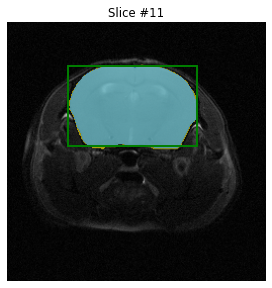

Accuracy of slice #12: 95.61%


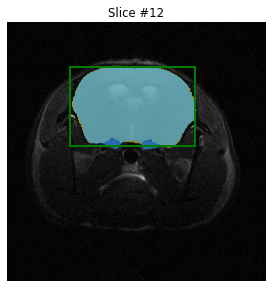

Accuracy of slice #13: 96.62%


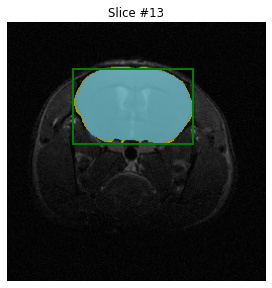

Accuracy of slice #14: 98.09%


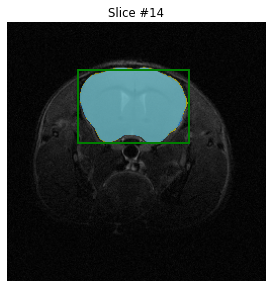

Accuracy of slice #15: 94.95%


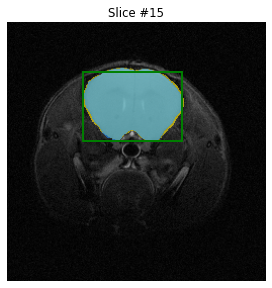

Accuracy of slice #16: 93.37%


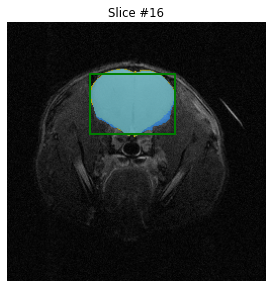

Accuracy of slice #17: 96.32%


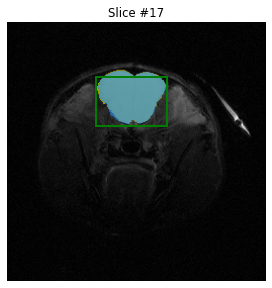

Accuracy of slice #18: 95.98%


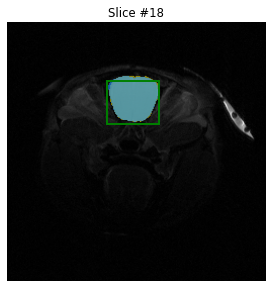

Accuracy of slice #19: 95.64%


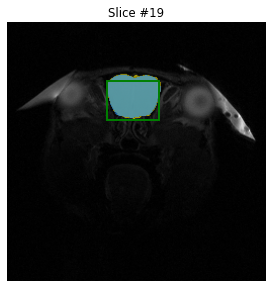

Accuracy of slice #20: 94.5%


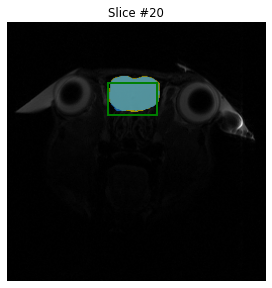

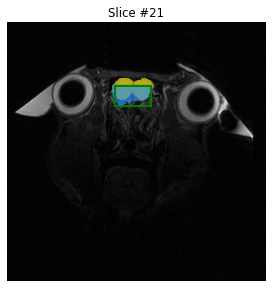

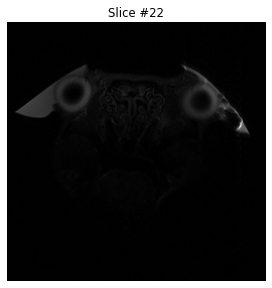

Subject mean performance metrics:
Accuracy:		 95.8%
Jaccard index:		 0.9589
Dice coefficient:	 0.9789
accuracy_values_d2 = np.array([95.8])
jaccard_values_d2 = np.array([0.9589])
dice_values_d2 = np.array([0.9789])
accur_values_d2 = np.array([92.31, 97.32, 93.21, 90.39, 96.54, 98.19, 97.45, 98.03, 98.4, 97.31, 95.61, 96.62, 98.09, 94.95, 93.37, 96.32, 95.98, 95.64, 94.5])
jacc_values_d2 = np.array([0.9265, 0.9734, 0.9358, 0.9063, 0.9655, 0.982, 0.9745, 0.9804, 0.984, 0.9731, 0.9574, 0.9663, 0.9809, 0.9497, 0.9365, 0.9638, 0.9603, 0.9566, 0.9455])
dic_values_d2 = np.array([0.9618, 0.9865, 0.9669, 0.9508, 0.9825, 0.9909, 0.9871, 0.9901, 0.9919, 0.9864, 0.9782, 0.9828, 0.9904, 0.9742, 0.9672, 0.9816, 0.9797, 0.9778, 0.972])


In [24]:
best_mask_indexes = find_best_mask_indexes(jaccards_per_slice, len(files[:1]), 22)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    create_sam_masks_nifti(file,list_of_sam_mask_lists[files.index(file)],best_mask_index=best_mask_indexes[files.index(file)],other_lab=True)

print(f"accuracy_values_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

#### D3

20190227_105648_AE0818_rs_Control_11_1_1_T2w.nii_flip.nii.gz
20190227_120644_AE0818_rs_Control_12_1_1_T2w.nii_flip.nii.gz
20190227_125730_AE0818_rs_Control_13_1_1_T2w.nii_flip.nii.gz
20190228_081325_AE0818_rs_Control_14_1_1_T2w.nii_flip.nii.gz
20190228_093749_AE0818_rs_Control_21_1_1_T2w.nii_flip.nii.gz
20190228_103014_AE0818_rs_Control_15_1_1_T2w.nii_flip.nii.gz
20190311_083410_AE0818_rs_Control_11_1_2_T2w.nii_flip.nii.gz
20190311_095840_AE0818_rs_Control_12_1_2_T2w.nii_flip.nii.gz
20190311_105918_AE0818_rs_Control_13_1_2_T2w.nii_flip.nii.gz
20190311_115813_AE0818_rs_Control_14_1_2_T2w.nii_flip.nii.gz
20190311_125036_AE0818_rs_Control_15_1_2_T2w.nii_flip.nii.gz
20190311_143920_AE0818_rs_Control_21_1_2_T2w.nii_flip.nii.gz
-------------------------------------------------
20190227_105648_AE0818_rs_Control_11_1_1_T2w.nii_flip.nii.gz
✅ Automatic generation of input boxes completed in 0.0 minutes
✅  [◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼] 100.0%  - extraction completed in 0.39 minutes
	1: 0%		1: 0%		1: 0%	

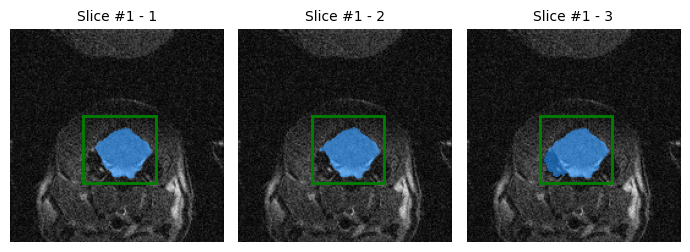

	2: 0%		2: 0%		2: 0%	

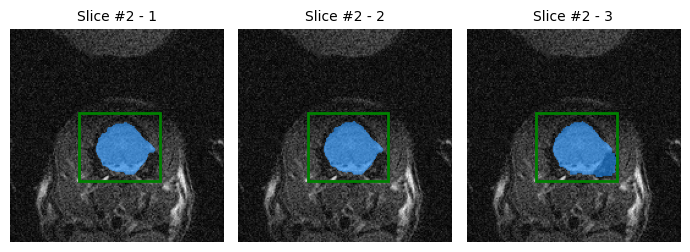

	3: 96.12%		3: 91.64%		3: 83.34%	

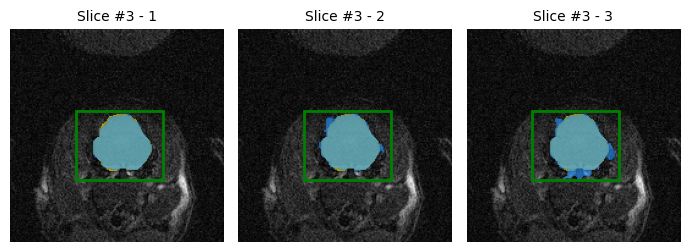

	4: 95.84%		4: 95.7%		4: 90.75%	

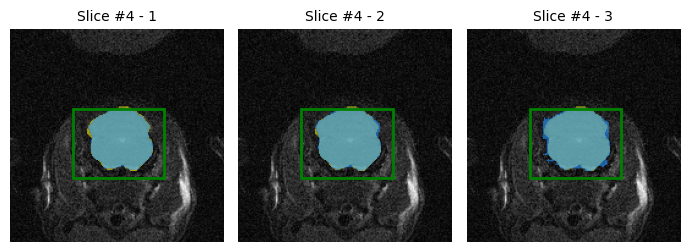

	5: 95.89%		5: 96.73%		5: 96.04%	

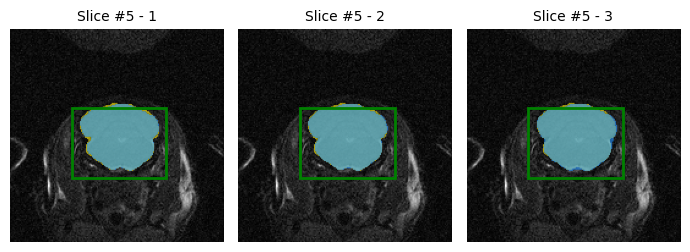

	6: 95.2%		6: 96.9%		6: 93.74%	

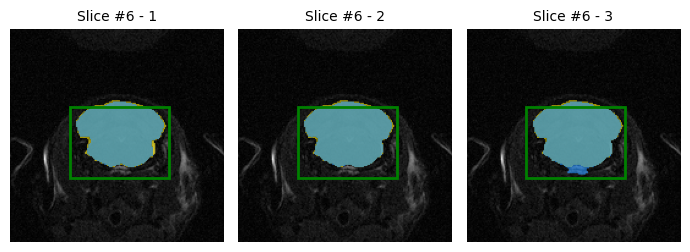

	7: 91.96000000000001%		7: 92.33%		7: 92.2%	

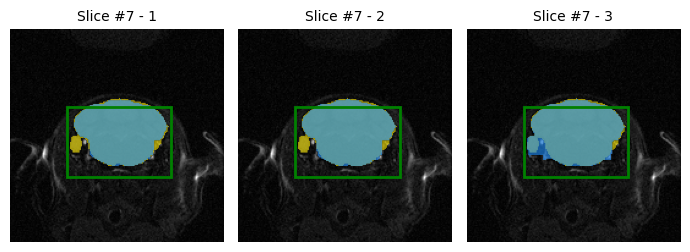

	8: 86.85%		8: 93.05%		8: 90.03%	

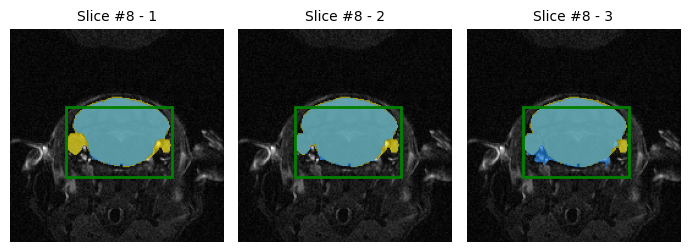

	9: 88.51%		9: 90.41%		9: 95.74%	

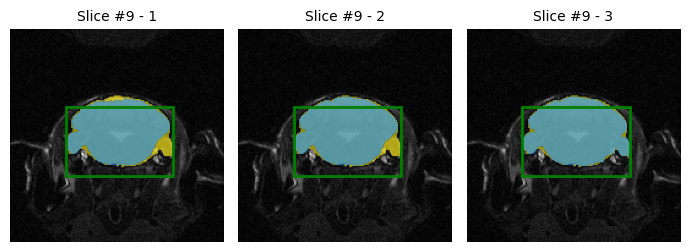

	10: 93.25%		10: 94.99%		10: 93.09%	

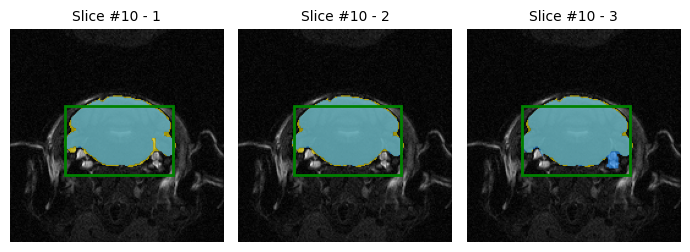

	11: 92.26%		11: 92.36%		11: 83.18%	

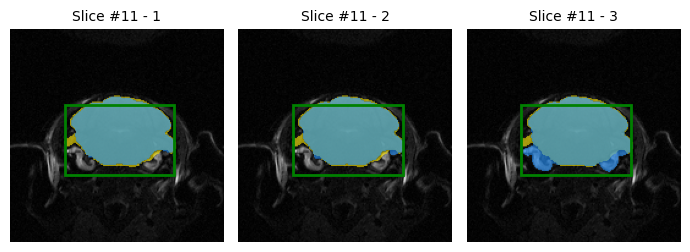

	12: 88.19%		12: 90.3%		12: 73.94%	

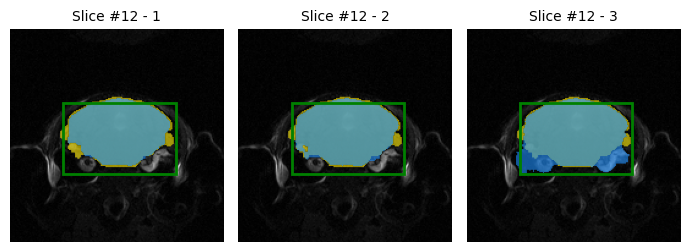

	13: 94.14%		13: 95.48%		13: 71.88%	

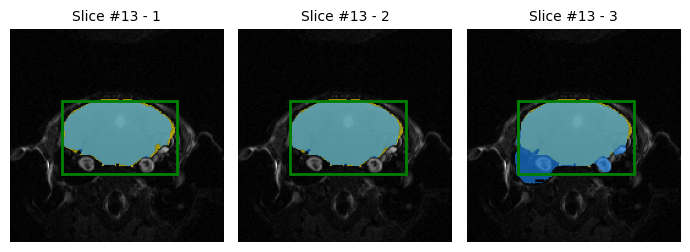

	14: 92.24%		14: 92.98%		14: 89.63%	

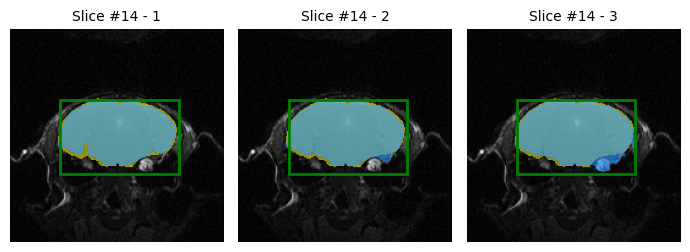

	15: 92.86%		15: 94.96%		15: 94.43%	

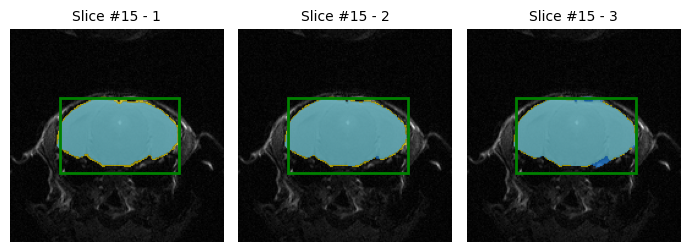

	16: 93.75%		16: 95.13%		16: 94.41%	

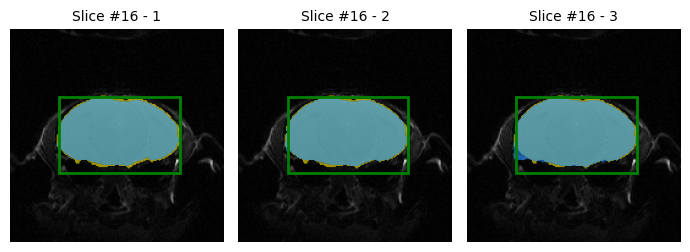

	17: 93.81%		17: 95.18%		17: 96.3%	

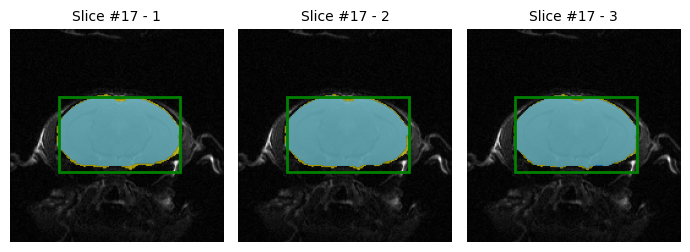

	18: 93.57%		18: 94.88%		18: 95.94%	

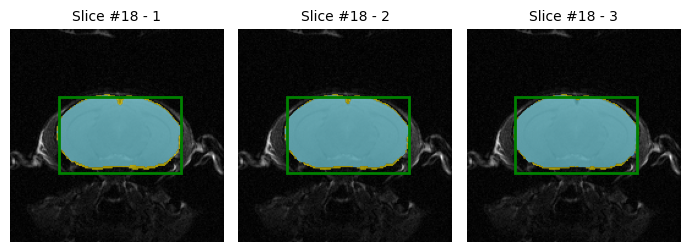

	19: 92.76%		19: 93.73%		19: 94.64%	

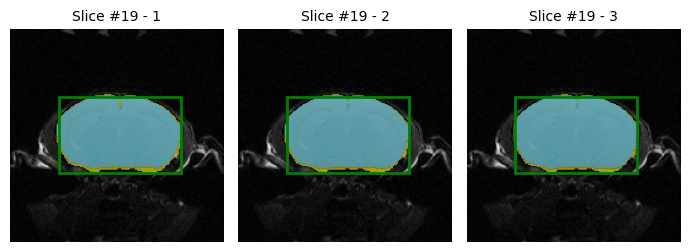

	20: 91.42%		20: 94.09%		20: 95.45%	

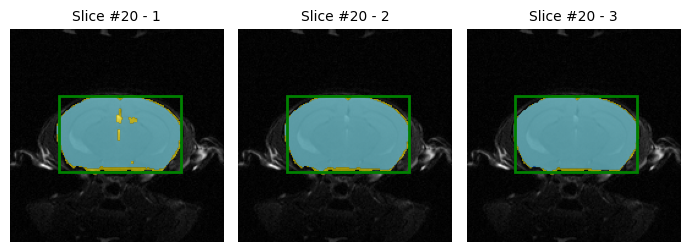

	21: 62.71%		21: 95.44%		21: 96.09%	

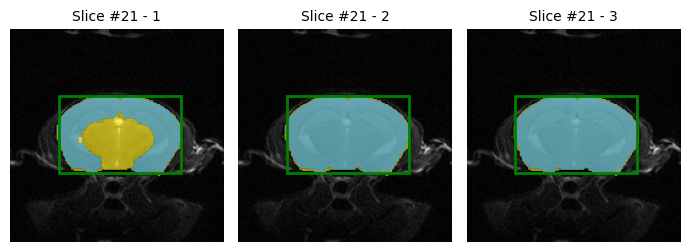

	22: 64.14%		22: 93.61%		22: 94.63%	

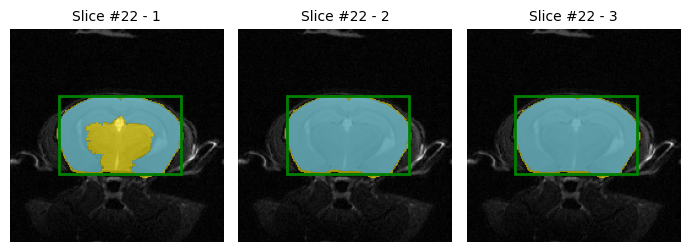

	23: 91.92%		23: 95.81%		23: 96.76%	

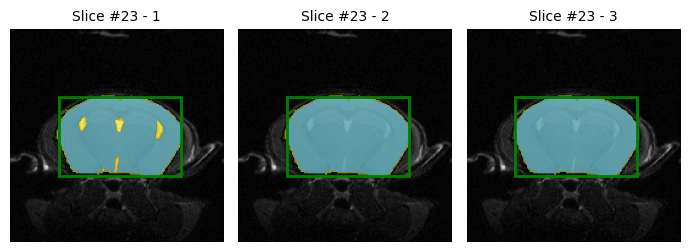

	24: 95.62%		24: 95.49%		24: 95.96%	

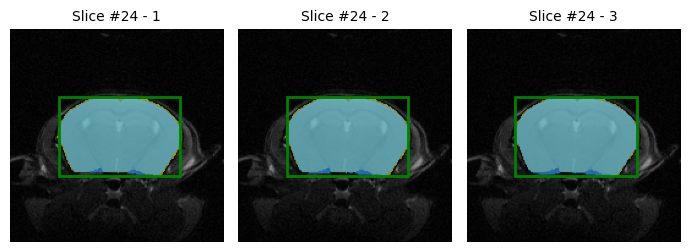

	25: 93.03%		25: 96.38%		25: 96.19%	

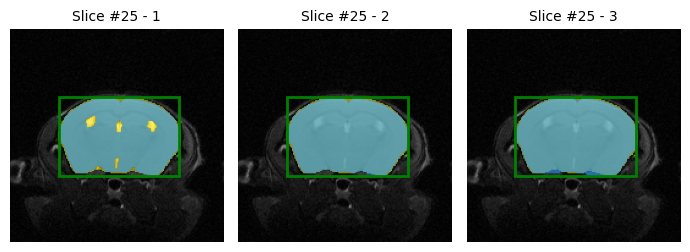

	26: 93.36%		26: 94.66%		26: 94.15%	

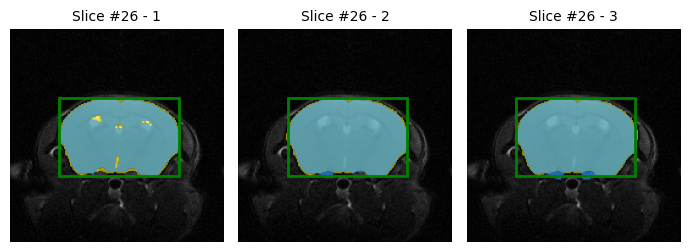

	27: 89.25%		27: 95.55%		27: 93.93%	

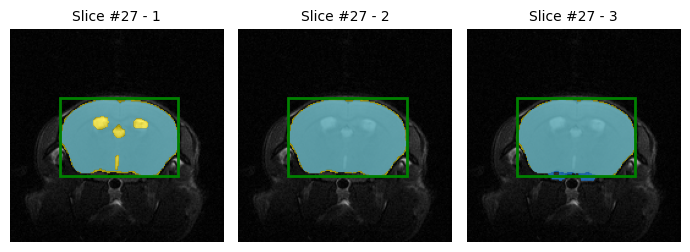

	28: 86.5%		28: 94.97%		28: 95.85%	

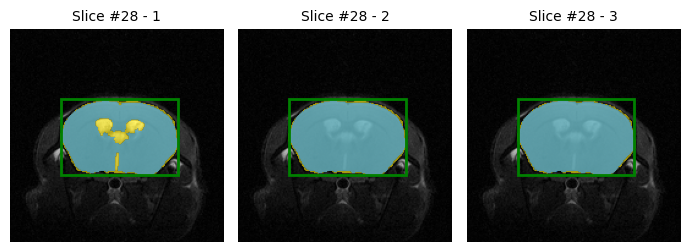

	29: 82.86%		29: 95.34%		29: 96.18%	

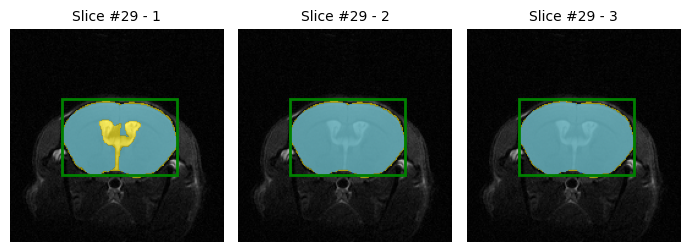

	30: 94.98%		30: 95.74%		30: 96.67%	

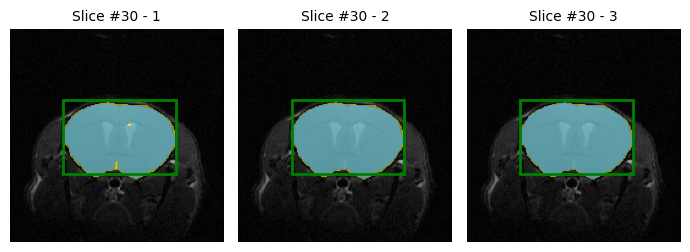

	31: 92.21%		31: 95.02%		31: 96.0%	

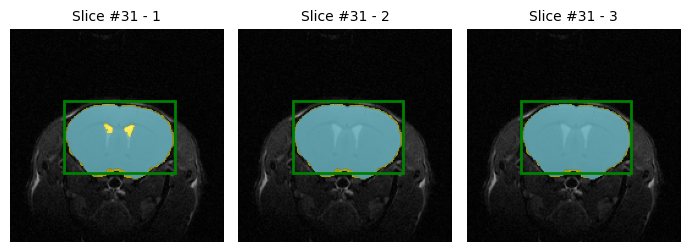

	32: 93.64%		32: 94.57%		32: 95.23%	

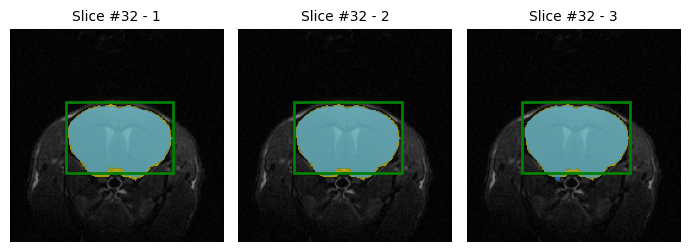

	33: 92.34%		33: 93.54%		33: 94.72%	

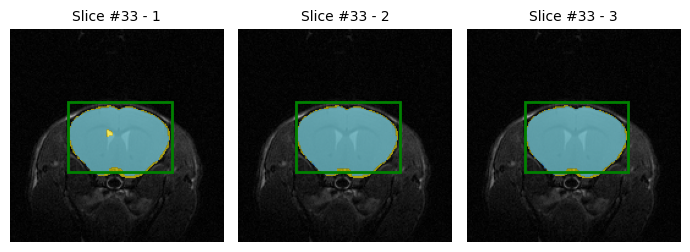

	34: 94.62%		34: 95.7%		34: 96.37%	

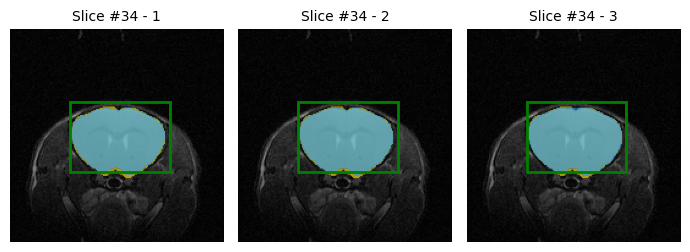

	35: 94.69%		35: 95.74%		35: 95.33%	

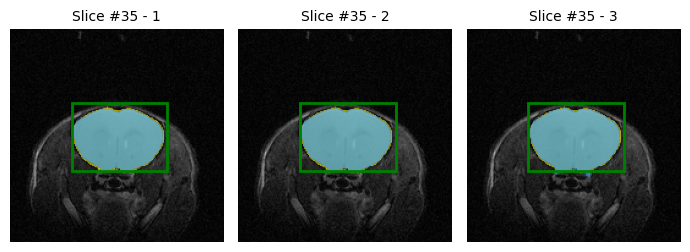

	36: 94.07%		36: 95.35%		36: 96.08%	

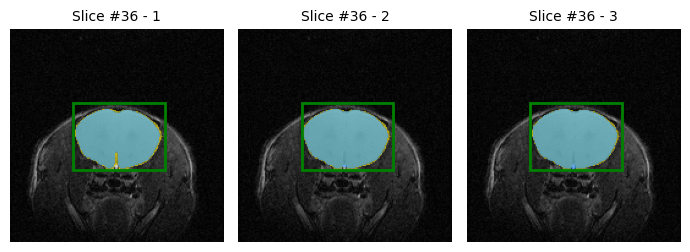

	37: 95.18%		37: 96.98%		37: 97.69%	

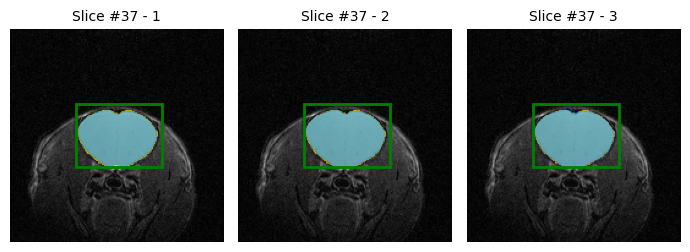

	38: 94.97%		38: 96.27%		38: 95.22%	

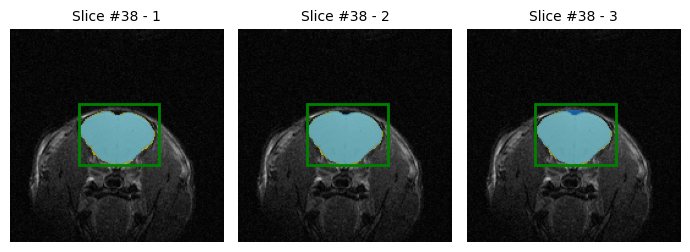

	39: 94.3%		39: 96.72%		39: 96.55%	

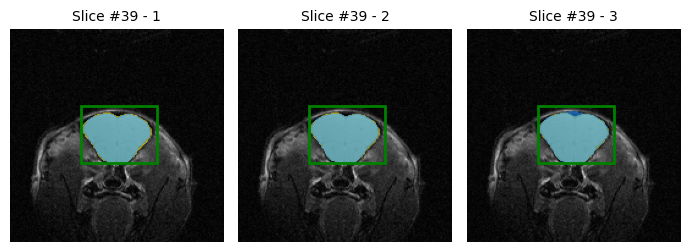

	40: 94.06%		40: 95.75%		40: 89.61%	

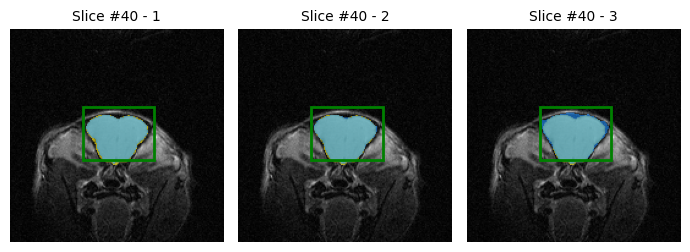

	41: 51.33%		41: 93.05%		41: 82.38%	

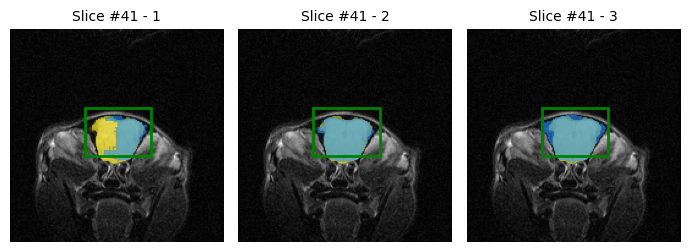

	42: -31.49000000000001%		42: 92.01%		42: 74.86%	

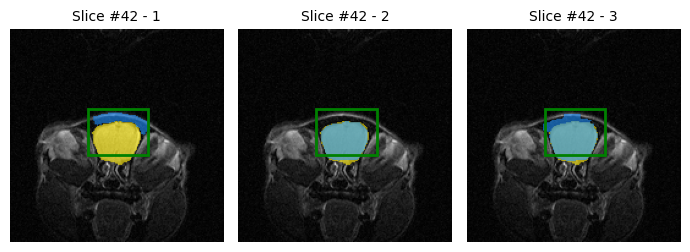

	43: 84.32%		43: 91.63%		43: 93.48%	

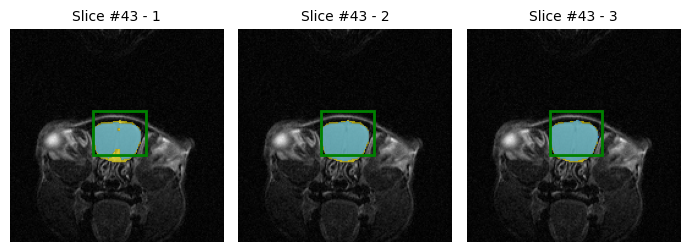

	44: 49.78%		44: 90.97%		44: 93.66%	

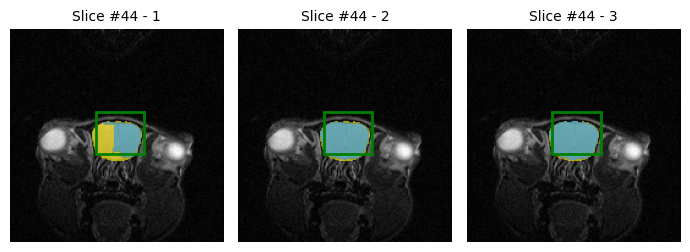

	45: 91.39%		45: 92.92%		45: 94.26%	

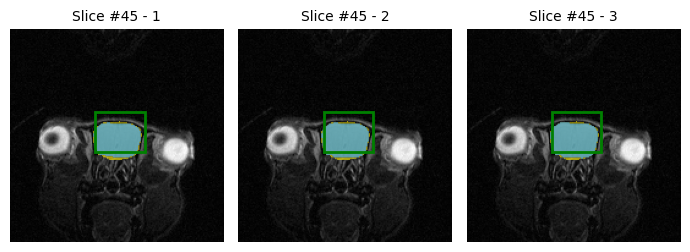

	46: 87.51%		46: 90.33%		46: 92.35%	

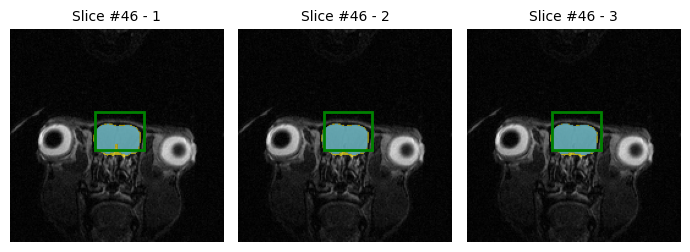

	47: 44.97%		47: 90.34%		47: 92.28%	

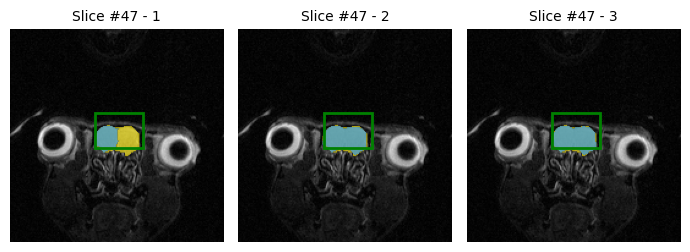

	48: 87.07%		48: 88.69%		48: 92.32%	

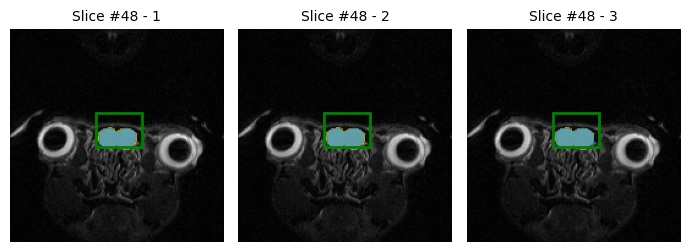

Subject mean performance metrics:
Accuracy:		 86.85%
Jaccard index:		 0.8728
Dice coefficient:	 0.9083


In [25]:
files = []
subjects_path, output_path = subjects_path_d3, pjoin(output_path_base,"semi_auto/d3")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.endswith("flip.nii.gz"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

initial_slice = 3
final_slice   = 35

list_of_sam_mask_lists = []

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    sam_mask_list = create_sam_candidates_list(file, semi_auto=True, other_lab=True, reference_mask=True)
    list_of_sam_mask_lists.append(sam_mask_list)

-------------------------------------------------
20190227_105648_AE0818_rs_Control_11_1_1_T2w.nii_flip.nii.gz


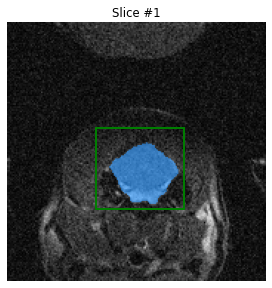

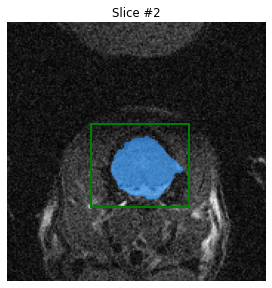

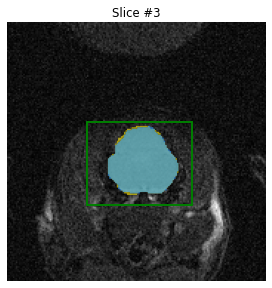

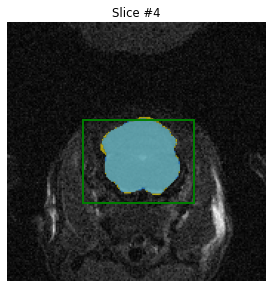

Accuracy of slice #5: 96.73%


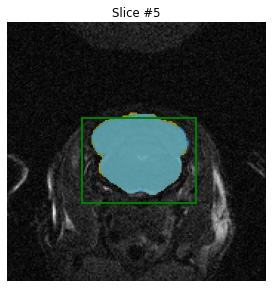

Accuracy of slice #6: 96.9%


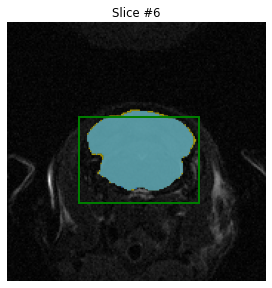

Accuracy of slice #7: 92.2%


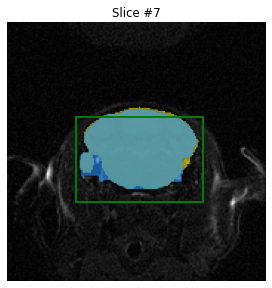

Accuracy of slice #8: 93.05%


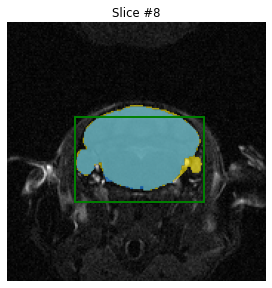

Accuracy of slice #9: 95.74%


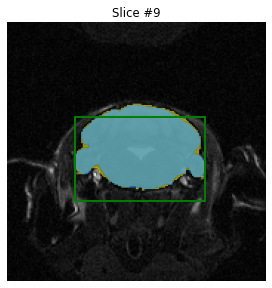

Accuracy of slice #10: 94.99%


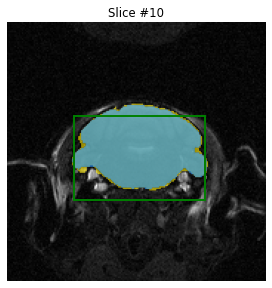

Accuracy of slice #11: 92.36%


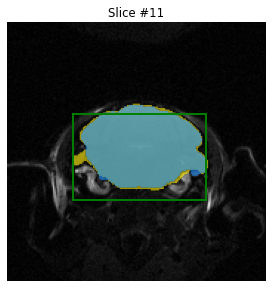

Accuracy of slice #12: 90.3%


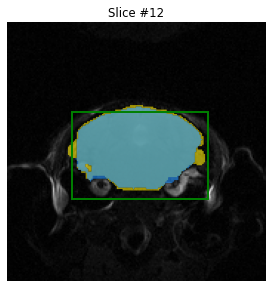

Accuracy of slice #13: 95.48%


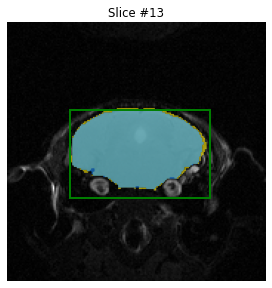

Accuracy of slice #14: 92.98%


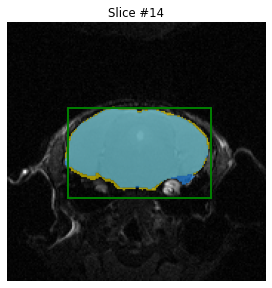

Accuracy of slice #15: 94.96%


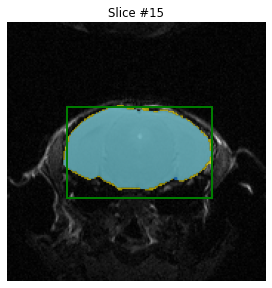

Accuracy of slice #16: 95.13%


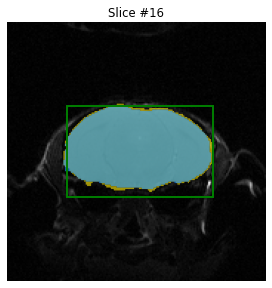

Accuracy of slice #17: 96.3%


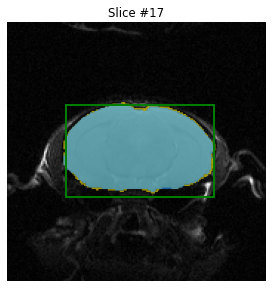

Accuracy of slice #18: 95.94%


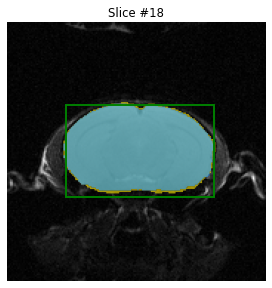

Accuracy of slice #19: 94.64%


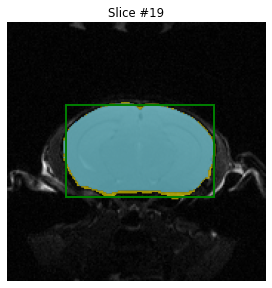

Accuracy of slice #20: 95.45%


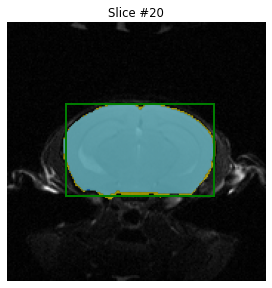

Accuracy of slice #21: 96.09%


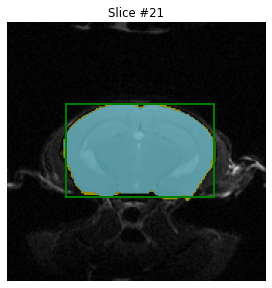

Accuracy of slice #22: 94.63%


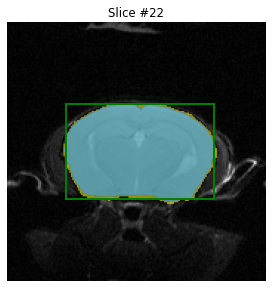

Accuracy of slice #23: 96.76%


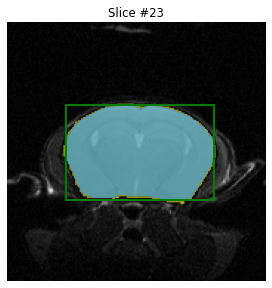

Accuracy of slice #24: 95.96%


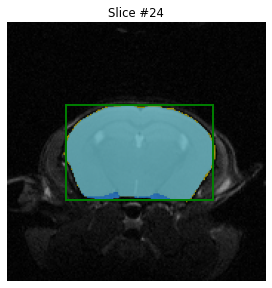

Accuracy of slice #25: 96.38%


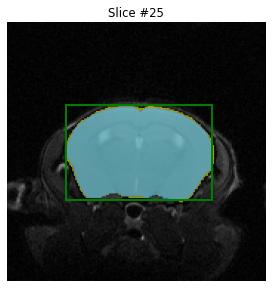

Accuracy of slice #26: 94.66%


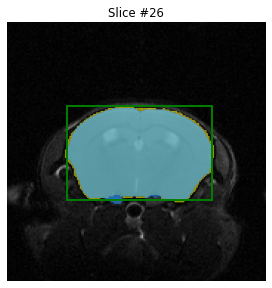

Accuracy of slice #27: 95.55%


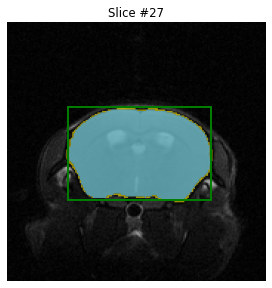

Accuracy of slice #28: 95.85%


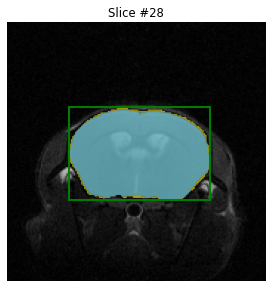

Accuracy of slice #29: 96.18%


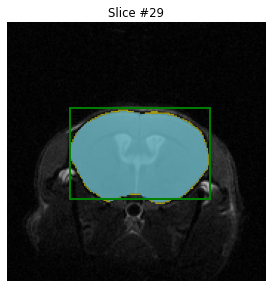

Accuracy of slice #30: 96.67%


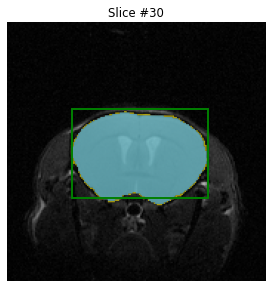

Accuracy of slice #31: 96.0%


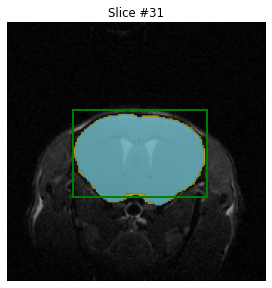

Accuracy of slice #32: 95.23%


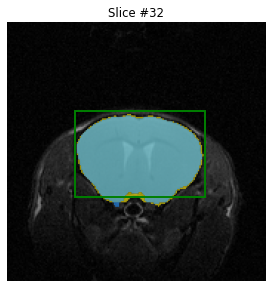

Accuracy of slice #33: 94.72%


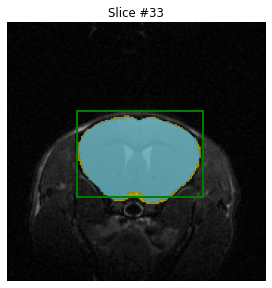

Accuracy of slice #34: 96.37%


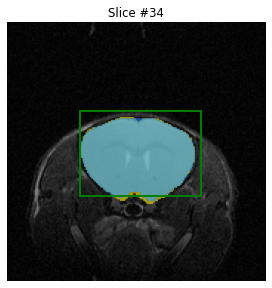

Accuracy of slice #35: 95.74%


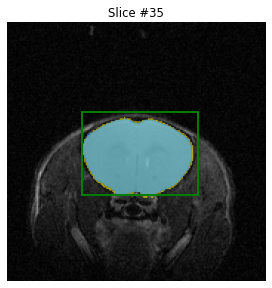

Accuracy of slice #36: 96.08%


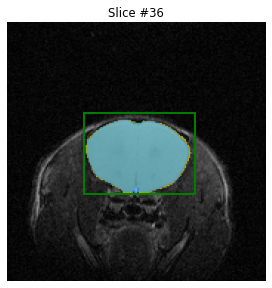

Accuracy of slice #37: 97.69%


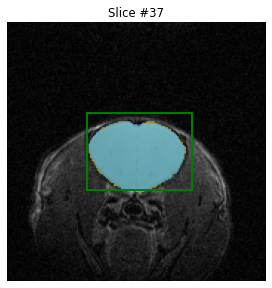

Accuracy of slice #38: 96.27%


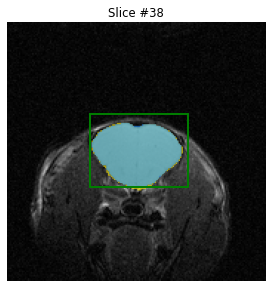

Accuracy of slice #39: 96.72%


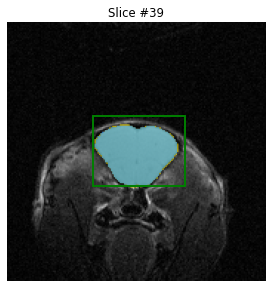

Accuracy of slice #40: 95.75%


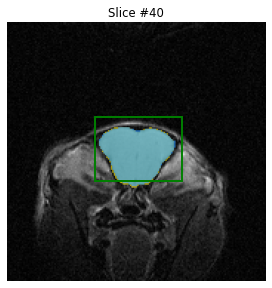

Accuracy of slice #41: 93.05%


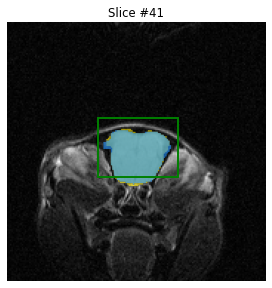

Accuracy of slice #42: 92.01%


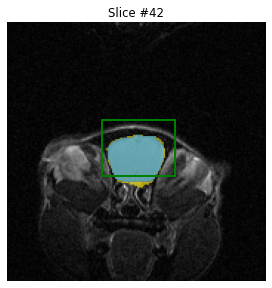

Accuracy of slice #43: 93.48%


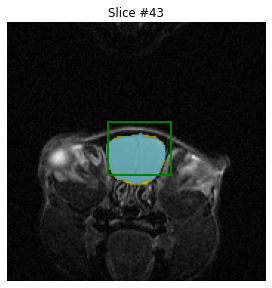

Accuracy of slice #44: 93.66%


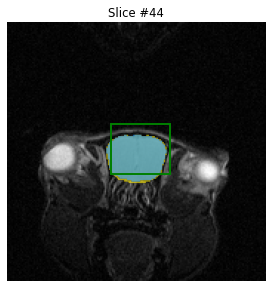

Accuracy of slice #45: 94.26%


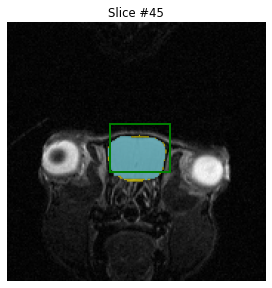

Accuracy of slice #46: 92.35%


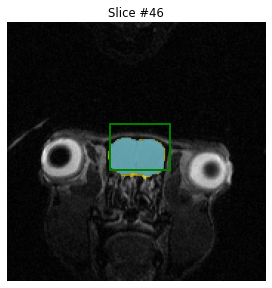

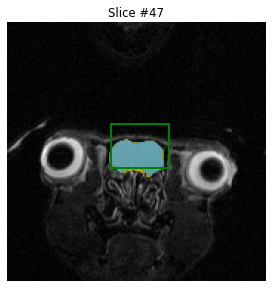

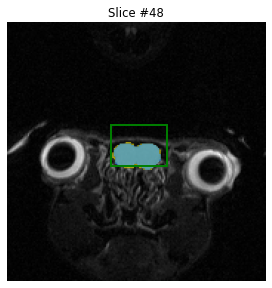

Subject mean performance metrics:
Accuracy:		 95.03%
Jaccard index:		 0.9506
Dice coefficient:	 0.9746
accuracy_values_d3 = np.array([95.03])
jaccard_values_d3 = np.array([0.9506])
dice_values_d3 = np.array([0.9746])
accur_values_d3 = np.array([96.73, 96.9, 92.2, 93.05, 95.74, 94.99, 92.36, 90.3, 95.48, 92.98, 94.96, 95.13, 96.3, 95.94, 94.64, 95.45, 96.09, 94.63, 96.76, 95.96, 96.38, 94.66, 95.55, 95.85, 96.18, 96.67, 96.0, 95.23, 94.72, 96.37, 95.74, 96.08, 97.69, 96.27, 96.72, 95.75, 93.05, 92.01, 93.48, 93.66, 94.26, 92.35])
jacc_values_d3 = np.array([0.9675, 0.969, 0.9258, 0.9309, 0.9576, 0.95, 0.9244, 0.9042, 0.955, 0.9309, 0.9496, 0.9514, 0.9631, 0.9595, 0.9464, 0.9545, 0.9609, 0.9463, 0.9676, 0.9604, 0.9639, 0.9472, 0.9555, 0.9585, 0.9618, 0.9667, 0.96, 0.9524, 0.9473, 0.9639, 0.9575, 0.961, 0.977, 0.9628, 0.9672, 0.9579, 0.9325, 0.9201, 0.935, 0.9366, 0.9426, 0.9235])
dic_values_d3 = np.array([0.9835, 0.9843, 0.9615, 0.9642, 0.9783, 0.9744, 0.9607, 0.9497, 0.977, 0.9642, 0.974

In [26]:
best_mask_indexes = find_best_mask_indexes(jaccards_per_slice, len(files[:1]), 48)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    create_sam_masks_nifti(file,list_of_sam_mask_lists[files.index(file)],best_mask_index=best_mask_indexes[files.index(file)],other_lab=True)

print(f"accuracy_values_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

## Evaluation metrics

In [27]:
accuracy_values_3 = np.array([95.2, 91.38, 95.2, 92.66, 92.63, 92.89, 89.02, 88.42, 93.53, 94.18, 93.11, 92.2, 93.51, 93.97, 92.3, 94.96])
jaccard_values_3 = np.array([0.9529, 0.919, 0.9531, 0.9296, 0.9309, 0.931, 0.8968, 0.9014, 0.9377, 0.9429, 0.9334, 0.9241, 0.9373, 0.9407, 0.9266, 0.9509])
dice_values_3 = np.array([0.9758, 0.9567, 0.9759, 0.963, 0.9636, 0.9638, 0.9438, 0.9458, 0.9677, 0.9704, 0.9652, 0.9602, 0.9674, 0.9693, 0.9614, 0.9747])
accur_values_3 = np.array([95.45, 95.74, 96.29, 93.23, 96.43, 97.23, 95.28, 96.11, 96.7, 96.33, 96.77, 97.23, 95.65, 90.66, 93.58, 90.59, 76.22, 87.25, 93.52, 95.07, 96.9, 94.51, 94.71, 94.97, 95.24, 95.97, 95.59, 94.82, 72.86, 93.32, 94.38, 86.76, 95.17, 92.89, 95.78, 95.51, 97.37, 96.45, 95.95, 98.09, 97.09, 96.95, 96.25, 96.17, 90.41, 90.93, 94.61, 93.52, 82.86, 94.73, 94.66, 91.95, 93.38, 91.88, 96.73, 95.88, 97.9, 96.91, 97.02, 94.35, 91.23, 83.25, 94.31, 85.47, 92.24, 89.42, 94.32, 96.73, 98.12, 95.78, 95.11, 98.44, 97.72, 95.54, 95.52, 89.97, 76.26, 90.33, 91.9, 84.73, 89.82, 88.28, 92.53, 92.14, 96.15, 95.96, 96.44, 97.56, 97.09, 95.92, 97.23, 93.08, 83.22, 92.77, 92.87, 85.2, 74.77, 79.03999999999999, 94.44, 93.1, 95.2, 94.55, 96.59, 96.87, 96.71, 94.74, 93.48, 88.46000000000001, 88.02, 67.78999999999999, 91.65, 78.83, 90.85, 92.35, 96.63, 96.9, 94.32, 93.99, 95.88, 94.53, 95.46, 92.95, 94.42, 90.69, 86.5, 70.11, 45.64, 83.55, 93.05, 90.83, 94.14, 95.86, 94.63, 94.21, 95.61, 96.11, 94.45, 96.21, 95.93, 91.95, 90.58, 85.86, 93.43, 93.62, 94.06, 89.94, 95.89, 96.04, 97.27, 95.72, 96.12, 96.44, 97.13, 96.08, 97.4, 94.3, 89.42, 90.33, 89.33, 91.4, 94.42, 94.62, 95.17, 94.07, 95.77, 91.62, 95.38, 94.57, 95.08, 97.41, 95.03, 94.48, 90.82, 78.86, 91.21000000000001, 91.17, 88.24, 91.06, 92.89, 91.31, 94.07, 94.65, 95.94, 95.69, 96.15, 96.89, 95.0, 92.31, 91.03, 87.35, 91.89, 80.78, 92.25, 94.83, 95.24, 95.7, 94.34, 95.63, 94.9, 95.78, 95.84, 96.7, 94.16, 95.47, 89.77, 82.96000000000001, 91.22, 91.33, 93.29, 92.07, 92.95, 96.84, 96.46, 89.26, 95.21, 96.0, 96.86, 97.64, 96.18, 94.05, 91.75, 88.52, 93.02, 93.35, 90.36, 88.27, 94.37, 94.58, 95.31, 93.33, 95.05, 94.87, 93.94, 95.44, 96.38, 95.52, 87.63, 76.38, 94.26, 91.13, 95.09, 95.33, 92.22, 96.85, 96.61, 96.56, 95.91, 95.51, 97.34, 96.71, 95.29, 94.47, 91.92, 89.05, 95.41, 95.14])
jacc_values_3 = np.array([0.9553, 0.9581, 0.9633, 0.933, 0.9645, 0.9725, 0.9544, 0.962, 0.9674, 0.9635, 0.9682, 0.9727, 0.9569, 0.909, 0.9378, 0.9085, 0.7649, 0.8749, 0.9384, 0.9512, 0.9693, 0.9473, 0.9482, 0.9513, 0.953, 0.9599, 0.9562, 0.9485, 0.7828, 0.9365, 0.9444, 0.877, 0.9523, 0.9295, 0.9587, 0.9559, 0.9739, 0.9655, 0.9607, 0.9811, 0.971, 0.9696, 0.9629, 0.9619, 0.9084, 0.9144, 0.9469, 0.9366, 0.8287, 0.9477, 0.9478, 0.9197, 0.935, 0.9245, 0.9674, 0.9602, 0.9791, 0.9695, 0.9705, 0.9442, 0.9146, 0.8556, 0.9438, 0.8656, 0.9228, 0.895, 0.9447, 0.9675, 0.9814, 0.9587, 0.9522, 0.9846, 0.9774, 0.9555, 0.9553, 0.9003, 0.8056, 0.9083, 0.9203, 0.8644, 0.8986, 0.8834, 0.9265, 0.9217, 0.9621, 0.9606, 0.9651, 0.976, 0.9713, 0.9594, 0.9726, 0.9317, 0.8465, 0.9313, 0.9315, 0.8579, 0.7477, 0.7907, 0.9458, 0.9311, 0.9521, 0.9468, 0.9666, 0.9691, 0.9675, 0.9483, 0.9354, 0.8918, 0.8902, 0.7505, 0.9177, 0.7981, 0.9099, 0.924, 0.9668, 0.9692, 0.9444, 0.9427, 0.9597, 0.9469, 0.956, 0.9332, 0.9452, 0.9108, 0.8711, 0.7551, 0.6397, 0.848, 0.9332, 0.9097, 0.9426, 0.9593, 0.9467, 0.9444, 0.9566, 0.9614, 0.9452, 0.9622, 0.9595, 0.9215, 0.9106, 0.8757, 0.9366, 0.938, 0.9411, 0.902, 0.9594, 0.9607, 0.9733, 0.9583, 0.9621, 0.9647, 0.9714, 0.9613, 0.9743, 0.9437, 0.8951, 0.9069, 0.8959, 0.9164, 0.9446, 0.9464, 0.952, 0.9414, 0.9579, 0.9217, 0.9547, 0.9477, 0.9522, 0.9743, 0.9507, 0.945, 0.91, 0.8077, 0.9147, 0.9133, 0.884, 0.9112, 0.9301, 0.9136, 0.9409, 0.948, 0.9599, 0.9578, 0.9618, 0.9695, 0.9505, 0.9234, 0.9139, 0.8824, 0.9197, 0.8197, 0.925, 0.9489, 0.9541, 0.9578, 0.9438, 0.9571, 0.95, 0.9586, 0.9592, 0.9674, 0.9421, 0.9549, 0.8987, 0.8516, 0.9134, 0.9147, 0.9332, 0.9224, 0.93, 0.9688, 0.9654, 0.8948, 0.9529, 0.9608, 0.9691, 0.9768, 0.9621, 0.9407, 0.9184, 0.8884, 0.931, 0.9364, 0.9043, 0.8838, 0.9444, 0.9467, 0.9533, 0.9363, 0.951, 0.95, 0.9411, 0.9547, 0.9645, 0.9557, 0.8776, 0.8062, 0.943, 0.9132, 0.9514, 0.9543, 0.9245, 0.9688, 0.9663, 0.9662, 0.96, 0.9556, 0.9736, 0.9675, 0.9532, 0.9453, 0.9219, 0.8992, 0.9544, 0.9521])
dic_values_3 = np.array([0.9771, 0.9786, 0.9813, 0.9653, 0.9819, 0.986, 0.9767, 0.9806, 0.9835, 0.9814, 0.9839, 0.9862, 0.978, 0.9523, 0.9679, 0.952, 0.8668, 0.9333, 0.9682, 0.975, 0.9844, 0.9729, 0.9734, 0.975, 0.9759, 0.9796, 0.9776, 0.9736, 0.8782, 0.9672, 0.9714, 0.9345, 0.9755, 0.9635, 0.9789, 0.9775, 0.9868, 0.9824, 0.98, 0.9904, 0.9853, 0.9846, 0.9811, 0.9806, 0.952, 0.9553, 0.9728, 0.9673, 0.9063, 0.9731, 0.9732, 0.9582, 0.9664, 0.9608, 0.9834, 0.9797, 0.9894, 0.9845, 0.985, 0.9713, 0.9554, 0.9222, 0.9711, 0.928, 0.9599, 0.9446, 0.9716, 0.9835, 0.9906, 0.9789, 0.9755, 0.9922, 0.9886, 0.9772, 0.9771, 0.9475, 0.8923, 0.9519, 0.9585, 0.9272, 0.9466, 0.9381, 0.9618, 0.9593, 0.9807, 0.9799, 0.9822, 0.9878, 0.9854, 0.9793, 0.9861, 0.9646, 0.9169, 0.9644, 0.9645, 0.9235, 0.8557, 0.8831, 0.9721, 0.9643, 0.9755, 0.9727, 0.983, 0.9843, 0.9835, 0.9734, 0.9666, 0.9428, 0.9419, 0.8574, 0.9571, 0.8877, 0.9528, 0.9605, 0.9831, 0.9843, 0.9714, 0.9705, 0.9794, 0.9727, 0.9775, 0.9655, 0.9718, 0.9533, 0.9311, 0.8605, 0.7802, 0.9178, 0.9655, 0.9527, 0.9705, 0.9792, 0.9726, 0.9714, 0.9778, 0.9803, 0.9718, 0.9807, 0.9793, 0.9592, 0.9532, 0.9337, 0.9673, 0.968, 0.9696, 0.9485, 0.9793, 0.9799, 0.9865, 0.9787, 0.9807, 0.982, 0.9855, 0.9803, 0.987, 0.971, 0.9446, 0.9512, 0.9451, 0.9564, 0.9715, 0.9725, 0.9754, 0.9698, 0.9785, 0.9592, 0.9768, 0.9731, 0.9755, 0.987, 0.9747, 0.9717, 0.9529, 0.8936, 0.9555, 0.9547, 0.9384, 0.9535, 0.9638, 0.9548, 0.9695, 0.9733, 0.9795, 0.9785, 0.9805, 0.9845, 0.9746, 0.9602, 0.955, 0.9375, 0.9582, 0.9009, 0.961, 0.9738, 0.9765, 0.9784, 0.9711, 0.9781, 0.9744, 0.9789, 0.9792, 0.9834, 0.9702, 0.9769, 0.9466, 0.9198, 0.9548, 0.9554, 0.9655, 0.9596, 0.9637, 0.9841, 0.9824, 0.9445, 0.9759, 0.98, 0.9843, 0.9883, 0.9807, 0.9694, 0.9575, 0.9409, 0.9642, 0.9671, 0.9497, 0.9383, 0.9714, 0.9726, 0.9761, 0.9671, 0.9749, 0.9744, 0.9696, 0.9768, 0.9819, 0.9773, 0.9348, 0.8927, 0.9707, 0.9546, 0.9751, 0.9766, 0.9608, 0.9842, 0.9829, 0.9828, 0.9796, 0.9773, 0.9866, 0.9835, 0.9761, 0.9719, 0.9593, 0.9469, 0.9767, 0.9755])

accuracy_values_4_5 = np.array([94.88, 92.33, 92.32, 91.56, 93.15, 94.16, 94.56, 92.66, 94.33, 92.9, 95.03])
jaccard_values_4_5 = np.array([0.9501, 0.9272, 0.9258, 0.918, 0.9328, 0.943, 0.9471, 0.929, 0.9449, 0.9331, 0.9515])
dice_values_4_5 = np.array([0.9744, 0.9615, 0.9604, 0.9562, 0.965, 0.9704, 0.9727, 0.9629, 0.9715, 0.9648, 0.975])
accur_values_4_5 = np.array([93.38, 95.58, 95.93, 93.37, 97.1, 96.19, 91.96000000000001, 95.87, 96.66, 96.77, 96.65, 95.59, 94.99, 91.67, 92.22, 94.09, 77.45, 93.46, 92.24, 93.76, 97.56, 93.86, 95.51, 94.76, 94.19, 95.46, 97.0, 92.74, 81.27, 87.62, 95.45, 94.96, 87.9, 71.4, 91.96000000000001, 96.65, 94.26, 96.43, 91.27, 95.61, 96.17, 95.37, 95.2, 96.39, 92.7, 87.34, 94.94, 93.57, 87.25, 75.81, 82.84, 91.43, 96.27, 96.82, 95.42, 95.72, 94.87, 95.89, 96.88, 96.12, 91.77, 80.99, 93.67, 93.26, 94.55, 87.68, 93.01, 96.0, 95.29, 95.63, 92.99, 95.61, 95.94, 94.13, 95.16, 94.7, 88.68, 84.78, 93.06, 93.25, 88.97, 95.54, 92.68, 96.72, 97.01, 96.58, 96.04, 96.91, 96.97, 96.53, 95.97, 94.43, 90.69, 85.95, 95.61, 90.03, 94.6, 93.96, 96.76, 96.91, 96.56, 94.47, 94.88, 95.38, 95.72, 96.04, 96.26, 95.78, 95.81, 90.73, 88.0, 91.15, 93.92, 86.73, 96.41, 94.24, 95.51, 94.56, 94.86, 95.63, 96.45, 93.78, 94.17, 93.62, 89.14, 86.78, 91.87, 84.89, 85.83, 94.32, 92.18, 95.77, 97.05, 96.95, 95.48, 96.39, 96.08, 95.87, 95.11, 97.3, 96.24, 91.36, 90.62, 92.79, 92.6, 96.77, 95.02, 95.91, 96.77, 96.44, 93.91, 93.33, 97.23, 95.84, 95.96, 94.87, 91.14, 84.48, 75.95, 90.14, 95.18, 96.95, 95.1, 96.95, 97.63, 94.06, 94.88, 96.93, 97.32, 97.7, 93.46, 96.04, 91.5, 90.96000000000001, 93.01, 92.84])
jacc_values_4_5 = np.array([0.9362, 0.9559, 0.9602, 0.9362, 0.9711, 0.9623, 0.9249, 0.9597, 0.967, 0.9678, 0.9668, 0.9568, 0.9505, 0.9197, 0.9234, 0.9438, 0.7778, 0.935, 0.9265, 0.9397, 0.9758, 0.9412, 0.9564, 0.9496, 0.944, 0.9559, 0.9705, 0.9301, 0.8389, 0.8877, 0.9554, 0.9512, 0.8879, 0.7169, 0.922, 0.9666, 0.9434, 0.9645, 0.9144, 0.9574, 0.9625, 0.9543, 0.9521, 0.9643, 0.9306, 0.8864, 0.9516, 0.9378, 0.8762, 0.7586, 0.8286, 0.9144, 0.963, 0.9684, 0.9549, 0.9585, 0.95, 0.9595, 0.9691, 0.9618, 0.9205, 0.8326, 0.9374, 0.9347, 0.9462, 0.8772, 0.9324, 0.9602, 0.9533, 0.9569, 0.9328, 0.9571, 0.9601, 0.9433, 0.9521, 0.9475, 0.8903, 0.8498, 0.933, 0.9326, 0.8897, 0.9562, 0.9275, 0.9675, 0.9701, 0.9665, 0.9613, 0.9696, 0.9698, 0.9654, 0.9599, 0.9445, 0.9076, 0.8724, 0.9562, 0.903, 0.9471, 0.9406, 0.9678, 0.9695, 0.966, 0.9467, 0.9497, 0.9549, 0.9579, 0.961, 0.9629, 0.9585, 0.9589, 0.912, 0.8877, 0.913, 0.9408, 0.8686, 0.9641, 0.9443, 0.9556, 0.9475, 0.9504, 0.9573, 0.9651, 0.9403, 0.9429, 0.9376, 0.8964, 0.8761, 0.9216, 0.8561, 0.866, 0.9462, 0.9231, 0.9585, 0.9708, 0.9697, 0.9564, 0.9645, 0.9619, 0.9596, 0.9517, 0.9734, 0.9631, 0.9169, 0.9087, 0.9286, 0.9263, 0.9679, 0.9511, 0.9601, 0.9679, 0.9648, 0.9407, 0.9365, 0.9726, 0.9585, 0.9602, 0.9492, 0.9141, 0.8554, 0.8023, 0.9014, 0.9533, 0.9698, 0.9528, 0.9699, 0.9766, 0.9423, 0.9505, 0.9698, 0.9734, 0.9771, 0.9378, 0.9608, 0.9155, 0.9125, 0.9311, 0.9302])
dic_values_4_5 = np.array([0.9671, 0.9774, 0.9797, 0.967, 0.9853, 0.9808, 0.961, 0.9794, 0.9832, 0.9836, 0.9831, 0.9779, 0.9746, 0.9582, 0.9602, 0.9711, 0.875, 0.9664, 0.9619, 0.9689, 0.9877, 0.9697, 0.9777, 0.9741, 0.9712, 0.9774, 0.9851, 0.9638, 0.9124, 0.9405, 0.9772, 0.975, 0.9406, 0.8351, 0.9594, 0.983, 0.9709, 0.9819, 0.9553, 0.9783, 0.9809, 0.9766, 0.9755, 0.9818, 0.964, 0.9398, 0.9752, 0.9679, 0.934, 0.8628, 0.9063, 0.9553, 0.9811, 0.9839, 0.9769, 0.9788, 0.9744, 0.9793, 0.9843, 0.9805, 0.9586, 0.9086, 0.9677, 0.9663, 0.9724, 0.9346, 0.965, 0.9797, 0.9761, 0.978, 0.9652, 0.9781, 0.9797, 0.9708, 0.9755, 0.9731, 0.9419, 0.9188, 0.9654, 0.9651, 0.9417, 0.9776, 0.9624, 0.9835, 0.9848, 0.983, 0.9803, 0.9846, 0.9847, 0.9824, 0.9796, 0.9715, 0.9516, 0.9318, 0.9776, 0.9491, 0.9728, 0.9694, 0.9837, 0.9845, 0.9827, 0.9726, 0.9742, 0.9769, 0.9785, 0.9801, 0.9811, 0.9788, 0.979, 0.954, 0.9405, 0.9545, 0.9695, 0.9297, 0.9817, 0.9714, 0.9773, 0.973, 0.9746, 0.9782, 0.9822, 0.9692, 0.9706, 0.9678, 0.9454, 0.9339, 0.9592, 0.9225, 0.9282, 0.9723, 0.96, 0.9788, 0.9852, 0.9846, 0.9777, 0.9819, 0.9806, 0.9794, 0.9753, 0.9865, 0.9812, 0.9566, 0.9522, 0.963, 0.9617, 0.9837, 0.9749, 0.9797, 0.9837, 0.9821, 0.9695, 0.9672, 0.9861, 0.9788, 0.9797, 0.9739, 0.9551, 0.9221, 0.8903, 0.9482, 0.9761, 0.9847, 0.9759, 0.9847, 0.9882, 0.9703, 0.9746, 0.9847, 0.9865, 0.9884, 0.9679, 0.98, 0.9559, 0.9543, 0.9643, 0.9639])

accuracy_values_6 = np.array([93.67, 93.26, 93.62, 92.37, 94.37, 93.72, 92.36, 93.0, 92.94, 88.78, 92.85])
jaccard_values_6 = np.array([0.9377, 0.9351, 0.9389, 0.9254, 0.9455, 0.9393, 0.926, 0.9321, 0.9317, 0.9004, 0.9304])
dice_values_6 = np.array([0.9677, 0.9662, 0.9682, 0.9609, 0.9717, 0.9683, 0.9614, 0.9644, 0.9641, 0.9461, 0.9635])
accur_values_6 = np.array([92.67, 93.03, 94.96, 89.95, 94.32, 97.13, 93.09, 92.7, 95.29, 95.72, 95.55, 95.26, 95.43, 87.63, 90.68, 95.27, 91.14, 88.71000000000001, 95.21, 95.85, 96.59, 90.58, 94.32, 95.92, 96.94, 97.36, 95.72, 95.3, 87.43, 84.66, 92.98, 93.48, 92.71, 94.3, 95.47, 96.35, 96.23, 93.02, 95.27, 96.04, 96.6, 95.44, 97.17, 95.3, 90.1, 84.67, 87.59, 91.62, 88.97, 87.28, 95.97, 95.81, 97.75, 95.9, 93.45, 93.3, 93.75, 92.72, 96.83, 91.65, 88.71000000000001, 89.07, 92.18, 84.51, 92.66, 93.75, 96.58, 94.88, 97.79, 97.41, 95.68, 95.86, 95.77, 97.68, 96.41, 96.74, 94.16, 87.85, 84.8, 91.84, 96.43, 96.64, 96.18, 96.59, 97.55, 94.37, 92.76, 95.45, 96.15, 95.92, 95.04, 96.79, 83.89, 91.34, 85.68, 88.78999999999999, 85.87, 92.57, 94.83, 94.55, 95.27, 94.45, 94.78, 95.86, 93.96, 92.8, 92.05, 92.47, 90.53, 85.78999999999999, 89.75, 92.29, 86.5, 87.16, 96.93, 95.51, 96.35, 96.42, 93.99, 95.29, 95.99, 97.6, 96.31, 95.0, 88.51, 84.84, 91.11, 90.5, 84.35, 89.84, 97.39, 95.98, 96.04, 95.17, 95.2, 95.3, 94.81, 96.22, 93.15, 97.05, 94.46, 87.35, 81.62, 93.05, 82.96000000000001, 89.24, 95.37, 96.63, 93.99, 94.77, 94.38, 93.38, 96.42, 93.97, 94.99, 95.0, 73.2, 80.17, 78.45, 67.53999999999999, 94.77, 95.45, 94.12, 96.12, 96.08, 94.6, 95.05, 96.05, 96.24, 94.34, 93.73, 93.11, 81.44, 91.73, 86.52, 86.23])
jacc_values_6 = np.array([0.927, 0.931, 0.9501, 0.9004, 0.9434, 0.9715, 0.9342, 0.9309, 0.9542, 0.9576, 0.9557, 0.9532, 0.955, 0.8793, 0.9068, 0.9535, 0.9131, 0.8883, 0.9528, 0.9596, 0.9662, 0.9128, 0.9435, 0.9599, 0.9696, 0.9738, 0.9577, 0.9539, 0.8791, 0.8633, 0.9314, 0.9365, 0.9302, 0.9435, 0.955, 0.9639, 0.9629, 0.9341, 0.9539, 0.9613, 0.9662, 0.9554, 0.972, 0.9533, 0.9084, 0.8614, 0.8846, 0.9169, 0.8921, 0.8732, 0.9602, 0.9583, 0.9778, 0.96, 0.9372, 0.935, 0.9397, 0.9294, 0.9687, 0.9181, 0.8918, 0.8925, 0.9233, 0.8484, 0.9308, 0.9386, 0.9664, 0.9502, 0.978, 0.9742, 0.958, 0.9597, 0.9586, 0.9768, 0.9644, 0.9677, 0.942, 0.89, 0.8535, 0.9187, 0.9646, 0.9672, 0.9623, 0.9662, 0.9758, 0.9459, 0.9316, 0.9555, 0.9622, 0.9595, 0.9513, 0.968, 0.8409, 0.9188, 0.8689, 0.8908, 0.8693, 0.9265, 0.9486, 0.9457, 0.9529, 0.9466, 0.9489, 0.9592, 0.9422, 0.9311, 0.9212, 0.9269, 0.9069, 0.8663, 0.8977, 0.9263, 0.8697, 0.8739, 0.9696, 0.9564, 0.964, 0.9648, 0.9415, 0.9539, 0.9609, 0.9762, 0.9634, 0.9509, 0.8885, 0.8615, 0.9122, 0.9059, 0.8549, 0.8993, 0.9742, 0.9602, 0.9607, 0.9526, 0.9535, 0.9543, 0.9498, 0.9627, 0.9349, 0.9707, 0.9455, 0.8752, 0.8283, 0.9309, 0.8305, 0.8953, 0.9541, 0.9665, 0.942, 0.9499, 0.9459, 0.937, 0.9649, 0.9417, 0.9504, 0.9515, 0.7827, 0.8333, 0.8195, 0.7419, 0.9479, 0.9556, 0.9413, 0.9613, 0.9615, 0.9479, 0.9513, 0.9612, 0.9625, 0.9443, 0.9374, 0.9323, 0.8161, 0.9206, 0.8796, 0.8655])
dic_values_6 = np.array([0.9621, 0.9642, 0.9744, 0.9476, 0.9709, 0.9855, 0.966, 0.9642, 0.9765, 0.9783, 0.9773, 0.976, 0.977, 0.9358, 0.9511, 0.9762, 0.9546, 0.9408, 0.9759, 0.9794, 0.9828, 0.9544, 0.9709, 0.9796, 0.9846, 0.9867, 0.9784, 0.9764, 0.9357, 0.9266, 0.9645, 0.9672, 0.9638, 0.9709, 0.977, 0.9816, 0.9811, 0.9659, 0.9764, 0.9803, 0.9828, 0.9772, 0.9858, 0.9761, 0.952, 0.9255, 0.9388, 0.9566, 0.943, 0.9323, 0.9797, 0.9787, 0.9888, 0.9796, 0.9676, 0.9664, 0.9689, 0.9634, 0.9841, 0.9573, 0.9428, 0.9432, 0.9601, 0.918, 0.9642, 0.9683, 0.9829, 0.9744, 0.9889, 0.9869, 0.9785, 0.9795, 0.9788, 0.9883, 0.9819, 0.9836, 0.9701, 0.9418, 0.9209, 0.9576, 0.982, 0.9833, 0.9808, 0.9828, 0.9878, 0.9722, 0.9646, 0.9772, 0.9807, 0.9793, 0.975, 0.9837, 0.9135, 0.9577, 0.9298, 0.9422, 0.9301, 0.9619, 0.9736, 0.9721, 0.9759, 0.9726, 0.9738, 0.9792, 0.9702, 0.9643, 0.959, 0.962, 0.9512, 0.9284, 0.9461, 0.9617, 0.9303, 0.9327, 0.9846, 0.9777, 0.9817, 0.9821, 0.9699, 0.9764, 0.9801, 0.988, 0.9813, 0.9748, 0.941, 0.9256, 0.9541, 0.9506, 0.9218, 0.947, 0.9869, 0.9797, 0.9799, 0.9757, 0.9762, 0.9766, 0.9742, 0.981, 0.9664, 0.9851, 0.972, 0.9334, 0.9061, 0.9642, 0.9074, 0.9448, 0.9765, 0.983, 0.9701, 0.9743, 0.9722, 0.9675, 0.9821, 0.97, 0.9746, 0.9751, 0.8781, 0.9091, 0.9008, 0.8518, 0.9733, 0.9773, 0.9698, 0.9803, 0.9804, 0.9733, 0.975, 0.9802, 0.9809, 0.9713, 0.9677, 0.965, 0.8987, 0.9587, 0.936, 0.9279])

accuracy_values_12 = np.array([91.88, 91.68, 92.34, 89.1, 86.96, 92.19, 88.55, 89.59, 91.38, 91.51, 90.23, 86.79, 88.46, 91.93, 90.58])
jaccard_values_12 = np.array([0.9244, 0.9237, 0.9276, 0.9035, 0.8958, 0.9286, 0.8995, 0.9056, 0.9203, 0.9235, 0.9172, 0.8916, 0.9007, 0.923, 0.9139])
dice_values_12 = np.array([0.9601, 0.9599, 0.9617, 0.9483, 0.9422, 0.9623, 0.9461, 0.9478, 0.9581, 0.9593, 0.9551, 0.9405, 0.9461, 0.9594, 0.9543])
accur_values_12 = np.array([78.53999999999999, 92.63, 90.12, 87.97, 96.69, 96.68, 94.14, 95.68, 96.48, 97.32, 92.97, 95.19, 95.42, 84.99, 84.44, 90.86, 81.64, 93.89, 93.85, 84.0, 94.22, 96.63, 93.53, 90.71000000000001, 90.95, 92.8, 96.19, 95.89, 93.8, 84.96000000000001, 90.12, 93.67, 76.75, 91.85, 89.33, 93.46, 95.42, 97.44, 94.26, 93.31, 95.67, 96.61, 95.43, 96.67, 96.31, 87.94, 82.65, 94.35, 91.91, 82.49, 85.3, 94.55, 96.03, 92.72, 92.24, 92.48, 93.26, 95.07, 95.08, 92.95, 85.53999999999999, 61.98, 88.53, 85.42, 95.22, 89.42, 90.26, 93.0, 96.44, 94.3, 92.22, 95.57, 96.45, 94.97, 95.88, 92.1, 45.14, 56.97, 73.96000000000001, 89.52, 91.76, 95.42, 84.47, 94.14, 97.07, 92.7, 92.78, 95.92, 96.75, 98.0, 96.88, 97.13, 91.14, 81.85, 77.03, 92.0, 74.09, 92.45, 79.17, 78.67, 94.38, 94.63, 92.54, 92.31, 95.19, 97.02, 96.5, 94.9, 90.67, 85.08, 76.46000000000001, 82.67, 92.04, 62.96, 90.45, 85.47, 93.29, 96.37, 93.44, 95.19, 97.02, 95.6, 96.85, 95.75, 89.3, 62.9, 91.43, 95.4, 89.45, 94.09, 88.84, 83.23, 92.89, 96.08, 92.36, 93.41, 95.7, 97.01, 96.66, 95.05, 89.64, 89.16, 83.8, 84.75, 92.7, 92.38, 82.09, 91.84, 96.99, 92.86, 91.69, 96.77, 95.94, 96.25, 95.7, 95.47, 88.93, 93.35, 66.83, 94.36, 93.29, 89.05, 90.87, 95.76, 95.83, 94.52, 95.3, 95.27, 95.59, 95.66, 95.57, 95.03, 92.71, 80.42, 49.28, 89.46000000000001, 83.0, 94.11, 87.63, 92.18, 94.57, 96.69, 93.02, 88.06, 93.57, 94.64, 95.07, 95.62, 88.87, 67.34, 46.99, 77.27, 91.51, 93.8, 81.74, 89.13, 95.2, 95.54, 94.05, 91.48, 93.39, 96.32, 95.5, 94.19, 87.39, 73.13, 56.01, 87.0, 82.8, 93.95, 87.9, 92.69, 95.86, 96.78, 92.34, 95.82, 95.6, 96.95, 95.96, 96.0, 88.07, 86.14, 86.92, 87.11, 84.44, 96.02, 87.26, 95.53, 96.31, 93.38, 94.67, 90.71000000000001, 94.38, 91.26, 93.87, 94.09, 79.19, 76.39, 93.2, 88.64])
jacc_values_12 = np.array([0.8197, 0.9305, 0.9087, 0.892, 0.9673, 0.9672, 0.9437, 0.9581, 0.9657, 0.9735, 0.932, 0.9527, 0.9547, 0.8523, 0.8564, 0.9157, 0.8416, 0.9412, 0.9415, 0.8614, 0.9449, 0.9667, 0.939, 0.9148, 0.917, 0.9326, 0.9627, 0.9601, 0.94, 0.8677, 0.9077, 0.9399, 0.7832, 0.9219, 0.9026, 0.9379, 0.9557, 0.975, 0.9454, 0.9371, 0.9578, 0.9668, 0.9553, 0.9671, 0.9635, 0.8865, 0.84, 0.9461, 0.9202, 0.8503, 0.8715, 0.9474, 0.9609, 0.9319, 0.9278, 0.9301, 0.9366, 0.952, 0.9525, 0.9338, 0.8583, 0.7245, 0.8943, 0.8637, 0.9532, 0.9029, 0.9106, 0.9337, 0.9651, 0.9452, 0.9277, 0.9573, 0.9652, 0.951, 0.9599, 0.925, 0.6457, 0.6987, 0.7901, 0.9019, 0.9204, 0.9552, 0.865, 0.944, 0.9711, 0.9318, 0.9324, 0.9607, 0.9684, 0.9802, 0.9692, 0.9718, 0.9132, 0.8411, 0.8089, 0.9249, 0.7942, 0.9265, 0.827, 0.8237, 0.9463, 0.949, 0.9303, 0.9286, 0.954, 0.9709, 0.9656, 0.9508, 0.9089, 0.8576, 0.8086, 0.8506, 0.9253, 0.6345, 0.9123, 0.8725, 0.9367, 0.9644, 0.9381, 0.9536, 0.9705, 0.9575, 0.9688, 0.9582, 0.8985, 0.7244, 0.92, 0.955, 0.9012, 0.9433, 0.8994, 0.8564, 0.9314, 0.9622, 0.9268, 0.9379, 0.9586, 0.9708, 0.9671, 0.9515, 0.9, 0.8997, 0.8586, 0.8594, 0.9303, 0.9282, 0.8474, 0.924, 0.9706, 0.9331, 0.9228, 0.9687, 0.9607, 0.9634, 0.9578, 0.9556, 0.891, 0.935, 0.7421, 0.9448, 0.9353, 0.8992, 0.9152, 0.9585, 0.9592, 0.9464, 0.9548, 0.9544, 0.9571, 0.9575, 0.9569, 0.9516, 0.931, 0.8353, 0.6603, 0.9023, 0.8545, 0.9433, 0.8894, 0.9274, 0.948, 0.9674, 0.9336, 0.8926, 0.9395, 0.9486, 0.952, 0.9574, 0.8927, 0.7519, 0.6536, 0.814, 0.9206, 0.9401, 0.8448, 0.9003, 0.9532, 0.957, 0.9438, 0.9214, 0.9379, 0.9644, 0.9566, 0.9444, 0.8809, 0.7857, 0.6845, 0.8753, 0.8306, 0.9406, 0.891, 0.9296, 0.9595, 0.9686, 0.9274, 0.9596, 0.9574, 0.9698, 0.9602, 0.9604, 0.8842, 0.8665, 0.8809, 0.8818, 0.8532, 0.961, 0.8869, 0.9569, 0.964, 0.9377, 0.9492, 0.9148, 0.9457, 0.9186, 0.9417, 0.9423, 0.8138, 0.8041, 0.9357, 0.8972])
dic_values_12 = np.array([0.9009, 0.964, 0.9522, 0.9429, 0.9834, 0.9833, 0.971, 0.9786, 0.9825, 0.9866, 0.9648, 0.9758, 0.9768, 0.9202, 0.9226, 0.956, 0.914, 0.9697, 0.9699, 0.9255, 0.9717, 0.9831, 0.9685, 0.9555, 0.9567, 0.9651, 0.981, 0.9797, 0.9691, 0.9291, 0.9516, 0.969, 0.8784, 0.9593, 0.9488, 0.968, 0.9774, 0.9873, 0.9719, 0.9675, 0.9785, 0.9831, 0.9771, 0.9833, 0.9814, 0.9398, 0.913, 0.9723, 0.9585, 0.9191, 0.9313, 0.973, 0.98, 0.9648, 0.9625, 0.9638, 0.9673, 0.9754, 0.9756, 0.9658, 0.9237, 0.8403, 0.9442, 0.9269, 0.976, 0.949, 0.9532, 0.9657, 0.9822, 0.9718, 0.9625, 0.9782, 0.9823, 0.9749, 0.9795, 0.961, 0.7847, 0.8226, 0.8827, 0.9484, 0.9585, 0.9771, 0.9276, 0.9712, 0.9853, 0.9647, 0.965, 0.9799, 0.9839, 0.99, 0.9843, 0.9857, 0.9546, 0.9137, 0.8943, 0.961, 0.8853, 0.9618, 0.9053, 0.9033, 0.9724, 0.9738, 0.9639, 0.963, 0.9765, 0.9852, 0.9825, 0.9748, 0.9523, 0.9233, 0.8942, 0.9193, 0.9612, 0.7764, 0.9541, 0.9319, 0.9673, 0.9819, 0.9681, 0.9763, 0.985, 0.9783, 0.9841, 0.9787, 0.9465, 0.8402, 0.9583, 0.977, 0.948, 0.9708, 0.947, 0.9226, 0.9645, 0.9807, 0.962, 0.968, 0.9789, 0.9852, 0.9833, 0.9751, 0.9474, 0.9472, 0.9239, 0.9244, 0.9639, 0.9628, 0.9174, 0.9605, 0.9851, 0.9654, 0.9599, 0.9841, 0.9799, 0.9814, 0.9784, 0.9773, 0.9424, 0.9664, 0.8519, 0.9716, 0.9666, 0.9469, 0.9557, 0.9788, 0.9792, 0.9725, 0.9769, 0.9767, 0.9781, 0.9783, 0.978, 0.9752, 0.9643, 0.9103, 0.7954, 0.9486, 0.9215, 0.9708, 0.9415, 0.9624, 0.9733, 0.9834, 0.9656, 0.9432, 0.9688, 0.9736, 0.9754, 0.9782, 0.9433, 0.8584, 0.7905, 0.8975, 0.9587, 0.9691, 0.9159, 0.9475, 0.9761, 0.978, 0.9711, 0.9591, 0.968, 0.9819, 0.9778, 0.9714, 0.9367, 0.88, 0.8127, 0.9335, 0.9075, 0.9694, 0.9424, 0.9635, 0.9793, 0.984, 0.9623, 0.9794, 0.9782, 0.9847, 0.9797, 0.9798, 0.9385, 0.9285, 0.9367, 0.9372, 0.9208, 0.9801, 0.9401, 0.978, 0.9817, 0.9679, 0.974, 0.9555, 0.9721, 0.9575, 0.97, 0.9703, 0.8974, 0.8914, 0.9668, 0.9458])

accuracy_values_d2 = np.array([95.8, 95.85, 95.94, 96.37, 95.5, 95.57, 95.35, 96.82, 96.55, 96.63])
jaccard_values_d2 = np.array([0.9589, 0.9593, 0.96, 0.9642, 0.956, 0.9569, 0.9547, 0.9687, 0.9661, 0.967])
dice_values_d2 = np.array([0.9789, 0.9791, 0.9794, 0.9817, 0.9773, 0.9778, 0.9766, 0.9841, 0.9827, 0.9831])
accur_values_d2 = np.array([92.31, 97.32, 93.21, 90.39, 96.54, 98.19, 97.45, 98.03, 98.4, 97.31, 95.61, 96.62, 98.09, 94.95, 93.37, 96.32, 95.98, 95.64, 94.5, 93.27, 93.97, 92.73, 96.93, 95.3, 96.06, 98.06, 97.88, 98.72, 99.06, 96.36, 97.73, 97.04, 96.78, 94.32, 93.64, 97.16, 96.37, 89.85, 91.83, 96.06, 97.49, 96.26, 94.26, 97.39, 97.03, 97.83, 98.15, 98.01, 97.0, 97.87, 97.34, 96.84, 93.93, 89.58, 96.51, 95.99, 93.47, 92.26, 96.85, 97.04, 94.18, 97.59, 97.65, 98.15, 97.77, 97.5, 97.86, 97.15, 97.62, 96.98, 94.96, 96.58, 95.34, 95.88, 96.83, 92.84, 87.0, 94.18, 92.16, 93.62, 96.32, 97.78, 98.13, 98.18, 98.27, 97.97, 97.57, 96.19, 95.55, 96.68, 94.21, 94.83, 95.2, 96.88, 93.71, 88.12, 90.93, 91.4, 96.3, 95.74, 98.05, 97.76, 98.78, 98.58, 98.29, 97.84, 97.02, 96.68, 96.45, 93.48, 93.98, 95.55, 95.29, 95.67, 92.86, 96.68, 95.56, 86.05, 95.06, 97.11, 97.87, 97.22, 98.74, 98.49, 97.74, 94.98, 97.69, 95.82, 91.39, 95.02, 96.62, 95.24, 91.53, 96.38, 96.08, 95.7, 94.89, 96.99, 98.09, 97.69, 98.26, 98.29, 98.2, 97.9, 97.0, 96.67, 97.53, 94.72, 96.17, 95.24, 97.01, 96.75, 94.55, 94.69, 92.69, 96.43, 94.27, 97.98, 98.44, 98.75, 98.62, 98.34, 98.34, 97.05, 97.67, 97.46, 94.45, 95.08, 97.96, 97.08, 94.61, 88.53999999999999, 97.02, 97.25, 96.38, 95.71, 97.53, 98.4, 98.48, 98.31, 98.8, 97.12, 97.69, 97.81, 97.13, 93.75, 96.35, 96.28, 97.67, 95.82])
jacc_values_d2 = np.array([0.9265, 0.9734, 0.9358, 0.9063, 0.9655, 0.982, 0.9745, 0.9804, 0.984, 0.9731, 0.9574, 0.9663, 0.9809, 0.9497, 0.9365, 0.9638, 0.9603, 0.9566, 0.9455, 0.9359, 0.9414, 0.9293, 0.9696, 0.9543, 0.9614, 0.9808, 0.979, 0.9873, 0.9906, 0.9645, 0.9774, 0.9707, 0.9679, 0.9438, 0.9386, 0.972, 0.9638, 0.8986, 0.9224, 0.9612, 0.9751, 0.963, 0.9438, 0.974, 0.9705, 0.9783, 0.9815, 0.9802, 0.9701, 0.9789, 0.9738, 0.9689, 0.9412, 0.8965, 0.9653, 0.96, 0.9347, 0.9259, 0.9687, 0.9705, 0.9441, 0.9762, 0.9767, 0.9816, 0.9777, 0.9751, 0.9786, 0.9716, 0.9762, 0.97, 0.9505, 0.9659, 0.954, 0.9588, 0.9686, 0.9297, 0.8781, 0.9438, 0.9261, 0.9363, 0.9632, 0.9779, 0.9814, 0.9818, 0.9827, 0.9797, 0.9757, 0.962, 0.9559, 0.967, 0.944, 0.9493, 0.9531, 0.9688, 0.9371, 0.8909, 0.914, 0.9152, 0.9633, 0.9576, 0.9806, 0.9779, 0.9879, 0.9859, 0.9829, 0.9784, 0.9704, 0.9672, 0.9652, 0.9369, 0.9406, 0.956, 0.953, 0.9571, 0.9313, 0.9671, 0.9568, 0.8608, 0.9511, 0.9712, 0.9788, 0.9724, 0.9874, 0.9849, 0.9775, 0.9517, 0.9773, 0.9591, 0.9199, 0.9519, 0.9669, 0.9534, 0.9192, 0.9646, 0.9617, 0.9582, 0.9495, 0.9705, 0.9809, 0.9773, 0.9827, 0.983, 0.982, 0.9792, 0.9706, 0.9672, 0.9755, 0.9486, 0.9622, 0.9535, 0.9701, 0.9682, 0.9471, 0.9486, 0.9289, 0.9649, 0.9442, 0.98, 0.9845, 0.9876, 0.9862, 0.9835, 0.9835, 0.9705, 0.977, 0.9749, 0.9454, 0.951, 0.9797, 0.971, 0.9466, 0.8902, 0.9707, 0.9727, 0.9642, 0.9582, 0.9755, 0.9841, 0.9849, 0.9832, 0.9881, 0.9717, 0.977, 0.9782, 0.9716, 0.9389, 0.9641, 0.9635, 0.9769, 0.9594])
dic_values_d2 = np.array([0.9618, 0.9865, 0.9669, 0.9508, 0.9825, 0.9909, 0.9871, 0.9901, 0.9919, 0.9864, 0.9782, 0.9828, 0.9904, 0.9742, 0.9672, 0.9816, 0.9797, 0.9778, 0.972, 0.9669, 0.9698, 0.9633, 0.9846, 0.9766, 0.9803, 0.9903, 0.9894, 0.9936, 0.9953, 0.9819, 0.9886, 0.9851, 0.9837, 0.9711, 0.9683, 0.9858, 0.9815, 0.9466, 0.9596, 0.9802, 0.9874, 0.9812, 0.9711, 0.9868, 0.985, 0.989, 0.9907, 0.99, 0.9848, 0.9893, 0.9867, 0.9842, 0.9697, 0.9454, 0.9823, 0.9796, 0.9663, 0.9615, 0.9841, 0.985, 0.9712, 0.988, 0.9882, 0.9907, 0.9887, 0.9874, 0.9892, 0.9856, 0.988, 0.9848, 0.9746, 0.9827, 0.9765, 0.979, 0.984, 0.9636, 0.9351, 0.9711, 0.9616, 0.9671, 0.9812, 0.9888, 0.9906, 0.9908, 0.9913, 0.9897, 0.9877, 0.9806, 0.9774, 0.9832, 0.9712, 0.974, 0.976, 0.9842, 0.9676, 0.9423, 0.9551, 0.9557, 0.9813, 0.9784, 0.9902, 0.9888, 0.9939, 0.9929, 0.9914, 0.9891, 0.985, 0.9833, 0.9823, 0.9674, 0.9694, 0.9775, 0.976, 0.9781, 0.9644, 0.9833, 0.9779, 0.9252, 0.9749, 0.9854, 0.9893, 0.986, 0.9937, 0.9924, 0.9886, 0.9752, 0.9885, 0.9791, 0.9583, 0.9754, 0.9832, 0.9762, 0.9579, 0.982, 0.9805, 0.9787, 0.9741, 0.985, 0.9904, 0.9885, 0.9913, 0.9914, 0.9909, 0.9895, 0.9851, 0.9833, 0.9876, 0.9736, 0.9807, 0.9762, 0.9848, 0.9839, 0.9729, 0.9736, 0.9632, 0.9822, 0.9713, 0.9899, 0.9922, 0.9937, 0.9931, 0.9917, 0.9917, 0.985, 0.9884, 0.9873, 0.9719, 0.9749, 0.9897, 0.9853, 0.9726, 0.9419, 0.9851, 0.9862, 0.9818, 0.9786, 0.9876, 0.992, 0.9924, 0.9915, 0.994, 0.9856, 0.9884, 0.989, 0.9856, 0.9685, 0.9817, 0.9814, 0.9883, 0.9793])

accuracy_values_d3 = np.array([95.03, 96.01, 95.82, 96.22, 96.69, 96.13, 96.1, 96.59, 96.9, 95.8, 95.96, 96.16])
jaccard_values_d3 = np.array([0.9506, 0.9605, 0.9587, 0.9626, 0.9672, 0.9616, 0.9613, 0.9662, 0.9693, 0.9585, 0.9601, 0.9619])
dice_values_d3 = np.array([0.9746, 0.9798, 0.9788, 0.9808, 0.9833, 0.9804, 0.9802, 0.9827, 0.9844, 0.9787, 0.9796, 0.9806])
accur_values_d3 = np.array([96.73, 96.9, 92.2, 93.05, 95.74, 94.99, 92.36, 90.3, 95.48, 92.98, 94.96, 95.13, 96.3, 95.94, 94.64, 95.45, 96.09, 94.63, 96.76, 95.96, 96.38, 94.66, 95.55, 95.85, 96.18, 96.67, 96.0, 95.23, 94.72, 96.37, 95.74, 96.08, 97.69, 96.27, 96.72, 95.75, 93.05, 92.01, 93.48, 93.66, 94.26, 92.35, 95.75, 96.18, 88.28, 90.51, 96.15, 96.38, 94.48, 95.18, 95.7, 96.36, 95.53, 95.97, 96.44, 96.06, 96.56, 96.76, 97.13, 96.58, 96.34, 95.95, 96.29, 97.5, 97.71, 97.31, 97.15, 96.34, 96.24, 97.29, 97.55, 96.45, 97.15, 97.24, 96.08, 97.06, 96.74, 95.28, 95.87, 95.26, 96.03, 97.51, 96.4, 93.63, 95.81, 94.91, 89.43, 91.35, 96.63, 96.04, 93.31, 94.77, 93.82, 95.11, 95.19, 94.65, 94.33, 94.72, 95.95, 95.17, 95.66, 96.85, 96.82, 97.86, 96.49, 98.26, 98.35, 97.94, 97.29, 97.45, 97.08, 98.08, 97.95, 97.69, 96.6, 97.26, 97.71, 97.57, 96.87, 93.33, 96.24, 96.56, 96.46, 95.05, 94.98, 90.98, 94.31, 96.25, 89.87, 94.76, 96.67, 95.31, 93.47, 94.15, 95.94, 96.7, 96.33, 96.7, 96.9, 96.42, 96.12, 97.23, 96.79, 98.74, 97.72, 97.26, 96.77, 98.17, 97.03, 98.0, 98.01, 97.32, 97.65, 97.33, 96.96, 96.05, 96.52, 97.66, 97.16, 97.58, 96.26, 93.74, 94.46, 95.27, 96.31, 94.6, 95.74, 95.1, 95.69, 96.43, 97.19, 97.2, 97.58, 96.27, 93.96, 92.77, 95.71, 96.88, 95.79, 97.46, 97.88, 98.01, 96.36, 97.9, 98.12, 97.6, 96.59, 97.59, 96.73, 97.51, 97.64, 97.98, 96.42, 96.62, 97.6, 96.93, 96.76, 96.13, 97.07, 95.11, 96.63, 97.83, 97.19, 94.79, 97.17, 95.39, 97.3, 97.69, 95.14, 96.24, 95.87, 97.17, 96.69, 92.15, 96.33, 98.0, 95.96, 94.3, 93.87, 96.77, 96.56, 96.39, 97.34, 95.8, 95.36, 96.7, 95.97, 97.44, 97.34, 97.38, 96.42, 96.0, 97.27, 98.17, 97.19, 97.48, 96.7, 96.74, 97.19, 96.08, 96.63, 95.96, 96.63, 95.83, 95.74, 94.93, 95.9, 93.77, 97.29, 94.17, 95.76, 92.26, 93.8, 96.38, 92.07, 96.12, 96.8, 94.78, 92.21, 92.94, 95.26, 95.24, 95.17, 94.83, 95.0, 95.17, 95.8, 97.14, 97.43, 97.93, 98.48, 97.67, 97.18, 97.21, 98.17, 96.51, 96.39, 97.12, 97.9, 96.93, 98.05, 97.32, 96.36, 97.1, 96.21, 97.01, 96.1, 93.92, 94.94, 96.02, 95.33, 96.95, 96.69, 96.37, 96.6, 95.66, 89.55, 97.34, 96.22, 95.93, 91.51, 95.09, 95.79, 97.27, 96.48, 96.55, 96.68, 96.12, 96.98, 97.87, 98.08, 98.36, 97.62, 97.87, 98.35, 97.62, 97.27, 98.12, 96.82, 98.15, 98.57, 97.96, 97.67, 96.27, 96.38, 96.76, 97.39, 97.01, 96.74, 95.39, 95.76, 96.92, 97.36, 97.65, 97.3, 91.92, 92.67, 96.66, 97.66, 93.01, 96.81, 95.88, 95.34, 94.66, 94.19, 95.92, 96.65, 96.17, 97.17, 96.99, 97.15, 97.63, 97.17, 97.62, 98.11, 98.29, 98.26, 97.22, 97.97, 98.22, 98.09, 97.57, 97.3, 98.66, 98.44, 97.83, 98.39, 97.37, 98.15, 97.93, 97.83, 96.92, 98.29, 96.66, 96.84, 95.91, 96.12, 94.22, 97.2, 97.85, 93.92, 95.28, 95.47, 92.75, 88.78999999999999, 92.97, 94.7, 96.14, 96.02, 95.07, 96.47, 96.09, 96.66, 97.39, 97.49, 97.22, 97.91, 97.99, 96.28, 97.87, 96.57, 96.6, 97.77, 97.03, 97.1, 96.59, 95.19, 95.91, 95.96, 96.76, 97.23, 96.41, 94.39, 94.88, 95.34, 95.04, 95.73, 95.95, 95.16, 90.41, 97.31, 95.48, 96.23, 93.99, 96.83, 96.85, 94.28, 92.76, 95.03, 95.87, 96.82, 96.71, 96.97, 96.32, 96.22, 96.84, 96.51, 97.31, 96.79, 97.46, 96.91, 96.81, 97.64, 96.31, 96.88, 97.83, 96.97, 96.82, 96.85, 95.22, 95.75, 95.18, 95.85, 96.05, 96.3, 93.45, 95.26, 95.83, 95.51, 96.06, 95.47, 88.82, 95.68, 96.14, 98.34, 93.51, 97.06, 96.95, 94.48, 92.72, 93.61, 95.83, 96.56, 97.48, 97.22, 97.68, 97.07, 97.95, 97.46, 97.54, 96.74, 97.8, 96.62, 95.57, 97.64, 96.22, 96.12, 96.57, 96.14, 97.1, 97.03, 95.85, 94.95, 96.4, 94.57, 96.42, 94.98, 95.68, 93.14, 97.26, 95.99, 95.65, 95.28, 95.89])
jacc_values_d3 = np.array([0.9675, 0.969, 0.9258, 0.9309, 0.9576, 0.95, 0.9244, 0.9042, 0.955, 0.9309, 0.9496, 0.9514, 0.9631, 0.9595, 0.9464, 0.9545, 0.9609, 0.9463, 0.9676, 0.9604, 0.9639, 0.9472, 0.9555, 0.9585, 0.9618, 0.9667, 0.96, 0.9524, 0.9473, 0.9639, 0.9575, 0.961, 0.977, 0.9628, 0.9672, 0.9579, 0.9325, 0.9201, 0.935, 0.9366, 0.9426, 0.9235, 0.9578, 0.9622, 0.8842, 0.9117, 0.9617, 0.9641, 0.9454, 0.9525, 0.9571, 0.9637, 0.9553, 0.9597, 0.9645, 0.9607, 0.9657, 0.9676, 0.9713, 0.9658, 0.9634, 0.9595, 0.963, 0.975, 0.9772, 0.9732, 0.9716, 0.9635, 0.9624, 0.9729, 0.9755, 0.9645, 0.9715, 0.9726, 0.9609, 0.9706, 0.9678, 0.9528, 0.9588, 0.953, 0.9604, 0.9753, 0.9644, 0.9394, 0.9582, 0.9497, 0.8964, 0.9196, 0.9665, 0.9608, 0.9337, 0.9483, 0.9387, 0.9513, 0.9519, 0.9465, 0.9433, 0.9472, 0.9596, 0.9517, 0.9566, 0.9686, 0.9682, 0.9787, 0.9653, 0.9826, 0.9835, 0.9796, 0.973, 0.9745, 0.9709, 0.9808, 0.9795, 0.9771, 0.966, 0.9729, 0.9771, 0.9757, 0.969, 0.936, 0.9624, 0.9658, 0.9647, 0.9505, 0.9507, 0.9136, 0.9452, 0.9633, 0.9005, 0.9478, 0.9669, 0.9533, 0.9356, 0.9424, 0.9596, 0.9671, 0.9634, 0.967, 0.9692, 0.9644, 0.9612, 0.9726, 0.9681, 0.9875, 0.9775, 0.9726, 0.9677, 0.9817, 0.9703, 0.9801, 0.9802, 0.9732, 0.9766, 0.9733, 0.9701, 0.9607, 0.9653, 0.9769, 0.9719, 0.976, 0.9628, 0.9382, 0.9448, 0.9527, 0.9633, 0.9465, 0.9575, 0.9521, 0.9573, 0.9649, 0.9722, 0.9724, 0.976, 0.9632, 0.9401, 0.9291, 0.9577, 0.9691, 0.9581, 0.9747, 0.9788, 0.9802, 0.964, 0.9791, 0.9813, 0.9762, 0.9659, 0.9763, 0.9678, 0.9752, 0.9764, 0.9798, 0.9642, 0.9662, 0.976, 0.9693, 0.9676, 0.9614, 0.9709, 0.9521, 0.9665, 0.9784, 0.9721, 0.9492, 0.9717, 0.9541, 0.9733, 0.9771, 0.9522, 0.9634, 0.9588, 0.9718, 0.9671, 0.9227, 0.9637, 0.9801, 0.96, 0.9443, 0.9396, 0.9679, 0.9657, 0.964, 0.9734, 0.9581, 0.9537, 0.967, 0.9598, 0.9744, 0.9734, 0.9738, 0.9643, 0.9601, 0.9728, 0.9817, 0.972, 0.9748, 0.9672, 0.9677, 0.9721, 0.9613, 0.9665, 0.9601, 0.9665, 0.9589, 0.9581, 0.9495, 0.9592, 0.9377, 0.973, 0.9417, 0.9578, 0.9254, 0.9394, 0.9643, 0.9217, 0.9622, 0.9682, 0.949, 0.9232, 0.9303, 0.9528, 0.9526, 0.9518, 0.9483, 0.95, 0.9517, 0.9582, 0.9716, 0.9743, 0.9793, 0.9849, 0.9767, 0.9719, 0.9722, 0.9817, 0.9651, 0.9639, 0.9715, 0.979, 0.9695, 0.9806, 0.9734, 0.9638, 0.9712, 0.9626, 0.9706, 0.9619, 0.9406, 0.9495, 0.9605, 0.9534, 0.9697, 0.9672, 0.9645, 0.9661, 0.9574, 0.8963, 0.9738, 0.9627, 0.9596, 0.9159, 0.9512, 0.9583, 0.9727, 0.9648, 0.9655, 0.9668, 0.9614, 0.9699, 0.9788, 0.9808, 0.9836, 0.9763, 0.9787, 0.9836, 0.9764, 0.9729, 0.9812, 0.9685, 0.9815, 0.9857, 0.9797, 0.9768, 0.9628, 0.9643, 0.9679, 0.9742, 0.9706, 0.9676, 0.9547, 0.9577, 0.9693, 0.9736, 0.9766, 0.9731, 0.9222, 0.9288, 0.9669, 0.9768, 0.9308, 0.9683, 0.9597, 0.954, 0.9481, 0.9437, 0.9592, 0.9667, 0.9617, 0.9718, 0.97, 0.9716, 0.9765, 0.9717, 0.9762, 0.9812, 0.983, 0.9827, 0.9725, 0.9798, 0.9822, 0.981, 0.9758, 0.973, 0.9867, 0.9846, 0.9784, 0.984, 0.974, 0.9816, 0.9795, 0.9786, 0.9697, 0.9829, 0.9668, 0.9686, 0.9591, 0.9614, 0.9427, 0.9721, 0.9786, 0.9408, 0.9546, 0.9559, 0.9286, 0.8883, 0.9298, 0.9471, 0.9617, 0.9602, 0.9512, 0.9648, 0.9615, 0.967, 0.9741, 0.9753, 0.9728, 0.9792, 0.98, 0.9629, 0.9787, 0.9659, 0.9667, 0.9777, 0.9707, 0.9712, 0.9659, 0.952, 0.9595, 0.9598, 0.9677, 0.9723, 0.9644, 0.9453, 0.949, 0.9536, 0.9506, 0.9576, 0.9596, 0.9525, 0.9103, 0.9733, 0.9554, 0.9625, 0.9423, 0.9685, 0.9687, 0.9432, 0.9296, 0.9509, 0.9589, 0.9682, 0.9672, 0.9697, 0.9632, 0.9623, 0.9685, 0.9652, 0.9732, 0.9682, 0.9747, 0.9691, 0.9681, 0.9765, 0.9632, 0.9688, 0.9784, 0.9698, 0.9684, 0.9686, 0.9525, 0.9575, 0.9524, 0.9585, 0.9611, 0.963, 0.9359, 0.9526, 0.9583, 0.9552, 0.9609, 0.9549, 0.8978, 0.9573, 0.9616, 0.9835, 0.9355, 0.9712, 0.9699, 0.9454, 0.9292, 0.9376, 0.9586, 0.9657, 0.9749, 0.9724, 0.9768, 0.9709, 0.9796, 0.9749, 0.9755, 0.9676, 0.978, 0.9669, 0.9559, 0.9764, 0.9622, 0.9612, 0.9657, 0.9618, 0.9712, 0.9704, 0.9587, 0.95, 0.9642, 0.9463, 0.9643, 0.9502, 0.9568, 0.9315, 0.9727, 0.96, 0.9566, 0.953, 0.9591])
dic_values_d3 = np.array([0.9835, 0.9843, 0.9615, 0.9642, 0.9783, 0.9744, 0.9607, 0.9497, 0.977, 0.9642, 0.9742, 0.9751, 0.9812, 0.9793, 0.9725, 0.9767, 0.9801, 0.9724, 0.9835, 0.9798, 0.9816, 0.9729, 0.9772, 0.9788, 0.9805, 0.9831, 0.9796, 0.9756, 0.9729, 0.9816, 0.9783, 0.9801, 0.9884, 0.981, 0.9833, 0.9785, 0.9651, 0.9584, 0.9664, 0.9673, 0.9704, 0.9602, 0.9785, 0.9807, 0.9386, 0.9538, 0.9805, 0.9817, 0.9719, 0.9757, 0.9781, 0.9815, 0.9772, 0.9794, 0.9819, 0.98, 0.9826, 0.9835, 0.9854, 0.9826, 0.9814, 0.9793, 0.9812, 0.9874, 0.9885, 0.9864, 0.9856, 0.9814, 0.9808, 0.9863, 0.9876, 0.9819, 0.9856, 0.9861, 0.9801, 0.9851, 0.9837, 0.9758, 0.979, 0.976, 0.9798, 0.9875, 0.9819, 0.9688, 0.9786, 0.9742, 0.9454, 0.9581, 0.983, 0.98, 0.9657, 0.9735, 0.9684, 0.9751, 0.9754, 0.9725, 0.9708, 0.9729, 0.9794, 0.9753, 0.9778, 0.984, 0.9839, 0.9892, 0.9823, 0.9912, 0.9917, 0.9897, 0.9863, 0.9871, 0.9852, 0.9903, 0.9896, 0.9884, 0.9827, 0.9863, 0.9884, 0.9877, 0.9842, 0.9669, 0.9809, 0.9826, 0.982, 0.9746, 0.9747, 0.9549, 0.9718, 0.9813, 0.9476, 0.9732, 0.9831, 0.9761, 0.9667, 0.9703, 0.9794, 0.9833, 0.9813, 0.9832, 0.9843, 0.9819, 0.9802, 0.9861, 0.9838, 0.9937, 0.9886, 0.9861, 0.9836, 0.9908, 0.9849, 0.99, 0.99, 0.9864, 0.9881, 0.9865, 0.9848, 0.9799, 0.9823, 0.9883, 0.9858, 0.9878, 0.981, 0.9681, 0.9716, 0.9758, 0.9813, 0.9725, 0.9783, 0.9754, 0.9782, 0.9821, 0.9859, 0.986, 0.9878, 0.9813, 0.9691, 0.9633, 0.9784, 0.9843, 0.9786, 0.9872, 0.9893, 0.99, 0.9817, 0.9894, 0.9905, 0.988, 0.9827, 0.988, 0.9836, 0.9874, 0.9881, 0.9898, 0.9818, 0.9828, 0.9879, 0.9844, 0.9836, 0.9803, 0.9852, 0.9755, 0.983, 0.9891, 0.9858, 0.9739, 0.9857, 0.9765, 0.9865, 0.9884, 0.9755, 0.9814, 0.979, 0.9857, 0.9833, 0.9598, 0.9815, 0.9899, 0.9796, 0.9714, 0.9689, 0.9837, 0.9825, 0.9817, 0.9865, 0.9786, 0.9763, 0.9832, 0.9795, 0.987, 0.9865, 0.9867, 0.9818, 0.9796, 0.9862, 0.9908, 0.9858, 0.9873, 0.9833, 0.9836, 0.9859, 0.9803, 0.983, 0.9797, 0.983, 0.979, 0.9786, 0.9741, 0.9792, 0.9678, 0.9863, 0.97, 0.9785, 0.9612, 0.9687, 0.9818, 0.9592, 0.9807, 0.9839, 0.9739, 0.9601, 0.9639, 0.9758, 0.9757, 0.9753, 0.9735, 0.9744, 0.9753, 0.9786, 0.9856, 0.987, 0.9896, 0.9924, 0.9882, 0.9858, 0.9859, 0.9908, 0.9822, 0.9816, 0.9855, 0.9894, 0.9845, 0.9902, 0.9865, 0.9816, 0.9854, 0.9809, 0.9851, 0.9806, 0.9694, 0.9741, 0.9799, 0.9761, 0.9846, 0.9833, 0.9819, 0.9827, 0.9782, 0.9453, 0.9867, 0.981, 0.9794, 0.9561, 0.975, 0.9787, 0.9862, 0.9821, 0.9824, 0.9831, 0.9803, 0.9847, 0.9893, 0.9903, 0.9918, 0.988, 0.9892, 0.9917, 0.988, 0.9863, 0.9905, 0.984, 0.9907, 0.9928, 0.9897, 0.9882, 0.981, 0.9818, 0.9837, 0.9869, 0.9851, 0.9835, 0.9768, 0.9784, 0.9844, 0.9866, 0.9881, 0.9864, 0.9595, 0.9631, 0.9832, 0.9883, 0.9642, 0.9839, 0.9794, 0.9765, 0.9733, 0.971, 0.9792, 0.9831, 0.9805, 0.9857, 0.9848, 0.9856, 0.9881, 0.9856, 0.988, 0.9905, 0.9914, 0.9913, 0.9861, 0.9898, 0.991, 0.9904, 0.9878, 0.9863, 0.9933, 0.9922, 0.9891, 0.9919, 0.9868, 0.9907, 0.9897, 0.9892, 0.9846, 0.9914, 0.9831, 0.984, 0.9791, 0.9803, 0.9705, 0.9859, 0.9892, 0.9695, 0.9768, 0.9774, 0.963, 0.9408, 0.9636, 0.9728, 0.9805, 0.9797, 0.975, 0.9821, 0.9804, 0.9832, 0.9869, 0.9875, 0.9862, 0.9895, 0.9899, 0.9811, 0.9892, 0.9826, 0.9831, 0.9887, 0.9852, 0.9854, 0.9826, 0.9754, 0.9793, 0.9795, 0.9836, 0.986, 0.9819, 0.9719, 0.9738, 0.9762, 0.9747, 0.9784, 0.9794, 0.9757, 0.953, 0.9865, 0.9772, 0.9809, 0.9703, 0.984, 0.9841, 0.9708, 0.9635, 0.9748, 0.979, 0.9839, 0.9833, 0.9846, 0.9813, 0.9808, 0.984, 0.9823, 0.9864, 0.9838, 0.9872, 0.9843, 0.9838, 0.9881, 0.9812, 0.9842, 0.9891, 0.9847, 0.9839, 0.984, 0.9757, 0.9783, 0.9756, 0.9788, 0.9802, 0.9812, 0.9669, 0.9757, 0.9787, 0.9771, 0.9801, 0.9769, 0.9462, 0.9782, 0.9804, 0.9917, 0.9667, 0.9854, 0.9847, 0.9719, 0.9633, 0.9678, 0.9788, 0.9825, 0.9873, 0.986, 0.9883, 0.9852, 0.9897, 0.9873, 0.9876, 0.9835, 0.9889, 0.9832, 0.9775, 0.9881, 0.9807, 0.9802, 0.9826, 0.9805, 0.9854, 0.985, 0.9789, 0.9744, 0.9818, 0.9724, 0.9818, 0.9745, 0.9779, 0.9645, 0.9862, 0.9796, 0.9778, 0.9759, 0.9791])

mean_acc = [np.mean(accuracy_values_3),np.mean(accuracy_values_4_5),np.mean(accuracy_values_6),np.mean(accuracy_values_12),np.mean(accuracy_values_d2),np.mean(accuracy_values_d3)]
mean_jac = [np.mean(jaccard_values_3),np.mean(jaccard_values_4_5),np.mean(jaccard_values_6),np.mean(jaccard_values_12),np.mean(jaccard_values_d2),np.mean(jaccard_values_d3)]
mean_dice = [np.mean(dice_values_3),np.mean(dice_values_4_5),np.mean(dice_values_6),np.mean(dice_values_12),np.mean(dice_values_d2),np.mean(dice_values_d3)]
print("MEAN VALUES OF MEAN VALUES PER SUBJECT")
print("Months ----->\t 3\t 4.5\t 6\t 12\t D2\t D3")
print("Accuracy:\t" + "\t".join([str(round(i, 2)) for i in mean_acc]))
print("Jaccard:\t" + "\t".join([str(round(i, 4)) for i in mean_jac]))
print("Dice:\t\t" + "\t".join([str(round(i, 4)) for i in mean_dice]))

std_acc = [np.std(accuracy_values_3),np.std(accuracy_values_4_5),np.std(accuracy_values_6),np.std(accuracy_values_12),np.std(accuracy_values_d2),np.std(accuracy_values_d3)]
std_jac = [np.std(jaccard_values_3),np.std(jaccard_values_4_5),np.std(jaccard_values_6),np.std(jaccard_values_12),np.std(jaccard_values_d2),np.std(jaccard_values_d3)]
std_dice = [np.std(dice_values_3),np.std(dice_values_4_5),np.std(dice_values_6),np.std(dice_values_12),np.std(dice_values_d2),np.std(dice_values_d3)]
print("\nST. DEVIATIONS OF MEAN VALUES PER SUBJECT")
print("Months ----->\t 3\t 4.5\t 6\t 12\t D2\t D3")
print("Accuracy:\t" + "\t".join([str(round(i, 2)) for i in std_acc]))
print("Jaccard:\t" + "\t".join([str(round(i, 4)) for i in std_jac]))
print("Dice:\t\t" + "\t".join([str(round(i, 4)) for i in std_dice]))

d1_mean_acc = np.mean(np.concatenate([accuracy_values_3,accuracy_values_4_5,accuracy_values_6,accuracy_values_12]))
d1_mean_jac = np.mean(np.concatenate([jaccard_values_3,jaccard_values_4_5,jaccard_values_6,jaccard_values_12]))
d1_mean_dice = np.mean(np.concatenate([dice_values_3,dice_values_4_5,dice_values_6,dice_values_12]))
print("\nD1 SUBJECTS MEAN VALUES")
print("Accuracy:\t",d1_mean_acc)
print("Jaccard:\t",d1_mean_jac)
print("Dice:\t\t",d1_mean_dice)

d1_std_acc = np.std(np.concatenate([accuracy_values_3,accuracy_values_4_5,accuracy_values_6,accuracy_values_12]))
d1_std_jac = np.std(np.concatenate([jaccard_values_3,jaccard_values_4_5,jaccard_values_6,jaccard_values_12]))
d1_std_dice = np.std(np.concatenate([dice_values_3,dice_values_4_5,dice_values_6,dice_values_12]))
print("D1 SUBJECTS SD VALUES")
print("Accuracy:\t",d1_std_acc)
print("Jaccard:\t",d1_std_jac)
print("Dice:\t\t",d1_std_dice)

all_mean_acc = np.mean(np.concatenate([accuracy_values_3,accuracy_values_4_5,accuracy_values_6,accuracy_values_12,accuracy_values_d2,accuracy_values_d3]))
all_mean_jac = np.mean(np.concatenate([jaccard_values_3,jaccard_values_4_5,jaccard_values_6,jaccard_values_12,jaccard_values_d2,jaccard_values_d3]))
all_mean_dice = np.mean(np.concatenate([dice_values_3,dice_values_4_5,dice_values_6,dice_values_12,dice_values_d2,dice_values_d3]))
print("\nALL SUBJECTS MEAN VALUES")
print("Accuracy:\t",all_mean_acc)
print("Jaccard:\t",all_mean_jac)
print("Dice:\t\t",all_mean_dice)

all_std_acc = np.std(np.concatenate([accuracy_values_3,accuracy_values_4_5,accuracy_values_6,accuracy_values_12,accuracy_values_d2,accuracy_values_d3]))
all_std_jac = np.std(np.concatenate([jaccard_values_3,jaccard_values_4_5,jaccard_values_6,jaccard_values_12,jaccard_values_d2,jaccard_values_d3]))
all_std_dice = np.std(np.concatenate([dice_values_3,dice_values_4_5,dice_values_6,dice_values_12,dice_values_d2,dice_values_d3]))
print("ALL SUBJECTS SD VALUES")
print("Accuracy:\t",all_std_acc)
print("Jaccard:\t",all_std_jac)
print("Dice:\t\t",all_std_dice)

MEAN VALUES OF MEAN VALUES PER SUBJECT
Months ----->	 3	 4.5	 6	 12	 D2	 D3
Accuracy:	92.82	93.44	92.81	90.21	96.04	96.12
Jaccard:	0.9318	0.9366	0.9311	0.9133	0.9612	0.9615
Dice:		0.964	0.9668	0.9639	0.9534	0.9801	0.9803

ST. DEVIATIONS OF MEAN VALUES PER SUBJECT
Months ----->	 3	 4.5	 6	 12	 D2	 D3
Accuracy:	1.88	1.14	1.4	1.81	0.49	0.46
Jaccard:	0.0157	0.0107	0.0113	0.0121	0.0047	0.0046
Dice:		0.009	0.006	0.0064	0.0072	0.0025	0.0024

D1 SUBJECTS MEAN VALUES
Accuracy:	 92.21037735849056
Jaccard:	 0.9274
Dice:		 0.9615698113207548
D1 SUBJECTS SD VALUES
Accuracy:	 2.075812150464407
Jaccard:	 0.015780618635791874
Dice:		 0.009109347985400331

ALL SUBJECTS MEAN VALUES
Accuracy:	 93.34586666666667
Jaccard:	 0.9373666666666666
Dice:		 0.9670373333333333
ALL SUBJECTS SD VALUES
Accuracy:	 2.4936533270596284
Jaccard:	 0.020534058428755757
Dice:		 0.011507768661020065


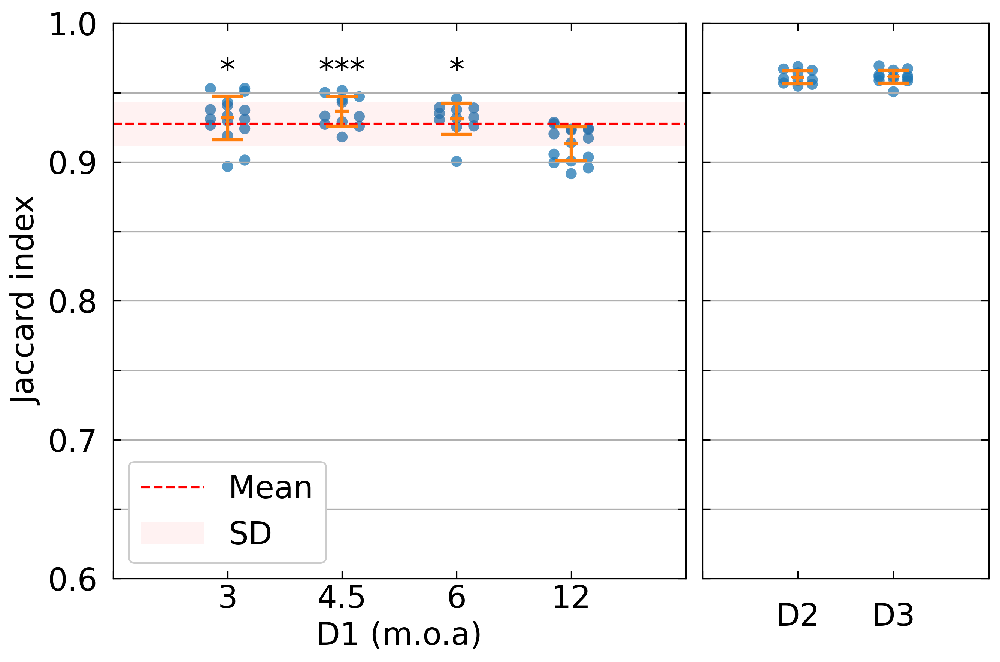

In [28]:

plot_mean_per_subject(jaccard_values_3,jaccard_values_4_5,jaccard_values_6,jaccard_values_12,
                      jaccard_values_d2,jaccard_values_d3,y_under_lim=0.6,stats="semi")


# 3. Box Analysis

In [29]:
def analyse_boxes(file, other_lab=False):
    """
    Analyze bounding boxes generated for a subject and compare them against reference masks.
    
    Parameters:
    - file (str): File name of the subject image.
    - other_lab (bool): If True, uses alternate configurations and paths for reference masks (D2 and D3 images).

    Outputs:
    Displays overlayed bounding boxes and prints evaluation metrics.
    """
    # Load subject image
    subject = nib.load(pjoin(subjects_path, file)).get_fdata()
    
    # Set parameters and generate bounding boxes
    median_radius, numpass = (1, 3) if other_lab else (2, 5)
    boxes, mask_otsu = generate_boxes(file, median_radius, numpass)
    
    # Determine reference mask path
    ref_path = (
        f'manual_masks/{file[:-7]}_mask.nii.gz' if other_lab and subjects_path == subjects_path_d2 else
        f'manual_masks/{file[:-16]}_mask.nii' if other_lab else
        f'manual_masks/{file[:7]}_mask_{file[17:-4]}.nii'
    )
    ref_mask = nib.load(pjoin(subjects_path, ref_path)).get_fdata()
    if len(ref_mask.shape) > 3:
        ref_mask = np.squeeze(ref_mask, axis=-1)
    
    # Initialize evaluation metrics
    accuracies, jaccards, dices = [], [], []
    
    # Iterate through slices
    for slice_index in range(subject.shape[2]):
        # Prepare image and reference mask for visualization
        image = cv2.cvtColor(
            ((np.rot90(subject[:, :, slice_index]) / np.max(subject)) * 255).astype(np.uint8), 
            cv2.COLOR_GRAY2RGB
        )
        ref_mask_image = np.rot90(ref_mask[:, :, slice_index])
        
        # Generate reference box mask
        indices = np.argwhere(ref_mask_image != 0)
        ref_box_mask = np.zeros_like(ref_mask_image)
        if np.any(indices):
            yu, xl = np.min(indices, axis=0)
            yd, xr = np.max(indices, axis=0)
            ref_box_mask[yu:yd, xl:xr] = 1

        # Generate SAM box mask
        box = np.array(boxes[slice_index])
        box_mask = np.zeros_like(ref_mask_image)
        box_mask[round(box[1]):round(box[3]), round(box[0]):round(box[2])] = 1
        
        # Evaluate performance
        if (other_lab and subjects_path == subjects_path_d2 and 1 <= slice_index < 20) or \
           (other_lab and subjects_path == subjects_path_d3 and 4 <= slice_index < 46) or \
           not other_lab:
            evaluate(box_mask, ref_box_mask, slice_index, accuracies, jaccards, dices)

        # Visualize results
        plt.figure(dpi=70)
        plt.title(f"Slice #{slice_index+1}")
        plt.imshow(image)
        plt.axis('off')
        show_mask(ref_box_mask, plt.gca(), manual=True)
        show_mask(box_mask, plt.gca())
        plt.show()
    
    # Compute and print evaluation metrics if applicable
    print("Subject mean performance metrics:")
    print(f"Accuracy:\t\t {round(sum(accuracies) / len(accuracies), 2)}%")
    print(f"Jaccard index:\t\t {round(sum(jaccards) / len(jaccards), 4)}")
    print(f"Dice coefficient:\t {round(sum(dices) / len(dices), 4)}")

    # Store per-slice metrics
    for i in range(len(accuracies)):
        accuracies_per_slice.append(accuracies[i])
        jaccards_per_slice.append(jaccards[i])
        dices_per_slice.append(dices[i])

    # Store mean metrics across slices
    mean_accuracies.append(round(sum(accuracies) / len(accuracies), 2))
    mean_jaccards.append(round(sum(jaccards) / len(jaccards), 4))
    mean_dices.append(round(sum(dices) / len(dices), 4))


## Results

#### 3 months

T2Wmice_first_im_A110123_3mo_.nii
T2Wmice_first_im_A120123_3mo_.nii
T2Wmice_first_im_A130123_3mo_.nii
T2Wmice_first_im_A160123_3mo_.nii
T2Wmice_first_im_A170123_3mo_.nii
T2Wmice_first_im_B110123_3mo_.nii
T2Wmice_first_im_B120123_3mo_.nii
T2Wmice_first_im_B130123_3mo_.nii
T2Wmice_first_im_B160123_3mo_.nii
T2Wmice_first_im_B170123_3mo_.nii
T2Wmice_first_im_C110123_3mo_.nii
T2Wmice_first_im_C120123_3mo_.nii
T2Wmice_first_im_C130123_3mo_.nii
T2Wmice_first_im_C160123_3mo_.nii
T2Wmice_first_im_D120123_3mo_.nii
T2Wmice_first_im_D160123_3mo_.nii
-------------------------------------------------
T2Wmice_first_im_A110123_3mo_.nii
Accuracy of slice #1: 79.23%


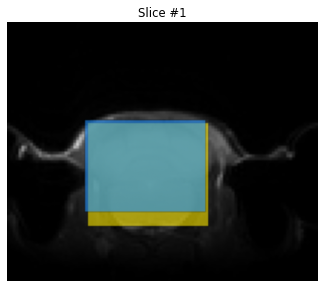

Accuracy of slice #2: 78.84%


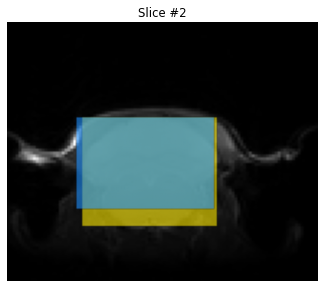

Accuracy of slice #3: 83.86%


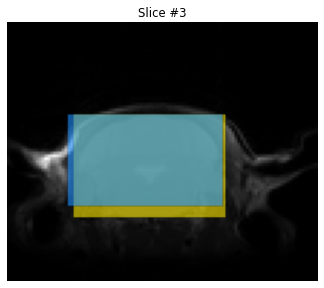

Accuracy of slice #4: 82.02%


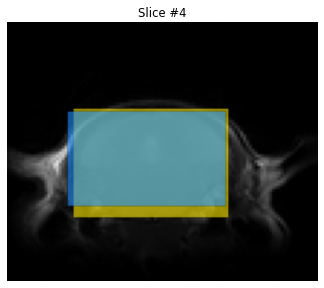

Accuracy of slice #5: 82.67%


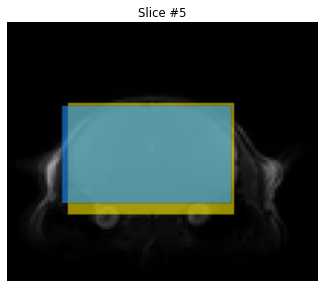

Accuracy of slice #6: 83.66%


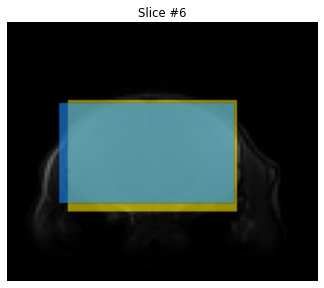

Accuracy of slice #7: 83.12%


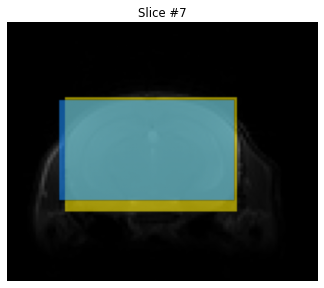

Accuracy of slice #8: 85.73%


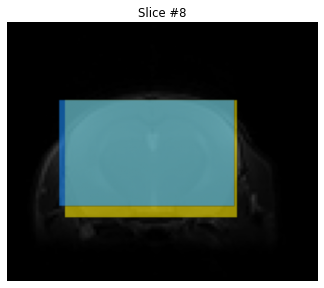

Accuracy of slice #9: 80.36%


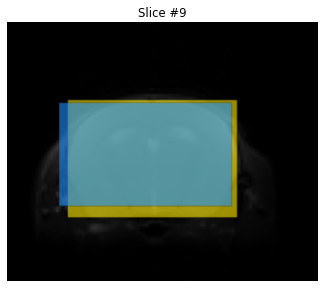

Accuracy of slice #10: 81.87%


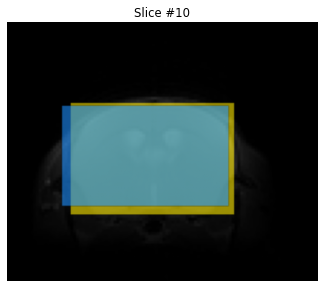

Accuracy of slice #11: 83.22%


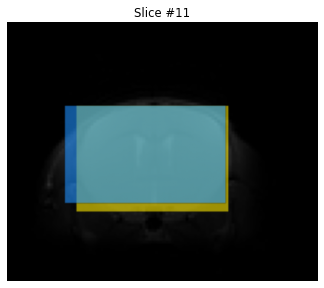

Accuracy of slice #12: 79.13%


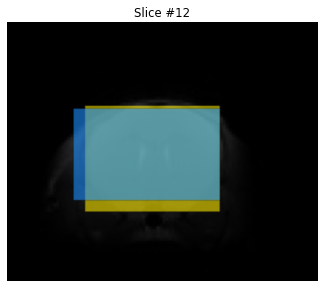

Accuracy of slice #13: 75.26%


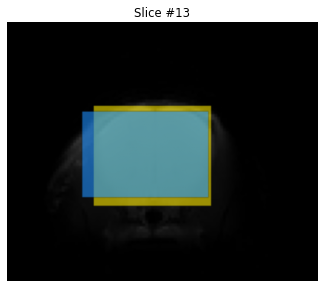

Accuracy of slice #14: 78.78999999999999%


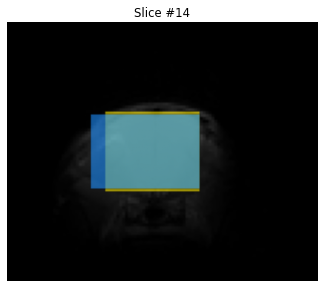

Accuracy of slice #15: 65.22%


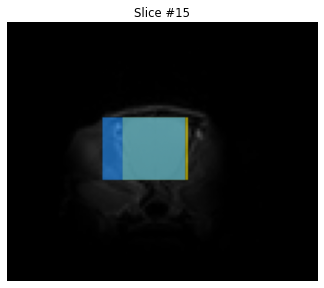

Accuracy of slice #16: 66.4%


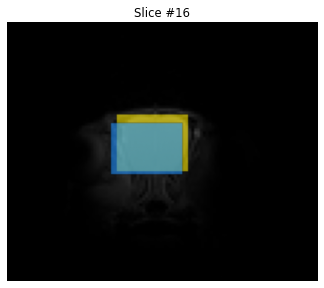

Subject mean performance metrics:
Accuracy:		 79.34%
Jaccard index:		 0.8091
Dice coefficient:	 0.8939
accuracy_values_box_3 = np.array([79.34])
jaccard_values_box_3 = np.array([0.8091])
dice_values_box_3 = np.array([0.8939])
accur_values_box_3 = np.array([79.23, 78.84, 83.86, 82.02, 82.67, 83.66, 83.12, 85.73, 80.36, 81.87, 83.22, 79.13, 75.26, 78.78999999999999, 65.22, 66.4])
jacc_values_box_3 = np.array([0.8019, 0.7957, 0.8438, 0.8258, 0.8318, 0.8437, 0.836, 0.8615, 0.812, 0.8269, 0.8431, 0.8056, 0.7717, 0.814, 0.7333, 0.6995])
dic_values_box_3 = np.array([0.8901, 0.8862, 0.9153, 0.9046, 0.9082, 0.9152, 0.9107, 0.9256, 0.8963, 0.9052, 0.9149, 0.8923, 0.8711, 0.8975, 0.8462, 0.8232])


In [30]:
files = []
subjects_path, output_path = subjects_path_3, pjoin(output_path_base,"3_months")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.startswith("T2Wmice_first_im") and file.endswith("nii"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

initial_slice = 4
final_slice   = 33

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    analyse_boxes(file)

print(f"accuracy_values_box_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_box_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_box_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_box_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_box_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_box_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

#### 4.5 months

T2Wmice_first_im_A080323_4.5mo_.nii
T2Wmice_first_im_A090323_4.5mo_.nii
T2Wmice_first_im_A100323_4.5mo_.nii
T2Wmice_first_im_A130323_4.5mo_.nii
T2Wmice_first_im_A140323_4.5mo_.nii
T2Wmice_first_im_B090323_4.5mo_.nii
T2Wmice_first_im_B100323_4.5mo_.nii
T2Wmice_first_im_B130323_4.5mo_.nii
T2Wmice_first_im_C080323_4.5mo_.nii
T2Wmice_first_im_C090323_4.5mo_.nii
T2Wmice_first_im_C100323_4.5mo_.nii
-------------------------------------------------
T2Wmice_first_im_A080323_4.5mo_.nii
Accuracy of slice #1: 76.12%


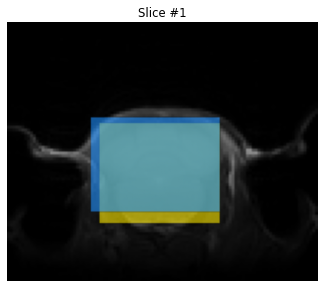

Accuracy of slice #2: 76.6%


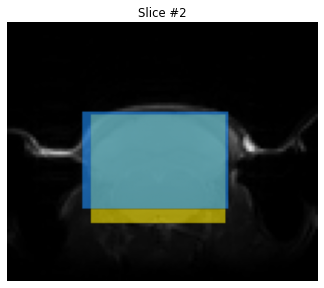

Accuracy of slice #3: 79.42%


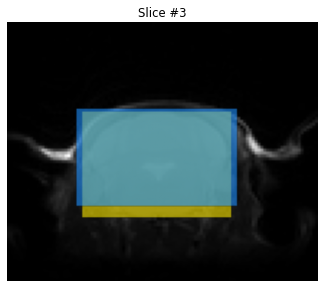

Accuracy of slice #4: 81.16%


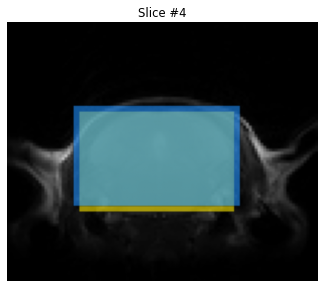

Accuracy of slice #5: 82.94%


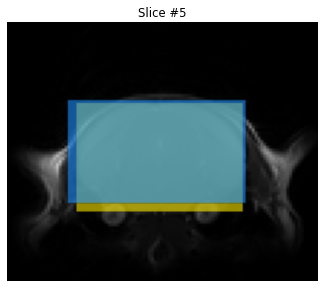

Accuracy of slice #6: 85.61%


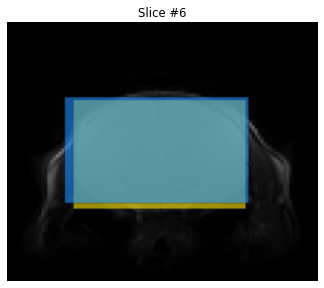

Accuracy of slice #7: 83.42%


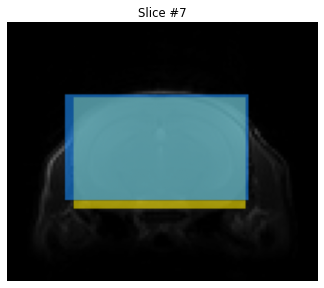

Accuracy of slice #8: 83.9%


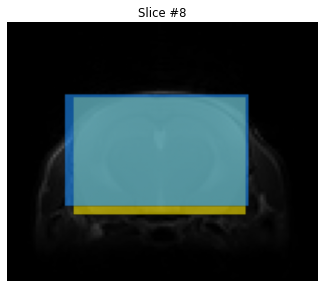

Accuracy of slice #9: 83.56%


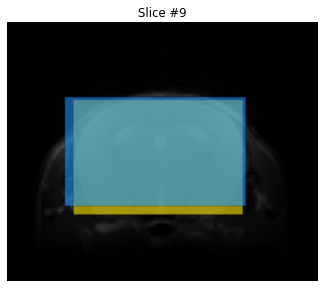

Accuracy of slice #10: 88.21000000000001%


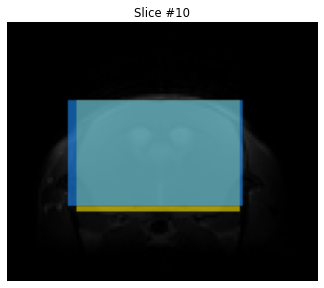

Accuracy of slice #11: 84.68%


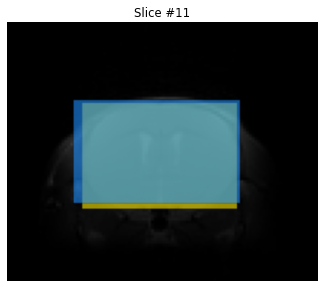

Accuracy of slice #12: 81.18%


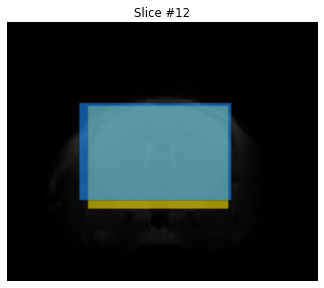

Accuracy of slice #13: 82.92%


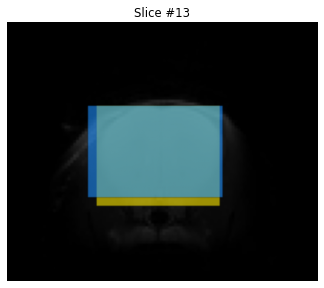

Accuracy of slice #14: 88.28999999999999%


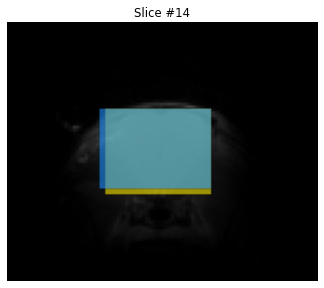

Accuracy of slice #15: 67.75%


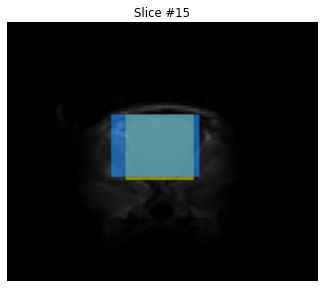

Accuracy of slice #16: 87.08%


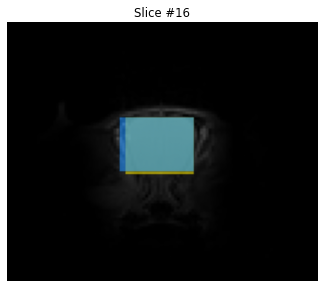

Subject mean performance metrics:
Accuracy:		 82.05%
Jaccard index:		 0.8388
Dice coefficient:	 0.9119
accuracy_values_box_4_5 = np.array([82.05])
jaccard_values_box_4_5 = np.array([0.8388])
dice_values_box_4_5 = np.array([0.9119])
accur_values_box_4_5 = np.array([76.12, 76.6, 79.42, 81.16, 82.94, 85.61, 83.42, 83.9, 83.56, 88.21000000000001, 84.68, 81.18, 82.92, 88.28999999999999, 67.75, 87.08])
jacc_values_box_4_5 = np.array([0.7877, 0.7877, 0.8125, 0.8335, 0.8437, 0.8682, 0.8477, 0.852, 0.8491, 0.8895, 0.8607, 0.8297, 0.8426, 0.8885, 0.7479, 0.8803])
dic_values_box_4_5 = np.array([0.8812, 0.8812, 0.8966, 0.9092, 0.9152, 0.9294, 0.9176, 0.9201, 0.9184, 0.9415, 0.9251, 0.9069, 0.9146, 0.941, 0.8558, 0.9363])


In [31]:
files = []
subjects_path, output_path = subjects_path_4_5, pjoin(output_path_base,"4_5_months")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.startswith("T2Wmice_first_im") and file.endswith("nii"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

initial_slice = 4
final_slice   = 33

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    analyse_boxes(file)

print(f"accuracy_values_box_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_box_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_box_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_box_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_box_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_box_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

#### 6 months

T2Wmice_first_im_A250423_6mo_.nii
T2Wmice_first_im_A260423_6mo_.nii
T2Wmice_first_im_A270423_6mo_.nii
T2Wmice_first_im_A280423_6mo_.nii
T2Wmice_first_im_B250423_6mo_.nii
T2Wmice_first_im_B260423_6mo_.nii
T2Wmice_first_im_B270423_6mo_.nii
T2Wmice_first_im_B280423_6mo_.nii
T2Wmice_first_im_C250423_6mo_.nii
T2Wmice_first_im_C260423_6mo_.nii
T2Wmice_first_im_C270423_6mo_.nii
-------------------------------------------------
T2Wmice_first_im_A250423_6mo_.nii
Accuracy of slice #1: 69.48%


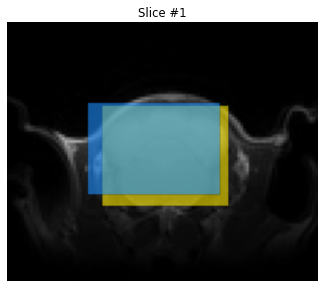

Accuracy of slice #2: 80.0%


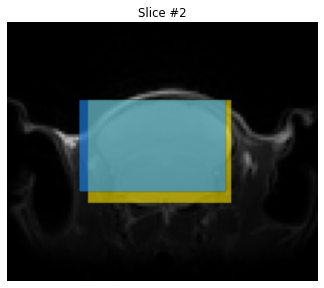

Accuracy of slice #3: 71.7%


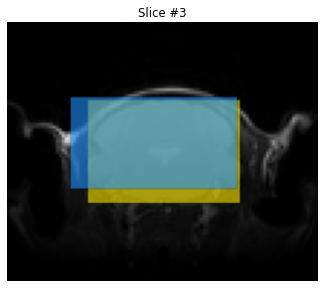

Accuracy of slice #4: 77.49%


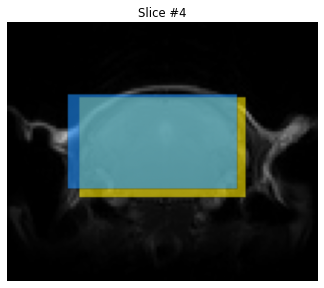

Accuracy of slice #5: 75.68%


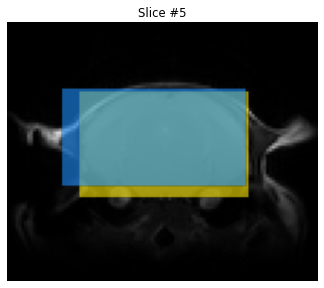

Accuracy of slice #6: 78.26%


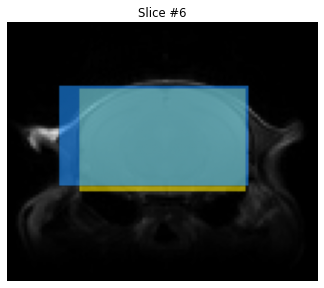

Accuracy of slice #7: 75.91%


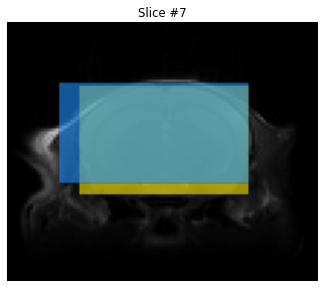

Accuracy of slice #8: 75.28999999999999%


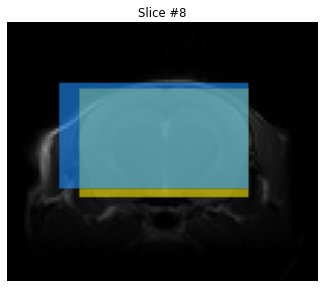

Accuracy of slice #9: 76.03999999999999%


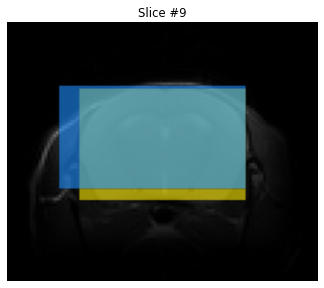

Accuracy of slice #10: 77.36%


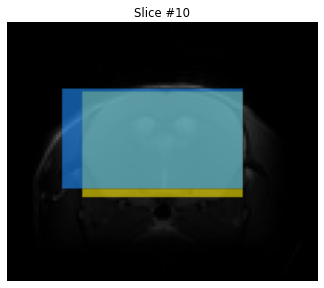

Accuracy of slice #11: 70.86%


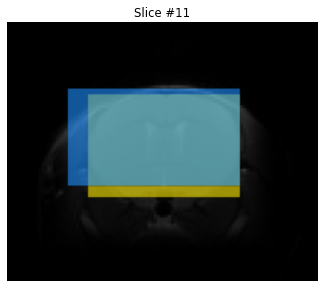

Accuracy of slice #12: 70.15%


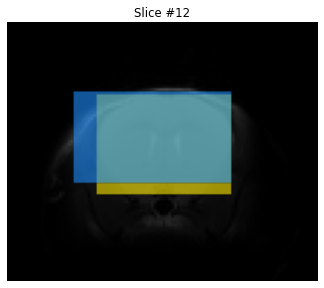

Accuracy of slice #13: 74.19%


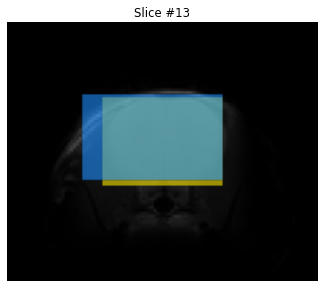

Accuracy of slice #14: 62.65%


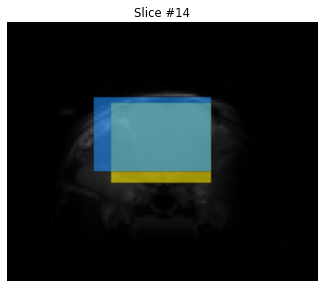

Accuracy of slice #15: 33.730000000000004%


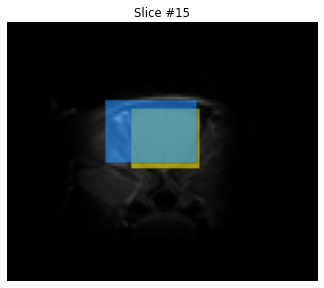

Accuracy of slice #16: 64.81%


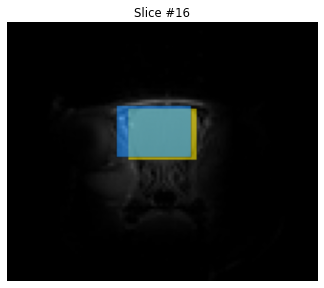

Subject mean performance metrics:
Accuracy:		 70.85%
Jaccard index:		 0.7566
Dice coefficient:	 0.86
accuracy_values_box_6 = np.array([70.85])
jaccard_values_box_6 = np.array([0.7566])
dice_values_box_6 = np.array([0.86])
accur_values_box_6 = np.array([69.48, 80.0, 71.7, 77.49, 75.68, 78.26, 75.91, 75.28999999999999, 76.03999999999999, 77.36, 70.86, 70.15, 74.19, 62.65, 33.730000000000004, 64.81])
jacc_values_box_6 = np.array([0.73, 0.8101, 0.7491, 0.7939, 0.7828, 0.8129, 0.7879, 0.7885, 0.7893, 0.8024, 0.7531, 0.7479, 0.7838, 0.6965, 0.5668, 0.711])
dic_values_box_6 = np.array([0.844, 0.8951, 0.8565, 0.8851, 0.8782, 0.8968, 0.8814, 0.8817, 0.8822, 0.8903, 0.8592, 0.8558, 0.8788, 0.8211, 0.7235, 0.8311])


In [32]:
files = []
subjects_path, output_path = subjects_path_6, pjoin(output_path_base,"6_months")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.startswith("T2Wmice_first_im") and file.endswith("nii"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

initial_slice = 4
final_slice   = 33

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    analyse_boxes(file)

print(f"accuracy_values_box_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_box_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_box_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_box_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_box_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_box_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

#### 12 months

T2Wmice_first_im_A030222_12mo_.nii
T2Wmice_first_im_A070222_12mo_.nii
T2Wmice_first_im_A080222_12mo_.nii
T2Wmice_first_im_A090222_12mo_.nii
T2Wmice_first_im_A100222_12mo_.nii
T2Wmice_first_im_A250222_12mo_.nii
T2Wmice_first_im_B030222_12mo_.nii
T2Wmice_first_im_B070222_12mo_.nii
T2Wmice_first_im_B080222_12mo_.nii
T2Wmice_first_im_B090222_12mo_.nii
T2Wmice_first_im_B100222_12mo_.nii
T2Wmice_first_im_C070222_12mo_.nii
T2Wmice_first_im_C080222_12mo_.nii
T2Wmice_first_im_C090222_12mo_.nii
T2Wmice_first_im_C100222_12mo_.nii
-------------------------------------------------
T2Wmice_first_im_A030222_12mo_.nii
Accuracy of slice #1: 74.42%


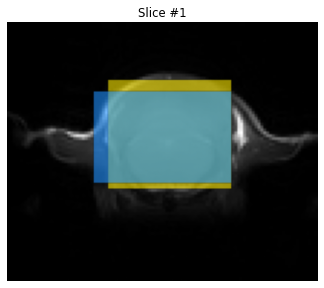

Accuracy of slice #2: 77.27%


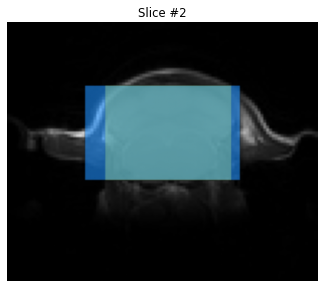

Accuracy of slice #3: 65.59%


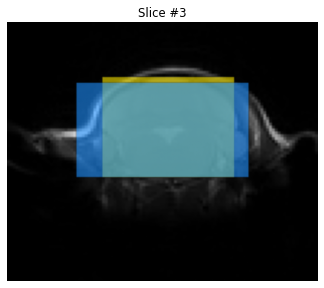

Accuracy of slice #4: 68.09%


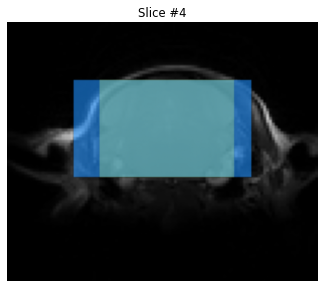

Accuracy of slice #5: 70.45%


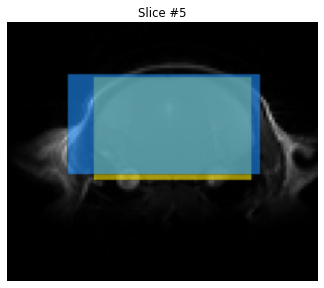

Accuracy of slice #6: 78.84%


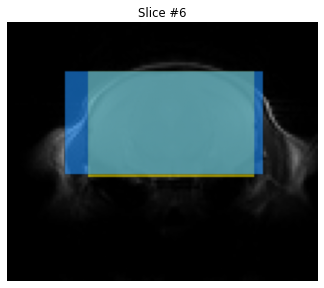

Accuracy of slice #7: 74.8%


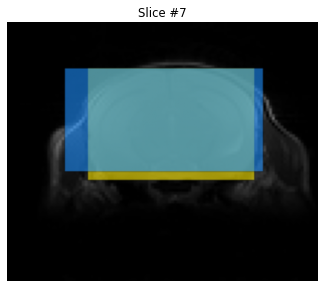

Accuracy of slice #8: 76.98%


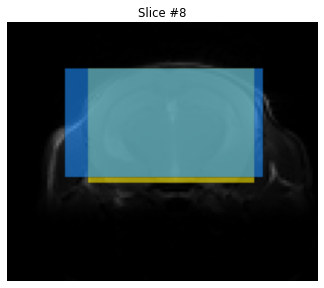

Accuracy of slice #9: 76.55%


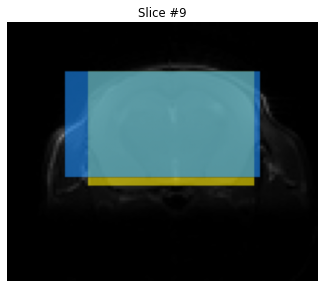

Accuracy of slice #10: 77.73%


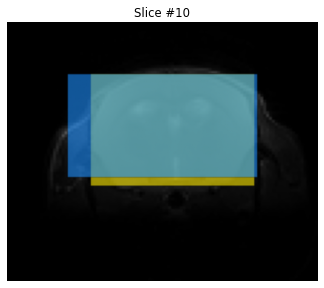

Accuracy of slice #11: 75.43%


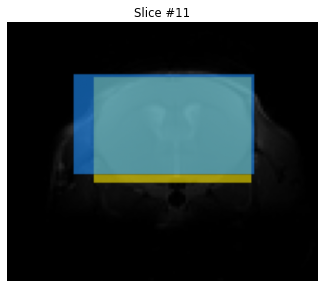

Accuracy of slice #12: 67.46000000000001%


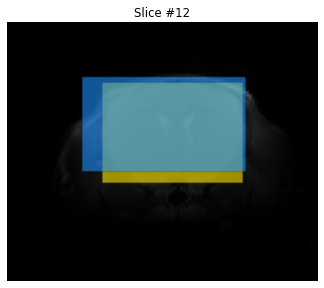

Accuracy of slice #13: 67.05%


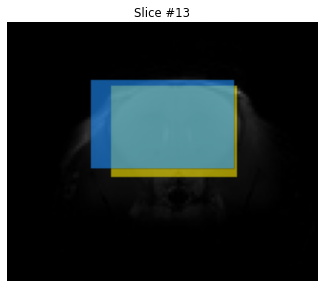

Accuracy of slice #14: 58.79%


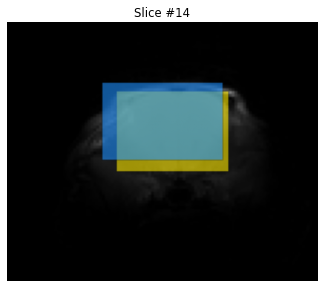

Accuracy of slice #15: 36.43%


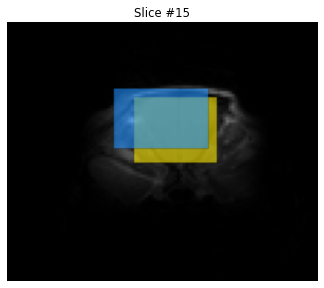

Accuracy of slice #16: 23.900000000000006%


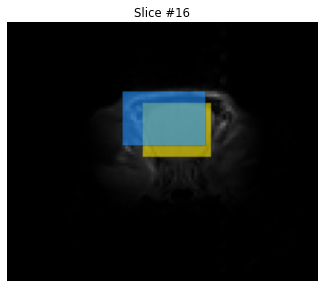

Subject mean performance metrics:
Accuracy:		 66.86%
Jaccard index:		 0.7359
Dice coefficient:	 0.844
accuracy_values_box_12 = np.array([66.86])
jaccard_values_box_12 = np.array([0.7359])
dice_values_box_12 = np.array([0.844])
accur_values_box_12 = np.array([74.42, 77.27, 65.59, 68.09, 70.45, 78.84, 74.8, 76.98, 76.55, 77.73, 75.43, 67.46000000000001, 67.05, 58.79, 36.43, 23.900000000000006])
jacc_values_box_12 = np.array([0.767, 0.8148, 0.7326, 0.7581, 0.7617, 0.8214, 0.7856, 0.805, 0.7978, 0.8057, 0.789, 0.7313, 0.7288, 0.6637, 0.5247, 0.4874])
dic_values_box_12 = np.array([0.8681, 0.898, 0.8457, 0.8624, 0.8647, 0.9019, 0.8799, 0.8919, 0.8875, 0.8924, 0.8821, 0.8448, 0.8431, 0.7978, 0.6882, 0.6554])


In [33]:
files = []
subjects_path, output_path = subjects_path_12, pjoin(output_path_base,"12_months")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.startswith("T2Wmice_first_im") and file.endswith("nii"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

initial_slice = 4
final_slice   = 33

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    analyse_boxes(file)

print(f"accuracy_values_box_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_box_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_box_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_box_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_box_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_box_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

#### D2

5463_t2.nii_flip.nii.gz
5471_t2.nii_flip.nii.gz
5472_t2.nii_flip.nii.gz
6085_t2.nii_flip.nii.gz
6087_t2.nii_flip.nii.gz
6088_t2.nii_flip.nii.gz
6092_t2.nii_flip.nii.gz
6093_t2.nii_flip.nii.gz
6287_t2.nii_flip.nii.gz
6289_t2.nii_flip.nii.gz
-------------------------------------------------
5463_t2.nii_flip.nii.gz


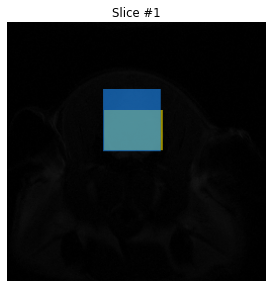

Accuracy of slice #2: 84.33%


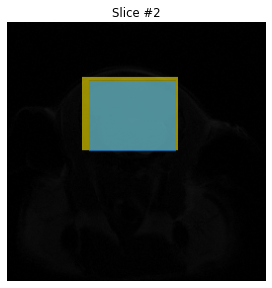

Accuracy of slice #3: 89.71000000000001%


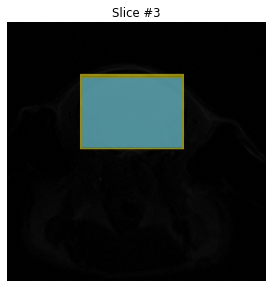

Accuracy of slice #4: 91.37%


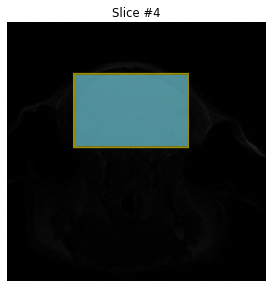

Accuracy of slice #5: 91.74%


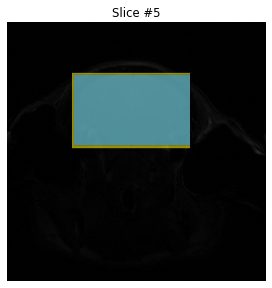

Accuracy of slice #6: 88.95%


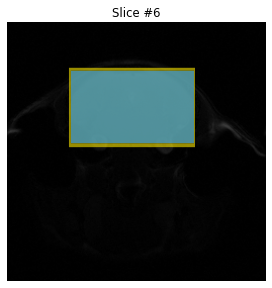

Accuracy of slice #7: 96.68%


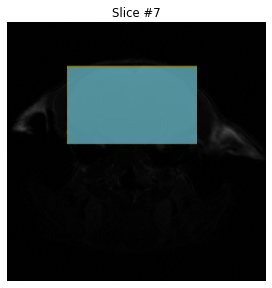

Accuracy of slice #8: 95.99%


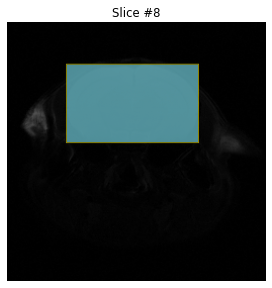

Accuracy of slice #9: 92.48%


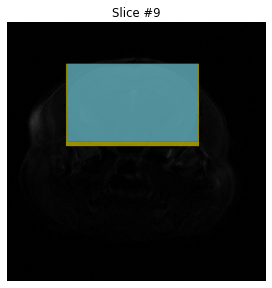

Accuracy of slice #10: 96.39%


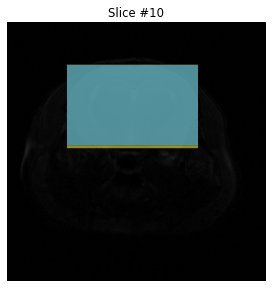

Accuracy of slice #11: 94.44%


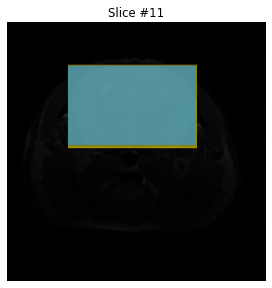

Accuracy of slice #12: 93.95%


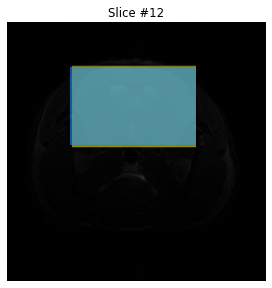

Accuracy of slice #13: 96.54%


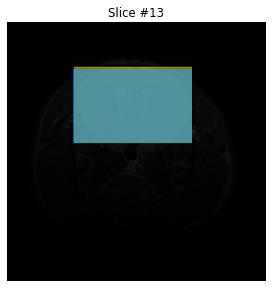

Accuracy of slice #14: 92.06%


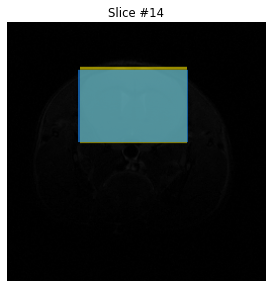

Accuracy of slice #15: 93.49%


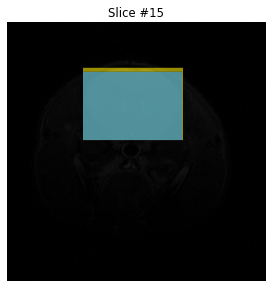

Accuracy of slice #16: 89.55%


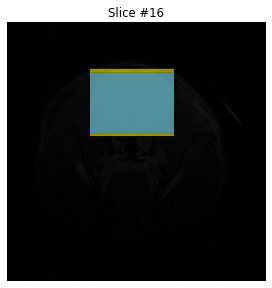

Accuracy of slice #17: 77.39%


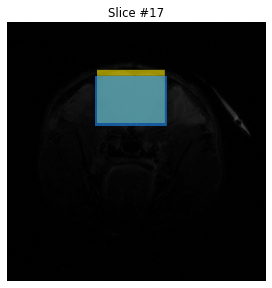

Accuracy of slice #18: 80.63%


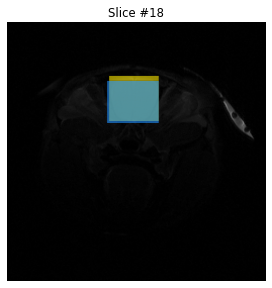

Accuracy of slice #19: 78.58%


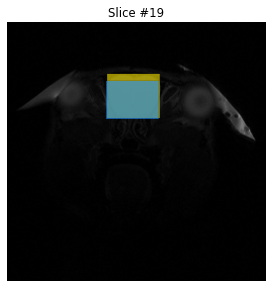

Accuracy of slice #20: 66.71000000000001%


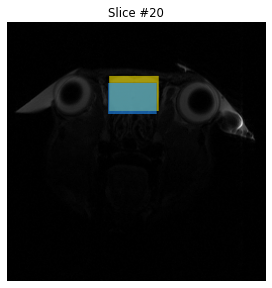

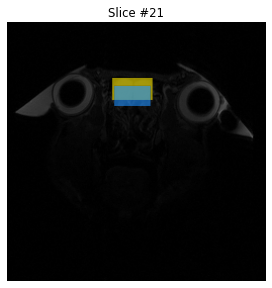

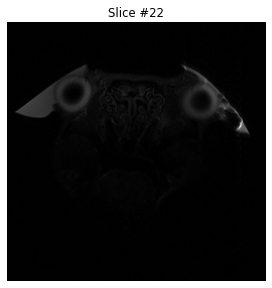

Subject mean performance metrics:
Accuracy:		 89.0%
Jaccard index:		 0.8943
Dice coefficient:	 0.9426
accuracy_values_box_d2 = np.array([89.0])
jaccard_values_box_d2 = np.array([0.8943])
dice_values_box_d2 = np.array([0.9426])
accur_values_box_d2 = np.array([84.33, 89.71000000000001, 91.37, 91.74, 88.95, 96.68, 95.99, 92.48, 96.39, 94.44, 93.95, 96.54, 92.06, 93.49, 89.55, 77.39, 80.63, 78.58, 66.71000000000001])
jacc_values_box_d2 = np.array([0.8452, 0.8971, 0.9137, 0.9174, 0.8895, 0.9668, 0.9599, 0.9248, 0.9639, 0.9444, 0.9404, 0.9656, 0.9226, 0.9349, 0.8955, 0.7968, 0.8211, 0.7939, 0.6974])
dic_values_box_d2 = np.array([0.9161, 0.9458, 0.9549, 0.9569, 0.9415, 0.9831, 0.9795, 0.9609, 0.9816, 0.9714, 0.9693, 0.9825, 0.9598, 0.9664, 0.9449, 0.8869, 0.9018, 0.8851, 0.8217])


In [34]:
files = []
subjects_path, output_path = subjects_path_d2, pjoin(output_path_base,"d2")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.endswith("flip.nii.gz"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

initial_slice = 2
final_slice   = 39

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    analyse_boxes(file,other_lab=True)

print(f"accuracy_values_box_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_box_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_box_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_box_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_box_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_box_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

#### D3

20190227_105648_AE0818_rs_Control_11_1_1_T2w.nii_flip.nii.gz
20190227_120644_AE0818_rs_Control_12_1_1_T2w.nii_flip.nii.gz
20190227_125730_AE0818_rs_Control_13_1_1_T2w.nii_flip.nii.gz
20190228_081325_AE0818_rs_Control_14_1_1_T2w.nii_flip.nii.gz
20190228_093749_AE0818_rs_Control_21_1_1_T2w.nii_flip.nii.gz
20190228_103014_AE0818_rs_Control_15_1_1_T2w.nii_flip.nii.gz
20190311_083410_AE0818_rs_Control_11_1_2_T2w.nii_flip.nii.gz
20190311_095840_AE0818_rs_Control_12_1_2_T2w.nii_flip.nii.gz
20190311_105918_AE0818_rs_Control_13_1_2_T2w.nii_flip.nii.gz
20190311_115813_AE0818_rs_Control_14_1_2_T2w.nii_flip.nii.gz
20190311_125036_AE0818_rs_Control_15_1_2_T2w.nii_flip.nii.gz
20190311_143920_AE0818_rs_Control_21_1_2_T2w.nii_flip.nii.gz
-------------------------------------------------
20190227_105648_AE0818_rs_Control_11_1_1_T2w.nii_flip.nii.gz


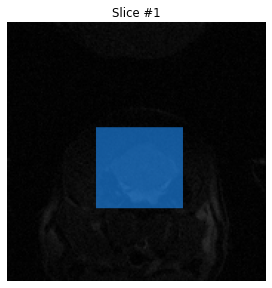

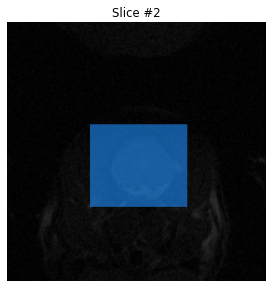

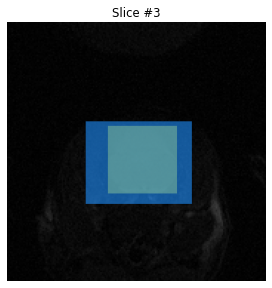

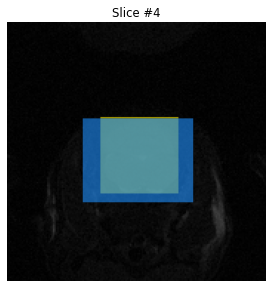

Accuracy of slice #5: 60.57%


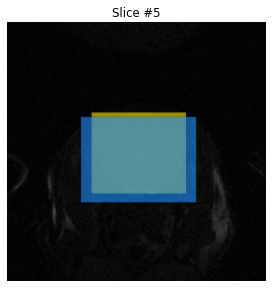

Accuracy of slice #6: 60.83%


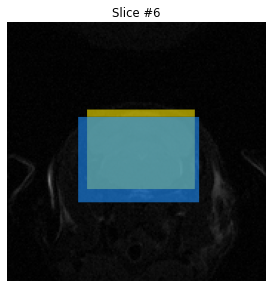

Accuracy of slice #7: 64.82%


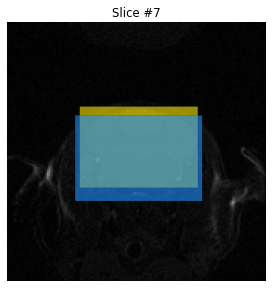

Accuracy of slice #8: 71.28999999999999%


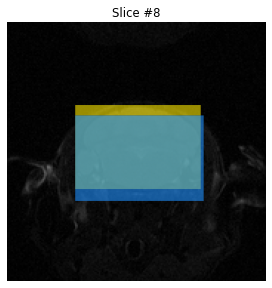

Accuracy of slice #9: 74.14%


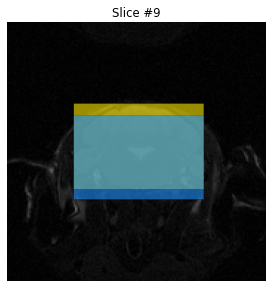

Accuracy of slice #10: 71.69%


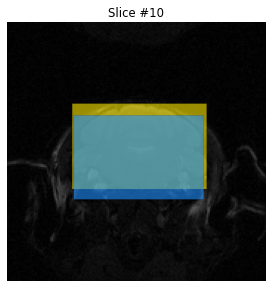

Accuracy of slice #11: 76.73%


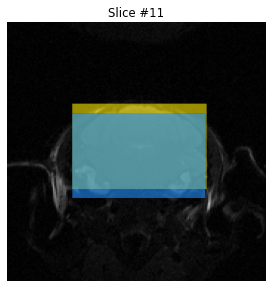

Accuracy of slice #12: 77.28999999999999%


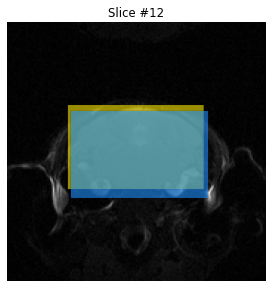

Accuracy of slice #13: 82.48%


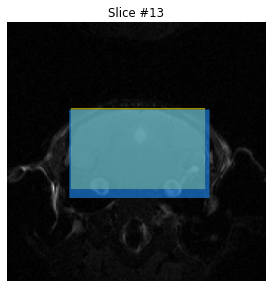

Accuracy of slice #14: 83.45%


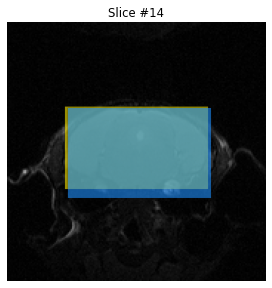

Accuracy of slice #15: 87.68%


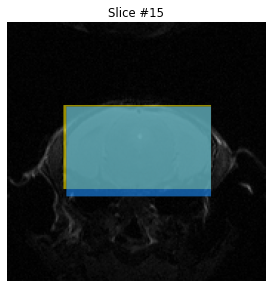

Accuracy of slice #16: 88.64%


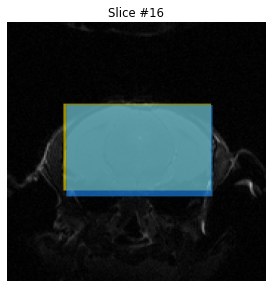

Accuracy of slice #17: 93.22%


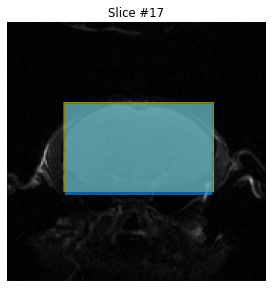

Accuracy of slice #18: 91.61%


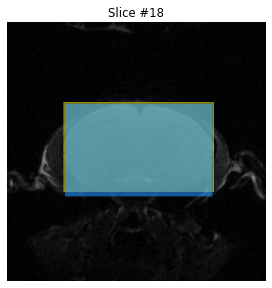

Accuracy of slice #19: 95.02%


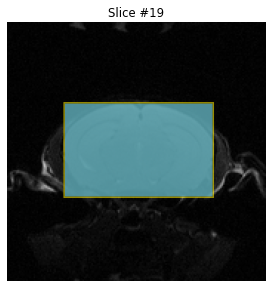

Accuracy of slice #20: 94.98%


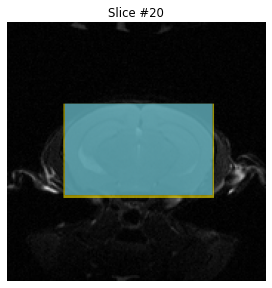

Accuracy of slice #21: 95.02%


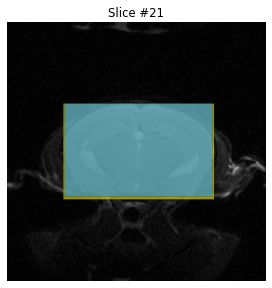

Accuracy of slice #22: 92.74%


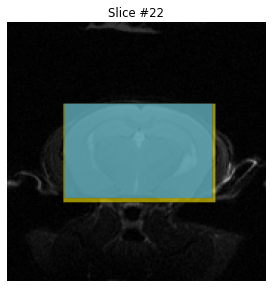

Accuracy of slice #23: 95.11%


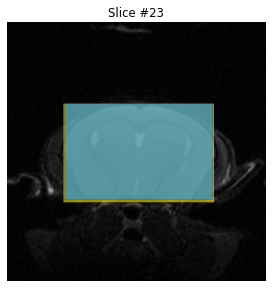

Accuracy of slice #24: 95.02%


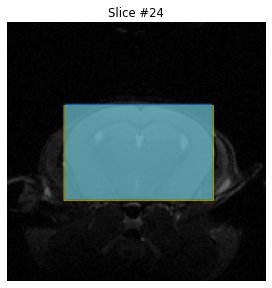

Accuracy of slice #25: 96.49%


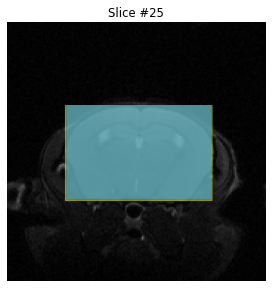

Accuracy of slice #26: 94.94%


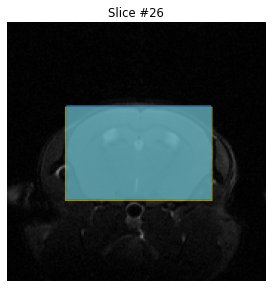

Accuracy of slice #27: 95.24%


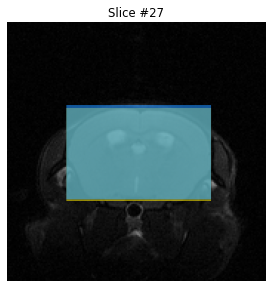

Accuracy of slice #28: 98.39%


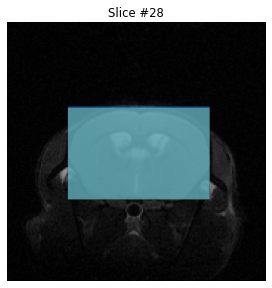

Accuracy of slice #29: 91.02%


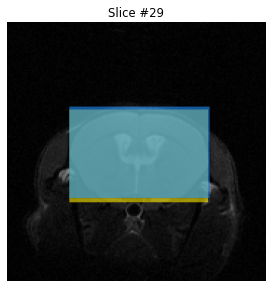

Accuracy of slice #30: 87.85%


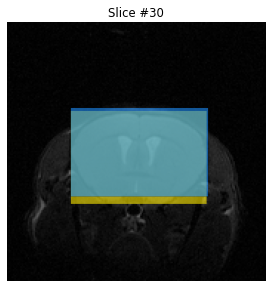

Accuracy of slice #31: 83.59%


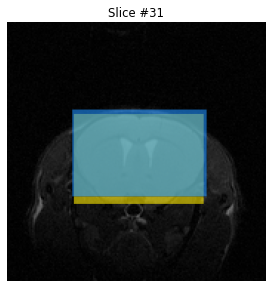

Accuracy of slice #32: 81.01%


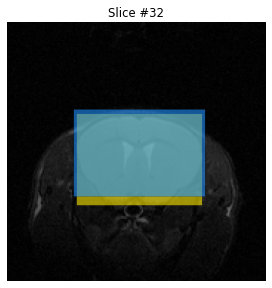

Accuracy of slice #33: 82.38%


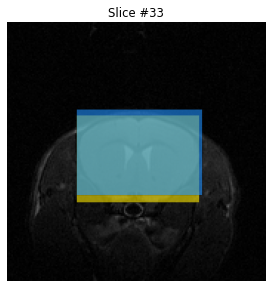

Accuracy of slice #34: 79.38%


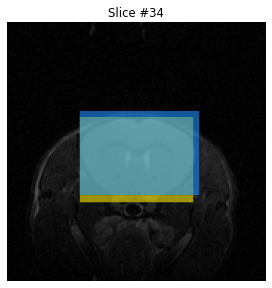

Accuracy of slice #35: 84.74%


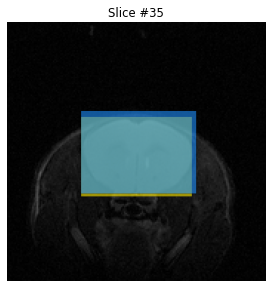

Accuracy of slice #36: 83.8%


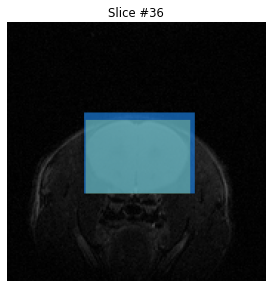

Accuracy of slice #37: 75.0%


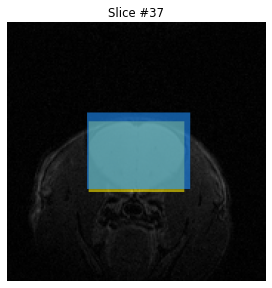

Accuracy of slice #38: 73.3%


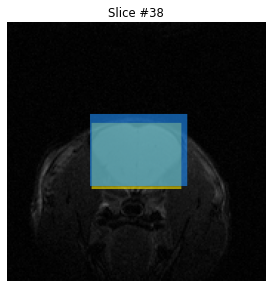

Accuracy of slice #39: 71.34%


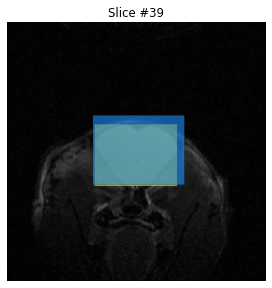

Accuracy of slice #40: 50.2%


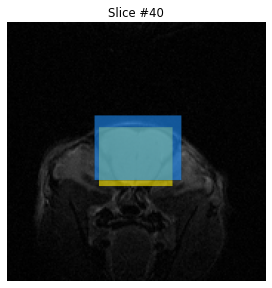

Accuracy of slice #41: 33.08%


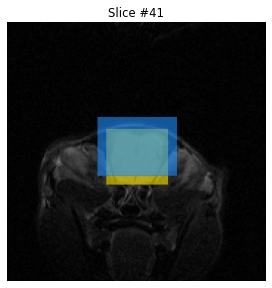

Accuracy of slice #42: 17.879999999999995%


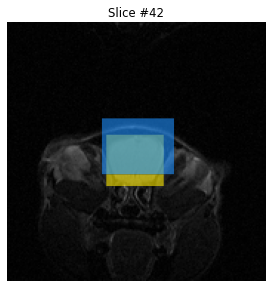

Accuracy of slice #43: 43.74%


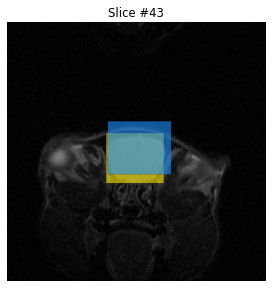

Accuracy of slice #44: 46.72%


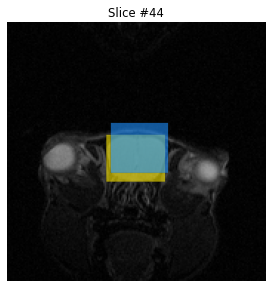

Accuracy of slice #45: 45.24%


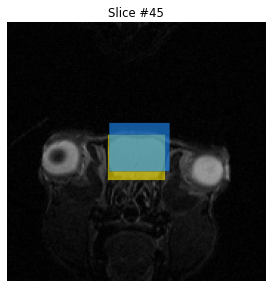

Accuracy of slice #46: 27.58%


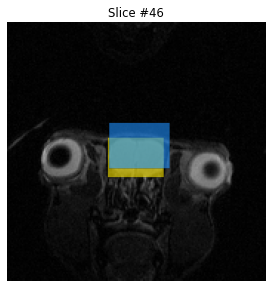

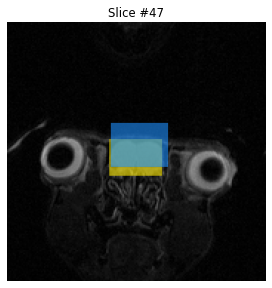

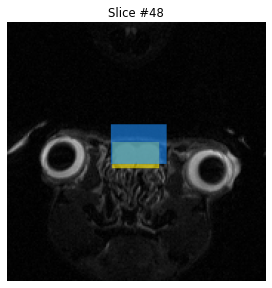

Subject mean performance metrics:
Accuracy:		 76.08%
Jaccard index:		 0.8097
Dice coefficient:	 0.8883
accuracy_values_box_d3 = np.array([76.08])
jaccard_values_box_d3 = np.array([0.8097])
dice_values_box_d3 = np.array([0.8883])
accur_values_box_d3 = np.array([60.57, 60.83, 64.82, 71.28999999999999, 74.14, 71.69, 76.73, 77.28999999999999, 82.48, 83.45, 87.68, 88.64, 93.22, 91.61, 95.02, 94.98, 95.02, 92.74, 95.11, 95.02, 96.49, 94.94, 95.24, 98.39, 91.02, 87.85, 83.59, 81.01, 82.38, 79.38, 84.74, 83.8, 75.0, 73.3, 71.34, 50.2, 33.08, 17.879999999999995, 43.74, 46.72, 45.24, 27.58])
jacc_values_box_d3 = np.array([0.7057, 0.6985, 0.7169, 0.7534, 0.7692, 0.7465, 0.7889, 0.8002, 0.8486, 0.8532, 0.8866, 0.8946, 0.9343, 0.92, 0.9502, 0.9498, 0.9502, 0.9274, 0.9511, 0.951, 0.9649, 0.9501, 0.9538, 0.9841, 0.9138, 0.8834, 0.8483, 0.8262, 0.8385, 0.8159, 0.8632, 0.8606, 0.7931, 0.7816, 0.7731, 0.6438, 0.5572, 0.4844, 0.5878, 0.5852, 0.5893, 0.5112])
dic_values_box_d3 = np.array([0.8274, 0.8225, 

In [35]:
files = []
subjects_path, output_path = subjects_path_d3, pjoin(output_path_base,"d3")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.endswith("flip.nii.gz"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

initial_slice = 3
final_slice   = 35

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    analyse_boxes(file,other_lab=True)

print(f"accuracy_values_box_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_box_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_box_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_box_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_box_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_box_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

## Evaluation metrics

In [36]:
accuracy_values_box_3 = np.array([79.34, 68.39, 74.37, 70.01, 77.69, 72.86, 74.5, 70.14, 76.39, 81.73, 81.59, 74.63, 77.38, 79.19, 76.52, 75.94])
jaccard_values_box_3 = np.array([0.8091, 0.7515, 0.7864, 0.7518, 0.797, 0.7633, 0.7766, 0.7618, 0.7982, 0.8289, 0.8278, 0.7824, 0.8041, 0.8116, 0.7977, 0.7964])
dice_values_box_3 = np.array([0.8939, 0.8529, 0.8794, 0.8557, 0.8853, 0.8639, 0.8708, 0.8613, 0.8861, 0.9057, 0.905, 0.8763, 0.89, 0.8948, 0.8858, 0.885])
accur_values_box_3 = np.array([79.23, 78.84, 83.86, 82.02, 82.67, 83.66, 83.12, 85.73, 80.36, 81.87, 83.22, 79.13, 75.26, 78.78999999999999, 65.22, 66.4, 65.47999999999999, 64.75, 71.6, 76.28999999999999, 83.16, 87.18, 80.0, 85.0, 84.4, 90.63, 84.94, 78.88, 38.1, 7.909999999999997, 52.37, 43.61, 74.94, 76.83, 76.4, 77.53, 80.15, 78.95, 81.76, 80.53, 84.03, 81.68, 76.7, 74.97, 74.62, 63.51, 42.05, 65.34, 67.65, 65.97, 75.32, 74.22, 79.61, 82.16, 76.0, 79.27, 82.06, 87.69, 78.52, 77.83, 59.03, 15.219999999999999, 66.74000000000001, 52.81, 68.56, 76.12, 84.5, 76.85, 81.66, 80.0, 82.5, 85.68, 89.19, 94.29, 78.94, 73.41, 69.06, 48.73, 79.17, 74.34, 70.73, 71.91, 75.08, 75.85, 80.62, 78.88, 76.91, 80.06, 84.76, 84.62, 75.65, 71.43, 82.76, 28.569999999999993, 70.48, 57.42, 63.06, 63.15, 73.46000000000001, 72.22, 81.36, 85.62, 87.38, 89.88, 88.22, 87.24, 74.77, 77.68, 64.69, 31.819999999999993, 65.8, 85.71000000000001, 81.16, 73.93, 82.2, 81.17, 85.0, 85.14, 75.24, 80.26, 81.44, 77.53, 66.67, 65.94, 59.06, 43.61, 18.180000000000007, 65.78999999999999, 73.2, 69.43, 77.52, 82.53999999999999, 82.43, 88.83, 78.64, 86.18, 86.5, 87.72, 79.34, 82.35, 68.67, 41.97, 74.7, 62.22, 78.64, 76.87, 82.83, 79.56, 87.36, 84.62, 82.5, 85.99, 86.28, 85.89, 80.0, 80.58, 76.06, 72.83, 71.97, 95.65, 73.28999999999999, 83.33, 76.13, 82.53999999999999, 84.65, 87.22, 82.07, 84.08, 87.5, 93.48, 82.12, 78.28, 78.38, 71.31, 83.33, 77.8, 69.73, 75.92, 81.7, 82.36, 77.69, 80.95, 80.24, 81.22, 86.88, 80.67, 72.1, 73.53, 78.6, 27.200000000000003, 69.17, 76.19, 72.56, 76.35, 70.82, 81.31, 84.17, 87.42, 80.37, 84.31, 82.49, 85.03999999999999, 82.7, 79.01, 86.72, 39.13, 70.08, 75.6, 74.28, 77.67, 84.1, 81.5, 85.0, 86.17, 81.75, 88.2, 88.61, 88.95, 79.82, 73.75, 81.31, 53.21, 71.97, 70.68, 73.68, 79.16, 78.31, 80.85, 84.27, 83.2, 80.14, 87.13, 85.59, 85.5, 78.37, 74.01, 84.13, 32.7, 70.08, 67.14, 80.85, 79.43, 80.65, 84.5, 84.92, 87.42, 83.05, 82.8, 84.07, 81.68, 74.66, 72.73, 71.71000000000001, 39.13, 70.91, 56.46])
jacc_values_box_3 = np.array([0.8019, 0.7957, 0.8438, 0.8258, 0.8318, 0.8437, 0.836, 0.8615, 0.812, 0.8269, 0.8431, 0.8056, 0.7717, 0.814, 0.7333, 0.6995, 0.679, 0.6806, 0.7369, 0.7685, 0.8357, 0.875, 0.8095, 0.8571, 0.85, 0.9078, 0.8627, 0.8127, 0.6, 0.5206, 0.6445, 0.5833, 0.7781, 0.7886, 0.7883, 0.8018, 0.8216, 0.8132, 0.8307, 0.8221, 0.8522, 0.8338, 0.7973, 0.7846, 0.7976, 0.7326, 0.6211, 0.7195, 0.6765, 0.6838, 0.7595, 0.7422, 0.7961, 0.8261, 0.7656, 0.8025, 0.8326, 0.8845, 0.8142, 0.8044, 0.7094, 0.5412, 0.7407, 0.6497, 0.6856, 0.7612, 0.845, 0.7685, 0.8166, 0.8, 0.825, 0.8568, 0.8919, 0.9429, 0.8035, 0.7581, 0.7568, 0.6506, 0.8128, 0.776, 0.7073, 0.7259, 0.7544, 0.7585, 0.809, 0.7947, 0.7754, 0.8112, 0.8523, 0.8563, 0.785, 0.75, 0.8421, 0.5833, 0.754, 0.6537, 0.6306, 0.6399, 0.7346, 0.7222, 0.8136, 0.8562, 0.8738, 0.8988, 0.8841, 0.8745, 0.7726, 0.8024, 0.739, 0.5833, 0.7257, 0.875, 0.8186, 0.7632, 0.8383, 0.8282, 0.8609, 0.8642, 0.7752, 0.8238, 0.8362, 0.8078, 0.7273, 0.7166, 0.6881, 0.6296, 0.5, 0.7111, 0.7453, 0.7162, 0.7866, 0.8298, 0.8285, 0.8911, 0.7964, 0.8672, 0.8705, 0.8824, 0.8164, 0.8421, 0.7614, 0.6328, 0.7905, 0.7143, 0.7864, 0.7687, 0.8371, 0.7956, 0.8736, 0.8462, 0.825, 0.862, 0.867, 0.8634, 0.8205, 0.824, 0.7905, 0.7794, 0.7643, 0.9583, 0.7329, 0.8333, 0.7753, 0.8254, 0.8465, 0.8742, 0.8233, 0.8471, 0.8803, 0.9371, 0.8368, 0.7986, 0.8123, 0.7699, 0.8571, 0.7941, 0.6973, 0.7676, 0.8199, 0.8236, 0.7833, 0.815, 0.808, 0.8253, 0.8751, 0.8258, 0.7604, 0.7692, 0.8135, 0.5787, 0.755, 0.8, 0.7468, 0.7801, 0.7451, 0.8209, 0.8441, 0.878, 0.8112, 0.8515, 0.8344, 0.859, 0.8416, 0.809, 0.8759, 0.6216, 0.7613, 0.7857, 0.7428, 0.7767, 0.841, 0.815, 0.85, 0.8637, 0.8201, 0.8838, 0.8897, 0.8951, 0.815, 0.7656, 0.8378, 0.6719, 0.7643, 0.7532, 0.7432, 0.7916, 0.7957, 0.8085, 0.8427, 0.8343, 0.8119, 0.8752, 0.865, 0.8671, 0.8136, 0.7787, 0.8553, 0.5977, 0.7613, 0.7212, 0.8085, 0.8013, 0.8179, 0.8473, 0.8537, 0.8798, 0.8377, 0.8395, 0.8528, 0.8341, 0.7839, 0.7652, 0.7736, 0.6216, 0.7664, 0.6592])
dic_values_box_3 = np.array([0.8901, 0.8862, 0.9153, 0.9046, 0.9082, 0.9152, 0.9107, 0.9256, 0.8963, 0.9052, 0.9149, 0.8923, 0.8711, 0.8975, 0.8462, 0.8232, 0.8088, 0.81, 0.8485, 0.8691, 0.9105, 0.9333, 0.8947, 0.9231, 0.9189, 0.9517, 0.9263, 0.8967, 0.75, 0.6847, 0.7839, 0.7368, 0.8752, 0.8818, 0.8816, 0.89, 0.9021, 0.897, 0.9075, 0.9024, 0.9202, 0.9094, 0.8872, 0.8793, 0.8874, 0.8457, 0.7663, 0.8369, 0.807, 0.8122, 0.8633, 0.852, 0.8864, 0.9048, 0.8672, 0.8904, 0.9086, 0.9387, 0.8976, 0.8916, 0.83, 0.7023, 0.851, 0.7876, 0.8135, 0.8644, 0.916, 0.8691, 0.899, 0.8889, 0.9041, 0.9229, 0.9429, 0.9706, 0.891, 0.8624, 0.8616, 0.7883, 0.8968, 0.8739, 0.8286, 0.8412, 0.86, 0.8627, 0.8944, 0.8856, 0.8735, 0.8958, 0.9203, 0.9226, 0.8795, 0.8571, 0.9143, 0.7368, 0.8597, 0.7906, 0.7735, 0.7804, 0.847, 0.8387, 0.8972, 0.9225, 0.9327, 0.9467, 0.9385, 0.933, 0.8717, 0.8904, 0.8499, 0.7368, 0.841, 0.9333, 0.9003, 0.8657, 0.912, 0.906, 0.9253, 0.9272, 0.8733, 0.9034, 0.9108, 0.8937, 0.8421, 0.8349, 0.8152, 0.7727, 0.6667, 0.8312, 0.8541, 0.8346, 0.8805, 0.907, 0.9062, 0.9424, 0.8867, 0.9289, 0.9307, 0.9375, 0.8989, 0.9143, 0.8646, 0.7751, 0.883, 0.8333, 0.8805, 0.8692, 0.9113, 0.8862, 0.9325, 0.9167, 0.9041, 0.9259, 0.9288, 0.9267, 0.9014, 0.9035, 0.883, 0.876, 0.8664, 0.9787, 0.8458, 0.9091, 0.8734, 0.9043, 0.9169, 0.9329, 0.9031, 0.9172, 0.9363, 0.9675, 0.9111, 0.888, 0.8964, 0.87, 0.9231, 0.8852, 0.8216, 0.8685, 0.9011, 0.9032, 0.8785, 0.8981, 0.8938, 0.9043, 0.9334, 0.9046, 0.8639, 0.8696, 0.8971, 0.7331, 0.8604, 0.8889, 0.855, 0.8765, 0.8539, 0.9016, 0.9154, 0.9351, 0.8957, 0.9198, 0.9097, 0.9241, 0.914, 0.8944, 0.9339, 0.7667, 0.8645, 0.88, 0.8524, 0.8743, 0.9136, 0.8981, 0.9189, 0.9269, 0.9011, 0.9383, 0.9416, 0.9446, 0.8981, 0.8672, 0.9117, 0.8038, 0.8664, 0.8592, 0.8527, 0.8837, 0.8862, 0.8941, 0.9147, 0.9097, 0.8962, 0.9334, 0.9276, 0.9288, 0.8972, 0.8756, 0.922, 0.7482, 0.8645, 0.838, 0.8941, 0.8897, 0.8998, 0.9174, 0.9211, 0.9361, 0.9117, 0.9128, 0.9205, 0.9095, 0.8788, 0.867, 0.8724, 0.7667, 0.8678, 0.7946])

accuracy_values_box_4_5 = np.array([82.05, 67.74, 66.07, 60.52, 74.08, 69.73, 72.28, 71.83, 75.84, 69.63, 81.61])
jaccard_values_box_4_5 = np.array([0.8388, 0.7425, 0.7266, 0.6775, 0.787, 0.7543, 0.776, 0.7778, 0.7879, 0.7474, 0.837])
dice_values_box_4_5 = np.array([0.9119, 0.8485, 0.8367, 0.8038, 0.8776, 0.8582, 0.8707, 0.8691, 0.8805, 0.8528, 0.9087])
accur_values_box_4_5 = np.array([76.12, 76.6, 79.42, 81.16, 82.94, 85.61, 83.42, 83.9, 83.56, 88.21000000000001, 84.68, 81.18, 82.92, 88.28999999999999, 67.75, 87.08, 57.66, 61.22, 68.07, 77.8, 83.5, 83.95, 77.25, 77.45, 83.33, 84.03999999999999, 74.16, 82.93, 47.81, 19.439999999999998, 56.09, 49.2, 50.07, 54.99, 52.46, 64.3, 71.82, 77.78, 77.78, 80.82, 78.25, 82.8, 90.2, 81.71000000000001, 75.22, 44.25, 37.61, 37.08, 40.43, 48.5, 53.75, 61.82, 63.88, 68.24, 65.38, 69.24, 69.87, 72.62, 74.28, 75.43, 79.92, 53.18, 45.29, 26.569999999999993, 80.76, 84.53, 88.78999999999999, 88.53999999999999, 88.83, 84.3, 81.67, 77.93, 80.77, 73.51, 70.17, 69.72, 69.17, 63.64, 34.47, 48.48, 79.33, 80.86, 79.43, 76.43, 73.9, 78.6, 76.01, 76.92, 80.41, 76.1, 68.27, 67.65, 64.28999999999999, 43.16, 38.04, 56.35, 84.14, 84.66, 77.38, 85.98, 82.85, 85.14, 76.83, 79.53999999999999, 81.17, 80.84, 70.77, 63.3, 65.50999999999999, 54.45, 30.299999999999997, 53.62, 73.17, 80.77, 86.25, 88.78, 91.73, 90.74, 87.58, 83.42, 83.5, 82.99, 68.87, 66.41, 56.32, 42.5, 17.92, 48.26, 66.57, 70.37, 71.31, 69.33, 77.15, 78.1, 77.78999999999999, 80.85, 83.2, 83.92, 82.32, 78.78999999999999, 85.61, 72.97, 66.72, 68.37, 75.17, 73.5, 74.14, 75.51, 82.07, 84.03999999999999, 76.28, 78.41, 78.23, 74.35, 69.08, 66.33, 66.57, 53.18, 40.43, 46.8, 91.82, 92.28, 85.47, 94.12, 93.81, 91.53, 86.95, 83.01, 85.49, 87.27, 72.55, 72.61, 75.77, 72.22, 67.15, 53.73])
jacc_values_box_4_5 = np.array([0.7877, 0.7877, 0.8125, 0.8335, 0.8437, 0.8682, 0.8477, 0.852, 0.8491, 0.8895, 0.8607, 0.8297, 0.8426, 0.8885, 0.7479, 0.8803, 0.6137, 0.6481, 0.7187, 0.7834, 0.8392, 0.8435, 0.7867, 0.7973, 0.85, 0.8555, 0.7849, 0.8542, 0.6485, 0.5538, 0.6839, 0.6185, 0.5862, 0.6219, 0.6187, 0.6921, 0.746, 0.8006, 0.8006, 0.8277, 0.8022, 0.8402, 0.9107, 0.8376, 0.7864, 0.6322, 0.5767, 0.545, 0.5074, 0.5678, 0.6071, 0.6602, 0.6867, 0.7254, 0.699, 0.7332, 0.737, 0.7562, 0.7825, 0.7896, 0.8247, 0.6648, 0.593, 0.5059, 0.8203, 0.8479, 0.8936, 0.891, 0.8916, 0.8544, 0.8268, 0.8031, 0.8276, 0.7758, 0.754, 0.7559, 0.7517, 0.7249, 0.5553, 0.618, 0.7933, 0.8117, 0.8103, 0.7885, 0.7717, 0.8103, 0.7791, 0.7949, 0.8239, 0.7932, 0.7363, 0.7376, 0.7297, 0.6272, 0.5908, 0.6707, 0.8556, 0.8535, 0.8012, 0.8703, 0.8463, 0.8642, 0.7865, 0.8152, 0.8305, 0.8315, 0.7577, 0.7124, 0.7306, 0.6782, 0.54, 0.6425, 0.7668, 0.8182, 0.8693, 0.8947, 0.9236, 0.913, 0.8811, 0.8477, 0.8515, 0.8474, 0.7345, 0.7235, 0.6732, 0.6145, 0.4936, 0.5918, 0.7143, 0.744, 0.7553, 0.7391, 0.796, 0.8075, 0.8011, 0.8319, 0.846, 0.8516, 0.8423, 0.8161, 0.868, 0.7537, 0.7251, 0.7145, 0.7746, 0.7588, 0.7757, 0.7874, 0.8419, 0.859, 0.7882, 0.8043, 0.8065, 0.7787, 0.7419, 0.7238, 0.7253, 0.656, 0.5614, 0.5751, 0.9201, 0.9243, 0.8662, 0.9429, 0.9402, 0.9179, 0.8734, 0.8416, 0.8615, 0.8788, 0.7598, 0.7638, 0.7939, 0.7619, 0.7155, 0.6305])
dic_values_box_4_5 = np.array([0.8812, 0.8812, 0.8966, 0.9092, 0.9152, 0.9294, 0.9176, 0.9201, 0.9184, 0.9415, 0.9251, 0.9069, 0.9146, 0.941, 0.8558, 0.9363, 0.7606, 0.7865, 0.8363, 0.8786, 0.9126, 0.9151, 0.8806, 0.8872, 0.9189, 0.9221, 0.8795, 0.9213, 0.7868, 0.7129, 0.8123, 0.7643, 0.7392, 0.7669, 0.7644, 0.818, 0.8545, 0.8892, 0.8892, 0.9057, 0.8902, 0.9132, 0.9533, 0.9116, 0.8805, 0.7747, 0.7315, 0.7055, 0.6732, 0.7243, 0.7556, 0.7953, 0.8142, 0.8409, 0.8228, 0.8461, 0.8486, 0.8612, 0.878, 0.8824, 0.9039, 0.7986, 0.7445, 0.6719, 0.9013, 0.9177, 0.9438, 0.9424, 0.9427, 0.9215, 0.9052, 0.8908, 0.9057, 0.8737, 0.8598, 0.861, 0.8582, 0.8405, 0.714, 0.7639, 0.8847, 0.896, 0.8952, 0.8818, 0.8711, 0.8952, 0.8758, 0.8857, 0.9035, 0.8847, 0.8481, 0.849, 0.8438, 0.7709, 0.7428, 0.8029, 0.9222, 0.921, 0.8896, 0.9307, 0.9167, 0.9272, 0.8805, 0.8982, 0.9074, 0.908, 0.8622, 0.832, 0.8443, 0.8083, 0.7013, 0.7823, 0.868, 0.9, 0.9301, 0.9444, 0.9603, 0.9545, 0.9368, 0.9176, 0.9198, 0.9174, 0.8469, 0.8395, 0.8047, 0.7612, 0.6609, 0.7435, 0.8333, 0.8532, 0.8606, 0.85, 0.8864, 0.8935, 0.8896, 0.9082, 0.9166, 0.9199, 0.9144, 0.8987, 0.9293, 0.8596, 0.8407, 0.8335, 0.873, 0.8629, 0.8737, 0.881, 0.9142, 0.9241, 0.8815, 0.8916, 0.8929, 0.8756, 0.8518, 0.8398, 0.8408, 0.7923, 0.7191, 0.7302, 0.9584, 0.9607, 0.9283, 0.9706, 0.9692, 0.9572, 0.9324, 0.914, 0.9256, 0.9355, 0.8635, 0.8661, 0.8851, 0.8649, 0.8341, 0.7734])

accuracy_values_box_6 = np.array([70.85, 68.82, 76.92, 73.15, 82.44, 69.75, 72.31, 79.15, 69.49, 60.88, 75.11])
jaccard_values_box_6 = np.array([0.7566, 0.7602, 0.8103, 0.7817, 0.8441, 0.7655, 0.7777, 0.817, 0.7552, 0.7154, 0.7906])
dice_values_box_6 = np.array([0.86, 0.861, 0.8919, 0.8735, 0.9143, 0.8612, 0.8711, 0.8981, 0.8558, 0.8283, 0.8805])
accur_values_box_6 = np.array([69.48, 80.0, 71.7, 77.49, 75.68, 78.26, 75.91, 75.28999999999999, 76.03999999999999, 77.36, 70.86, 70.15, 74.19, 62.65, 33.730000000000004, 64.81, 83.33, 86.05, 73.3, 85.23, 83.97, 81.78, 79.17, 71.3, 70.57, 71.38, 56.82, 60.04, 58.9, 18.180000000000007, 47.92, 73.21000000000001, 90.91, 84.59, 81.21000000000001, 85.23, 87.1, 90.63, 83.66, 84.53, 88.2, 84.08, 77.78, 71.8, 72.28, 55.72, 30.230000000000004, 62.72, 80.36, 84.91, 82.91, 86.17, 90.44, 90.74, 78.63, 83.42, 84.35, 78.62, 68.63, 68.03, 59.49, 53.16, 32.0, 48.48, 93.02, 95.2, 85.53, 85.07, 87.23, 85.82, 85.38, 85.25, 83.26, 84.89, 83.05, 67.25999999999999, 75.1, 79.22, 73.28999999999999, 70.48, 81.89, 87.41, 87.78, 90.11, 86.92, 88.09, 83.05, 78.1, 77.86, 74.92, 61.21, 58.31, 53.15, 48.88, 24.379999999999995, 33.89, 84.48, 87.91, 81.59, 82.02, 83.97, 88.39, 80.21000000000001, 82.72, 84.94, 81.25, 68.52, 65.97999999999999, 58.4, 45.33, 34.67, 46.52, 85.71000000000001, 88.74, 87.17, 80.49, 85.08, 86.11, 83.26, 78.38, 81.14, 79.51, 74.44, 71.07, 81.82, 78.66, 56.35, 68.48, 82.74, 85.47, 74.97, 92.86, 82.05, 85.88, 74.35, 74.96000000000001, 77.73, 73.66, 60.95, 59.82, 60.95, 54.17, 35.09, 36.16, 70.23, 61.54, 76.09, 75.49, 83.43, 86.71000000000001, 80.21000000000001, 78.28999999999999, 75.94, 71.71000000000001, 68.97, 52.71, 41.76, 1.7399999999999949, 24.840000000000003, 24.430000000000007, 79.73, 77.6, 79.67, 81.1, 88.51, 88.83, 80.68, 86.43, 83.88, 81.49, 70.89, 73.01, 72.19, 68.67, 33.33, 55.75])
jacc_values_box_6 = np.array([0.73, 0.8101, 0.7491, 0.7939, 0.7828, 0.8129, 0.7879, 0.7885, 0.7893, 0.8024, 0.7531, 0.7479, 0.7838, 0.6965, 0.5668, 0.711, 0.8333, 0.8653, 0.7677, 0.8591, 0.8515, 0.8383, 0.8111, 0.7577, 0.7574, 0.7723, 0.6786, 0.6947, 0.7014, 0.55, 0.6459, 0.7795, 0.9118, 0.8529, 0.8333, 0.8636, 0.8827, 0.9121, 0.846, 0.8567, 0.8893, 0.856, 0.8049, 0.7585, 0.7772, 0.6844, 0.5513, 0.684, 0.8142, 0.8532, 0.8421, 0.8699, 0.9104, 0.913, 0.8031, 0.8477, 0.855, 0.8071, 0.744, 0.734, 0.6896, 0.6626, 0.5435, 0.618, 0.9348, 0.9529, 0.8672, 0.8626, 0.884, 0.8729, 0.8665, 0.8629, 0.847, 0.8626, 0.848, 0.7308, 0.7855, 0.8175, 0.7737, 0.7359, 0.8275, 0.8777, 0.8879, 0.9074, 0.8812, 0.8936, 0.8477, 0.8075, 0.8098, 0.7847, 0.6946, 0.6773, 0.6491, 0.6517, 0.5141, 0.5363, 0.8491, 0.8812, 0.8361, 0.831, 0.8515, 0.8907, 0.8155, 0.8393, 0.8628, 0.8344, 0.7385, 0.7218, 0.6847, 0.6273, 0.5574, 0.6226, 0.8571, 0.8914, 0.8802, 0.8275, 0.8635, 0.875, 0.8462, 0.8067, 0.8306, 0.8219, 0.7778, 0.7538, 0.8376, 0.8077, 0.6543, 0.7406, 0.8404, 0.8571, 0.7851, 0.9333, 0.8439, 0.8732, 0.7772, 0.7823, 0.8057, 0.7819, 0.694, 0.6862, 0.6974, 0.6576, 0.5324, 0.5358, 0.7246, 0.6774, 0.7887, 0.7821, 0.8484, 0.8768, 0.8155, 0.8096, 0.7929, 0.7642, 0.7425, 0.6637, 0.6319, 0.4817, 0.5284, 0.5181, 0.8027, 0.7878, 0.8087, 0.8189, 0.8886, 0.8916, 0.8148, 0.8747, 0.8511, 0.8323, 0.7585, 0.7765, 0.7705, 0.7539, 0.5626, 0.6561])
dic_values_box_6 = np.array([0.844, 0.8951, 0.8565, 0.8851, 0.8782, 0.8968, 0.8814, 0.8817, 0.8822, 0.8903, 0.8592, 0.8558, 0.8788, 0.8211, 0.7235, 0.8311, 0.9091, 0.9278, 0.8686, 0.9242, 0.9198, 0.912, 0.8957, 0.8621, 0.8619, 0.8715, 0.8085, 0.8198, 0.8245, 0.7097, 0.7849, 0.8761, 0.9538, 0.9206, 0.9091, 0.9268, 0.9377, 0.954, 0.9166, 0.9228, 0.9414, 0.9224, 0.8919, 0.8627, 0.8746, 0.8126, 0.7107, 0.8124, 0.8976, 0.9208, 0.9143, 0.9304, 0.9531, 0.9545, 0.8908, 0.9176, 0.9219, 0.8933, 0.8532, 0.8466, 0.8163, 0.7971, 0.7042, 0.7639, 0.9663, 0.9759, 0.9289, 0.9262, 0.9384, 0.9321, 0.9285, 0.9264, 0.9172, 0.9262, 0.9178, 0.8445, 0.8799, 0.8996, 0.8724, 0.8479, 0.9056, 0.9349, 0.9406, 0.9515, 0.9368, 0.9438, 0.9175, 0.8935, 0.8949, 0.8794, 0.8198, 0.8076, 0.7872, 0.7891, 0.679, 0.6982, 0.9184, 0.9369, 0.9107, 0.9077, 0.9198, 0.9422, 0.8984, 0.9126, 0.9264, 0.9097, 0.8496, 0.8384, 0.8128, 0.7709, 0.7158, 0.7674, 0.9231, 0.9426, 0.9363, 0.9056, 0.9268, 0.9333, 0.9167, 0.893, 0.9075, 0.9023, 0.875, 0.8596, 0.9116, 0.8936, 0.791, 0.851, 0.9133, 0.9231, 0.8796, 0.9655, 0.9154, 0.9323, 0.8746, 0.8779, 0.8924, 0.8776, 0.8194, 0.8139, 0.8217, 0.7934, 0.6949, 0.6977, 0.8403, 0.8077, 0.8819, 0.8777, 0.918, 0.9344, 0.8984, 0.8948, 0.8845, 0.8663, 0.8522, 0.7979, 0.7745, 0.6502, 0.6914, 0.6826, 0.8906, 0.8813, 0.8942, 0.9004, 0.941, 0.9427, 0.8979, 0.9332, 0.9195, 0.9085, 0.8627, 0.8742, 0.8703, 0.8597, 0.7201, 0.7923])

accuracy_values_box_12 = np.array([66.86, 68.38, 68.27, 56.14, 45.79, 64.63, 60.28, 55.97, 61.67, 64.08, 44.73, 48.35, 51.25, 64.4, 50.12])
jaccard_values_box_12 = np.array([0.7359, 0.7492, 0.7554, 0.7015, 0.6501, 0.7312, 0.706, 0.6878, 0.7103, 0.7293, 0.6531, 0.6427, 0.664, 0.7258, 0.6667])
dice_values_box_12 = np.array([0.844, 0.8551, 0.8587, 0.8204, 0.782, 0.8431, 0.8256, 0.8084, 0.8289, 0.8415, 0.7833, 0.7798, 0.7954, 0.8378, 0.79])
accur_values_box_12 = np.array([74.42, 77.27, 65.59, 68.09, 70.45, 78.84, 74.8, 76.98, 76.55, 77.73, 75.43, 67.46000000000001, 67.05, 58.79, 36.43, 23.900000000000006, 62.7, 68.19, 55.54, 46.04, 63.18, 71.39, 65.97999999999999, 77.97, 73.4, 79.94, 75.61, 77.02, 79.91, 75.76, 49.35, 72.08, 72.11, 75.49, 68.15, 71.43, 80.7, 77.19, 75.1, 74.14, 76.88, 78.19, 67.82, 62.58, 70.2, 55.41, 29.760000000000005, 57.21, 85.19, 66.9, 65.53, 79.53, 75.82, 71.51, 68.03, 62.64, 67.37, 63.74, 54.74, 47.07, 41.84, -36.25, 37.5, 47.13, 81.7, 72.96000000000001, 59.48, 78.26, 72.13, 71.16, 55.26, 49.64, 52.52, 50.08, 33.61, 32.92, 17.180000000000007, -31.430000000000007, 13.159999999999997, 24.060000000000002, 72.6, 76.9, 60.78, 74.28999999999999, 77.51, 74.32, 69.53, 67.71000000000001, 70.31, 69.9, 60.79, 55.2, 68.87, 41.03, 35.980000000000004, 58.32, 73.55, 76.1, 66.02000000000001, 57.77, 68.88, 73.39, 66.36, 66.84, 65.78999999999999, 68.92, 55.71, 51.38, 56.19, 41.0, 19.58, 56.94, 50.2, 45.65, 38.93, 60.24, 66.18, 69.93, 67.13, 75.44, 78.14, 80.89, 81.01, 80.0, 68.98, -22.22, 29.959999999999994, 25.120000000000005, 79.8, 70.08, 62.87, 57.62, 69.63, 72.1, 65.05, 67.44, 66.03, 71.03999999999999, 60.22, 57.15, 57.85, 54.07, 25.599999999999994, 50.23, 76.19, 71.67, 60.08, 75.49, 75.37, 74.15, 70.55, 67.35, 68.02, 70.95, 59.98, 57.54, 65.57, 58.06, 19.58, 54.67, 85.24, 69.49, 65.41, 77.09, 70.53999999999999, 73.13, 53.98, 51.12, 52.63, 45.55, 32.709999999999994, 28.569999999999993, 29.150000000000006, -44.44, -3.510000000000005, 28.989999999999995, 61.44, 61.79, 54.53, 49.16, 59.65, 62.41, 57.14, 56.98, 56.36, 54.98, 50.35, 43.62, 50.21, 30.08, 0.4000000000000057, 24.560000000000002, 72.16, 67.52000000000001, 49.26, 72.73, 62.71, 65.42, 54.41, 54.05, 53.47, 51.66, 41.06, 37.37, 44.06, 27.78, 16.480000000000004, 49.78, 70.1, 65.45, 55.34, 72.37, 82.46000000000001, 81.03, 76.49, 75.6, 73.12, 76.32, 61.67, 60.61, 62.27, 53.39, 27.379999999999995, 36.84, 66.25999999999999, 61.4, 59.29, 79.46000000000001, 81.77, 80.53, 74.75, 73.9, 71.95, 63.33, 47.22, 45.81, 34.11, -8.700000000000003, -22.950000000000003, -6.150000000000006])
jacc_values_box_12 = np.array([0.767, 0.8148, 0.7326, 0.7581, 0.7617, 0.8214, 0.7856, 0.805, 0.7978, 0.8057, 0.789, 0.7313, 0.7288, 0.6637, 0.5247, 0.4874, 0.6957, 0.7358, 0.6584, 0.6205, 0.7014, 0.7626, 0.7239, 0.8154, 0.7805, 0.8251, 0.7945, 0.8038, 0.8281, 0.8049, 0.6638, 0.7724, 0.7766, 0.7984, 0.7529, 0.7778, 0.8382, 0.8143, 0.7875, 0.7858, 0.804, 0.8169, 0.7455, 0.709, 0.7704, 0.6828, 0.5496, 0.6765, 0.8545, 0.7224, 0.7206, 0.8099, 0.7877, 0.7637, 0.7419, 0.7169, 0.7487, 0.7282, 0.6884, 0.6539, 0.6323, 0.4233, 0.6025, 0.6286, 0.8332, 0.7722, 0.6991, 0.8126, 0.7673, 0.7663, 0.66, 0.6398, 0.6526, 0.6468, 0.5707, 0.566, 0.5376, 0.4321, 0.5075, 0.5375, 0.765, 0.8079, 0.7122, 0.7907, 0.8122, 0.787, 0.7518, 0.7463, 0.7574, 0.7589, 0.7009, 0.6649, 0.7511, 0.6291, 0.5868, 0.6765, 0.7908, 0.7975, 0.7405, 0.6966, 0.7518, 0.7805, 0.732, 0.7357, 0.7292, 0.7473, 0.6667, 0.6438, 0.6726, 0.6093, 0.5281, 0.6737, 0.6077, 0.5887, 0.5581, 0.6782, 0.7144, 0.7428, 0.7254, 0.7941, 0.8125, 0.8358, 0.8404, 0.8333, 0.7633, 0.45, 0.5503, 0.5095, 0.8274, 0.7588, 0.7171, 0.6895, 0.7512, 0.7723, 0.7244, 0.7442, 0.731, 0.7656, 0.6968, 0.6677, 0.6749, 0.6677, 0.5353, 0.6411, 0.8029, 0.7739, 0.7021, 0.7984, 0.7977, 0.79, 0.7626, 0.7437, 0.7427, 0.765, 0.6903, 0.6823, 0.7309, 0.7045, 0.5281, 0.6531, 0.8679, 0.7552, 0.7309, 0.8089, 0.7619, 0.7835, 0.6657, 0.6528, 0.666, 0.6339, 0.5683, 0.5516, 0.5765, 0.4091, 0.4779, 0.5399, 0.7155, 0.7173, 0.681, 0.6562, 0.6949, 0.7106, 0.6824, 0.688, 0.674, 0.6717, 0.6362, 0.6043, 0.6314, 0.5597, 0.4484, 0.5114, 0.777, 0.7493, 0.6565, 0.7857, 0.7226, 0.7378, 0.6744, 0.6792, 0.6703, 0.6675, 0.6074, 0.5921, 0.6175, 0.5517, 0.4948, 0.6405, 0.7476, 0.7246, 0.6706, 0.7783, 0.8507, 0.8406, 0.7967, 0.7952, 0.7787, 0.7995, 0.698, 0.6905, 0.6998, 0.6549, 0.5414, 0.545, 0.7155, 0.6884, 0.6851, 0.8209, 0.8384, 0.8295, 0.7809, 0.7799, 0.7713, 0.7143, 0.62, 0.625, 0.5843, 0.4444, 0.37, 0.3994])
dic_values_box_12 = np.array([0.8681, 0.898, 0.8457, 0.8624, 0.8647, 0.9019, 0.8799, 0.8919, 0.8875, 0.8924, 0.8821, 0.8448, 0.8431, 0.7978, 0.6882, 0.6554, 0.8206, 0.8478, 0.794, 0.7658, 0.8245, 0.8653, 0.8398, 0.8983, 0.8767, 0.9041, 0.8855, 0.8912, 0.906, 0.8919, 0.7979, 0.8716, 0.8743, 0.8879, 0.859, 0.875, 0.912, 0.8976, 0.8811, 0.8801, 0.8914, 0.8992, 0.8542, 0.8297, 0.8703, 0.8115, 0.7094, 0.807, 0.9216, 0.8388, 0.8376, 0.8949, 0.8813, 0.866, 0.8518, 0.8351, 0.8563, 0.8427, 0.8155, 0.7907, 0.7747, 0.5948, 0.752, 0.7719, 0.909, 0.8715, 0.8229, 0.8966, 0.8683, 0.8677, 0.7952, 0.7804, 0.7898, 0.7855, 0.7266, 0.7229, 0.6993, 0.6034, 0.6733, 0.6992, 0.8668, 0.8938, 0.8319, 0.8831, 0.8964, 0.8808, 0.8583, 0.8547, 0.8619, 0.8629, 0.8241, 0.7987, 0.8579, 0.7723, 0.7396, 0.807, 0.8832, 0.8873, 0.8509, 0.8212, 0.8583, 0.8767, 0.8453, 0.8477, 0.8434, 0.8553, 0.8, 0.7833, 0.8043, 0.7572, 0.6912, 0.805, 0.756, 0.7411, 0.7164, 0.8082, 0.8334, 0.8524, 0.8409, 0.8852, 0.8966, 0.9106, 0.9133, 0.9091, 0.8657, 0.6207, 0.7099, 0.6751, 0.9056, 0.8628, 0.8352, 0.8162, 0.8579, 0.8715, 0.8402, 0.8534, 0.8446, 0.8673, 0.8213, 0.8008, 0.8059, 0.8008, 0.6973, 0.7813, 0.8907, 0.8726, 0.825, 0.8879, 0.8875, 0.8827, 0.8653, 0.853, 0.8523, 0.8669, 0.8168, 0.8111, 0.8446, 0.8267, 0.6912, 0.7901, 0.9293, 0.8605, 0.8445, 0.8944, 0.8649, 0.8786, 0.7993, 0.7899, 0.7995, 0.7759, 0.7247, 0.711, 0.7313, 0.5806, 0.6467, 0.7012, 0.8341, 0.8354, 0.8102, 0.7925, 0.82, 0.8308, 0.8112, 0.8152, 0.8053, 0.8036, 0.7777, 0.7534, 0.7741, 0.7177, 0.6191, 0.6767, 0.8745, 0.8567, 0.7926, 0.88, 0.839, 0.8491, 0.8056, 0.809, 0.8026, 0.8006, 0.7557, 0.7438, 0.7636, 0.7111, 0.6621, 0.7809, 0.8556, 0.8403, 0.8028, 0.8753, 0.9194, 0.9134, 0.8868, 0.8859, 0.8756, 0.8886, 0.8221, 0.8169, 0.8234, 0.7915, 0.7024, 0.7055, 0.8342, 0.8155, 0.8131, 0.9016, 0.9121, 0.9068, 0.877, 0.8764, 0.8709, 0.8333, 0.7654, 0.7692, 0.7376, 0.6154, 0.5402, 0.5708])

accuracy_values_box_d2 = np.array([89.0, 87.59, 84.21, 89.48, 87.57, 89.67, 90.44, 89.73, 88.55, 88.44])
jaccard_values_box_d2 = np.array([0.8943, 0.8855, 0.8551, 0.8978, 0.8847, 0.8995, 0.9093, 0.9043, 0.8906, 0.8884])
dice_values_box_d2 = np.array([0.9426, 0.9362, 0.9203, 0.945, 0.937, 0.9463, 0.9522, 0.9489, 0.9407, 0.9407])
accur_values_box_d2 = np.array([84.33, 89.71000000000001, 91.37, 91.74, 88.95, 96.68, 95.99, 92.48, 96.39, 94.44, 93.95, 96.54, 92.06, 93.49, 89.55, 77.39, 80.63, 78.58, 66.71000000000001, 92.64, 90.36, 95.41, 85.67, 85.88, 91.94, 92.69, 95.24, 94.64, 95.45, 98.05, 92.54, 95.26, 92.21, 94.11, 76.19, 68.26, 69.13, 58.51, 87.27, 95.05, 91.16, 90.59, 89.17, 87.0, 91.6, 84.95, 86.01, 87.52, 90.2, 88.85, 85.73, 80.89, 80.2, 68.15, 70.98, 74.91, 69.84, 74.38, 86.13, 89.05, 92.73, 91.51, 92.51, 96.47, 91.84, 95.01, 94.63, 96.28, 96.94, 95.54, 91.74, 88.78999999999999, 81.35, 83.82, 85.76, 75.67, 67.72999999999999, 77.93, 79.07, 78.83, 88.2, 88.16, 93.21, 94.19, 96.16, 97.25, 93.29, 97.44, 94.23, 95.89, 93.3, 91.92, 76.26, 81.28999999999999, 79.53999999999999, 79.15, 86.99, 87.3, 92.61, 95.52, 92.53, 93.95, 95.3, 96.12, 94.91, 94.83, 86.74, 92.97, 92.47, 91.07, 79.1, 85.65, 85.28, 81.16, 81.22, 88.55, 88.95, 86.05, 95.24, 92.62, 92.18, 89.19, 94.61, 93.79, 92.19, 94.33, 89.87, 92.84, 89.39, 87.72, 86.85, 88.77, 94.0, 73.4, 80.16, 80.24, 87.5, 93.33, 93.53, 92.9, 94.87, 95.89, 93.91, 93.13, 90.72, 92.41, 95.25, 94.83, 88.67, 86.72, 87.06, 90.44, 86.27, 94.57, 96.03, 99.14, 91.26, 94.19, 96.05, 93.19, 93.53, 92.73, 91.89, 90.52, 90.36, 85.55, 80.63, 80.47, 75.26, 76.6, 74.3, 92.42, 89.24, 85.37, 88.88, 84.32, 90.88, 90.09, 89.13, 91.03, 90.91, 91.28999999999999, 88.44, 92.1, 88.52, 83.89, 83.46000000000001, 85.44, 86.42, 88.49])
jacc_values_box_d2 = np.array([0.8452, 0.8971, 0.9137, 0.9174, 0.8895, 0.9668, 0.9599, 0.9248, 0.9639, 0.9444, 0.9404, 0.9656, 0.9226, 0.9349, 0.8955, 0.7968, 0.8211, 0.7939, 0.6974, 0.9307, 0.9062, 0.9561, 0.8707, 0.8749, 0.9254, 0.9314, 0.9535, 0.948, 0.9552, 0.9807, 0.9284, 0.9537, 0.9238, 0.9411, 0.7727, 0.7307, 0.7197, 0.6211, 0.8807, 0.9518, 0.9161, 0.914, 0.9001, 0.8841, 0.9216, 0.8615, 0.8737, 0.8845, 0.9084, 0.8961, 0.8695, 0.8284, 0.8185, 0.7049, 0.7554, 0.7701, 0.7077, 0.7581, 0.8629, 0.8905, 0.9305, 0.9151, 0.9259, 0.9647, 0.9194, 0.9505, 0.9463, 0.9634, 0.9699, 0.9563, 0.9174, 0.8879, 0.828, 0.8474, 0.8576, 0.7668, 0.7177, 0.8001, 0.8079, 0.8121, 0.8887, 0.8918, 0.935, 0.9426, 0.962, 0.9728, 0.9344, 0.9747, 0.9442, 0.9595, 0.933, 0.9192, 0.7977, 0.82, 0.7954, 0.8134, 0.8763, 0.8761, 0.928, 0.9552, 0.929, 0.9417, 0.9535, 0.9616, 0.9497, 0.9489, 0.8689, 0.9297, 0.9247, 0.9107, 0.791, 0.8671, 0.8528, 0.8116, 0.8208, 0.8881, 0.8948, 0.8654, 0.9524, 0.9287, 0.9254, 0.8967, 0.9479, 0.94, 0.927, 0.9464, 0.9048, 0.9316, 0.9019, 0.8906, 0.8814, 0.8927, 0.94, 0.7577, 0.8176, 0.8234, 0.8848, 0.9357, 0.9383, 0.9323, 0.9505, 0.9593, 0.9405, 0.9348, 0.9124, 0.9277, 0.9541, 0.9503, 0.8966, 0.8828, 0.8763, 0.9069, 0.8712, 0.9457, 0.961, 0.9914, 0.9186, 0.9445, 0.9615, 0.9342, 0.9368, 0.9289, 0.9208, 0.9086, 0.9059, 0.859, 0.8113, 0.8077, 0.7795, 0.7804, 0.7552, 0.9281, 0.8962, 0.8666, 0.8951, 0.8568, 0.9136, 0.9072, 0.8973, 0.9142, 0.913, 0.9157, 0.8869, 0.9219, 0.8852, 0.8389, 0.8346, 0.8568, 0.8665, 0.8849])
dic_values_box_d2 = np.array([0.9161, 0.9458, 0.9549, 0.9569, 0.9415, 0.9831, 0.9795, 0.9609, 0.9816, 0.9714, 0.9693, 0.9825, 0.9598, 0.9664, 0.9449, 0.8869, 0.9018, 0.8851, 0.8217, 0.9641, 0.9508, 0.9776, 0.9309, 0.9333, 0.9613, 0.9645, 0.9762, 0.9733, 0.9771, 0.9902, 0.9629, 0.9763, 0.9604, 0.9696, 0.8718, 0.8444, 0.837, 0.7662, 0.9366, 0.9753, 0.9562, 0.9551, 0.9474, 0.9385, 0.9592, 0.9256, 0.9326, 0.9387, 0.952, 0.9452, 0.9302, 0.9062, 0.9002, 0.8269, 0.8607, 0.8701, 0.8288, 0.8624, 0.9264, 0.9421, 0.964, 0.9557, 0.9615, 0.982, 0.958, 0.9746, 0.9724, 0.9814, 0.9847, 0.9776, 0.9569, 0.9406, 0.9059, 0.9174, 0.9234, 0.868, 0.8357, 0.8889, 0.8937, 0.8963, 0.9411, 0.9428, 0.9664, 0.9705, 0.9806, 0.9862, 0.9661, 0.9872, 0.9713, 0.9793, 0.9653, 0.9579, 0.8875, 0.9011, 0.886, 0.8971, 0.9341, 0.934, 0.9627, 0.9771, 0.9632, 0.97, 0.9762, 0.9804, 0.9742, 0.9738, 0.9299, 0.9635, 0.9609, 0.9532, 0.8833, 0.9288, 0.9206, 0.896, 0.9016, 0.9408, 0.9445, 0.9278, 0.9756, 0.9631, 0.9612, 0.9456, 0.9733, 0.9691, 0.9621, 0.9724, 0.95, 0.9646, 0.9484, 0.9422, 0.937, 0.9433, 0.9691, 0.8622, 0.8997, 0.9031, 0.9389, 0.9668, 0.9682, 0.965, 0.9746, 0.9792, 0.9693, 0.9663, 0.9542, 0.9625, 0.9765, 0.9745, 0.9455, 0.9377, 0.9341, 0.9512, 0.9312, 0.9721, 0.9801, 0.9957, 0.9576, 0.9714, 0.9804, 0.966, 0.9674, 0.9631, 0.9587, 0.9521, 0.9506, 0.9242, 0.8958, 0.8936, 0.8761, 0.8767, 0.8605, 0.9627, 0.9453, 0.9285, 0.9446, 0.9229, 0.9549, 0.9513, 0.9459, 0.9552, 0.9545, 0.956, 0.9401, 0.9594, 0.9391, 0.9124, 0.9098, 0.9229, 0.9285, 0.939])

accuracy_values_box_d3 = np.array([76.08, 75.23, 74.64, 71.45, 74.83, 80.63, 75.97, 77.13, 74.54, 75.38, 75.86, 76.01])
jaccard_values_box_d3 = np.array([0.8097, 0.8056, 0.8099, 0.7831, 0.8133, 0.8452, 0.8126, 0.8199, 0.8054, 0.8084, 0.8174, 0.8166])
dice_values_box_d3 = np.array([0.8883, 0.8869, 0.8891, 0.872, 0.8906, 0.9124, 0.891, 0.8969, 0.8858, 0.8891, 0.8944, 0.8938])
accur_values_box_d3 = np.array([60.57, 60.83, 64.82, 71.28999999999999, 74.14, 71.69, 76.73, 77.28999999999999, 82.48, 83.45, 87.68, 88.64, 93.22, 91.61, 95.02, 94.98, 95.02, 92.74, 95.11, 95.02, 96.49, 94.94, 95.24, 98.39, 91.02, 87.85, 83.59, 81.01, 82.38, 79.38, 84.74, 83.8, 75.0, 73.3, 71.34, 50.2, 33.08, 17.879999999999995, 43.74, 46.72, 45.24, 27.58, 64.57, 60.05, 66.22999999999999, 66.75, 71.23, 63.58, 76.7, 83.62, 78.78, 81.48, 84.68, 89.42, 91.19, 91.27, 92.93, 93.9, 91.57, 94.0, 94.04, 95.94, 97.4, 96.88, 93.55, 94.98, 87.38, 84.38, 82.85, 84.23, 81.7, 84.68, 77.88, 74.53999999999999, 72.5, 70.01, 60.2, 41.03, 10.599999999999994, 32.349999999999994, 52.58, 57.65, 52.1, 38.08, 68.16, 63.81, 72.36, 77.41, 78.06, 75.08, 73.38, 88.63, 85.47, 90.85, 91.12, 91.26, 98.04, 93.9, 97.09, 90.5, 89.26, 92.1, 95.96, 97.44, 95.24, 94.69, 91.6, 90.22, 85.6, 83.33, 83.01, 78.22, 79.02, 77.16, 76.3, 66.07, 59.66, 52.92, 50.76, -8.099999999999994, 18.180000000000007, 38.41, 60.78, 63.86, 58.21, 29.810000000000002, 70.0, 67.22999999999999, 69.58, 68.62, 68.26, 72.02, 78.67, 79.41, 79.63, 80.81, 83.56, 84.63, 84.7, 86.59, 90.81, 90.31, 92.78, 93.7, 92.26, 90.96000000000001, 95.67, 93.83, 90.82, 90.65, 84.38, 80.27, 82.73, 79.62, 78.36, 79.23, 74.33, 72.13, 68.53999999999999, 63.7, 53.32, 32.599999999999994, 3.930000000000007, 35.519999999999996, 43.1, 37.91, 33.33, 2.6099999999999994, 77.63, 85.21000000000001, 77.28, 79.87, 79.71000000000001, 76.36, 81.23, 85.83, 90.91, 89.09, 91.07, 93.1, 93.1, 96.72, 96.46, 96.77, 92.01, 91.91, 94.37, 90.77, 93.18, 95.08, 91.11, 90.56, 83.3, 80.18, 80.63, 79.8, 75.63, 79.33, 76.96000000000001, 71.0, 61.23, 60.0, 46.63, 22.75, 1.8599999999999994, 28.64, 49.35, 52.46, 42.34, 21.340000000000003, 67.58, 67.86, 68.7, 75.09, 75.07, 76.44, 83.18, 86.73, 88.46000000000001, 86.62, 89.82, 89.11, 92.86, 95.65, 96.46, 98.04, 96.46, 96.48, 98.04, 94.37, 93.48, 93.75, 94.03, 95.52, 93.83, 89.77, 88.78, 85.53, 85.39, 89.15, 79.15, 75.92, 78.82, 70.75, 68.75, 59.68, 19.349999999999994, 49.04, 68.22, 69.95, 65.37, 49.26, 73.85, 66.74000000000001, 73.45, 69.3, 68.28999999999999, 68.77, 77.66, 82.5, 81.97, 83.78, 86.76, 90.39, 91.31, 94.59, 95.52, 95.49, 95.52, 94.07, 98.02, 96.88, 95.84, 95.16, 94.55, 91.11, 85.72, 82.68, 82.35, 82.34, 81.06, 87.3, 77.43, 75.76, 76.61, 68.08, 52.97, 35.900000000000006, 7.3700000000000045, 36.05, 57.42, 54.44, 49.65, 36.11, 72.88, 68.31, 73.07, 71.2, 73.78999999999999, 70.93, 75.98, 82.27, 82.78, 80.93, 85.71000000000001, 88.64, 92.82, 92.88, 92.26, 92.33, 92.41, 94.89, 94.0, 100.0, 95.31, 97.26, 93.28, 94.95, 90.26, 84.44, 84.45, 81.32, 86.74, 84.62, 73.35, 69.61, 65.18, 61.57, 40.31, 33.75, 25.33, 51.44, 68.98, 72.96000000000001, 60.09, 46.12, 59.79, 62.73, 61.85, 72.08, 74.15, 73.31, 72.17, 78.59, 86.09, 84.35, 89.07, 90.45, 94.7, 92.29, 93.93, 92.51, 91.18, 95.0, 95.05, 94.96, 94.97, 96.83, 95.65, 96.17, 89.8, 86.9, 84.31, 81.01, 76.87, 82.0, 77.43, 72.16, 72.5, 66.53, 56.65, 32.43000000000001, 3.180000000000007, 33.68000000000001, 51.17, 56.99, 46.23, 22.86, 73.4, 69.81, 66.13, 66.88, 68.62, 72.77, 71.64, 78.7, 76.4, 78.41, 83.64, 82.07, 89.83, 88.28, 90.9, 90.85, 92.79, 95.3, 97.87, 100.0, 98.9, 96.67, 92.53, 97.16, 88.12, 86.85, 88.53, 88.07, 83.49, 78.68, 70.38, 67.21000000000001, 69.44, 61.54, 57.48, 43.24, 15.11, 49.65, 68.97, 65.68, 56.56, 7.290000000000006, 72.31, 67.62, 69.03999999999999, 76.45, 75.06, 75.23, 78.2, 83.31, 80.82, 86.11, 89.23, 88.28999999999999, 93.04, 94.81, 95.49, 91.18, 94.07, 94.03, 92.65, 95.95, 95.89, 95.24, 91.38, 95.62, 89.24, 85.45, 85.18, 83.94, 84.89, 87.41, 75.87, 67.78999999999999, 60.93, 58.76, 52.97, 44.33, 14.739999999999995, 39.56, 61.54, 61.38, 54.76, 6.25, 76.73, 77.78999999999999, 69.28, 71.26, 72.5, 74.38, 79.69, 79.43, 84.78999999999999, 82.81, 85.95, 86.17, 94.05, 91.7, 94.86, 96.44, 96.46, 95.54, 95.05, 93.0, 94.87, 95.84, 92.33, 91.23, 89.92, 86.35, 86.55, 83.42, 83.83, 84.81, 73.98, 67.02000000000001, 72.45, 62.58, 49.85, 38.89, 12.819999999999993, 31.950000000000003, 56.76, 55.26, 51.66, 32.3])
jacc_values_box_d3 = np.array([0.7057, 0.6985, 0.7169, 0.7534, 0.7692, 0.7465, 0.7889, 0.8002, 0.8486, 0.8532, 0.8866, 0.8946, 0.9343, 0.92, 0.9502, 0.9498, 0.9502, 0.9274, 0.9511, 0.951, 0.9649, 0.9501, 0.9538, 0.9841, 0.9138, 0.8834, 0.8483, 0.8262, 0.8385, 0.8159, 0.8632, 0.8606, 0.7931, 0.7816, 0.7731, 0.6438, 0.5572, 0.4844, 0.5878, 0.5852, 0.5893, 0.5112, 0.7131, 0.6811, 0.7156, 0.7165, 0.7435, 0.6974, 0.7919, 0.8496, 0.8115, 0.8356, 0.859, 0.8992, 0.9147, 0.9155, 0.9304, 0.939, 0.9157, 0.94, 0.9404, 0.9594, 0.974, 0.9688, 0.9385, 0.9522, 0.8828, 0.8566, 0.8446, 0.8595, 0.8405, 0.865, 0.8189, 0.797, 0.7843, 0.7651, 0.7153, 0.6097, 0.4883, 0.5564, 0.6388, 0.6648, 0.6518, 0.5949, 0.7479, 0.7111, 0.7669, 0.7981, 0.7981, 0.7744, 0.7735, 0.8952, 0.8666, 0.9146, 0.9156, 0.9168, 0.9804, 0.94, 0.9709, 0.905, 0.8926, 0.921, 0.9596, 0.9747, 0.9531, 0.9488, 0.9225, 0.9081, 0.8684, 0.8485, 0.8458, 0.8131, 0.8213, 0.8111, 0.8084, 0.7467, 0.7126, 0.6746, 0.6701, 0.4659, 0.5263, 0.5879, 0.6905, 0.7057, 0.6967, 0.5654, 0.7523, 0.7312, 0.7379, 0.7232, 0.715, 0.7502, 0.8074, 0.8134, 0.8151, 0.8257, 0.8483, 0.8581, 0.8587, 0.8739, 0.9109, 0.9045, 0.9289, 0.9389, 0.9249, 0.9146, 0.9581, 0.9419, 0.9159, 0.9145, 0.8628, 0.8253, 0.8481, 0.8255, 0.8165, 0.8252, 0.7925, 0.7821, 0.7566, 0.729, 0.6705, 0.564, 0.4599, 0.5668, 0.5901, 0.5583, 0.5608, 0.4923, 0.8145, 0.8672, 0.8066, 0.8245, 0.8173, 0.7931, 0.8327, 0.8759, 0.9167, 0.9016, 0.918, 0.9355, 0.9355, 0.9683, 0.9651, 0.9683, 0.9212, 0.9215, 0.9454, 0.9118, 0.9349, 0.9531, 0.9184, 0.9124, 0.8505, 0.8246, 0.8279, 0.8243, 0.795, 0.8259, 0.8127, 0.7717, 0.7206, 0.7143, 0.652, 0.5572, 0.4637, 0.5432, 0.6323, 0.6396, 0.6066, 0.5361, 0.748, 0.7426, 0.7477, 0.7849, 0.779, 0.7871, 0.8465, 0.8829, 0.8966, 0.8809, 0.9068, 0.9, 0.9333, 0.9579, 0.9646, 0.9804, 0.9646, 0.9648, 0.9804, 0.9445, 0.9348, 0.9385, 0.9428, 0.9571, 0.941, 0.9042, 0.8943, 0.8676, 0.8685, 0.9005, 0.8275, 0.8059, 0.8222, 0.7737, 0.7619, 0.7073, 0.5306, 0.6415, 0.741, 0.7453, 0.7355, 0.6634, 0.7797, 0.7277, 0.7687, 0.7353, 0.721, 0.7255, 0.8027, 0.842, 0.8367, 0.8532, 0.8758, 0.9068, 0.9158, 0.9459, 0.9552, 0.9549, 0.9552, 0.9407, 0.9802, 0.9692, 0.959, 0.9531, 0.9483, 0.9171, 0.8694, 0.8435, 0.8408, 0.843, 0.8332, 0.8873, 0.8159, 0.8017, 0.8105, 0.758, 0.6802, 0.5902, 0.4722, 0.5798, 0.6727, 0.6435, 0.6384, 0.578, 0.7621, 0.7301, 0.7614, 0.7432, 0.7629, 0.7509, 0.7789, 0.8373, 0.8418, 0.8275, 0.8663, 0.8918, 0.9294, 0.9299, 0.9238, 0.9233, 0.9241, 0.9489, 0.94, 1.0, 0.9531, 0.9734, 0.937, 0.952, 0.9098, 0.8591, 0.8612, 0.8377, 0.883, 0.8667, 0.7896, 0.767, 0.7417, 0.7224, 0.6262, 0.6015, 0.549, 0.6518, 0.751, 0.7749, 0.706, 0.6499, 0.7007, 0.7089, 0.704, 0.7614, 0.7699, 0.7622, 0.7581, 0.8182, 0.8735, 0.86, 0.8997, 0.909, 0.9487, 0.9252, 0.9402, 0.9251, 0.9118, 0.95, 0.9505, 0.9503, 0.9497, 0.9688, 0.9583, 0.9632, 0.9032, 0.8771, 0.8561, 0.8332, 0.8008, 0.845, 0.8159, 0.7822, 0.7843, 0.7449, 0.6976, 0.5833, 0.4684, 0.5626, 0.6334, 0.6552, 0.6061, 0.5091, 0.7681, 0.7409, 0.7072, 0.7078, 0.7191, 0.7578, 0.7422, 0.8035, 0.7854, 0.8037, 0.8464, 0.8343, 0.8999, 0.8863, 0.909, 0.9085, 0.9279, 0.953, 0.9787, 1.0, 0.989, 0.9677, 0.9305, 0.9724, 0.8921, 0.8802, 0.8938, 0.8934, 0.8583, 0.8242, 0.7715, 0.7531, 0.7659, 0.7222, 0.7016, 0.625, 0.5155, 0.6421, 0.75, 0.7266, 0.6792, 0.5189, 0.7799, 0.7409, 0.7497, 0.7926, 0.7778, 0.782, 0.8056, 0.8515, 0.8332, 0.8758, 0.901, 0.8932, 0.9337, 0.9497, 0.9556, 0.9118, 0.9407, 0.9411, 0.9275, 0.9601, 0.9595, 0.9538, 0.9194, 0.9581, 0.9014, 0.8672, 0.8649, 0.8574, 0.8667, 0.8882, 0.8056, 0.7564, 0.7191, 0.708, 0.6802, 0.6302, 0.5095, 0.5935, 0.7027, 0.6962, 0.6724, 0.5161, 0.8055, 0.8074, 0.7477, 0.7565, 0.762, 0.7765, 0.8198, 0.8193, 0.8622, 0.8484, 0.8726, 0.8745, 0.9433, 0.9207, 0.9502, 0.9649, 0.9652, 0.9561, 0.9512, 0.932, 0.9502, 0.9596, 0.9288, 0.9186, 0.9075, 0.8762, 0.876, 0.8535, 0.8608, 0.8681, 0.7935, 0.752, 0.784, 0.7277, 0.666, 0.6207, 0.4887, 0.5711, 0.6636, 0.6567, 0.651, 0.5856])
dic_values_box_d3 = np.array([0.8274, 0.8225, 0.8351, 0.8594, 0.8696, 0.8549, 0.882, 0.889, 0.9181, 0.9208, 0.9399, 0.9443, 0.966, 0.9583, 0.9745, 0.9742, 0.9745, 0.9623, 0.975, 0.9749, 0.9821, 0.9744, 0.9764, 0.992, 0.955, 0.9381, 0.9179, 0.9049, 0.9122, 0.8986, 0.9266, 0.9251, 0.8846, 0.8774, 0.872, 0.7833, 0.7157, 0.6526, 0.7404, 0.7383, 0.7416, 0.6765, 0.8325, 0.8103, 0.8342, 0.8348, 0.8529, 0.8217, 0.8839, 0.9187, 0.8959, 0.9104, 0.9241, 0.9469, 0.9555, 0.9559, 0.9639, 0.9685, 0.956, 0.9691, 0.9693, 0.9793, 0.9868, 0.9841, 0.9683, 0.9755, 0.9378, 0.9228, 0.9157, 0.9245, 0.9133, 0.9276, 0.9004, 0.8871, 0.8791, 0.8669, 0.834, 0.7575, 0.6561, 0.715, 0.7796, 0.7987, 0.7892, 0.746, 0.8557, 0.8312, 0.8681, 0.8877, 0.8877, 0.8729, 0.8723, 0.9447, 0.9285, 0.9554, 0.9559, 0.9566, 0.9901, 0.9691, 0.9852, 0.9501, 0.9433, 0.9589, 0.9794, 0.9872, 0.976, 0.9737, 0.9597, 0.9519, 0.9296, 0.918, 0.9165, 0.8969, 0.9019, 0.8957, 0.894, 0.855, 0.8322, 0.8057, 0.8024, 0.6356, 0.6897, 0.7405, 0.8169, 0.8275, 0.8213, 0.7224, 0.8587, 0.8448, 0.8492, 0.8394, 0.8338, 0.8573, 0.8934, 0.8971, 0.8981, 0.9045, 0.9179, 0.9236, 0.924, 0.9327, 0.9534, 0.9499, 0.9632, 0.9685, 0.961, 0.9554, 0.9786, 0.9701, 0.9561, 0.9553, 0.9263, 0.9043, 0.9178, 0.9044, 0.899, 0.9043, 0.8842, 0.8777, 0.8614, 0.8432, 0.8028, 0.7212, 0.6301, 0.7235, 0.7422, 0.7165, 0.7186, 0.6598, 0.8977, 0.9289, 0.8929, 0.9038, 0.8994, 0.8846, 0.9087, 0.9338, 0.9565, 0.9483, 0.9573, 0.9667, 0.9667, 0.9839, 0.9823, 0.9839, 0.959, 0.9592, 0.9719, 0.9538, 0.9664, 0.976, 0.9574, 0.9542, 0.9192, 0.9039, 0.9059, 0.9037, 0.8858, 0.9047, 0.8967, 0.8711, 0.8376, 0.8333, 0.7894, 0.7157, 0.6336, 0.704, 0.7747, 0.7802, 0.7551, 0.698, 0.8558, 0.8523, 0.8556, 0.8795, 0.8758, 0.8809, 0.9169, 0.9378, 0.9455, 0.9367, 0.9511, 0.9474, 0.9655, 0.9785, 0.982, 0.9901, 0.982, 0.9821, 0.9901, 0.9715, 0.9663, 0.9683, 0.9706, 0.9781, 0.9696, 0.9497, 0.9442, 0.9291, 0.9296, 0.9476, 0.9056, 0.8925, 0.9025, 0.8724, 0.8649, 0.8286, 0.6933, 0.7816, 0.8512, 0.8541, 0.8476, 0.7977, 0.8762, 0.8424, 0.8692, 0.8475, 0.8379, 0.8409, 0.8906, 0.9142, 0.9111, 0.9208, 0.9338, 0.9511, 0.9561, 0.9722, 0.9771, 0.9769, 0.9771, 0.9695, 0.99, 0.9844, 0.9791, 0.976, 0.9735, 0.9568, 0.9301, 0.9151, 0.9135, 0.9148, 0.909, 0.9403, 0.8986, 0.89, 0.8953, 0.8624, 0.8096, 0.7423, 0.6414, 0.734, 0.8043, 0.7831, 0.7793, 0.7326, 0.865, 0.844, 0.8646, 0.8527, 0.8655, 0.8577, 0.8757, 0.9114, 0.9141, 0.9056, 0.9284, 0.9428, 0.9634, 0.9637, 0.9604, 0.9601, 0.9605, 0.9738, 0.9691, 1.0, 0.976, 0.9865, 0.9675, 0.9754, 0.9528, 0.9242, 0.9254, 0.9117, 0.9378, 0.9286, 0.8824, 0.8681, 0.8517, 0.8388, 0.7702, 0.7512, 0.7089, 0.7892, 0.8578, 0.8732, 0.8277, 0.7878, 0.824, 0.8296, 0.8263, 0.8645, 0.87, 0.8651, 0.8624, 0.9, 0.9325, 0.9247, 0.9472, 0.9523, 0.9737, 0.9612, 0.9692, 0.9611, 0.9538, 0.9744, 0.9746, 0.9745, 0.9742, 0.9841, 0.9787, 0.9812, 0.9491, 0.9345, 0.9225, 0.909, 0.8894, 0.916, 0.8986, 0.8778, 0.8791, 0.8538, 0.8219, 0.7368, 0.6379, 0.72, 0.7756, 0.7917, 0.7548, 0.6747, 0.8688, 0.8512, 0.8285, 0.8289, 0.8366, 0.8622, 0.852, 0.891, 0.8798, 0.8912, 0.9168, 0.9097, 0.9473, 0.9398, 0.9523, 0.9521, 0.9626, 0.976, 0.9892, 1.0, 0.9945, 0.9836, 0.964, 0.986, 0.943, 0.9363, 0.9439, 0.9437, 0.9237, 0.9037, 0.871, 0.8592, 0.8675, 0.8387, 0.8247, 0.7692, 0.6803, 0.782, 0.8571, 0.8417, 0.809, 0.6833, 0.8763, 0.8512, 0.857, 0.8843, 0.875, 0.8776, 0.8923, 0.9198, 0.909, 0.9338, 0.9479, 0.9436, 0.9657, 0.9742, 0.9773, 0.9538, 0.9695, 0.9697, 0.9624, 0.9797, 0.9793, 0.9764, 0.958, 0.9786, 0.9481, 0.9289, 0.9276, 0.9232, 0.9286, 0.9408, 0.8924, 0.8613, 0.8366, 0.829, 0.8096, 0.7732, 0.6751, 0.7449, 0.8254, 0.8209, 0.8041, 0.6809, 0.8923, 0.8934, 0.8557, 0.8614, 0.8649, 0.8742, 0.901, 0.9007, 0.926, 0.918, 0.932, 0.933, 0.9708, 0.9587, 0.9744, 0.9822, 0.9823, 0.9776, 0.975, 0.9648, 0.9745, 0.9794, 0.9631, 0.9576, 0.9515, 0.934, 0.9339, 0.9209, 0.9252, 0.9294, 0.8849, 0.8584, 0.8789, 0.8424, 0.7995, 0.766, 0.6566, 0.727, 0.7978, 0.7928, 0.7886, 0.7386])

mean_acc = [np.mean(accuracy_values_box_3),np.mean(accuracy_values_box_4_5),np.mean(accuracy_values_box_6),np.mean(accuracy_values_box_12),np.mean(accuracy_values_box_d2),np.mean(accuracy_values_box_d3)]
mean_jac = [np.mean(jaccard_values_box_3),np.mean(jaccard_values_box_4_5),np.mean(jaccard_values_box_6),np.mean(jaccard_values_box_12),np.mean(jaccard_values_box_d2),np.mean(jaccard_values_box_d3)]
mean_dice = [np.mean(dice_values_box_3),np.mean(dice_values_box_4_5),np.mean(dice_values_box_6),np.mean(dice_values_box_12),np.mean(dice_values_box_d2),np.mean(dice_values_box_d3)]
print("MEAN VALUES OF MEAN VALUES PER SUBJECT")
print("Months ----->\t 3\t 4.5\t 6\t 12\t D2\t D3")
print("Accuracy:\t" + "\t".join([str(round(i, 2)) for i in mean_acc]))
print("Jaccard:\t" + "\t".join([str(round(i, 4)) for i in mean_jac]))
print("Dice:\t\t" + "\t".join([str(round(i, 4)) for i in mean_dice]))

std_acc = [np.std(accuracy_values_box_3),np.std(accuracy_values_box_4_5),np.std(accuracy_values_box_6),np.std(accuracy_values_box_12),np.std(accuracy_values_box_d2),np.std(accuracy_values_box_d3)]
std_jac = [np.std(jaccard_values_box_3),np.std(jaccard_values_box_4_5),np.std(jaccard_values_box_6),np.std(jaccard_values_box_12),np.std(jaccard_values_box_d2),np.std(jaccard_values_box_d3)]
std_dice = [np.std(dice_values_box_3),np.std(dice_values_box_4_5),np.std(dice_values_box_6),np.std(dice_values_box_12),np.std(dice_values_box_d2),np.std(dice_values_box_d3)]
print("\nST. DEVIATIONS OF MEAN VALUES PER SUBJECT")
print("Months ----->\t 3\t 4.5\t 6\t 12\t D2\t D3")
print("Accuracy:\t" + "\t".join([str(round(i, 2)) for i in std_acc]))
print("Jaccard:\t" + "\t".join([str(round(i, 4)) for i in std_jac]))
print("Dice:\t\t" + "\t".join([str(round(i, 4)) for i in std_dice]))

d1_mean_acc = np.mean(np.concatenate([accuracy_values_box_3,accuracy_values_box_4_5,accuracy_values_box_6,accuracy_values_box_12]))
d1_mean_jac = np.mean(np.concatenate([jaccard_values_box_3,jaccard_values_box_4_5,jaccard_values_box_6,jaccard_values_box_12]))
d1_mean_dice = np.mean(np.concatenate([dice_values_box_3,dice_values_box_4_5,dice_values_box_6,dice_values_box_12]))
print("\nD1 SUBJECTS MEAN VALUES")
print("Accuracy:\t",d1_mean_acc)
print("Jaccard:\t",d1_mean_jac)
print("Dice:\t\t",d1_mean_dice)

d1_std_acc = np.std(np.concatenate([accuracy_values_box_3,accuracy_values_box_4_5,accuracy_values_box_6,accuracy_values_box_12]))
d1_std_jac = np.std(np.concatenate([jaccard_values_box_3,jaccard_values_box_4_5,jaccard_values_box_6,jaccard_values_box_12]))
d1_std_dice = np.std(np.concatenate([dice_values_box_3,dice_values_box_4_5,dice_values_box_6,dice_values_box_12]))
print("D1 SUBJECTS SD VALUES")
print("Accuracy:\t",d1_std_acc)
print("Jaccard:\t",d1_std_jac)
print("Dice:\t\t",d1_std_dice)

all_mean_acc = np.mean(np.concatenate([accuracy_values_box_3,accuracy_values_box_4_5,accuracy_values_box_6,accuracy_values_box_12,accuracy_values_box_d2,accuracy_values_box_d3]))
all_mean_jac = np.mean(np.concatenate([jaccard_values_box_3,jaccard_values_box_4_5,jaccard_values_box_6,jaccard_values_box_12,jaccard_values_box_d2,jaccard_values_box_d3]))
all_mean_dice = np.mean(np.concatenate([dice_values_box_3,dice_values_box_4_5,dice_values_box_6,dice_values_box_12,dice_values_box_d2,dice_values_box_d3]))
print("\nALL SUBJECTS MEAN VALUES")
print("Accuracy:\t",all_mean_acc)
print("Jaccard:\t",all_mean_jac)
print("Dice:\t\t",all_mean_dice)

all_std_acc = np.std(np.concatenate([accuracy_values_box_3,accuracy_values_box_4_5,accuracy_values_box_6,accuracy_values_box_12,accuracy_values_box_d2,accuracy_values_box_d3]))
all_std_jac = np.std(np.concatenate([jaccard_values_box_3,jaccard_values_box_4_5,jaccard_values_box_6,jaccard_values_box_12,jaccard_values_box_d2,jaccard_values_box_d3]))
all_std_dice = np.std(np.concatenate([dice_values_box_3,dice_values_box_4_5,dice_values_box_6,dice_values_box_12,dice_values_box_d2,dice_values_box_d3]))
print("ALL SUBJECTS SD VALUES")
print("Accuracy:\t",all_std_acc)
print("Jaccard:\t",all_std_jac)
print("Dice:\t\t",all_std_dice)

MEAN VALUES OF MEAN VALUES PER SUBJECT
Months ----->	 3	 4.5	 6	 12	 D2	 D3
Accuracy:	75.67	71.94	72.62	58.06	88.47	75.65
Jaccard:	0.7903	0.7684	0.7795	0.7006	0.8909	0.8123
Dice:		0.8807	0.8653	0.8723	0.8196	0.941	0.8909

ST. DEVIATIONS OF MEAN VALUES PER SUBJECT
Months ----->	 3	 4.5	 6	 12	 D2	 D3
Accuracy:	3.82	6.09	5.54	8.02	1.67	2.01
Jaccard:	0.0236	0.0446	0.0336	0.0365	0.0142	0.0134
Dice:		0.0157	0.0295	0.0223	0.0268	0.0084	0.0088

D1 SUBJECTS MEAN VALUES
Accuracy:	 69.28
Jaccard:	 0.7581264150943396
Dice:		 0.8584924528301887
D1 SUBJECTS SD VALUES
Accuracy:	 9.403868533546522
Jaccard:	 0.05056477687811305
Dice:		 0.03448137506044525

ALL SUBJECTS MEAN VALUES
Accuracy:	 72.85693333333334
Jaccard:	 0.7844973333333333
Dice:		 0.8746706666666667
ALL SUBJECTS SD VALUES
Accuracy:	 10.30963639492468
Jaccard:	 0.06315092603878074
Dice:		 0.040930473646036504


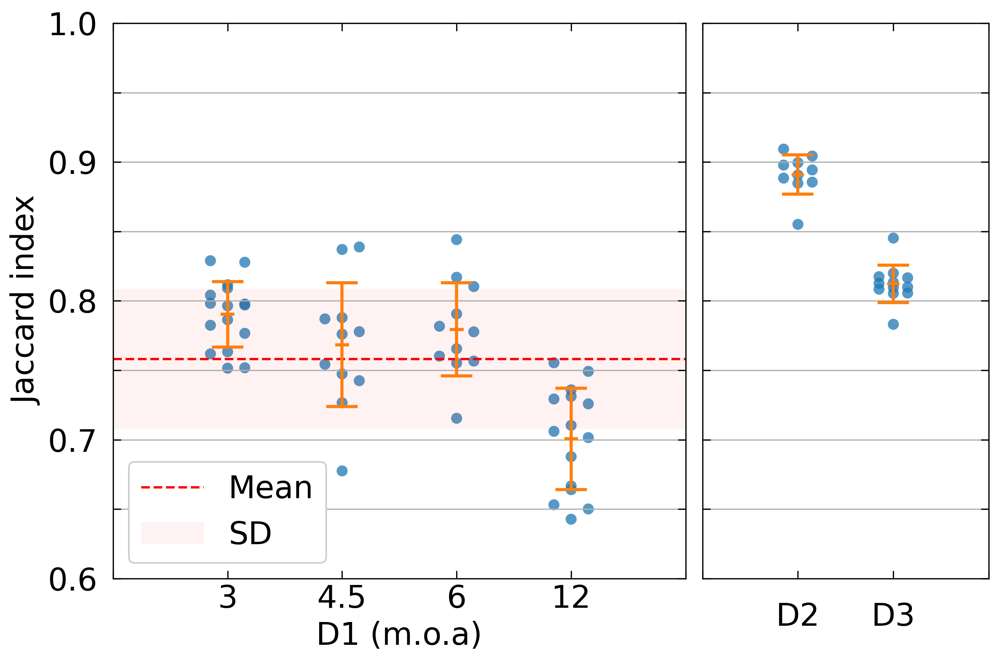

In [37]:

plot_mean_per_subject(jaccard_values_box_3,jaccard_values_box_4_5,jaccard_values_box_6,jaccard_values_box_12,
                      jaccard_values_box_d2,jaccard_values_box_d3,y_under_lim=0.6)


# 4. Oracle Performance

In [38]:
def generate_boxes_oracle(file, other_lab=False):
    """
    Generates bounding boxes for each slice of a subject NIfTI image from its manual reference mask.

    Parameters:
    - file (str): File name of the subject NIfTI image.

    Returns:
    - boxes_edges (list of lists): Bounding box edges for each slice in the format [x_left, y_up, x_right, y_down].
    """
    # Load the NIfTI file and extract image data and dimensions
    subject = nib.load(pjoin(subjects_path,file)).get_fdata()
    num_slices = subject.shape[2]
    
    # Determine reference mask path
    ref_path = (
        f'manual_masks/{file[:-7]}_mask.nii.gz' if other_lab and subjects_path == subjects_path_d2 else
        f'manual_masks/{file[:-16]}_mask.nii' if other_lab else
        f'manual_masks/{file[:7]}_mask_{file[17:-4]}.nii'
    )
    ref_mask = nib.load(pjoin(subjects_path, ref_path)).get_fdata()
    if len(ref_mask.shape)>3:
        ref_mask = np.squeeze(ref_mask,axis=-1)
        
    # Store bounding box edges for each slice
    boxes_edges = []
    for i in range(num_slices):
        # Rotate the slice for consistent orientation
        slice_data = np.rot90(ref_mask[:,:,i])
        output_array = np.zeros_like(slice_data)
        
        # Identify non-zero indices in the slice (values > 0.5)
        non_zero_indices = np.argwhere(slice_data > 0.5)
        if len(non_zero_indices):
            # Compute bounding box around non-zero regions
            min_row, min_col = np.min(non_zero_indices, axis=0)
            max_row, max_col = np.max(non_zero_indices, axis=0)
            output_array[min_row:max_row+1, min_col:max_col+1] = 1
            output_array = output_array.astype(int)

        # Calculate bounding box edges coordinates
        bbox_indices = np.argwhere(output_array != 0)
        if np.any(bbox_indices):
            yu, xl  = np.min(bbox_indices, axis=0)
            yd, xr  = np.max(bbox_indices, axis=0)
            boxes_edges.append([xl,yu,xr,yd])
        else:
            # Default box if no region found
            boxes_edges.append([0,0,0,0])
    return boxes_edges

## Results

#### 3 months

T2Wmice_first_im_A110123_3mo_.nii
T2Wmice_first_im_A120123_3mo_.nii
T2Wmice_first_im_A130123_3mo_.nii
T2Wmice_first_im_A160123_3mo_.nii
T2Wmice_first_im_A170123_3mo_.nii
T2Wmice_first_im_B110123_3mo_.nii
T2Wmice_first_im_B120123_3mo_.nii
T2Wmice_first_im_B130123_3mo_.nii
T2Wmice_first_im_B160123_3mo_.nii
T2Wmice_first_im_B170123_3mo_.nii
T2Wmice_first_im_C110123_3mo_.nii
T2Wmice_first_im_C120123_3mo_.nii
T2Wmice_first_im_C130123_3mo_.nii
T2Wmice_first_im_C160123_3mo_.nii
T2Wmice_first_im_D120123_3mo_.nii
T2Wmice_first_im_D160123_3mo_.nii
-------------------------------------------------
T2Wmice_first_im_A110123_3mo_.nii
✅ Automatic generation of input boxes completed in 0.0 minutes
✅  [◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼] 100.0%  - extraction completed in 0.13 minutes
	1: 94.7%	

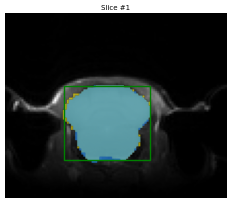

	2: 95.81%	

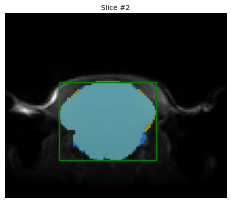

	3: 95.28%	

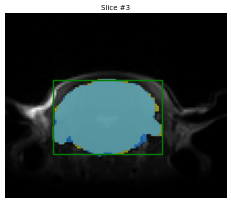

	4: 92.25%	

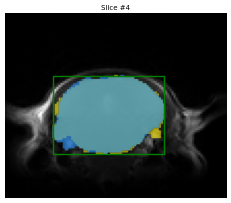

	5: 96.43%	

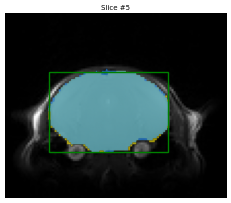

	6: 96.88%	

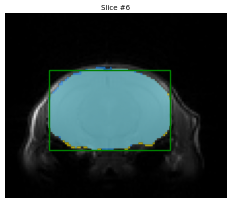

	7: 95.48%	

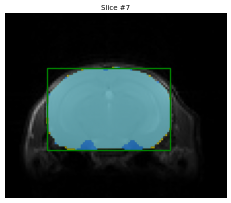

	8: 95.87%	

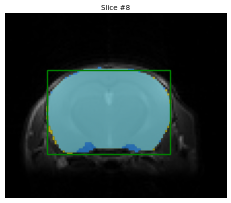

	9: 96.21%	

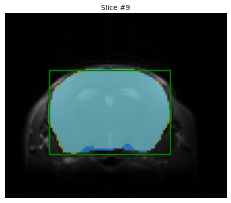

	10: 96.27%	

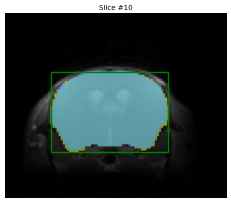

	11: 96.1%	

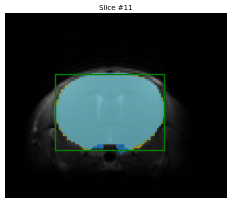

	12: 96.73%	

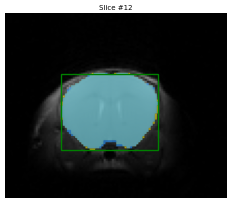

	13: 95.65%	

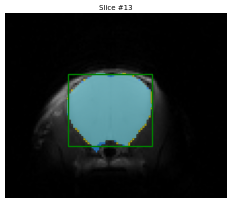

	14: 89.84%	

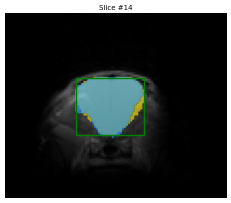

	15: 93.58%	

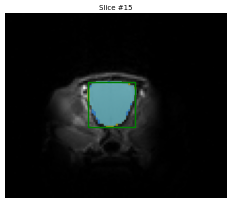

	16: 90.82%	

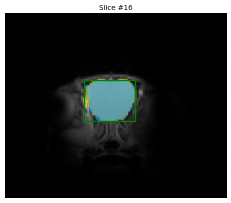

Subject mean performance metrics:
Accuracy:		 94.87%
Jaccard index:		 0.95
Dice coefficient:	 0.9742
accuracy_values_oracle_3 = np.array([94.87])
jaccard_values_oracle_3 = np.array([0.95])
dice_values_oracle_3 = np.array([0.9742])
accur_values_oracle_3 = np.array([94.7, 95.81, 95.28, 92.25, 96.43, 96.88, 95.48, 95.87, 96.21, 96.27, 96.1, 96.73, 95.65, 89.84, 93.58, 90.82])
jacc_values_oracle_3 = np.array([0.9484, 0.9591, 0.954, 0.9252, 0.9649, 0.9693, 0.9563, 0.9598, 0.9629, 0.9631, 0.9618, 0.9678, 0.9574, 0.9022, 0.9378, 0.9099])
dic_values_oracle_3 = np.array([0.9735, 0.9791, 0.9764, 0.9612, 0.9822, 0.9844, 0.9777, 0.9795, 0.9811, 0.9812, 0.9805, 0.9836, 0.9782, 0.9486, 0.9679, 0.9528])


In [39]:
files = []
subjects_path, output_path = subjects_path_3, pjoin(output_path_base,"3_months")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.startswith("T2Wmice_first_im") and file.endswith("nii"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    sam_mask_list = create_sam_candidates_list(file, reference_mask=True, oracle=True)

print(f"accuracy_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

#### 4.5 months

T2Wmice_first_im_A080323_4.5mo_.nii
T2Wmice_first_im_A090323_4.5mo_.nii
T2Wmice_first_im_A100323_4.5mo_.nii
T2Wmice_first_im_A130323_4.5mo_.nii
T2Wmice_first_im_A140323_4.5mo_.nii
T2Wmice_first_im_B090323_4.5mo_.nii
T2Wmice_first_im_B100323_4.5mo_.nii
T2Wmice_first_im_B130323_4.5mo_.nii
T2Wmice_first_im_C080323_4.5mo_.nii
T2Wmice_first_im_C090323_4.5mo_.nii
T2Wmice_first_im_C100323_4.5mo_.nii
-------------------------------------------------
T2Wmice_first_im_A080323_4.5mo_.nii
✅ Automatic generation of input boxes completed in 0.0 minutes
✅  [◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼] 100.0%  - extraction completed in 0.13 minutes
	1: 94.4%	

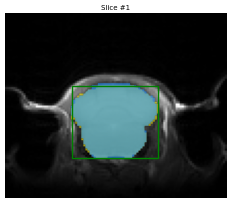

	2: 94.21%	

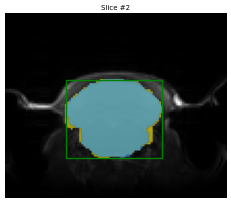

	3: 93.11%	

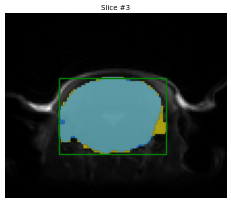

	4: 92.66%	

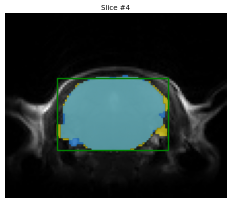

	5: 96.99%	

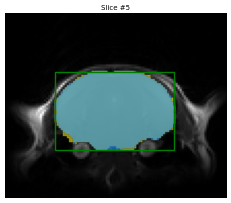

	6: 95.73%	

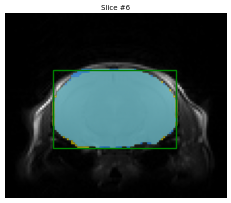

	7: 90.88%	

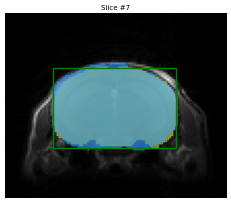

	8: 95.45%	

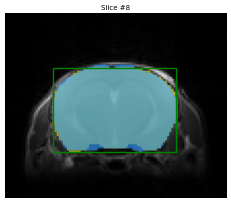

	9: 96.8%	

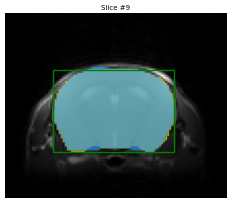

	10: 97.08%	

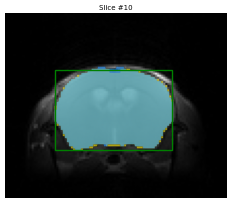

	11: 93.25%	

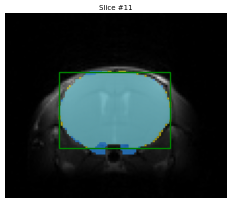

	12: 95.86%	

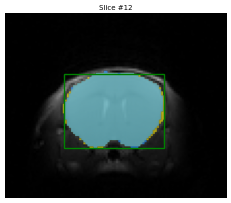

	13: 92.45%	

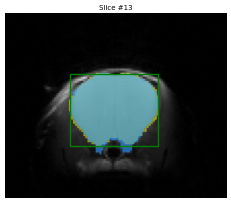

	14: 91.3%	

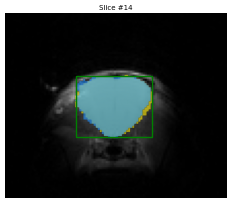

	15: 90.93%	

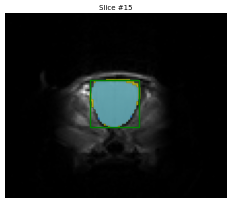

	16: 94.09%	

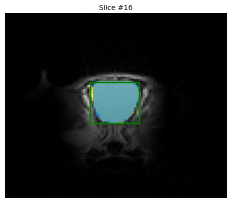

Subject mean performance metrics:
Accuracy:		 94.07%
Jaccard index:		 0.9424
Dice coefficient:	 0.9703
accuracy_values_oracle_4_5 = np.array([94.07])
jaccard_values_oracle_4_5 = np.array([0.9424])
dice_values_oracle_4_5 = np.array([0.9703])
accur_values_oracle_4_5 = np.array([94.4, 94.21, 93.11, 92.66, 96.99, 95.73, 90.88, 95.45, 96.8, 97.08, 93.25, 95.86, 92.45, 91.3, 90.93, 94.09])
jacc_values_oracle_4_5 = np.array([0.9459, 0.9423, 0.932, 0.9284, 0.9701, 0.9582, 0.9158, 0.9559, 0.9685, 0.9711, 0.9356, 0.959, 0.9274, 0.9162, 0.9097, 0.9424])
dic_values_oracle_4_5 = np.array([0.9722, 0.9703, 0.9648, 0.9629, 0.9848, 0.9787, 0.956, 0.9774, 0.984, 0.9854, 0.9668, 0.979, 0.9624, 0.9563, 0.9527, 0.9704])


In [40]:
files = []
subjects_path, output_path = subjects_path_4_5, pjoin(output_path_base,"4_5_months")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.startswith("T2Wmice_first_im") and file.endswith("nii"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    sam_mask_list = create_sam_candidates_list(file, reference_mask=True, oracle=True)

print(f"accuracy_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

#### 6 months

T2Wmice_first_im_A250423_6mo_.nii
T2Wmice_first_im_A260423_6mo_.nii
T2Wmice_first_im_A270423_6mo_.nii
T2Wmice_first_im_A280423_6mo_.nii
T2Wmice_first_im_B250423_6mo_.nii
T2Wmice_first_im_B260423_6mo_.nii
T2Wmice_first_im_B270423_6mo_.nii
T2Wmice_first_im_B280423_6mo_.nii
T2Wmice_first_im_C250423_6mo_.nii
T2Wmice_first_im_C260423_6mo_.nii
T2Wmice_first_im_C270423_6mo_.nii
-------------------------------------------------
T2Wmice_first_im_A250423_6mo_.nii
✅ Automatic generation of input boxes completed in 0.0 minutes
✅  [◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼] 100.0%  - extraction completed in 0.13 minutes
	1: 93.5%	

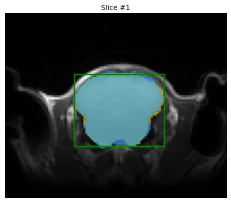

	2: 92.96%	

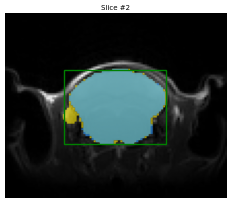

	3: 94.89%	

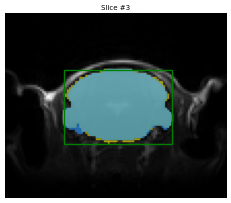

	4: 92.51%	

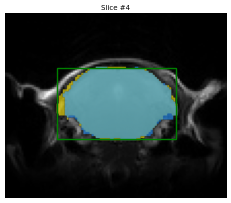

	5: 94.49%	

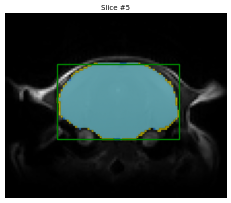

	6: 96.81%	

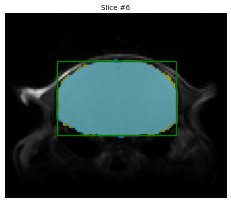

	7: 93.55%	

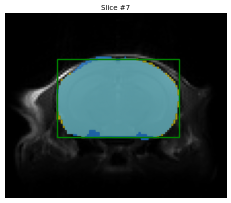

	8: 92.7%	

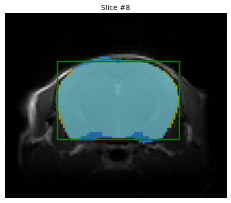

	9: 94.57%	

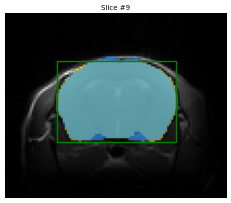

	10: 95.72%	

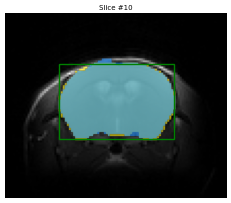

	11: 93.1%	

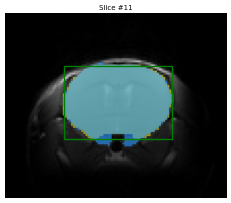

	12: 95.18%	

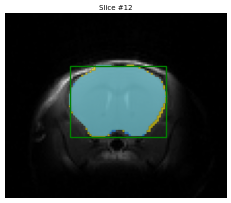

	13: 94.41%	

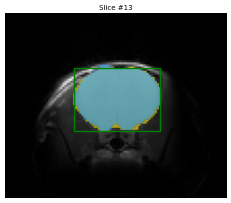

	14: 90.13%	

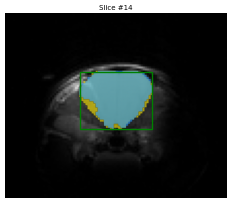

	15: 94.41%	

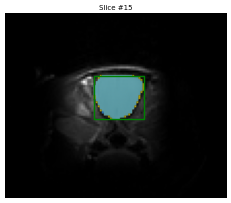

	16: 94.03%	

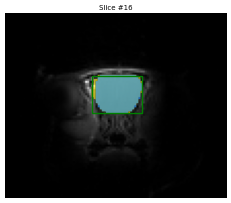

Subject mean performance metrics:
Accuracy:		 93.94%
Jaccard index:		 0.9406
Dice coefficient:	 0.9694
accuracy_values_oracle_6 = np.array([93.94])
jaccard_values_oracle_6 = np.array([0.9406])
dice_values_oracle_6 = np.array([0.9694])
accur_values_oracle_6 = np.array([93.5, 92.96, 94.89, 92.51, 94.49, 96.81, 93.55, 92.7, 94.57, 95.72, 93.1, 95.18, 94.41, 90.13, 94.41, 94.03])
jacc_values_oracle_6 = np.array([0.9376, 0.9302, 0.9497, 0.9266, 0.9452, 0.9683, 0.9383, 0.9308, 0.9475, 0.9578, 0.934, 0.9521, 0.9445, 0.9028, 0.9442, 0.9407])
dic_values_oracle_6 = np.array([0.9678, 0.9638, 0.9742, 0.9619, 0.9718, 0.9839, 0.9681, 0.9642, 0.973, 0.9784, 0.9659, 0.9755, 0.9715, 0.9489, 0.9713, 0.9695])


In [41]:
files = []
subjects_path, output_path = subjects_path_6, pjoin(output_path_base,"6_months")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.startswith("T2Wmice_first_im") and file.endswith("nii"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    sam_mask_list = create_sam_candidates_list(file, reference_mask=True, oracle=True)

print(f"accuracy_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

#### 12 months

T2Wmice_first_im_A030222_12mo_.nii
T2Wmice_first_im_A070222_12mo_.nii
T2Wmice_first_im_A080222_12mo_.nii
T2Wmice_first_im_A090222_12mo_.nii
T2Wmice_first_im_A100222_12mo_.nii
T2Wmice_first_im_A250222_12mo_.nii
T2Wmice_first_im_B030222_12mo_.nii
T2Wmice_first_im_B070222_12mo_.nii
T2Wmice_first_im_B080222_12mo_.nii
T2Wmice_first_im_B090222_12mo_.nii
T2Wmice_first_im_B100222_12mo_.nii
T2Wmice_first_im_C070222_12mo_.nii
T2Wmice_first_im_C080222_12mo_.nii
T2Wmice_first_im_C090222_12mo_.nii
T2Wmice_first_im_C100222_12mo_.nii
-------------------------------------------------
T2Wmice_first_im_A030222_12mo_.nii
✅ Automatic generation of input boxes completed in 0.0 minutes
✅  [◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼] 100.0%  - extraction completed in 0.13 minutes
	1: 81.03%	

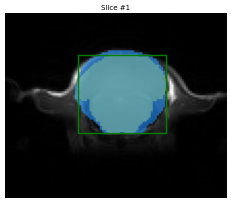

	2: 89.78999999999999%	

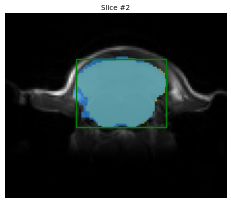

	3: 96.0%	

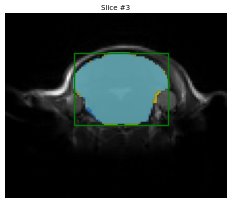

	4: 87.63%	

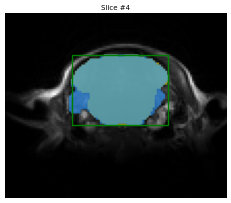

	5: 96.56%	

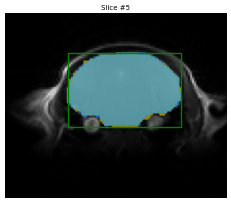

	6: 96.18%	

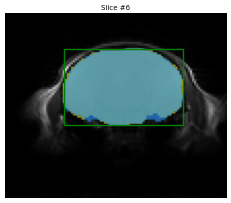

	7: 94.19%	

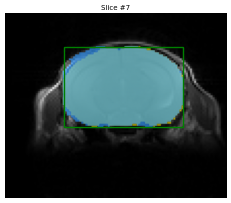

	8: 94.29%	

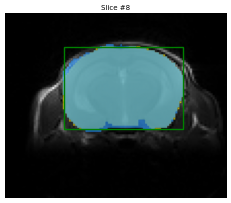

	9: 96.38%	

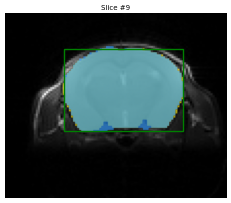

	10: 97.1%	

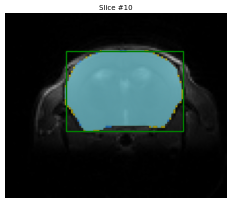

	11: 93.21%	

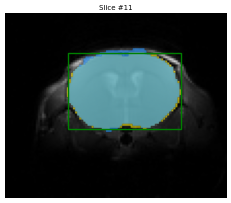

	12: 95.89%	

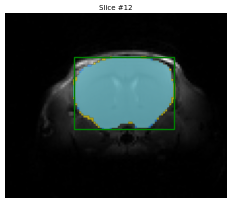

	13: 96.54%	

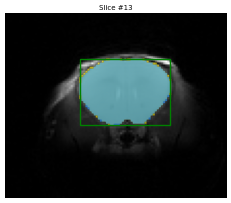

	14: 85.55%	

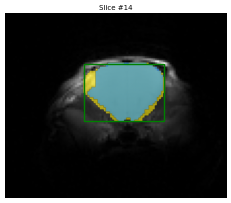

	15: 88.24%	

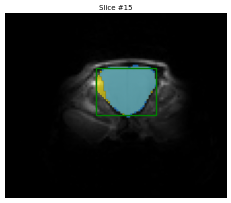

	16: 92.69%	

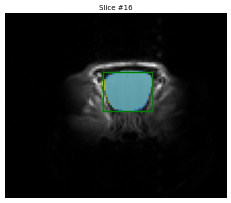

Subject mean performance metrics:
Accuracy:		 92.58%
Jaccard index:		 0.9303
Dice coefficient:	 0.9634
accuracy_values_oracle_12 = np.array([92.58])
jaccard_values_oracle_12 = np.array([0.9303])
dice_values_oracle_12 = np.array([0.9634])
accur_values_oracle_12 = np.array([81.03, 89.78999999999999, 96.0, 87.63, 96.56, 96.18, 94.19, 94.29, 96.38, 97.1, 93.21, 95.89, 96.54, 85.55, 88.24, 92.69])
jacc_values_oracle_12 = np.array([0.8403, 0.9069, 0.9605, 0.8894, 0.9661, 0.9626, 0.9446, 0.9455, 0.9647, 0.9712, 0.9346, 0.9593, 0.9657, 0.8563, 0.8867, 0.93])
dic_values_oracle_12 = np.array([0.9132, 0.9512, 0.9798, 0.9415, 0.9827, 0.9809, 0.9715, 0.972, 0.982, 0.9854, 0.9662, 0.9792, 0.9825, 0.9226, 0.9399, 0.9637])


In [42]:
files = []
subjects_path, output_path = subjects_path_12, pjoin(output_path_base,"12_months")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.startswith("T2Wmice_first_im") and file.endswith("nii"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    sam_mask_list = create_sam_candidates_list(file, reference_mask=True, oracle=True)

print(f"accuracy_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

#### D2

5463_t2.nii_flip.nii.gz
5471_t2.nii_flip.nii.gz
5472_t2.nii_flip.nii.gz
6085_t2.nii_flip.nii.gz
6087_t2.nii_flip.nii.gz
6088_t2.nii_flip.nii.gz
6092_t2.nii_flip.nii.gz
6093_t2.nii_flip.nii.gz
6287_t2.nii_flip.nii.gz
6289_t2.nii_flip.nii.gz
-------------------------------------------------
5463_t2.nii_flip.nii.gz
✅ Automatic generation of input boxes completed in 0.0 minutes
✅  [◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼] 100.0%  - extraction completed in 0.18 minutes


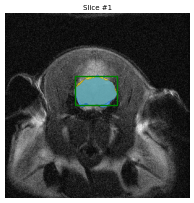

	2: 92.09%	

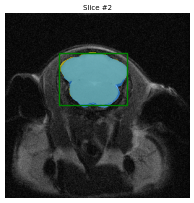

	3: 96.81%	

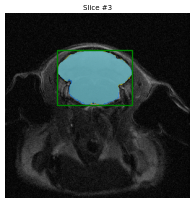

	4: 90.06%	

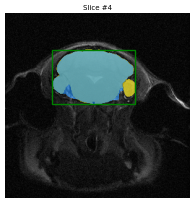

	5: 88.78%	

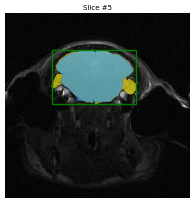

	6: 96.15%	

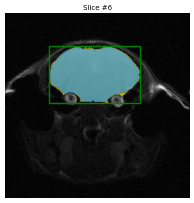

	7: 97.98%	

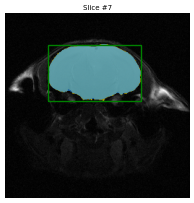

	8: 97.24%	

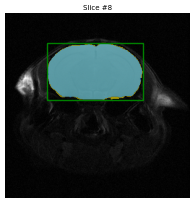

	9: 97.98%	

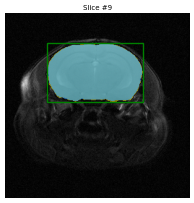

	10: 98.05%	

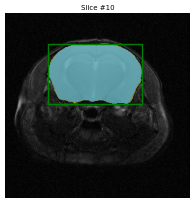

	11: 97.0%	

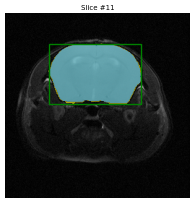

	12: 95.35%	

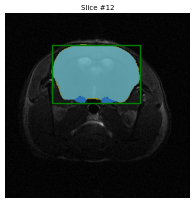

	13: 96.81%	

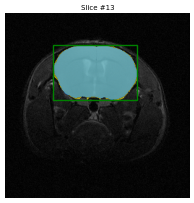

	14: 98.12%	

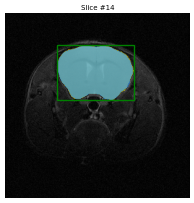

	15: 95.52%	

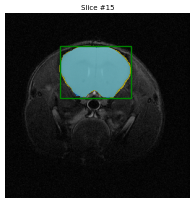

	16: 93.64%	

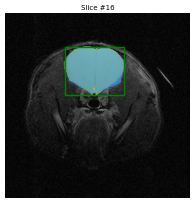

	17: 96.05%	

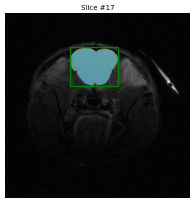

	18: 94.57%	

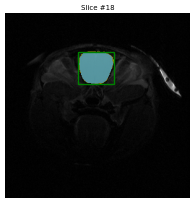

	19: 94.87%	

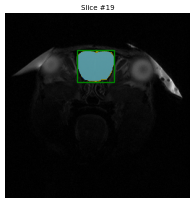

	20: 93.01%	

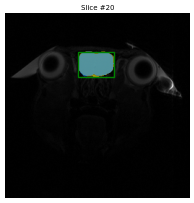

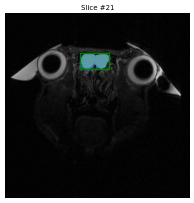

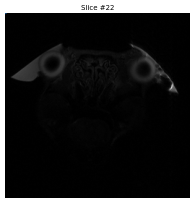

Subject mean performance metrics:
Accuracy:		 95.27%
Jaccard index:		 0.9534
Dice coefficient:	 0.976
accuracy_values_oracle_d2 = np.array([95.27])
jaccard_values_oracle_d2 = np.array([0.9534])
dice_values_oracle_d2 = np.array([0.976])
accur_values_oracle_d2 = np.array([92.09, 96.81, 90.06, 88.78, 96.15, 97.98, 97.24, 97.98, 98.05, 97.0, 95.35, 96.81, 98.12, 95.52, 93.64, 96.05, 94.57, 94.87, 93.01])
jacc_values_oracle_d2 = np.array([0.9252, 0.9688, 0.904, 0.8884, 0.9616, 0.9798, 0.9724, 0.9798, 0.9805, 0.9701, 0.9549, 0.9682, 0.9813, 0.9554, 0.9386, 0.9608, 0.9457, 0.9488, 0.9306])
dic_values_oracle_d2 = np.array([0.9611, 0.9842, 0.9496, 0.9409, 0.9804, 0.9898, 0.986, 0.9898, 0.9901, 0.9848, 0.9769, 0.9838, 0.9905, 0.9772, 0.9683, 0.98, 0.9721, 0.9737, 0.964])


In [43]:
files = []
subjects_path, output_path = subjects_path_d2, pjoin(output_path_base,"d2")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.endswith("flip.nii.gz"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    sam_mask_list = create_sam_candidates_list(file, other_lab=True, reference_mask=True, oracle=True)

print(f"accuracy_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

#### D3

20190227_105648_AE0818_rs_Control_11_1_1_T2w.nii_flip.nii.gz
20190227_120644_AE0818_rs_Control_12_1_1_T2w.nii_flip.nii.gz
20190227_125730_AE0818_rs_Control_13_1_1_T2w.nii_flip.nii.gz
20190228_081325_AE0818_rs_Control_14_1_1_T2w.nii_flip.nii.gz
20190228_093749_AE0818_rs_Control_21_1_1_T2w.nii_flip.nii.gz
20190228_103014_AE0818_rs_Control_15_1_1_T2w.nii_flip.nii.gz
20190311_083410_AE0818_rs_Control_11_1_2_T2w.nii_flip.nii.gz
20190311_095840_AE0818_rs_Control_12_1_2_T2w.nii_flip.nii.gz
20190311_105918_AE0818_rs_Control_13_1_2_T2w.nii_flip.nii.gz
20190311_115813_AE0818_rs_Control_14_1_2_T2w.nii_flip.nii.gz
20190311_125036_AE0818_rs_Control_15_1_2_T2w.nii_flip.nii.gz
20190311_143920_AE0818_rs_Control_21_1_2_T2w.nii_flip.nii.gz
-------------------------------------------------
20190227_105648_AE0818_rs_Control_11_1_1_T2w.nii_flip.nii.gz
✅ Automatic generation of input boxes completed in 0.0 minutes
✅  [◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼◼] 100.0%  - extraction completed in 0.39 minutes


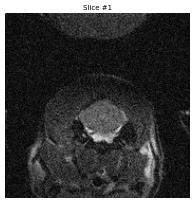

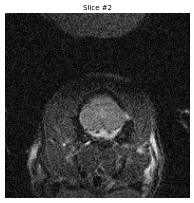

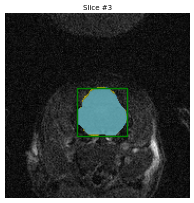

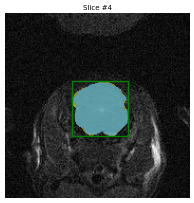

	5: 96.4%	

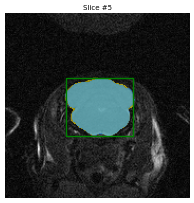

	6: 96.67%	

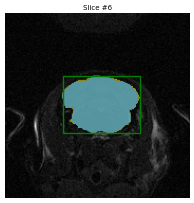

	7: 92.02%	

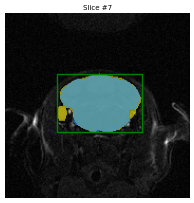

	8: 93.22%	

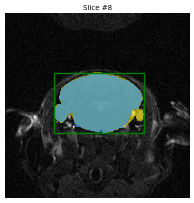

	9: 90.49%	

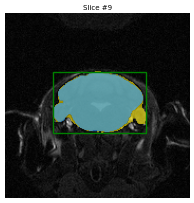

	10: 95.12%	

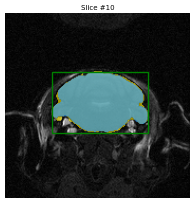

	11: 92.36%	

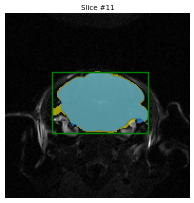

	12: 91.14%	

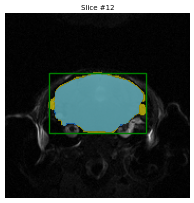

	13: 94.64%	

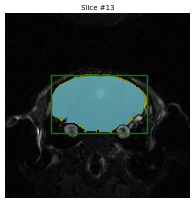

	14: 93.97%	

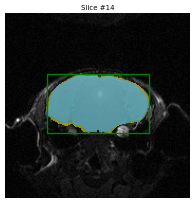

	15: 94.59%	

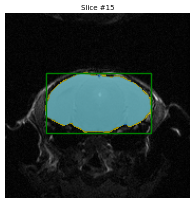

	16: 94.18%	

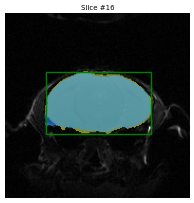

	17: 95.28%	

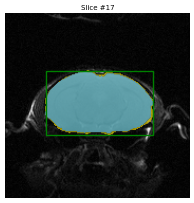

	18: 95.15%	

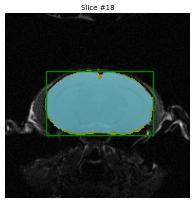

	19: 94.08%	

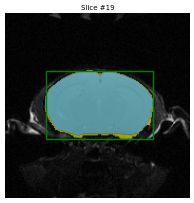

	20: 94.94%	

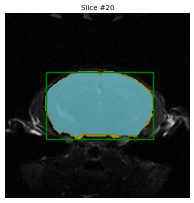

	21: 96.15%	

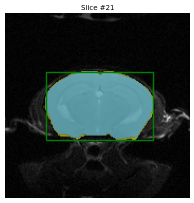

	22: 94.38%	

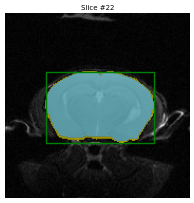

	23: 96.31%	

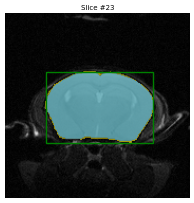

	24: 95.45%	

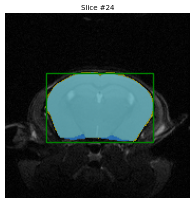

	25: 96.34%	

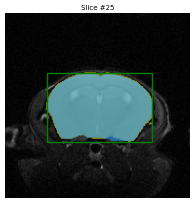

	26: 93.84%	

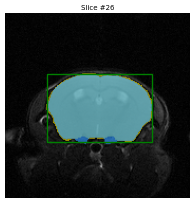

	27: 95.98%	

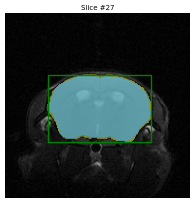

	28: 95.36%	

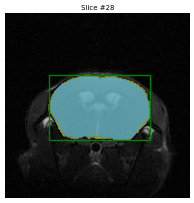

	29: 95.72%	

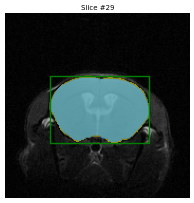

	30: 96.18%	

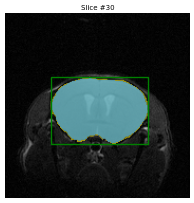

	31: 95.32%	

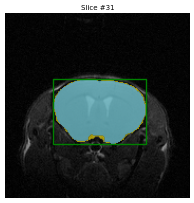

	32: 95.03%	

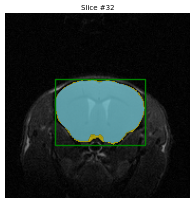

	33: 93.8%	

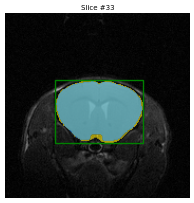

	34: 95.58%	

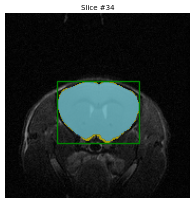

	35: 95.49%	

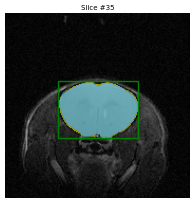

	36: 95.1%	

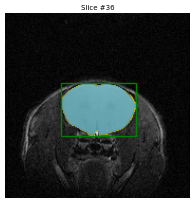

	37: 96.44%	

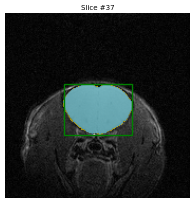

	38: 95.67%	

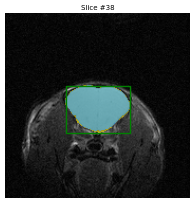

	39: 95.8%	

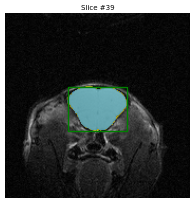

	40: 94.26%	

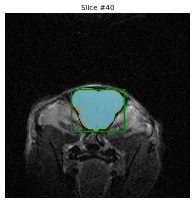

	41: 92.97%	

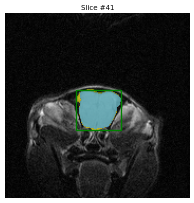

	42: 91.83%	

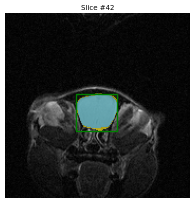

	43: 91.45%	

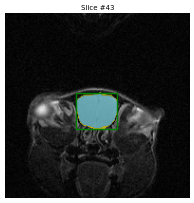

	44: 91.51%	

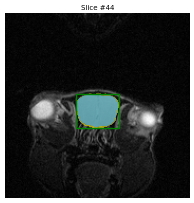

	45: 93.3%	

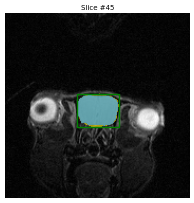

	46: 91.78999999999999%	

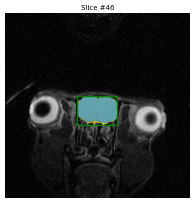

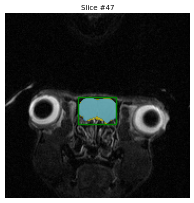

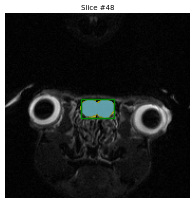

Subject mean performance metrics:
Accuracy:		 94.41%
Jaccard index:		 0.9443
Dice coefficient:	 0.9713
accuracy_values_oracle_d3 = np.array([94.41])
jaccard_values_oracle_d3 = np.array([0.9443])
dice_values_oracle_d3 = np.array([0.9713])
accur_values_oracle_d3 = np.array([96.4, 96.67, 92.02, 93.22, 90.49, 95.12, 92.36, 91.14, 94.64, 93.97, 94.59, 94.18, 95.28, 95.15, 94.08, 94.94, 96.15, 94.38, 96.31, 95.45, 96.34, 93.84, 95.98, 95.36, 95.72, 96.18, 95.32, 95.03, 93.8, 95.58, 95.49, 95.1, 96.44, 95.67, 95.8, 94.26, 92.97, 91.83, 91.45, 91.51, 93.3, 91.78999999999999])
jacc_values_oracle_d3 = np.array([0.9642, 0.9667, 0.9206, 0.9325, 0.9051, 0.9513, 0.9243, 0.9119, 0.9465, 0.9397, 0.946, 0.9425, 0.9528, 0.9515, 0.9408, 0.9494, 0.9615, 0.9438, 0.9631, 0.9554, 0.9637, 0.9398, 0.9598, 0.9536, 0.9572, 0.9618, 0.9532, 0.9503, 0.9381, 0.9558, 0.9549, 0.951, 0.9644, 0.9567, 0.958, 0.9426, 0.9297, 0.9183, 0.9145, 0.9151, 0.933, 0.9179])
dic_values_oracle_d3 = np.array([0.9818, 0.9831, 0.9587, 0

In [44]:
files = []
subjects_path, output_path = subjects_path_d3, pjoin(output_path_base,"d3")
os.makedirs(pjoin(output_path), exist_ok=True)
for file in sorted(os.listdir(subjects_path)):
    if file.endswith("flip.nii.gz"):
        files.append(file)
        print(file)

accuracies_per_slice = []
jaccards_per_slice   = []
dices_per_slice      = []
mean_accuracies = []
mean_jaccards   = []
mean_dices      = []

for file in files[:1]:  # Only first subject in list, to access all subjects results simply remove the [:1] restriction
    print("-------------------------------------------------")
    print(file)
    sam_mask_list = create_sam_candidates_list(file, other_lab=True, reference_mask=True, oracle=True)

print(f"accuracy_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({mean_accuracies})")
print(f"jaccard_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({mean_jaccards})")
print(f"dice_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({mean_dices})")
print(f"accur_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({accuracies_per_slice})")
print(f"jacc_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({jaccards_per_slice})")
print(f"dic_values_oracle_{group_tag[subjects_path[-8:]]} = np.array({dices_per_slice})")

## Evaluation metrics

In [45]:
accuracy_values_oracle_3 = np.array([94.89, 92.89, 95.08, 94.42, 93.11, 93.73, 92.93, 92.32, 92.92, 94.12, 90.03, 92.72, 92.47, 93.92, 92.66, 93.81])
jaccard_values_oracle_3 = np.array([0.9502, 0.9338, 0.9517, 0.946, 0.9341, 0.939, 0.9322, 0.9259, 0.932, 0.9423, 0.9024, 0.9294, 0.9272, 0.9406, 0.9285, 0.9396])
dice_values_oracle_3 = np.array([0.9743, 0.9654, 0.9752, 0.9721, 0.9654, 0.9682, 0.9647, 0.9612, 0.9648, 0.97, 0.9438, 0.9632, 0.9619, 0.9692, 0.9627, 0.9686])
accur_values_oracle_3 = np.array([94.7, 95.81, 95.28, 92.25, 96.43, 96.88, 95.48, 95.87, 96.21, 96.27, 96.1, 96.73, 95.65, 90.11, 93.58, 90.82, 95.9, 96.25, 90.51, 92.63, 97.28, 93.14, 93.59, 94.46, 94.33, 94.73, 95.39, 93.95, 78.52, 94.27, 94.87, 86.47, 94.81, 93.42, 95.71, 94.69, 97.25, 96.18, 95.9, 98.04, 96.55, 96.89, 96.32, 95.68, 91.11, 92.54, 92.99, 93.24, 94.78, 94.1, 93.71, 97.54, 96.51, 93.72, 94.71, 96.6, 96.7, 97.1, 97.17, 93.55, 91.83, 92.39, 94.55, 85.81, 97.07, 89.49, 92.81, 97.09, 97.67, 95.83, 96.18, 98.55, 97.2, 93.22, 95.74, 94.1, 83.38, 89.86, 85.42, 86.23, 96.53, 91.67, 93.39, 97.0, 96.52, 94.68, 96.59, 97.51, 95.98, 93.98, 96.57, 92.34, 85.2, 93.24, 92.16, 86.31, 92.2, 92.25, 93.57, 93.39, 94.92, 94.66, 94.3, 96.81, 96.17, 93.73, 93.27, 91.76, 90.18, 91.11, 93.16, 85.34, 92.0, 92.42, 96.28, 96.96, 92.49, 93.78, 95.33, 94.28, 95.08, 88.34, 95.22, 92.47, 91.71000000000001, 84.88, 91.52, 84.35, 90.74, 90.9, 90.57, 95.92, 94.25, 93.59, 94.95, 95.85, 93.29, 91.75, 92.76, 91.78999999999999, 91.18, 93.25, 92.94, 93.04, 94.64, 96.69, 94.29, 96.22, 97.21, 95.56, 95.82, 96.28, 94.76, 95.89, 96.68, 93.63, 91.18, 90.14, 86.31, 90.59, 93.06, 94.62, 95.17, 93.77, 95.5, 91.83, 94.32, 94.47, 94.24, 95.19, 94.48, 46.1, 92.19, 86.58, 89.31, 89.61, 93.85, 89.86, 92.42, 96.26, 97.2, 94.13, 96.05, 95.85, 93.82, 91.14, 95.29, 92.15, 92.14, 86.89, 90.91, 85.59, 91.11, 95.22, 92.79, 87.36, 95.52, 95.58, 90.95, 95.63, 95.79, 96.24, 93.2, 95.32, 90.53999999999999, 83.57, 90.99, 89.7, 94.48, 95.35, 92.68, 96.9, 96.07, 95.3, 95.11, 96.36, 96.3, 96.15, 94.37, 94.29, 90.48, 88.11, 91.44, 89.36, 96.16, 88.27, 93.17, 94.11, 95.04, 91.36, 93.67, 94.87, 94.28, 92.82, 96.31, 93.7, 91.58, 84.77, 93.54, 88.98, 97.43, 92.76, 92.89, 96.56, 95.22, 95.45, 95.62, 95.91, 96.62, 92.07, 95.22, 93.6, 91.33, 82.74, 93.81, 93.71])
jacc_values_oracle_3 = np.array([0.9484, 0.9591, 0.954, 0.9252, 0.9649, 0.9693, 0.9563, 0.9598, 0.9629, 0.9631, 0.9618, 0.9678, 0.9574, 0.9049, 0.9378, 0.9099, 0.9598, 0.9636, 0.9126, 0.9308, 0.973, 0.9353, 0.939, 0.9467, 0.945, 0.9486, 0.9546, 0.9409, 0.821, 0.9441, 0.949, 0.8763, 0.9501, 0.9346, 0.9581, 0.9475, 0.9728, 0.9627, 0.9602, 0.9806, 0.9657, 0.9692, 0.9637, 0.957, 0.9142, 0.9276, 0.9307, 0.9331, 0.9481, 0.9419, 0.9399, 0.9756, 0.9658, 0.9404, 0.9494, 0.9669, 0.9679, 0.9711, 0.972, 0.9379, 0.9213, 0.9268, 0.9462, 0.865, 0.9711, 0.8963, 0.93, 0.9712, 0.9772, 0.9593, 0.9628, 0.9856, 0.9724, 0.9354, 0.9581, 0.9427, 0.8544, 0.9014, 0.8548, 0.8733, 0.9658, 0.9182, 0.9353, 0.9703, 0.966, 0.9491, 0.9666, 0.9756, 0.9608, 0.9427, 0.9659, 0.9245, 0.8532, 0.9341, 0.9224, 0.8727, 0.926, 0.9255, 0.9391, 0.937, 0.9505, 0.9483, 0.9454, 0.9685, 0.9621, 0.9393, 0.9343, 0.9191, 0.9084, 0.9129, 0.9327, 0.8653, 0.9213, 0.9248, 0.9634, 0.9701, 0.9289, 0.9408, 0.9549, 0.9449, 0.9527, 0.895, 0.9532, 0.9278, 0.9193, 0.8537, 0.9163, 0.8479, 0.9139, 0.9107, 0.9113, 0.9603, 0.9445, 0.9389, 0.9509, 0.959, 0.9352, 0.9223, 0.931, 0.9192, 0.917, 0.9357, 0.9314, 0.931, 0.9474, 0.9676, 0.9435, 0.9628, 0.9727, 0.9567, 0.9593, 0.9633, 0.9494, 0.9595, 0.9674, 0.9368, 0.9126, 0.9025, 0.8662, 0.9091, 0.9335, 0.9466, 0.9526, 0.939, 0.9556, 0.9236, 0.9454, 0.9469, 0.9448, 0.9534, 0.9457, 0.4645, 0.9236, 0.8703, 0.8958, 0.8964, 0.9397, 0.899, 0.9248, 0.9631, 0.9721, 0.9435, 0.9612, 0.9593, 0.9405, 0.9179, 0.9534, 0.923, 0.9232, 0.8713, 0.91, 0.8689, 0.9167, 0.9537, 0.9294, 0.8869, 0.9558, 0.9568, 0.9153, 0.9573, 0.9588, 0.9626, 0.9343, 0.9537, 0.9067, 0.8373, 0.911, 0.8984, 0.9466, 0.9548, 0.9272, 0.9695, 0.9617, 0.9542, 0.9523, 0.9644, 0.964, 0.9625, 0.9449, 0.9438, 0.9109, 0.8838, 0.915, 0.8947, 0.962, 0.8839, 0.9323, 0.9422, 0.9506, 0.9196, 0.9389, 0.9503, 0.9445, 0.9314, 0.9638, 0.9388, 0.9188, 0.8519, 0.9357, 0.891, 0.9746, 0.9287, 0.9316, 0.9662, 0.9535, 0.9559, 0.9569, 0.9597, 0.9668, 0.9259, 0.9528, 0.9365, 0.9179, 0.8288, 0.9384, 0.9392])
dic_values_oracle_3 = np.array([0.9735, 0.9791, 0.9764, 0.9612, 0.9822, 0.9844, 0.9777, 0.9795, 0.9811, 0.9812, 0.9805, 0.9836, 0.9782, 0.9501, 0.9679, 0.9528, 0.9795, 0.9815, 0.9543, 0.9642, 0.9863, 0.9666, 0.9685, 0.9726, 0.9717, 0.9736, 0.9768, 0.9696, 0.9017, 0.9712, 0.9738, 0.9341, 0.9744, 0.9662, 0.9786, 0.973, 0.9862, 0.981, 0.9797, 0.9902, 0.9825, 0.9844, 0.9815, 0.978, 0.9552, 0.9624, 0.9641, 0.9654, 0.9733, 0.9701, 0.969, 0.9876, 0.9826, 0.9693, 0.9741, 0.9832, 0.9837, 0.9853, 0.9858, 0.9679, 0.959, 0.962, 0.9724, 0.9276, 0.9853, 0.9453, 0.9637, 0.9854, 0.9885, 0.9792, 0.981, 0.9927, 0.986, 0.9666, 0.9786, 0.9705, 0.9215, 0.9481, 0.9217, 0.9324, 0.9826, 0.9573, 0.9666, 0.9849, 0.9827, 0.9739, 0.983, 0.9877, 0.98, 0.9705, 0.9827, 0.9608, 0.9208, 0.9659, 0.9596, 0.932, 0.9616, 0.9613, 0.9686, 0.9675, 0.9746, 0.9735, 0.9719, 0.984, 0.9807, 0.9687, 0.966, 0.9579, 0.952, 0.9545, 0.9652, 0.9278, 0.9591, 0.961, 0.9813, 0.9848, 0.9631, 0.9695, 0.9769, 0.9717, 0.9758, 0.9446, 0.976, 0.9626, 0.9579, 0.9211, 0.9563, 0.9177, 0.955, 0.9533, 0.9536, 0.9798, 0.9715, 0.9685, 0.9748, 0.9791, 0.9665, 0.9596, 0.9642, 0.9579, 0.9567, 0.9668, 0.9645, 0.9643, 0.973, 0.9835, 0.9709, 0.981, 0.9861, 0.9779, 0.9792, 0.9813, 0.974, 0.9793, 0.9834, 0.9674, 0.9543, 0.9487, 0.9283, 0.9524, 0.9656, 0.9726, 0.9757, 0.9685, 0.9773, 0.9603, 0.9719, 0.9727, 0.9716, 0.9761, 0.9721, 0.6344, 0.9603, 0.9307, 0.9451, 0.9454, 0.9689, 0.9468, 0.9609, 0.9812, 0.9859, 0.9709, 0.9802, 0.9792, 0.9693, 0.9572, 0.9762, 0.96, 0.96, 0.9312, 0.9529, 0.9298, 0.9566, 0.9763, 0.9634, 0.94, 0.9774, 0.9779, 0.9558, 0.9782, 0.979, 0.9809, 0.966, 0.9763, 0.951, 0.9115, 0.9534, 0.9465, 0.9726, 0.9769, 0.9622, 0.9845, 0.9805, 0.9766, 0.9755, 0.9819, 0.9817, 0.9809, 0.9717, 0.9711, 0.9534, 0.9383, 0.9556, 0.9444, 0.9806, 0.9384, 0.9649, 0.9703, 0.9747, 0.9581, 0.9685, 0.9745, 0.9715, 0.9645, 0.9816, 0.9684, 0.9577, 0.92, 0.9668, 0.9423, 0.9872, 0.963, 0.9646, 0.9828, 0.9762, 0.9775, 0.978, 0.9794, 0.9831, 0.9615, 0.9759, 0.9672, 0.9572, 0.9064, 0.9682, 0.9687])

accuracy_values_oracle_4_5 = np.array([94.07, 92.96, 94.12, 93.27, 92.67, 93.46, 93.75, 92.72, 93.78, 93.57, 94.38])
jaccard_values_oracle_4_5 = np.array([0.9424, 0.9336, 0.9431, 0.9347, 0.9285, 0.9355, 0.9394, 0.9291, 0.94, 0.9369, 0.9458])
dice_values_oracle_4_5 = np.array([0.9703, 0.9654, 0.9705, 0.966, 0.9627, 0.9664, 0.9686, 0.963, 0.9688, 0.9672, 0.972])
accur_values_oracle_4_5 = np.array([94.4, 94.21, 93.11, 92.66, 96.99, 95.73, 90.88, 95.45, 96.8, 97.08, 93.25, 95.86, 92.45, 91.3, 90.93, 94.09, 95.14, 94.42, 90.59, 93.88, 97.56, 92.58, 94.57, 95.03, 93.72, 90.78, 94.9, 92.12, 83.75, 87.38, 95.71, 95.24, 92.88, 96.06, 90.85, 95.76, 95.62, 97.03, 91.63, 95.51, 96.17, 95.14, 93.19, 95.86, 95.03, 87.52, 93.92, 93.83, 93.75, 95.84, 91.45, 94.11, 96.05, 96.56, 95.02, 95.31, 95.14, 94.22, 92.44, 95.66, 90.16, 84.25, 93.21, 89.22, 93.06, 91.76, 89.19, 95.93, 95.08, 95.53, 90.76, 94.94, 95.78, 90.64, 95.49, 93.63, 90.16, 84.28999999999999, 93.78, 92.73, 89.12, 95.97, 90.98, 96.86, 96.59, 96.64, 96.09, 96.36, 96.8, 94.07, 95.61, 93.41, 89.31, 86.78999999999999, 90.96000000000001, 89.74, 90.08, 90.45, 95.28, 96.84, 96.85, 92.87, 93.91, 95.38, 94.2, 94.83, 96.39, 96.02, 94.41, 91.26, 90.59, 90.62, 92.96, 85.45, 95.53, 94.31, 95.27, 92.98, 94.0, 95.63, 95.26, 93.54, 95.27, 93.94, 90.24, 90.4, 94.33, 84.38, 82.11, 94.57, 91.03999999999999, 95.21, 97.11, 96.51, 95.38, 95.24, 96.08, 95.93, 92.4, 97.16, 95.9, 91.12, 92.11, 92.56, 94.85, 94.82, 95.17, 92.6, 96.05, 96.33, 92.59, 92.92, 96.22, 95.9, 96.46, 94.87, 92.71, 85.36, 90.78, 89.42, 93.91, 96.79, 94.52, 97.09, 97.69, 92.86, 92.26, 96.2, 97.05, 97.34, 90.25, 95.81, 91.69, 89.99, 93.21, 93.37])
jacc_values_oracle_4_5 = np.array([0.9459, 0.9423, 0.932, 0.9284, 0.9701, 0.9582, 0.9158, 0.9559, 0.9685, 0.9711, 0.9356, 0.959, 0.9274, 0.9162, 0.9097, 0.9424, 0.9531, 0.9447, 0.9131, 0.9417, 0.976, 0.9299, 0.9479, 0.9521, 0.9402, 0.9152, 0.9512, 0.9247, 0.8575, 0.879, 0.9577, 0.9532, 0.9325, 0.9617, 0.9118, 0.9584, 0.9568, 0.9704, 0.918, 0.9565, 0.9626, 0.952, 0.9353, 0.9589, 0.9518, 0.8824, 0.9412, 0.9386, 0.9397, 0.9585, 0.9155, 0.9412, 0.9609, 0.9658, 0.9514, 0.9546, 0.9529, 0.9443, 0.9283, 0.957, 0.9061, 0.8535, 0.9326, 0.8928, 0.9332, 0.9181, 0.8924, 0.9595, 0.951, 0.9562, 0.9143, 0.951, 0.9588, 0.9133, 0.9555, 0.938, 0.9043, 0.8449, 0.9381, 0.9275, 0.8913, 0.9605, 0.9104, 0.9688, 0.9659, 0.9671, 0.9616, 0.9642, 0.968, 0.9429, 0.9562, 0.9343, 0.894, 0.8748, 0.9098, 0.8989, 0.908, 0.9062, 0.9543, 0.9686, 0.9689, 0.9325, 0.9413, 0.9551, 0.9443, 0.9499, 0.9643, 0.9609, 0.9464, 0.9162, 0.9065, 0.9075, 0.9327, 0.8551, 0.9559, 0.9446, 0.9538, 0.9334, 0.943, 0.9573, 0.9542, 0.9387, 0.9535, 0.9408, 0.9081, 0.9054, 0.9435, 0.8462, 0.8343, 0.9483, 0.9116, 0.953, 0.9714, 0.9657, 0.9552, 0.9542, 0.9619, 0.9603, 0.9286, 0.972, 0.9596, 0.9154, 0.9229, 0.9261, 0.9494, 0.9483, 0.9525, 0.927, 0.9606, 0.9639, 0.9294, 0.9328, 0.9632, 0.9595, 0.9651, 0.9491, 0.9284, 0.8571, 0.9094, 0.8942, 0.9421, 0.9681, 0.9477, 0.9712, 0.9771, 0.9321, 0.9276, 0.9631, 0.9709, 0.9738, 0.9106, 0.9588, 0.9186, 0.9007, 0.9333, 0.9364])
dic_values_oracle_4_5 = np.array([0.9722, 0.9703, 0.9648, 0.9629, 0.9848, 0.9787, 0.956, 0.9774, 0.984, 0.9854, 0.9668, 0.979, 0.9624, 0.9563, 0.9527, 0.9704, 0.976, 0.9716, 0.9546, 0.97, 0.9879, 0.9637, 0.9733, 0.9754, 0.9692, 0.9557, 0.975, 0.9609, 0.9233, 0.9356, 0.9784, 0.976, 0.9651, 0.9805, 0.9538, 0.9787, 0.9779, 0.985, 0.9573, 0.9777, 0.9809, 0.9754, 0.9666, 0.979, 0.9753, 0.9375, 0.9697, 0.9683, 0.9689, 0.9788, 0.9559, 0.9697, 0.9801, 0.9826, 0.9751, 0.9768, 0.9759, 0.9714, 0.9628, 0.9781, 0.9508, 0.921, 0.9651, 0.9433, 0.9655, 0.9573, 0.9431, 0.9794, 0.9749, 0.9776, 0.9552, 0.9749, 0.979, 0.9547, 0.9772, 0.968, 0.9498, 0.9159, 0.9681, 0.9624, 0.9425, 0.9798, 0.9531, 0.9841, 0.9826, 0.9833, 0.9804, 0.9818, 0.9837, 0.9706, 0.9776, 0.9661, 0.944, 0.9332, 0.9528, 0.9467, 0.9518, 0.9508, 0.9766, 0.9841, 0.9842, 0.965, 0.9698, 0.977, 0.9714, 0.9743, 0.9818, 0.98, 0.9725, 0.9563, 0.951, 0.9515, 0.9652, 0.9219, 0.9775, 0.9715, 0.9763, 0.9656, 0.9707, 0.9782, 0.9765, 0.9684, 0.9762, 0.9695, 0.9519, 0.9503, 0.9709, 0.9167, 0.9097, 0.9735, 0.9538, 0.9759, 0.9855, 0.9825, 0.9771, 0.9766, 0.9806, 0.9798, 0.963, 0.9858, 0.9794, 0.9558, 0.9599, 0.9616, 0.9741, 0.9735, 0.9757, 0.9621, 0.9799, 0.9816, 0.9634, 0.9652, 0.9812, 0.9793, 0.9823, 0.9739, 0.9629, 0.9231, 0.9526, 0.9442, 0.9702, 0.9838, 0.9731, 0.9854, 0.9884, 0.9648, 0.9625, 0.9812, 0.9852, 0.9867, 0.9532, 0.979, 0.9576, 0.9478, 0.9655, 0.9671])

accuracy_values_oracle_6 = np.array([93.94, 92.66, 93.78, 92.31, 94.23, 93.76, 92.18, 92.62, 92.94, 93.21, 93.34])
jaccard_values_oracle_6 = np.array([0.9406, 0.9288, 0.9393, 0.9251, 0.9439, 0.9394, 0.9242, 0.9284, 0.9317, 0.9345, 0.9345])
dice_values_oracle_6 = np.array([0.9694, 0.9627, 0.9686, 0.9608, 0.9708, 0.9684, 0.9604, 0.9625, 0.9643, 0.966, 0.9657])
accur_values_oracle_6 = np.array([93.5, 92.96, 94.89, 92.51, 94.49, 96.81, 93.55, 92.7, 94.57, 95.72, 93.1, 95.18, 94.41, 90.13, 94.41, 94.03, 91.07, 88.35, 87.97, 95.54, 96.47, 96.07, 91.88, 95.76, 96.65, 97.49, 95.86, 95.13, 86.95, 86.13, 90.73, 90.49, 90.78, 90.02, 95.39, 96.68, 96.11, 92.69, 93.37, 94.72, 95.95, 95.44, 96.49, 94.28, 94.28, 89.2, 93.67, 91.37, 88.42, 85.58, 94.09, 95.81, 97.81, 95.9, 93.4, 92.95, 93.75, 90.23, 96.49, 90.86, 90.77, 89.77, 91.49, 89.67, 91.09, 93.3, 96.45, 92.99, 97.79, 97.36, 95.34, 94.86, 95.77, 97.89, 96.05, 97.08, 95.91, 89.65, 84.8, 91.38, 96.94, 96.93, 96.11, 96.18, 97.11, 92.47, 90.17, 95.72, 96.44, 95.22, 95.12, 96.88, 86.3, 88.39, 90.78999999999999, 89.37, 89.38, 89.21000000000001, 93.77, 94.49, 95.05, 92.72, 94.09, 95.47, 93.7, 89.14, 92.84, 92.79, 93.76, 86.49, 89.75, 92.29, 84.27, 86.8, 95.42, 94.48, 96.59, 96.09, 92.71, 93.9, 95.3, 97.43, 95.62, 95.58, 89.02, 89.5, 88.5, 90.74, 83.92, 88.75, 97.32, 95.63, 95.49, 94.79, 94.42, 94.28, 94.48, 95.8, 92.75, 96.58, 94.95, 87.06, 89.74, 91.07, 92.18, 92.53, 95.44, 97.01, 91.49, 92.56, 94.03, 93.32, 96.19, 92.8, 94.05, 96.48, 88.18, 94.67, 90.07, 90.35, 95.51, 94.95, 97.06, 95.93, 93.78, 95.02, 94.94, 96.21, 96.58, 92.93, 94.01, 93.03, 84.11, 91.91, 95.1, 82.34])
jacc_values_oracle_6 = np.array([0.9376, 0.9302, 0.9497, 0.9266, 0.9452, 0.9683, 0.9383, 0.9308, 0.9475, 0.9578, 0.934, 0.9521, 0.9445, 0.9028, 0.9442, 0.9407, 0.9123, 0.8847, 0.8799, 0.9567, 0.965, 0.9616, 0.9238, 0.959, 0.967, 0.975, 0.9589, 0.9525, 0.8763, 0.8726, 0.9089, 0.9059, 0.9114, 0.9009, 0.9552, 0.967, 0.9618, 0.9311, 0.9368, 0.9493, 0.9605, 0.9556, 0.9653, 0.9439, 0.945, 0.8944, 0.9369, 0.9141, 0.888, 0.8561, 0.9414, 0.9583, 0.9782, 0.96, 0.9368, 0.9324, 0.9399, 0.9094, 0.9652, 0.9121, 0.9095, 0.8993, 0.9149, 0.8997, 0.9172, 0.9337, 0.9652, 0.9329, 0.978, 0.9739, 0.9549, 0.9506, 0.9586, 0.979, 0.9612, 0.971, 0.9595, 0.9025, 0.849, 0.9146, 0.9697, 0.9698, 0.9614, 0.9625, 0.9717, 0.9294, 0.9097, 0.9584, 0.965, 0.9532, 0.9522, 0.9689, 0.8644, 0.8895, 0.9091, 0.8955, 0.8982, 0.8927, 0.9394, 0.9452, 0.9507, 0.9315, 0.9431, 0.9559, 0.9399, 0.9006, 0.9308, 0.9297, 0.9391, 0.8686, 0.8975, 0.9243, 0.8564, 0.8697, 0.9556, 0.9458, 0.966, 0.9614, 0.9306, 0.9414, 0.9546, 0.9747, 0.9568, 0.9563, 0.892, 0.8999, 0.8855, 0.9082, 0.8536, 0.8882, 0.9737, 0.9568, 0.9556, 0.9491, 0.9465, 0.945, 0.9468, 0.9587, 0.9314, 0.9661, 0.9502, 0.8727, 0.9012, 0.9115, 0.9222, 0.9293, 0.9547, 0.9705, 0.9202, 0.9303, 0.943, 0.9366, 0.9629, 0.9319, 0.9425, 0.9654, 0.8852, 0.9488, 0.9017, 0.906, 0.9556, 0.9513, 0.9709, 0.9597, 0.9407, 0.9514, 0.9507, 0.9629, 0.9659, 0.9318, 0.9402, 0.9306, 0.8429, 0.9224, 0.952, 0.8234])
dic_values_oracle_6 = np.array([0.9678, 0.9638, 0.9742, 0.9619, 0.9718, 0.9839, 0.9681, 0.9642, 0.973, 0.9784, 0.9659, 0.9755, 0.9715, 0.9489, 0.9713, 0.9695, 0.9541, 0.9388, 0.9361, 0.9779, 0.9822, 0.9804, 0.9604, 0.9791, 0.9832, 0.9873, 0.979, 0.9757, 0.9341, 0.932, 0.9523, 0.9506, 0.9537, 0.9479, 0.9771, 0.9832, 0.9805, 0.9643, 0.9674, 0.974, 0.9798, 0.9773, 0.9823, 0.9711, 0.9717, 0.9442, 0.9674, 0.9551, 0.9407, 0.9225, 0.9698, 0.9787, 0.989, 0.9796, 0.9674, 0.965, 0.969, 0.9525, 0.9823, 0.954, 0.9526, 0.947, 0.9556, 0.9472, 0.9568, 0.9657, 0.9823, 0.9653, 0.9889, 0.9868, 0.9769, 0.9747, 0.9789, 0.9894, 0.9802, 0.9853, 0.9793, 0.9487, 0.9183, 0.9554, 0.9846, 0.9847, 0.9803, 0.9809, 0.9856, 0.9634, 0.9527, 0.9787, 0.9822, 0.976, 0.9755, 0.9842, 0.9273, 0.9415, 0.9524, 0.9449, 0.9464, 0.9433, 0.9687, 0.9718, 0.9747, 0.9645, 0.9707, 0.9774, 0.969, 0.9477, 0.9642, 0.9636, 0.9686, 0.9297, 0.946, 0.9607, 0.9227, 0.9303, 0.9773, 0.9722, 0.9827, 0.9803, 0.964, 0.9698, 0.9768, 0.9872, 0.9779, 0.9776, 0.9429, 0.9473, 0.9393, 0.9519, 0.921, 0.9408, 0.9867, 0.9779, 0.9773, 0.9739, 0.9725, 0.9717, 0.9727, 0.9789, 0.9645, 0.9828, 0.9745, 0.932, 0.9481, 0.9537, 0.9595, 0.9634, 0.9768, 0.985, 0.9584, 0.9639, 0.9707, 0.9673, 0.9811, 0.9647, 0.9704, 0.9824, 0.9391, 0.9737, 0.9483, 0.9507, 0.9773, 0.9751, 0.9852, 0.9794, 0.9694, 0.9751, 0.9747, 0.9811, 0.9826, 0.9647, 0.9692, 0.9641, 0.9147, 0.9596, 0.9754, 0.9031])

accuracy_values_oracle_12 = np.array([92.58, 91.12, 92.25, 90.28, 91.41, 93.1, 90.73, 92.86, 91.46, 92.68, 93.02, 91.46, 90.98, 92.65, 91.97])
jaccard_values_oracle_12 = np.array([0.9303, 0.9181, 0.9268, 0.9097, 0.9206, 0.9352, 0.915, 0.9327, 0.9207, 0.9304, 0.9341, 0.9219, 0.9162, 0.9287, 0.9247])
dice_values_oracle_12 = np.array([0.9634, 0.957, 0.9614, 0.9522, 0.9581, 0.9663, 0.9552, 0.9649, 0.9583, 0.9638, 0.9658, 0.959, 0.9559, 0.9628, 0.9607])
accur_values_oracle_12 = np.array([81.03, 89.78999999999999, 96.0, 87.63, 96.56, 96.18, 94.19, 94.29, 96.38, 97.1, 93.21, 95.89, 96.54, 85.55, 88.24, 92.69, 84.64, 89.32, 94.62, 85.14, 92.29, 96.25, 92.83, 89.96000000000001, 90.47, 90.75, 95.82, 94.57, 92.15, 85.39, 90.6, 93.16, 79.25, 91.35, 88.44, 95.46, 95.55, 96.55, 91.92, 92.69, 96.57, 95.92, 96.51, 96.82, 95.05, 87.23, 84.58, 92.14, 92.45, 81.39, 87.46000000000001, 93.28, 95.87, 92.77, 91.13, 91.34, 91.34, 95.53, 95.08, 95.85, 83.36, 85.16, 88.03, 84.38, 94.82, 88.0, 90.81, 91.91, 96.17, 93.57, 92.84, 95.21, 96.33, 95.47, 96.1, 93.08, 90.53999999999999, 80.28999999999999, 79.85, 87.53999999999999, 92.71, 94.96, 84.24, 93.25, 97.07, 90.66, 90.9, 93.8, 97.0, 97.67, 96.94, 96.12, 90.72, 93.9, 88.86, 90.82, 86.84, 91.96000000000001, 84.65, 83.47, 94.07, 93.44, 91.08, 90.48, 94.97, 96.2, 97.02, 95.45, 90.48, 86.28, 83.86, 91.47, 93.67, 89.03, 95.9, 83.05, 91.31, 95.8, 96.07, 92.81, 96.61, 94.96, 94.16, 95.52, 89.78999999999999, 88.24, 92.86, 95.91, 89.37, 93.78, 93.23, 85.92, 92.43, 94.89, 92.2, 91.2, 94.54, 96.49, 97.23, 95.12, 91.59, 86.85, 83.33, 85.25, 89.48, 91.3, 90.12, 90.11, 95.89, 93.8, 90.15, 95.94, 95.29, 95.61, 95.77, 95.39, 89.02, 92.71, 89.9, 92.4, 93.37, 93.88, 90.94, 95.56, 95.83, 93.13, 92.65, 93.16, 95.18, 95.98, 95.35, 94.51, 92.95, 87.03, 87.68, 91.08, 90.37, 94.03, 93.34, 93.42, 92.76, 96.26, 91.62, 88.06, 93.26, 93.61, 95.44, 95.69, 92.27, 88.78, 79.4, 85.1, 87.4, 93.88, 84.38, 88.71000000000001, 94.49, 94.82, 91.85, 91.1, 93.61, 96.38, 95.64, 94.44, 89.18, 83.25, 92.31, 84.16, 91.53, 93.61, 90.22, 92.47, 95.35, 96.15, 91.07, 94.64, 95.17, 96.72, 96.92, 95.09, 90.26, 86.14, 89.25, 87.83, 93.11, 95.86, 88.45, 94.86, 95.04, 92.54, 91.57, 89.69, 94.82, 91.81, 93.95, 94.0, 84.52, 87.68, 92.7, 90.91])
jacc_values_oracle_12 = np.array([0.8403, 0.9069, 0.9605, 0.8894, 0.9661, 0.9626, 0.9446, 0.9455, 0.9647, 0.9712, 0.9346, 0.9593, 0.9657, 0.8563, 0.8867, 0.93, 0.8575, 0.901, 0.9483, 0.8696, 0.9281, 0.9633, 0.9329, 0.9085, 0.9129, 0.915, 0.9595, 0.9482, 0.9256, 0.8714, 0.9118, 0.9354, 0.804, 0.9182, 0.8954, 0.9557, 0.9568, 0.9666, 0.9248, 0.9316, 0.9667, 0.9604, 0.9657, 0.9688, 0.952, 0.8839, 0.8539, 0.9245, 0.9284, 0.8428, 0.8876, 0.9365, 0.9595, 0.9323, 0.9183, 0.9203, 0.9202, 0.9565, 0.9526, 0.9598, 0.8369, 0.8681, 0.8889, 0.8458, 0.95, 0.892, 0.9152, 0.9245, 0.9627, 0.9387, 0.9331, 0.9541, 0.9642, 0.9556, 0.9619, 0.9333, 0.9122, 0.8313, 0.8174, 0.883, 0.9305, 0.951, 0.8633, 0.936, 0.9712, 0.9144, 0.9164, 0.9415, 0.9707, 0.9771, 0.9698, 0.9621, 0.9087, 0.9414, 0.8968, 0.912, 0.8835, 0.9227, 0.8665, 0.8577, 0.9437, 0.9384, 0.9179, 0.9131, 0.952, 0.9633, 0.9706, 0.9559, 0.9071, 0.868, 0.8594, 0.92, 0.9394, 0.8972, 0.9598, 0.8546, 0.9196, 0.9593, 0.9619, 0.9324, 0.9667, 0.9518, 0.9443, 0.9557, 0.9027, 0.8862, 0.9321, 0.9596, 0.9001, 0.9403, 0.9364, 0.8765, 0.9275, 0.9514, 0.9274, 0.9189, 0.948, 0.966, 0.9727, 0.9526, 0.9185, 0.8806, 0.8512, 0.8628, 0.9039, 0.919, 0.9088, 0.9096, 0.9603, 0.9414, 0.9098, 0.961, 0.9548, 0.9574, 0.9584, 0.9548, 0.8911, 0.9281, 0.9028, 0.9253, 0.9361, 0.941, 0.916, 0.9569, 0.9591, 0.9347, 0.9311, 0.9355, 0.9534, 0.9606, 0.9548, 0.9463, 0.9318, 0.8842, 0.888, 0.9158, 0.9117, 0.9429, 0.9369, 0.9381, 0.9321, 0.9638, 0.9223, 0.8933, 0.9368, 0.9399, 0.9554, 0.9582, 0.9256, 0.8982, 0.8282, 0.8671, 0.8868, 0.9404, 0.8642, 0.8976, 0.9468, 0.9506, 0.9245, 0.9181, 0.9399, 0.9649, 0.9577, 0.9467, 0.8962, 0.8444, 0.9271, 0.8531, 0.9191, 0.9374, 0.9037, 0.9278, 0.9548, 0.9627, 0.917, 0.9487, 0.9536, 0.9677, 0.9695, 0.9514, 0.9045, 0.8638, 0.8982, 0.8794, 0.9341, 0.9594, 0.8963, 0.9508, 0.9524, 0.9304, 0.9221, 0.9063, 0.9501, 0.9237, 0.9423, 0.9411, 0.856, 0.8872, 0.93, 0.9135])
dic_values_oracle_12 = np.array([0.9132, 0.9512, 0.9798, 0.9415, 0.9827, 0.9809, 0.9715, 0.972, 0.982, 0.9854, 0.9662, 0.9792, 0.9825, 0.9226, 0.9399, 0.9637, 0.9233, 0.9479, 0.9735, 0.9303, 0.9627, 0.9813, 0.9653, 0.9521, 0.9545, 0.9556, 0.9793, 0.9734, 0.9613, 0.9313, 0.9538, 0.9666, 0.8913, 0.9573, 0.9448, 0.9773, 0.9779, 0.983, 0.9609, 0.9646, 0.9831, 0.9798, 0.9826, 0.9841, 0.9754, 0.9384, 0.9212, 0.9608, 0.9629, 0.9147, 0.9405, 0.9672, 0.9793, 0.965, 0.9574, 0.9585, 0.9584, 0.9777, 0.9757, 0.9795, 0.9112, 0.9294, 0.9412, 0.9164, 0.9744, 0.9429, 0.9557, 0.9608, 0.981, 0.9684, 0.9654, 0.9765, 0.9818, 0.9773, 0.9806, 0.9655, 0.9541, 0.9079, 0.8995, 0.9379, 0.964, 0.9749, 0.9266, 0.967, 0.9854, 0.9553, 0.9564, 0.9699, 0.9851, 0.9884, 0.9847, 0.9807, 0.9522, 0.9698, 0.9456, 0.954, 0.9382, 0.9598, 0.9285, 0.9234, 0.971, 0.9682, 0.9572, 0.9546, 0.9754, 0.9813, 0.9851, 0.9774, 0.9513, 0.9293, 0.9244, 0.9583, 0.9688, 0.9458, 0.9795, 0.9216, 0.9581, 0.9792, 0.9806, 0.965, 0.9831, 0.9753, 0.9713, 0.9774, 0.9489, 0.9397, 0.9649, 0.9794, 0.9474, 0.9692, 0.9671, 0.9342, 0.9624, 0.9751, 0.9623, 0.9577, 0.9733, 0.9827, 0.9861, 0.9757, 0.9575, 0.9365, 0.9196, 0.9263, 0.9495, 0.9578, 0.9522, 0.9527, 0.9798, 0.9698, 0.9528, 0.9801, 0.9769, 0.9782, 0.9788, 0.9769, 0.9424, 0.9627, 0.9489, 0.9612, 0.967, 0.9696, 0.9562, 0.978, 0.9791, 0.9662, 0.9643, 0.9667, 0.9761, 0.9799, 0.9769, 0.9724, 0.9647, 0.9385, 0.9407, 0.9561, 0.9538, 0.9706, 0.9674, 0.9681, 0.9649, 0.9816, 0.9596, 0.9436, 0.9674, 0.969, 0.9772, 0.9787, 0.9614, 0.9464, 0.906, 0.9288, 0.94, 0.9693, 0.9272, 0.946, 0.9727, 0.9747, 0.9608, 0.9573, 0.969, 0.9822, 0.9784, 0.9726, 0.9453, 0.9156, 0.9622, 0.9207, 0.9579, 0.9677, 0.9494, 0.9625, 0.9769, 0.981, 0.9567, 0.9737, 0.9763, 0.9836, 0.9845, 0.9751, 0.9498, 0.9269, 0.9464, 0.9358, 0.966, 0.9793, 0.9453, 0.9748, 0.9756, 0.964, 0.9594, 0.9509, 0.9744, 0.9604, 0.9703, 0.9697, 0.9224, 0.9402, 0.9637, 0.9548])

accuracy_values_oracle_d2 = np.array([95.27, 95.64, 95.88, 96.09, 95.44, 95.04, 94.85, 96.59, 94.74, 95.06])
jaccard_values_oracle_d2 = np.array([0.9534, 0.9575, 0.9594, 0.9614, 0.9553, 0.9515, 0.9502, 0.9665, 0.9481, 0.9515])
dice_values_oracle_d2 = np.array([0.976, 0.9781, 0.9792, 0.9803, 0.977, 0.9749, 0.9742, 0.9829, 0.9717, 0.9737])
accur_values_oracle_d2 = np.array([92.09, 96.81, 90.06, 88.78, 96.15, 97.98, 97.24, 97.98, 98.05, 97.0, 95.35, 96.81, 98.12, 95.52, 93.64, 96.05, 94.57, 94.87, 93.01, 93.1, 94.72, 88.82, 96.85, 95.25, 95.92, 98.14, 97.54, 98.76, 98.82, 96.23, 97.66, 96.93, 96.66, 94.41, 89.73, 96.45, 95.82, 95.36, 92.95, 95.92, 97.44, 96.6, 94.07, 97.17, 97.29, 98.22, 98.02, 97.76, 95.62, 97.91, 97.1, 96.71, 93.18, 92.23, 95.15, 95.02, 93.3, 93.41, 96.9, 96.37, 95.1, 97.55, 97.31, 97.79, 97.6, 97.14, 97.53, 95.66, 97.69, 97.03, 94.44, 96.07, 94.63, 94.37, 95.78, 93.35, 88.08, 95.6, 92.47, 94.44, 96.0, 97.64, 98.23, 98.07, 98.16, 97.26, 97.25, 96.47, 95.14, 96.15, 93.55, 93.58, 95.59, 96.05, 93.71, 87.88, 92.39, 86.43, 96.58, 95.82, 97.87, 97.76, 98.47, 98.07, 98.08, 97.59, 97.01, 95.58, 94.83, 93.44, 93.24, 94.25, 94.89, 95.49, 94.27, 96.76, 92.64, 86.37, 94.88, 97.17, 97.59, 97.4, 98.34, 98.04, 97.69, 94.83, 97.19, 93.63, 90.35, 94.42, 96.57, 94.8, 89.27, 96.87, 96.44, 96.32, 94.52, 96.26, 97.97, 97.72, 98.28, 98.17, 97.92, 97.77, 95.57, 96.28, 97.22, 93.42, 95.38, 96.06, 96.22, 96.75, 65.06, 95.39, 89.12, 96.46, 94.19, 98.05, 98.45, 98.65, 98.53, 98.29, 98.23, 97.24, 97.34, 97.33, 95.13, 94.41, 97.9, 96.48, 93.88, 66.50999999999999, 97.12, 95.04, 91.93, 95.95, 97.96, 98.48, 98.57, 98.28, 98.9, 96.89, 96.78, 97.74, 96.41, 93.65, 96.17, 96.04, 97.86, 95.82])
jacc_values_oracle_d2 = np.array([0.9252, 0.9688, 0.904, 0.8884, 0.9616, 0.9798, 0.9724, 0.9798, 0.9805, 0.9701, 0.9549, 0.9682, 0.9813, 0.9554, 0.9386, 0.9608, 0.9457, 0.9488, 0.9306, 0.9347, 0.9488, 0.8886, 0.9687, 0.9537, 0.96, 0.9816, 0.9756, 0.9877, 0.9882, 0.9631, 0.9767, 0.9698, 0.9667, 0.9457, 0.9056, 0.9646, 0.9582, 0.9536, 0.9325, 0.96, 0.9746, 0.966, 0.9424, 0.9717, 0.973, 0.9823, 0.9803, 0.9776, 0.9574, 0.9792, 0.9713, 0.9674, 0.9341, 0.9247, 0.9515, 0.9503, 0.933, 0.9366, 0.9692, 0.9643, 0.9521, 0.9756, 0.9733, 0.978, 0.976, 0.9714, 0.9753, 0.9576, 0.977, 0.9705, 0.946, 0.9607, 0.9476, 0.9437, 0.9579, 0.9347, 0.8881, 0.957, 0.9251, 0.9445, 0.9601, 0.9766, 0.9824, 0.9807, 0.9816, 0.9726, 0.9725, 0.9651, 0.9522, 0.9617, 0.9373, 0.938, 0.9567, 0.9605, 0.9371, 0.8901, 0.9243, 0.8646, 0.966, 0.9587, 0.9789, 0.9777, 0.9848, 0.9808, 0.9808, 0.9759, 0.9704, 0.957, 0.9504, 0.9373, 0.9343, 0.9429, 0.949, 0.9553, 0.9446, 0.9681, 0.927, 0.8639, 0.9495, 0.9719, 0.976, 0.974, 0.9834, 0.9804, 0.977, 0.9504, 0.9725, 0.9393, 0.9114, 0.9467, 0.9663, 0.9498, 0.9008, 0.9693, 0.9652, 0.964, 0.9455, 0.9638, 0.9797, 0.9775, 0.983, 0.9818, 0.9792, 0.9778, 0.9572, 0.9637, 0.9727, 0.9377, 0.9547, 0.9611, 0.9622, 0.968, 0.6551, 0.9551, 0.892, 0.9652, 0.9434, 0.9807, 0.9847, 0.9865, 0.9853, 0.9829, 0.9823, 0.9724, 0.9736, 0.9737, 0.9527, 0.9446, 0.9791, 0.9649, 0.9401, 0.6727, 0.9717, 0.9521, 0.9201, 0.9601, 0.9798, 0.9849, 0.9857, 0.983, 0.989, 0.9693, 0.9684, 0.9775, 0.9648, 0.9383, 0.9623, 0.9607, 0.9786, 0.9591])
dic_values_oracle_d2 = np.array([0.9611, 0.9842, 0.9496, 0.9409, 0.9804, 0.9898, 0.986, 0.9898, 0.9901, 0.9848, 0.9769, 0.9838, 0.9905, 0.9772, 0.9683, 0.98, 0.9721, 0.9737, 0.964, 0.9663, 0.9737, 0.941, 0.9841, 0.9763, 0.9796, 0.9907, 0.9876, 0.9938, 0.9941, 0.9812, 0.9882, 0.9847, 0.9831, 0.9721, 0.9505, 0.982, 0.9786, 0.9762, 0.9651, 0.9796, 0.9872, 0.9827, 0.9703, 0.9857, 0.9863, 0.9911, 0.9901, 0.9887, 0.9782, 0.9895, 0.9854, 0.9834, 0.9659, 0.9609, 0.9752, 0.9745, 0.9654, 0.9673, 0.9844, 0.9818, 0.9755, 0.9877, 0.9864, 0.9889, 0.9879, 0.9855, 0.9875, 0.9783, 0.9883, 0.985, 0.9722, 0.98, 0.9731, 0.971, 0.9785, 0.9663, 0.9407, 0.978, 0.9611, 0.9714, 0.9796, 0.9882, 0.9911, 0.9902, 0.9907, 0.9861, 0.9861, 0.9823, 0.9755, 0.9805, 0.9676, 0.968, 0.9779, 0.9798, 0.9676, 0.9418, 0.9607, 0.9274, 0.9827, 0.9789, 0.9893, 0.9887, 0.9923, 0.9903, 0.9903, 0.9878, 0.985, 0.978, 0.9745, 0.9676, 0.966, 0.9706, 0.9738, 0.9772, 0.9715, 0.9838, 0.9621, 0.927, 0.9741, 0.9857, 0.9878, 0.9868, 0.9916, 0.9901, 0.9884, 0.9746, 0.986, 0.9687, 0.9536, 0.9726, 0.9828, 0.9742, 0.9478, 0.9844, 0.9823, 0.9817, 0.972, 0.9815, 0.9898, 0.9886, 0.9914, 0.9908, 0.9895, 0.9888, 0.9781, 0.9815, 0.9862, 0.9678, 0.9768, 0.9802, 0.9807, 0.9837, 0.7916, 0.977, 0.9429, 0.9823, 0.9709, 0.9903, 0.9923, 0.9932, 0.9926, 0.9914, 0.9911, 0.986, 0.9866, 0.9867, 0.9758, 0.9715, 0.9894, 0.9822, 0.9691, 0.8043, 0.9857, 0.9755, 0.9584, 0.9796, 0.9898, 0.9924, 0.9928, 0.9914, 0.9945, 0.9844, 0.9839, 0.9886, 0.9821, 0.9682, 0.9808, 0.98, 0.9892, 0.9791])

accuracy_values_oracle_d3 = np.array([94.41, 95.39, 95.03, 95.71, 96.04, 95.36, 95.51, 96.0, 96.34, 95.1, 95.31, 95.42])
jaccard_values_oracle_d3 = np.array([0.9443, 0.9542, 0.9506, 0.9573, 0.9606, 0.9537, 0.9553, 0.9602, 0.9636, 0.9513, 0.9534, 0.9544])
dice_values_oracle_d3 = np.array([0.9713, 0.9765, 0.9745, 0.9781, 0.9799, 0.9762, 0.9771, 0.9796, 0.9814, 0.9749, 0.9761, 0.9766])
accur_values_oracle_d3 = np.array([96.4, 96.67, 92.02, 93.22, 90.49, 95.12, 92.36, 91.14, 94.64, 93.97, 94.59, 94.18, 95.28, 95.15, 94.08, 94.94, 96.15, 94.38, 96.31, 95.45, 96.34, 93.84, 95.98, 95.36, 95.72, 96.18, 95.32, 95.03, 93.8, 95.58, 95.49, 95.1, 96.44, 95.67, 95.8, 94.26, 92.97, 91.83, 91.45, 91.51, 93.3, 91.78999999999999, 95.71, 94.78, 87.53, 90.84, 96.09, 96.1, 94.16, 95.69, 95.75, 95.61, 94.73, 96.08, 95.87, 96.06, 96.43, 96.62, 96.9, 96.19, 95.97, 95.67, 94.92, 96.67, 96.89, 96.79, 96.55, 95.73, 95.96, 96.9, 97.07, 96.06, 95.92, 96.1, 95.08, 96.94, 95.39, 95.51, 94.08, 94.52, 94.65, 95.02, 94.42, 92.59, 95.35, 94.55, 89.18, 87.14, 96.61, 96.18, 93.45, 94.66, 93.37, 94.27, 94.35, 93.81, 93.84, 94.16, 95.63, 95.0, 95.68, 96.71, 96.45, 97.56, 96.0, 97.47, 97.75, 97.78, 96.88, 96.71, 96.29, 96.92, 97.67, 95.72, 93.8, 96.6, 96.57, 97.31, 96.87, 93.43, 94.83, 95.12, 94.88, 92.09, 93.18, 89.4, 97.21, 96.42, 89.75, 94.62, 96.86, 95.81, 93.42, 94.37, 95.36, 96.27, 96.15, 96.08, 96.78, 95.92, 95.23, 96.83, 96.31, 98.38, 97.04, 97.32, 96.81, 97.51, 96.68, 97.71, 97.29, 96.08, 96.91, 97.15, 95.94, 94.35, 95.99, 97.06, 97.11, 97.77, 94.96, 94.49, 90.06, 92.23, 96.01, 93.94, 94.55, 93.01, 95.45, 96.61, 96.61, 91.27, 91.49, 96.32, 94.38, 93.26, 94.19, 96.59, 95.32, 97.05, 97.14, 97.38, 96.45, 98.61, 97.82, 97.51, 97.34, 98.08, 96.5, 97.65, 98.05, 97.24, 96.71, 96.73, 96.7, 96.27, 96.44, 96.13, 94.43, 95.07, 96.07, 97.35, 96.98, 95.47, 93.75, 94.74, 96.0, 97.38, 94.21, 95.08, 95.21, 96.21, 95.12, 92.09, 96.44, 97.59, 95.47, 94.12, 93.66, 94.5, 96.42, 95.57, 97.32, 95.39, 95.25, 96.35, 95.57, 97.0, 96.68, 96.63, 95.73, 95.65, 96.65, 97.31, 96.7, 96.47, 96.24, 96.64, 96.46, 96.02, 94.62, 94.33, 96.22, 94.59, 95.61, 95.16, 94.95, 92.14, 94.39, 92.91, 93.47, 90.07, 94.39, 95.84, 91.67, 93.26, 96.8, 95.46, 92.79, 92.86, 93.77, 94.71, 94.0, 93.97, 94.48, 94.95, 95.85, 96.97, 97.17, 97.14, 97.67, 96.76, 96.73, 96.01, 97.64, 96.81, 96.62, 96.05, 97.09, 96.66, 97.46, 96.65, 95.43, 95.98, 94.75, 96.83, 95.76, 93.92, 93.28, 95.21, 94.24, 96.36, 95.89, 95.4, 96.44, 94.96, 89.27, 97.7, 96.39, 96.2, 93.01, 94.55, 95.0, 96.5, 95.9, 96.17, 96.32, 95.92, 96.65, 97.8, 97.78, 97.72, 97.2, 97.38, 97.82, 97.45, 97.58, 97.18, 96.54, 97.64, 97.74, 95.86, 96.55, 95.68, 94.34, 96.3, 96.36, 96.94, 96.51, 93.73, 94.44, 95.74, 95.75, 95.4, 95.58, 92.08, 92.82, 96.73, 97.33, 88.99, 97.27, 96.32, 94.94, 93.7, 93.59, 94.55, 96.22, 95.57, 96.66, 96.32, 96.96, 97.57, 95.76, 97.33, 97.76, 97.78, 97.82, 96.73, 97.88, 97.5, 97.73, 96.94, 97.5, 98.1, 98.3, 97.47, 96.49, 95.83, 98.0, 97.51, 97.55, 96.67, 96.96, 95.73, 95.17, 94.65, 96.12, 95.43, 97.54, 97.91, 90.18, 94.06, 95.84, 93.57, 92.99, 92.72, 93.95, 95.91, 95.44, 88.88, 96.06, 96.27, 96.48, 97.37, 97.71, 97.49, 96.9, 97.32, 96.5, 97.17, 96.79, 96.53, 96.77, 96.52, 96.16, 96.43, 94.79, 94.33, 95.49, 95.68, 95.55, 94.35, 92.22, 94.02, 91.57, 93.61, 94.84, 94.71, 94.33, 91.39, 97.24, 94.84, 96.26, 89.75, 97.05, 96.6, 95.74, 93.91, 94.95, 95.62, 96.36, 96.09, 96.24, 96.01, 96.13, 96.61, 96.29, 96.62, 95.91, 96.52, 96.38, 96.17, 97.38, 96.52, 96.25, 96.71, 96.12, 96.15, 95.91, 95.05, 94.82, 95.0, 95.38, 95.24, 95.25, 89.94, 93.22, 93.56, 94.11, 94.3, 93.15, 91.62, 95.85, 96.1, 98.4, 93.59, 98.21, 97.31, 94.56, 92.96, 93.71, 95.83, 96.4, 96.65, 96.75, 97.26, 96.73, 97.81, 97.39, 96.18, 95.76, 96.85, 96.11, 94.7, 96.87, 96.3, 95.81, 95.51, 96.04, 96.2, 95.72, 94.26, 92.16, 94.01, 90.64, 95.71, 95.33, 94.62, 92.03, 94.71, 94.9, 94.86, 93.25, 93.56])
jacc_values_oracle_d3 = np.array([0.9642, 0.9667, 0.9206, 0.9325, 0.9051, 0.9513, 0.9243, 0.9119, 0.9465, 0.9397, 0.946, 0.9425, 0.9528, 0.9515, 0.9408, 0.9494, 0.9615, 0.9438, 0.9631, 0.9554, 0.9637, 0.9398, 0.9598, 0.9536, 0.9572, 0.9618, 0.9532, 0.9503, 0.9381, 0.9558, 0.9549, 0.951, 0.9644, 0.9567, 0.958, 0.9426, 0.9297, 0.9183, 0.9145, 0.9151, 0.933, 0.9179, 0.9574, 0.948, 0.8758, 0.9087, 0.9611, 0.9612, 0.9422, 0.9573, 0.9577, 0.9561, 0.9473, 0.9608, 0.9587, 0.9606, 0.9644, 0.9663, 0.969, 0.9619, 0.9597, 0.9567, 0.9505, 0.9667, 0.9689, 0.968, 0.9655, 0.9574, 0.9599, 0.9691, 0.9707, 0.9606, 0.9592, 0.961, 0.951, 0.9694, 0.9539, 0.9553, 0.9409, 0.9453, 0.9465, 0.9504, 0.9446, 0.9288, 0.9535, 0.9458, 0.8945, 0.8718, 0.9662, 0.962, 0.935, 0.947, 0.9344, 0.9427, 0.9435, 0.9381, 0.9384, 0.9416, 0.9564, 0.95, 0.9568, 0.9671, 0.9645, 0.9756, 0.9608, 0.9747, 0.9775, 0.9779, 0.9688, 0.9671, 0.963, 0.9692, 0.9767, 0.9573, 0.938, 0.9661, 0.9657, 0.9732, 0.969, 0.9366, 0.9483, 0.9512, 0.9488, 0.9209, 0.9318, 0.898, 0.9723, 0.9647, 0.8999, 0.9462, 0.9688, 0.9583, 0.9351, 0.9451, 0.9537, 0.9627, 0.9615, 0.9608, 0.9678, 0.9599, 0.9531, 0.9686, 0.9631, 0.9838, 0.9704, 0.9732, 0.9682, 0.9751, 0.967, 0.9771, 0.9729, 0.9608, 0.9691, 0.9716, 0.9594, 0.9435, 0.96, 0.9706, 0.9713, 0.9779, 0.9497, 0.9455, 0.9006, 0.9223, 0.9601, 0.9395, 0.9456, 0.9303, 0.9547, 0.9667, 0.9663, 0.9128, 0.915, 0.9637, 0.9442, 0.934, 0.9438, 0.966, 0.9533, 0.9706, 0.9714, 0.9738, 0.9646, 0.9861, 0.9783, 0.9751, 0.9734, 0.9808, 0.9653, 0.9766, 0.9805, 0.9728, 0.9671, 0.9674, 0.9671, 0.9627, 0.9644, 0.9614, 0.9443, 0.9507, 0.9607, 0.9736, 0.97, 0.9556, 0.9375, 0.9475, 0.96, 0.9738, 0.9424, 0.9509, 0.9521, 0.9621, 0.9513, 0.9211, 0.9648, 0.9759, 0.9549, 0.9422, 0.9381, 0.9451, 0.9643, 0.9557, 0.9732, 0.9539, 0.9525, 0.9635, 0.9558, 0.97, 0.9668, 0.9664, 0.9573, 0.9565, 0.9665, 0.9731, 0.967, 0.9647, 0.9624, 0.9664, 0.9646, 0.9602, 0.9463, 0.9434, 0.9623, 0.9459, 0.9563, 0.952, 0.9495, 0.9214, 0.9439, 0.9291, 0.9347, 0.9013, 0.9443, 0.9593, 0.9171, 0.9336, 0.9682, 0.9555, 0.9286, 0.9296, 0.938, 0.9472, 0.94, 0.9397, 0.9448, 0.9495, 0.9586, 0.9699, 0.9717, 0.9714, 0.9767, 0.9676, 0.9677, 0.9607, 0.9764, 0.9681, 0.9662, 0.9608, 0.971, 0.9667, 0.9746, 0.9665, 0.9543, 0.9599, 0.9476, 0.9686, 0.9581, 0.9404, 0.9328, 0.9521, 0.9424, 0.9638, 0.959, 0.9544, 0.9645, 0.9511, 0.8931, 0.9772, 0.9645, 0.9622, 0.9309, 0.9458, 0.9502, 0.965, 0.959, 0.9617, 0.9632, 0.9593, 0.9665, 0.978, 0.9778, 0.9772, 0.972, 0.9738, 0.9783, 0.9745, 0.9758, 0.9718, 0.9654, 0.9764, 0.9774, 0.9587, 0.9655, 0.9569, 0.9434, 0.963, 0.9636, 0.9695, 0.9655, 0.938, 0.9444, 0.9574, 0.9575, 0.9541, 0.9559, 0.9239, 0.9299, 0.9676, 0.9737, 0.8904, 0.9731, 0.9638, 0.9498, 0.9372, 0.9377, 0.9456, 0.9622, 0.9557, 0.9667, 0.9634, 0.9696, 0.9759, 0.9584, 0.9733, 0.9777, 0.9779, 0.9783, 0.9677, 0.9788, 0.975, 0.9773, 0.9694, 0.975, 0.981, 0.983, 0.9747, 0.9649, 0.9583, 0.98, 0.9751, 0.9756, 0.9676, 0.9696, 0.9573, 0.9518, 0.9465, 0.9613, 0.9544, 0.9755, 0.9794, 0.9026, 0.9409, 0.9593, 0.9365, 0.9306, 0.9272, 0.9395, 0.9593, 0.9544, 0.8888, 0.9607, 0.9627, 0.9651, 0.9738, 0.9772, 0.9751, 0.969, 0.9732, 0.9652, 0.9717, 0.968, 0.9657, 0.9678, 0.9652, 0.9617, 0.9644, 0.9479, 0.9434, 0.9549, 0.9569, 0.9555, 0.9435, 0.9222, 0.9404, 0.9157, 0.9361, 0.9484, 0.9471, 0.9442, 0.9178, 0.9725, 0.9498, 0.963, 0.8979, 0.9706, 0.9661, 0.9576, 0.9398, 0.9496, 0.9563, 0.9636, 0.9609, 0.9624, 0.9601, 0.9613, 0.9664, 0.9629, 0.9662, 0.9591, 0.9652, 0.9638, 0.9622, 0.9738, 0.9654, 0.9625, 0.9671, 0.9612, 0.9615, 0.9591, 0.9509, 0.9482, 0.9506, 0.9538, 0.9531, 0.9525, 0.8999, 0.9322, 0.9356, 0.9411, 0.9432, 0.9315, 0.9209, 0.959, 0.9615, 0.9841, 0.9362, 0.9823, 0.9733, 0.946, 0.9312, 0.9384, 0.9585, 0.9641, 0.9666, 0.9676, 0.9726, 0.9673, 0.9782, 0.974, 0.9618, 0.9576, 0.9685, 0.9617, 0.9482, 0.9687, 0.963, 0.9583, 0.9551, 0.9606, 0.962, 0.9572, 0.9426, 0.9216, 0.9402, 0.9064, 0.9571, 0.9537, 0.9462, 0.9203, 0.9471, 0.949, 0.9486, 0.9327, 0.9357])
dic_values_oracle_d3 = np.array([0.9818, 0.9831, 0.9587, 0.965, 0.9502, 0.975, 0.9606, 0.9539, 0.9725, 0.9689, 0.9723, 0.9704, 0.9758, 0.9752, 0.9695, 0.974, 0.9803, 0.9711, 0.9812, 0.9772, 0.9815, 0.969, 0.9795, 0.9762, 0.9781, 0.9805, 0.9761, 0.9745, 0.9681, 0.9774, 0.9769, 0.9749, 0.9819, 0.9779, 0.9786, 0.9705, 0.9636, 0.9574, 0.9554, 0.9557, 0.9653, 0.9572, 0.9783, 0.9733, 0.9338, 0.9521, 0.9801, 0.9802, 0.9703, 0.9782, 0.9784, 0.9776, 0.9729, 0.98, 0.9789, 0.9799, 0.9819, 0.9828, 0.9843, 0.9806, 0.9794, 0.9779, 0.9746, 0.9831, 0.9842, 0.9837, 0.9825, 0.9783, 0.9795, 0.9843, 0.9851, 0.9799, 0.9792, 0.9801, 0.9749, 0.9845, 0.9764, 0.9771, 0.9696, 0.9719, 0.9725, 0.9746, 0.9715, 0.9631, 0.9762, 0.9721, 0.9443, 0.9315, 0.9828, 0.9806, 0.9664, 0.9728, 0.9661, 0.9705, 0.9709, 0.9681, 0.9682, 0.9699, 0.9777, 0.9744, 0.9779, 0.9833, 0.9819, 0.9877, 0.98, 0.9872, 0.9886, 0.9888, 0.9842, 0.9833, 0.9811, 0.9844, 0.9882, 0.9782, 0.968, 0.9827, 0.9825, 0.9864, 0.9843, 0.9673, 0.9734, 0.975, 0.9737, 0.9588, 0.9647, 0.9463, 0.986, 0.982, 0.9473, 0.9724, 0.9841, 0.9787, 0.9665, 0.9718, 0.9763, 0.981, 0.9804, 0.98, 0.9837, 0.9795, 0.976, 0.9841, 0.9812, 0.9918, 0.985, 0.9864, 0.9838, 0.9874, 0.9832, 0.9884, 0.9862, 0.98, 0.9843, 0.9856, 0.9793, 0.9709, 0.9796, 0.9851, 0.9854, 0.9888, 0.9742, 0.972, 0.9477, 0.9596, 0.9797, 0.9688, 0.972, 0.9639, 0.9768, 0.983, 0.9829, 0.9544, 0.9556, 0.9815, 0.9713, 0.9659, 0.9711, 0.9827, 0.9761, 0.9851, 0.9855, 0.9867, 0.982, 0.993, 0.989, 0.9874, 0.9865, 0.9903, 0.9824, 0.9882, 0.9902, 0.9862, 0.9833, 0.9834, 0.9833, 0.981, 0.9819, 0.9803, 0.9714, 0.9747, 0.9799, 0.9866, 0.9848, 0.9773, 0.9677, 0.973, 0.9796, 0.9867, 0.9703, 0.9749, 0.9755, 0.9807, 0.975, 0.9589, 0.9821, 0.9878, 0.9769, 0.9702, 0.9681, 0.9718, 0.9818, 0.9774, 0.9864, 0.9764, 0.9757, 0.9814, 0.9774, 0.9848, 0.9831, 0.9829, 0.9782, 0.9778, 0.983, 0.9863, 0.9832, 0.982, 0.9808, 0.9829, 0.982, 0.9797, 0.9724, 0.9709, 0.9808, 0.9722, 0.9776, 0.9754, 0.9741, 0.9591, 0.9712, 0.9633, 0.9663, 0.9481, 0.9713, 0.9792, 0.9568, 0.9657, 0.9839, 0.9773, 0.963, 0.9635, 0.968, 0.9729, 0.9691, 0.9689, 0.9716, 0.9741, 0.9789, 0.9847, 0.9857, 0.9855, 0.9882, 0.9835, 0.9836, 0.98, 0.9881, 0.9838, 0.9828, 0.98, 0.9853, 0.9831, 0.9871, 0.983, 0.9766, 0.9795, 0.9731, 0.9841, 0.9786, 0.9693, 0.9653, 0.9755, 0.9704, 0.9816, 0.979, 0.9766, 0.9819, 0.9749, 0.9436, 0.9885, 0.9819, 0.9807, 0.9642, 0.9722, 0.9745, 0.9822, 0.9791, 0.9805, 0.9813, 0.9792, 0.983, 0.9889, 0.9888, 0.9884, 0.9858, 0.9867, 0.989, 0.9871, 0.9878, 0.9857, 0.9824, 0.9881, 0.9886, 0.9789, 0.9825, 0.978, 0.9709, 0.9812, 0.9815, 0.9845, 0.9824, 0.968, 0.9714, 0.9782, 0.9783, 0.9765, 0.9774, 0.9605, 0.9637, 0.9835, 0.9867, 0.942, 0.9864, 0.9815, 0.9742, 0.9676, 0.9679, 0.972, 0.9807, 0.9774, 0.9831, 0.9813, 0.9846, 0.9878, 0.9788, 0.9865, 0.9887, 0.9888, 0.989, 0.9836, 0.9893, 0.9873, 0.9885, 0.9844, 0.9874, 0.9904, 0.9914, 0.9872, 0.9821, 0.9787, 0.9899, 0.9874, 0.9876, 0.9835, 0.9845, 0.9782, 0.9753, 0.9725, 0.9803, 0.9767, 0.9876, 0.9896, 0.9488, 0.9695, 0.9792, 0.9672, 0.9641, 0.9622, 0.9688, 0.9792, 0.9767, 0.9411, 0.9799, 0.981, 0.9822, 0.9867, 0.9884, 0.9874, 0.9843, 0.9864, 0.9823, 0.9857, 0.9838, 0.9825, 0.9836, 0.9823, 0.9805, 0.9819, 0.9733, 0.9709, 0.9769, 0.978, 0.9772, 0.9709, 0.9595, 0.9693, 0.956, 0.967, 0.9735, 0.9728, 0.9713, 0.9571, 0.9861, 0.9742, 0.9812, 0.9462, 0.9851, 0.9828, 0.9783, 0.969, 0.9741, 0.9777, 0.9815, 0.9801, 0.9808, 0.9796, 0.9803, 0.9829, 0.9811, 0.9828, 0.9791, 0.9823, 0.9816, 0.9807, 0.9867, 0.9824, 0.9809, 0.9833, 0.9802, 0.9804, 0.9791, 0.9748, 0.9734, 0.9747, 0.9764, 0.976, 0.9757, 0.9473, 0.9649, 0.9667, 0.9697, 0.9708, 0.9645, 0.9588, 0.979, 0.9803, 0.992, 0.967, 0.991, 0.9865, 0.9723, 0.9644, 0.9682, 0.9788, 0.9817, 0.983, 0.9835, 0.9861, 0.9834, 0.989, 0.9868, 0.9805, 0.9783, 0.984, 0.9805, 0.9734, 0.9841, 0.9812, 0.9787, 0.977, 0.9799, 0.9806, 0.9781, 0.9705, 0.9592, 0.9692, 0.9509, 0.9781, 0.9763, 0.9724, 0.9585, 0.9728, 0.9738, 0.9736, 0.9652, 0.9668])

mean_acc = [np.mean(accuracy_values_oracle_3),np.mean(accuracy_values_oracle_4_5),np.mean(accuracy_values_oracle_6),np.mean(accuracy_values_oracle_12),np.mean(accuracy_values_oracle_d2),np.mean(accuracy_values_oracle_d3)]
mean_jac = [np.mean(jaccard_values_oracle_3),np.mean(jaccard_values_oracle_4_5),np.mean(jaccard_values_oracle_6),np.mean(jaccard_values_oracle_12),np.mean(jaccard_values_oracle_d2),np.mean(jaccard_values_oracle_d3)]
mean_dice = [np.mean(dice_values_oracle_3),np.mean(dice_values_oracle_4_5),np.mean(dice_values_oracle_6),np.mean(dice_values_oracle_12),np.mean(dice_values_oracle_d2),np.mean(dice_values_oracle_d3)]
print("MEAN VALUES OF MEAN VALUES PER SUBJECT")
print("Months ----->\t 3\t 4.5\t 6\t 12\t D2\t D3")
print("Accuracy:\t" + "\t".join([str(round(i, 2)) for i in mean_acc]))
print("Jaccard:\t" + "\t".join([str(round(i, 4)) for i in mean_jac]))
print("Dice:\t\t" + "\t".join([str(round(i, 4)) for i in mean_dice]))

std_acc = [np.std(accuracy_values_oracle_3),np.std(accuracy_values_oracle_4_5),np.std(accuracy_values_oracle_6),np.std(accuracy_values_oracle_12),np.std(accuracy_values_oracle_d2),np.std(accuracy_values_oracle_d3)]
std_jac = [np.std(jaccard_values_oracle_3),np.std(jaccard_values_oracle_4_5),np.std(jaccard_values_oracle_6),np.std(jaccard_values_oracle_12),np.std(jaccard_values_oracle_d2),np.std(jaccard_values_oracle_d3)]
std_dice = [np.std(dice_values_oracle_3),np.std(dice_values_oracle_4_5),np.std(dice_values_oracle_6),np.std(dice_values_oracle_12),np.std(dice_values_oracle_d2),np.std(dice_values_oracle_d3)]
print("\nST. DEVIATIONS OF MEAN VALUES PER SUBJECT")
print("Months ----->\t 3\t 4.5\t 6\t 12\t D2\t D3")
print("Accuracy:\t" + "\t".join([str(round(i, 2)) for i in std_acc]))
print("Jaccard:\t" + "\t".join([str(round(i, 4)) for i in std_jac]))
print("Dice:\t\t" + "\t".join([str(round(i, 4)) for i in std_dice]))

d1_mean_acc = np.mean(np.concatenate([accuracy_values_oracle_3,accuracy_values_oracle_4_5,accuracy_values_oracle_6,accuracy_values_oracle_12]))
d1_mean_jac = np.mean(np.concatenate([jaccard_values_oracle_3,jaccard_values_oracle_4_5,jaccard_values_oracle_6,jaccard_values_oracle_12]))
d1_mean_dice = np.mean(np.concatenate([dice_values_oracle_3,dice_values_oracle_4_5,dice_values_oracle_6,dice_values_oracle_12]))
print("\nD1 SUBJECTS MEAN VALUES")
print("Accuracy:\t",d1_mean_acc)
print("Jaccard:\t",d1_mean_jac)
print("Dice:\t\t",d1_mean_dice)

d1_std_acc = np.std(np.concatenate([accuracy_values_oracle_3,accuracy_values_oracle_4_5,accuracy_values_oracle_6,accuracy_values_oracle_12]))
d1_std_jac = np.std(np.concatenate([jaccard_values_oracle_3,jaccard_values_oracle_4_5,jaccard_values_oracle_6,jaccard_values_oracle_12]))
d1_std_dice = np.std(np.concatenate([dice_values_oracle_3,dice_values_oracle_4_5,dice_values_oracle_6,dice_values_oracle_12]))
print("D1 SUBJECTS SD VALUES")
print("Accuracy:\t",d1_std_acc)
print("Jaccard:\t",d1_std_jac)
print("Dice:\t\t",d1_std_dice)

all_mean_acc = np.mean(np.concatenate([accuracy_values_oracle_3,accuracy_values_oracle_4_5,accuracy_values_oracle_6,accuracy_values_oracle_12,accuracy_values_oracle_d2,accuracy_values_oracle_d3]))
all_mean_jac = np.mean(np.concatenate([jaccard_values_oracle_3,jaccard_values_oracle_4_5,jaccard_values_oracle_6,jaccard_values_oracle_12,jaccard_values_oracle_d2,jaccard_values_oracle_d3]))
all_mean_dice = np.mean(np.concatenate([dice_values_oracle_3,dice_values_oracle_4_5,dice_values_oracle_6,dice_values_oracle_12,dice_values_oracle_d2,dice_values_oracle_d3]))
print("\nALL SUBJECTS MEAN VALUES")
print("Accuracy:\t",all_mean_acc)
print("Jaccard:\t",all_mean_jac)
print("Dice:\t\t",all_mean_dice)

all_std_acc = np.std(np.concatenate([accuracy_values_oracle_3,accuracy_values_oracle_4_5,accuracy_values_oracle_6,accuracy_values_oracle_12,accuracy_values_oracle_d2,accuracy_values_oracle_d3]))
all_std_jac = np.std(np.concatenate([jaccard_values_oracle_3,jaccard_values_oracle_4_5,jaccard_values_oracle_6,jaccard_values_oracle_12,jaccard_values_oracle_d2,jaccard_values_oracle_d3]))
all_std_dice = np.std(np.concatenate([dice_values_oracle_3,dice_values_oracle_4_5,dice_values_oracle_6,dice_values_oracle_12,dice_values_oracle_d2,dice_values_oracle_d3]))
print("ALL SUBJECTS SD VALUES")
print("Accuracy:\t",all_std_acc)
print("Jaccard:\t",all_std_jac)
print("Dice:\t\t",all_std_dice)

MEAN VALUES OF MEAN VALUES PER SUBJECT
Months ----->	 3	 4.5	 6	 12	 D2	 D3
Accuracy:	93.25	93.52	93.18	91.9	95.46	95.47
Jaccard:	0.9347	0.9372	0.9337	0.9243	0.9555	0.9549
Dice:		0.9657	0.9674	0.9654	0.9603	0.9768	0.9769

ST. DEVIATIONS OF MEAN VALUES PER SUBJECT
Months ----->	 3	 4.5	 6	 12	 D2	 D3
Accuracy:	1.17	0.54	0.66	0.87	0.56	0.49
Jaccard:	0.0113	0.0053	0.0063	0.0074	0.0054	0.0049
Dice:		0.007	0.0029	0.0034	0.0041	0.0032	0.0026

D1 SUBJECTS MEAN VALUES
Accuracy:	 92.9111320754717
Jaccard:	 0.9320641509433963
Dice:		 0.9644528301886796
D1 SUBJECTS SD VALUES
Accuracy:	 1.0945760967665397
Jaccard:	 0.009655228212024443
Dice:		 0.005550849119936174

ALL SUBJECTS MEAN VALUES
Accuracy:	 93.66013333333335
Jaccard:	 0.9388413333333335
Dice:		 0.9680826666666669
ALL SUBJECTS SD VALUES
Accuracy:	 1.509662649586177
Jaccard:	 0.013577492093739398
Dice:		 0.007481289966012245


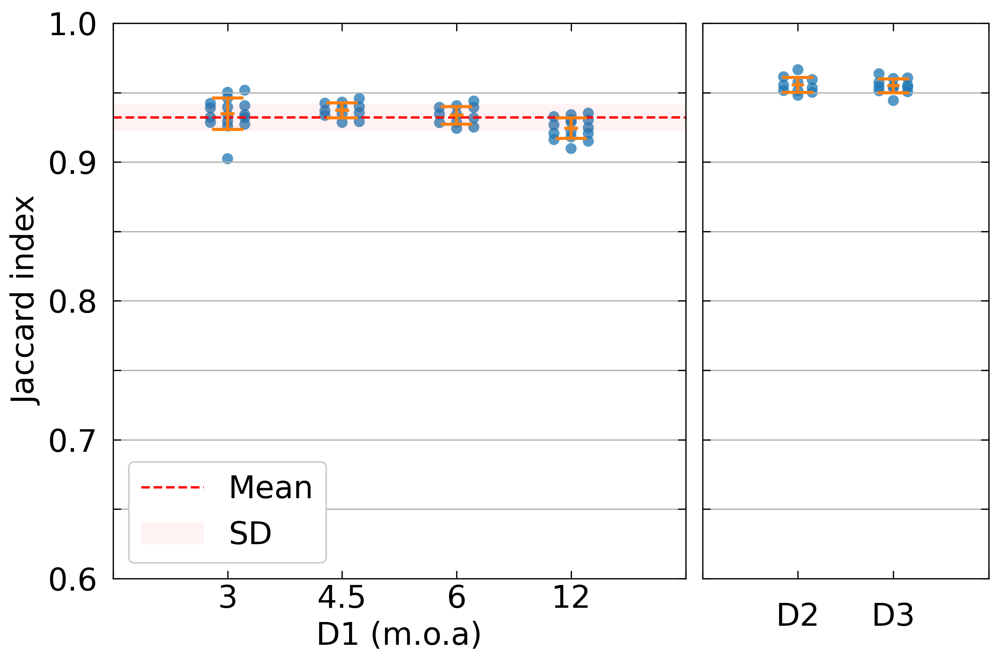

In [46]:

plot_mean_per_subject(jaccard_values_oracle_3,jaccard_values_oracle_4_5,jaccard_values_oracle_6,jaccard_values_oracle_12,
                      jaccard_values_oracle_d2,jaccard_values_oracle_d3,y_under_lim=0.6)
